In [1]:
# ! rm -r runs

import gym
import gym_point
import numpy as np
from collections import deque
import torch
import torch.optim as optim

from util import PGN, RewardNet, GRL, float32_preprocessor

from matplotlib import pyplot as plt
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [2]:
GAMMA = 0.95
LEARNING_RATE = 0.0001
seed = 0
np.random.seed(seed)
torch.manual_seed(seed)

In [3]:
env = gym.make('PointContinuousEnv-v0')
env.set_curve('S') # Curve: 'S', 'C'
env.set_reset_condition('origin') # reset state: 'origin', 'random'

agent_net = PGN(env.observation_space.shape[0], env.action_space.n)
reward_net = RewardNet(env.observation_space.shape[0] + 1)

optimizer_agent = optim.Adam(agent_net.parameters(), lr=LEARNING_RATE)
optimizer_reward = optim.Adam(reward_net.parameters(), lr=1e-4, weight_decay=1e-3)

/home/sagrawal/src/gym/gym/logger.py:30: UserWarning: WARN: The dimensions are bigger than 2, only the first 2 dimensions are visualized
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


In [4]:
agent_net.to(device)
reward_net.to(device)

RewardNet(
  (net): Sequential(
    (0): Linear(in_features=5, out_features=128, bias=True)
    (1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
    (2): ReLU()
    (3): Linear(in_features=128, out_features=64, bias=True)
    (4): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
    (5): ReLU()
    (6): Linear(in_features=64, out_features=1, bias=True)
    (7): Sigmoid()
  )
)

Total number of demonstrations:  100
Total number of step demonstrations:  10000
Testing demonstrations
Test case:  0  Reward:  100 info:  reached end
Test case:  20  Reward:  100 info:  reached end
Test case:  40  Reward:  100 info:  reached end
Test case:  60  Reward:  100 info:  reached end
Test case:  80  Reward:  100 info:  reached end
Average over  5  samples =  100.0


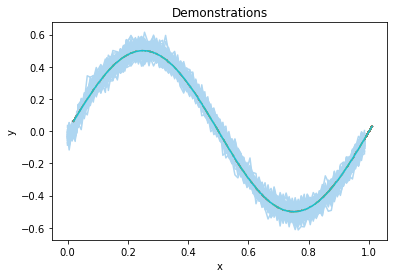

In [5]:
grl = GRL(env, noise=0.03)
demonstrations, XStore_steps, AStore_steps = grl.get_demonstrations(Ndemo=100, Kp=-100, Kd=-3)
grl.test_demonstrations(demonstrations, Nsamp=5, render=False)
# demonstrations['states'][0][:10], demonstrations['actions'][0][:10]

In [6]:
total_rewards = []
step_idx = 0
done_episodes = 0
DEMO_BATCH = 256
BSIZE = 256 # batch size

batch_episodes = 0
batch_states, batch_actions, batch_qvals = deque([], BSIZE), deque([], BSIZE), deque([], BSIZE)
net_rewards = deque([], 100)
env_rewards = deque([], 100)
loss_rwd = 0.

while done_episodes < 500000:
    states, actions, rewards, done = agent_net.generate_session(env, BSIZE)
    
    # Store samples in batch
    batch_states.extend(states)
    batch_actions.extend(actions)
    batch_qvals.extend(grl.calc_qvals(rewards))
    env_reward = np.sum(rewards)
    env_rewards.extend([env_reward])
    
    if len(batch_actions) < BSIZE:
        continue
    
    batch_episodes += 1
        
    # Get reward from reward_net
    x = torch.cat((float32_preprocessor(states), float32_preprocessor(actions).view(-1,1)), dim=1).to(device)
    net_reward = reward_net(x)
    net_rewards.extend([np.sum(net_reward.cpu().detach().numpy())])
         
    done_episodes += 1

    mean_env_rewards = float(np.mean(env_rewards))
    mean_net_rewards = float(np.mean(net_rewards))

    writer.add_scalar('Episodic Reward', env_reward, done_episodes)
    writer.add_scalar('mean_env_reward', mean_env_rewards, done_episodes)
    writer.add_scalar('mean_net_reward', mean_net_rewards, done_episodes)
    writer.add_scalar('loss_reward_net', loss_rwd, done_episodes)        

    print(f'{done_episodes}: reward: {env_reward:6.2f}, mean_env_reward: {mean_env_rewards:6.2f}, mean_net_reward: {mean_net_rewards:6.2f}, reward function loss: {loss_rwd:6.4f}')

    ## Tensorboard logging 
    if done_episodes%100==0 or mean_env_rewards>=100:
        fig = reward_net.visualize_net(agent_net, Npoints=20)
        writer.add_figure('Reward Net', fig, global_step=done_episodes/100)
        
        test_reward, test_fig = agent_net.test_agent(env,device)
        writer.add_scalar('test_reward', test_reward, done_episodes)
        writer.add_figure('Agent traj', test_fig, global_step=done_episodes/100)
        torch.save(agent_net.state_dict(), 'pointspace_policy_net_origin.mod')
        torch.save(reward_net.state_dict(), 'pointspace_reward_net_origin.mod')

    if mean_env_rewards >= 100:
        print(f'Solved in {step_idx} steps and {done_episodes} episodes!')
        torch.save(agent_net.state_dict(), 'pointspace_policy_net_origin.mod')
        torch.save(reward_net.state_dict(), 'pointspace_reward_net_origin.mod')
#         break

    states_v = torch.FloatTensor(batch_states)
    batch_actions_t = torch.LongTensor(batch_actions)
    batch_qvals_v = torch.FloatTensor(batch_qvals)
  
    Total_steps_demo = len(AStore_steps)

    # reward function learning
    for rf_i in range(1):
        # ToDo: Sample from initial steps
        selected = np.random.choice(Total_steps_demo, DEMO_BATCH)
        demo_states = np.take(XStore_steps, selected, axis=0)
        demo_actions = np.take(AStore_steps, selected, axis=0)
        
        demo_batch_states = torch.FloatTensor(demo_states)
        demo_batch_actions = torch.FloatTensor(demo_actions)
        
        D_demo = torch.cat([demo_batch_states, demo_batch_actions.view(-1, 1)], dim=-1).to(device)
        D_samp = torch.cat([states_v, batch_actions_t.float().view(-1, 1)], dim=-1).to(device)
        D_samp = torch.cat([D_demo, D_samp])
                
        # dummy importance weights - fix later
        z = torch.ones((D_samp.shape[0], 1)).to(device)

        # objective
        D_demo_out = reward_net(D_demo)
        D_samp_out_net = reward_net(D_samp)
        D_samp_out = z * torch.exp(D_samp_out_net)
        
        loss_rwd = -torch.mean(D_demo_out) + torch.log(torch.mean(D_samp_out))
        optimizer_reward.zero_grad()
        loss_rwd.backward()
        optimizer_reward.step()
    
    # agent
    optimizer_agent.zero_grad()
    logits_v = agent_net(states_v.to(device))
    log_prob_v = torch.log_softmax(logits_v.cpu(), dim=1) # p(a|s)
    
    # batch_qvals_v = E(s)
    # REINFORCE
    log_prob_actions_v = -batch_qvals_v * log_prob_v[range(len(batch_states)), batch_actions_t] #q(s,a)=p(a|s)E(s)
    loss_v = log_prob_actions_v.mean()
    writer.add_scalar('loss_agent_net', loss_v, done_episodes) 
    
    loss_v.backward()
    optimizer_agent.step()

    batch_episodes = 0

env.close()
writer.close()

1: reward:   2.00, mean_env_reward:   3.53, mean_net_reward:   1.95, reward function loss: 0.0000
2: reward:   2.00, mean_env_reward:   3.50, mean_net_reward:   1.81, reward function loss: 0.0108
3: reward:   2.00, mean_env_reward:   3.47, mean_net_reward:   1.87, reward function loss: 0.0067
4: reward:   3.00, mean_env_reward:   3.47, mean_net_reward:   2.01, reward function loss: 0.0065
5: reward:   4.00, mean_env_reward:   3.48, mean_net_reward:   2.21, reward function loss: 0.0039
6: reward:   3.00, mean_env_reward:   3.47, mean_net_reward:   2.24, reward function loss: 0.0017
7: reward:   2.00, mean_env_reward:   3.44, mean_net_reward:   2.15, reward function loss: 0.0015
8: reward:   2.00, mean_env_reward:   3.42, mean_net_reward:   2.13, reward function loss: -0.0003
9: reward:   3.00, mean_env_reward:   3.42, mean_net_reward:   2.18, reward function loss: -0.0014
10: reward:   2.00, mean_env_reward:   3.39, mean_net_reward:   2.16, reward function loss: -0.0033
11: reward:   7.

87: reward:   9.00, mean_env_reward:   3.30, mean_net_reward:   2.32, reward function loss: -0.1250
88: reward:   2.00, mean_env_reward:   3.27, mean_net_reward:   2.31, reward function loss: -0.1269
89: reward:  11.00, mean_env_reward:   3.36, mean_net_reward:   2.36, reward function loss: -0.1277
90: reward:   2.00, mean_env_reward:   3.36, mean_net_reward:   2.34, reward function loss: -0.1264
91: reward:   2.00, mean_env_reward:   3.36, mean_net_reward:   2.33, reward function loss: -0.1272
92: reward:   2.00, mean_env_reward:   3.35, mean_net_reward:   2.32, reward function loss: -0.1264
93: reward:   2.00, mean_env_reward:   3.34, mean_net_reward:   2.30, reward function loss: -0.1288
94: reward:   5.00, mean_env_reward:   3.37, mean_net_reward:   2.30, reward function loss: -0.1371
95: reward:   3.00, mean_env_reward:   3.35, mean_net_reward:   2.30, reward function loss: -0.1320
96: reward:   2.00, mean_env_reward:   3.34, mean_net_reward:   2.28, reward function loss: -0.1340


180: reward:   7.00, mean_env_reward:   4.56, mean_net_reward:   2.08, reward function loss: -0.1907
181: reward:   3.00, mean_env_reward:   4.57, mean_net_reward:   2.09, reward function loss: -0.1833
182: reward:  11.00, mean_env_reward:   4.66, mean_net_reward:   2.13, reward function loss: -0.1838
183: reward:   2.00, mean_env_reward:   4.56, mean_net_reward:   2.06, reward function loss: -0.1930
184: reward:   3.00, mean_env_reward:   4.56, mean_net_reward:   2.04, reward function loss: -0.1688
185: reward:   5.00, mean_env_reward:   4.58, mean_net_reward:   2.04, reward function loss: -0.1777
186: reward:   2.00, mean_env_reward:   4.57, mean_net_reward:   2.02, reward function loss: -0.1957
187: reward:   9.00, mean_env_reward:   4.57, mean_net_reward:   2.01, reward function loss: -0.1838
188: reward:   4.00, mean_env_reward:   4.59, mean_net_reward:   2.02, reward function loss: -0.1873
189: reward:   3.00, mean_env_reward:   4.51, mean_net_reward:   1.96, reward function loss

266: reward:   3.00, mean_env_reward:   6.10, mean_net_reward:   1.78, reward function loss: -0.2119
267: reward:  13.00, mean_env_reward:   6.12, mean_net_reward:   1.76, reward function loss: -0.2259
268: reward:   9.00, mean_env_reward:   6.08, mean_net_reward:   1.72, reward function loss: -0.2162
269: reward:  11.00, mean_env_reward:   6.15, mean_net_reward:   1.71, reward function loss: -0.2347
270: reward:   4.00, mean_env_reward:   6.14, mean_net_reward:   1.69, reward function loss: -0.2288
271: reward:  12.00, mean_env_reward:   6.20, mean_net_reward:   1.68, reward function loss: -0.2281
272: reward:   6.00, mean_env_reward:   6.17, mean_net_reward:   1.65, reward function loss: -0.2292
273: reward:  10.00, mean_env_reward:   6.25, mean_net_reward:   1.65, reward function loss: -0.2095
274: reward:   9.00, mean_env_reward:   6.32, mean_net_reward:   1.67, reward function loss: -0.2109
275: reward:  11.00, mean_env_reward:   6.39, mean_net_reward:   1.68, reward function loss

348: reward:   5.00, mean_env_reward:   6.86, mean_net_reward:   1.28, reward function loss: -0.2551
349: reward:   5.00, mean_env_reward:   6.79, mean_net_reward:   1.28, reward function loss: -0.2554
350: reward:  13.00, mean_env_reward:   6.83, mean_net_reward:   1.29, reward function loss: -0.2561
351: reward:   3.00, mean_env_reward:   6.75, mean_net_reward:   1.27, reward function loss: -0.2590
352: reward:   3.00, mean_env_reward:   6.75, mean_net_reward:   1.27, reward function loss: -0.2692
353: reward:   9.00, mean_env_reward:   6.74, mean_net_reward:   1.27, reward function loss: -0.2625
354: reward:   9.00, mean_env_reward:   6.74, mean_net_reward:   1.27, reward function loss: -0.2690
355: reward:  14.00, mean_env_reward:   6.85, mean_net_reward:   1.28, reward function loss: -0.2667
356: reward:  12.00, mean_env_reward:   6.94, mean_net_reward:   1.29, reward function loss: -0.2752
357: reward:   4.00, mean_env_reward:   6.83, mean_net_reward:   1.27, reward function loss

433: reward:   3.00, mean_env_reward:   8.23, mean_net_reward:   1.20, reward function loss: -0.2949
434: reward:   8.00, mean_env_reward:   8.20, mean_net_reward:   1.19, reward function loss: -0.2823
435: reward:  12.00, mean_env_reward:   8.24, mean_net_reward:   1.20, reward function loss: -0.2918
436: reward:   6.00, mean_env_reward:   8.21, mean_net_reward:   1.18, reward function loss: -0.2838
437: reward:   3.00, mean_env_reward:   8.21, mean_net_reward:   1.18, reward function loss: -0.2961
438: reward:  12.00, mean_env_reward:   8.21, mean_net_reward:   1.17, reward function loss: -0.2816
439: reward:   9.00, mean_env_reward:   8.20, mean_net_reward:   1.16, reward function loss: -0.3066
440: reward:   8.00, mean_env_reward:   8.24, mean_net_reward:   1.16, reward function loss: -0.2840
441: reward:  10.00, mean_env_reward:   8.31, mean_net_reward:   1.17, reward function loss: -0.2825
442: reward:   7.00, mean_env_reward:   8.26, mean_net_reward:   1.16, reward function loss

516: reward:  11.00, mean_env_reward:   9.24, mean_net_reward:   0.93, reward function loss: -0.3102
517: reward:  11.00, mean_env_reward:   9.24, mean_net_reward:   0.93, reward function loss: -0.3166
518: reward:  10.00, mean_env_reward:   9.24, mean_net_reward:   0.93, reward function loss: -0.3037
519: reward:   9.00, mean_env_reward:   9.30, mean_net_reward:   0.93, reward function loss: -0.3274
520: reward:  12.00, mean_env_reward:   9.33, mean_net_reward:   0.93, reward function loss: -0.3147
521: reward:   3.00, mean_env_reward:   9.26, mean_net_reward:   0.93, reward function loss: -0.3047
522: reward:  11.00, mean_env_reward:   9.28, mean_net_reward:   0.92, reward function loss: -0.3174
523: reward:   9.00, mean_env_reward:   9.24, mean_net_reward:   0.91, reward function loss: -0.3173
524: reward:   9.00, mean_env_reward:   9.20, mean_net_reward:   0.90, reward function loss: -0.3109
525: reward:   9.00, mean_env_reward:   9.17, mean_net_reward:   0.90, reward function loss

603: reward:  11.00, mean_env_reward:  10.19, mean_net_reward:   0.85, reward function loss: -0.3227
604: reward:  10.00, mean_env_reward:  10.17, mean_net_reward:   0.84, reward function loss: -0.3197
605: reward:  11.00, mean_env_reward:  10.18, mean_net_reward:   0.83, reward function loss: -0.3138
606: reward:   7.00, mean_env_reward:  10.14, mean_net_reward:   0.82, reward function loss: -0.3269
607: reward:  13.00, mean_env_reward:  10.16, mean_net_reward:   0.82, reward function loss: -0.3203
608: reward:  11.00, mean_env_reward:  10.16, mean_net_reward:   0.81, reward function loss: -0.3251
609: reward:  10.00, mean_env_reward:  10.13, mean_net_reward:   0.81, reward function loss: -0.3185
610: reward:   4.00, mean_env_reward:  10.07, mean_net_reward:   0.80, reward function loss: -0.3159
611: reward:  10.00, mean_env_reward:  10.06, mean_net_reward:   0.80, reward function loss: -0.3203
612: reward:  10.00, mean_env_reward:  10.12, mean_net_reward:   0.80, reward function loss

688: reward:  11.00, mean_env_reward:  10.09, mean_net_reward:   0.72, reward function loss: -0.3221
689: reward:   9.00, mean_env_reward:  10.08, mean_net_reward:   0.72, reward function loss: -0.3408
690: reward:  12.00, mean_env_reward:  10.07, mean_net_reward:   0.71, reward function loss: -0.3222
691: reward:  12.00, mean_env_reward:  10.09, mean_net_reward:   0.71, reward function loss: -0.3323
692: reward:  10.00, mean_env_reward:  10.06, mean_net_reward:   0.71, reward function loss: -0.3305
693: reward:  10.00, mean_env_reward:  10.05, mean_net_reward:   0.71, reward function loss: -0.3342
694: reward:  12.00, mean_env_reward:  10.05, mean_net_reward:   0.70, reward function loss: -0.3302
695: reward:  10.00, mean_env_reward:  10.02, mean_net_reward:   0.71, reward function loss: -0.3336
696: reward:  13.00, mean_env_reward:  10.03, mean_net_reward:   0.70, reward function loss: -0.3431
697: reward:  11.00, mean_env_reward:  10.05, mean_net_reward:   0.71, reward function loss

773: reward:  14.00, mean_env_reward:  10.73, mean_net_reward:   0.73, reward function loss: -0.3071
774: reward:  13.00, mean_env_reward:  10.83, mean_net_reward:   0.73, reward function loss: -0.3172
775: reward:  10.00, mean_env_reward:  10.81, mean_net_reward:   0.73, reward function loss: -0.3191
776: reward:  10.00, mean_env_reward:  10.89, mean_net_reward:   0.73, reward function loss: -0.3227
777: reward:  13.00, mean_env_reward:  10.93, mean_net_reward:   0.73, reward function loss: -0.3214
778: reward:  12.00, mean_env_reward:  10.93, mean_net_reward:   0.73, reward function loss: -0.3223
779: reward:   9.00, mean_env_reward:  10.92, mean_net_reward:   0.73, reward function loss: -0.3280
780: reward:  13.00, mean_env_reward:  10.94, mean_net_reward:   0.73, reward function loss: -0.3101
781: reward:  10.00, mean_env_reward:  10.95, mean_net_reward:   0.73, reward function loss: -0.3286
782: reward:  11.00, mean_env_reward:  10.95, mean_net_reward:   0.73, reward function loss

856: reward:  15.00, mean_env_reward:  12.35, mean_net_reward:   0.71, reward function loss: -0.3348
857: reward:  15.00, mean_env_reward:  12.35, mean_net_reward:   0.71, reward function loss: -0.3264
858: reward:  14.00, mean_env_reward:  12.39, mean_net_reward:   0.71, reward function loss: -0.3175
859: reward:  16.00, mean_env_reward:  12.42, mean_net_reward:   0.71, reward function loss: -0.3201
860: reward:  15.00, mean_env_reward:  12.44, mean_net_reward:   0.70, reward function loss: -0.3224
861: reward:  14.00, mean_env_reward:  12.48, mean_net_reward:   0.70, reward function loss: -0.3351
862: reward:  17.00, mean_env_reward:  12.48, mean_net_reward:   0.69, reward function loss: -0.3180
863: reward:  11.00, mean_env_reward:  12.45, mean_net_reward:   0.68, reward function loss: -0.3251
864: reward:   8.00, mean_env_reward:  12.41, mean_net_reward:   0.68, reward function loss: -0.3235
865: reward:  18.00, mean_env_reward:  12.52, mean_net_reward:   0.72, reward function loss

944: reward:  15.00, mean_env_reward:  13.51, mean_net_reward:   0.65, reward function loss: -0.3400
945: reward:  15.00, mean_env_reward:  13.59, mean_net_reward:   0.66, reward function loss: -0.3248
946: reward:  17.00, mean_env_reward:  13.64, mean_net_reward:   0.66, reward function loss: -0.3233
947: reward:  15.00, mean_env_reward:  13.66, mean_net_reward:   0.66, reward function loss: -0.3183
948: reward:  16.00, mean_env_reward:  13.70, mean_net_reward:   0.67, reward function loss: -0.3156
949: reward:  16.00, mean_env_reward:  13.72, mean_net_reward:   0.66, reward function loss: -0.3236
950: reward:  16.00, mean_env_reward:  13.72, mean_net_reward:   0.66, reward function loss: -0.3310
951: reward:  19.00, mean_env_reward:  13.79, mean_net_reward:   0.66, reward function loss: -0.3315
952: reward:  10.00, mean_env_reward:  13.75, mean_net_reward:   0.66, reward function loss: -0.3267
953: reward:  16.00, mean_env_reward:  13.85, mean_net_reward:   0.66, reward function loss

1029: reward:  15.00, mean_env_reward:  13.97, mean_net_reward:   0.81, reward function loss: -0.3083
1030: reward:   4.00, mean_env_reward:  13.84, mean_net_reward:   0.81, reward function loss: -0.3297
1031: reward:  18.00, mean_env_reward:  13.87, mean_net_reward:   0.81, reward function loss: -0.3148
1032: reward:  12.00, mean_env_reward:  13.84, mean_net_reward:   0.81, reward function loss: -0.3154
1033: reward:  16.00, mean_env_reward:  13.87, mean_net_reward:   0.80, reward function loss: -0.3211
1034: reward:  19.00, mean_env_reward:  13.95, mean_net_reward:   0.81, reward function loss: -0.3413
1035: reward:  20.00, mean_env_reward:  14.03, mean_net_reward:   0.83, reward function loss: -0.3167
1036: reward:   6.00, mean_env_reward:  13.99, mean_net_reward:   0.85, reward function loss: -0.3228
1037: reward:  13.00, mean_env_reward:  13.96, mean_net_reward:   0.86, reward function loss: -0.3183
1038: reward:  19.00, mean_env_reward:  14.00, mean_net_reward:   0.88, reward fun

1112: reward:  20.00, mean_env_reward:  14.78, mean_net_reward:   0.89, reward function loss: -0.3200
1113: reward:  14.00, mean_env_reward:  14.76, mean_net_reward:   0.89, reward function loss: -0.3220
1114: reward:  13.00, mean_env_reward:  14.75, mean_net_reward:   0.89, reward function loss: -0.3206
1115: reward:  21.00, mean_env_reward:  14.83, mean_net_reward:   0.92, reward function loss: -0.3101
1116: reward:  16.00, mean_env_reward:  14.94, mean_net_reward:   0.93, reward function loss: -0.3139
1117: reward:   9.00, mean_env_reward:  14.89, mean_net_reward:   0.93, reward function loss: -0.3141
1118: reward:  13.00, mean_env_reward:  14.86, mean_net_reward:   0.93, reward function loss: -0.3100
1119: reward:  20.00, mean_env_reward:  14.95, mean_net_reward:   0.94, reward function loss: -0.3021
1120: reward:  20.00, mean_env_reward:  14.98, mean_net_reward:   0.96, reward function loss: -0.3301
1121: reward:  19.00, mean_env_reward:  15.04, mean_net_reward:   0.96, reward fun

1196: reward:  14.00, mean_env_reward:  16.29, mean_net_reward:   0.89, reward function loss: -0.3218
1197: reward:  21.00, mean_env_reward:  16.34, mean_net_reward:   0.90, reward function loss: -0.3244
1198: reward:  21.00, mean_env_reward:  16.40, mean_net_reward:   0.93, reward function loss: -0.3351
1199: reward:  20.00, mean_env_reward:  16.41, mean_net_reward:   0.93, reward function loss: -0.3160
1200: reward:  16.00, mean_env_reward:  16.43, mean_net_reward:   0.93, reward function loss: -0.3296
1201: reward:  14.00, mean_env_reward:  16.37, mean_net_reward:   0.93, reward function loss: -0.3172
1202: reward:  17.00, mean_env_reward:  16.40, mean_net_reward:   0.92, reward function loss: -0.3298
1203: reward:   7.00, mean_env_reward:  16.31, mean_net_reward:   0.92, reward function loss: -0.3335
1204: reward:  20.00, mean_env_reward:  16.30, mean_net_reward:   0.91, reward function loss: -0.3376
1205: reward:  14.00, mean_env_reward:  16.25, mean_net_reward:   0.91, reward fun

1280: reward:  16.00, mean_env_reward:  15.69, mean_net_reward:   0.78, reward function loss: -0.3373
1281: reward:  13.00, mean_env_reward:  15.67, mean_net_reward:   0.76, reward function loss: -0.3323
1282: reward:  18.00, mean_env_reward:  15.71, mean_net_reward:   0.77, reward function loss: -0.3272
1283: reward:  20.00, mean_env_reward:  15.73, mean_net_reward:   0.76, reward function loss: -0.3416
1284: reward:  15.00, mean_env_reward:  15.74, mean_net_reward:   0.76, reward function loss: -0.3300
1285: reward:  20.00, mean_env_reward:  15.74, mean_net_reward:   0.76, reward function loss: -0.3432
1286: reward:  16.00, mean_env_reward:  15.75, mean_net_reward:   0.76, reward function loss: -0.3359
1287: reward:  19.00, mean_env_reward:  15.86, mean_net_reward:   0.77, reward function loss: -0.3399
1288: reward:  20.00, mean_env_reward:  15.85, mean_net_reward:   0.76, reward function loss: -0.3395
1289: reward:  12.00, mean_env_reward:  15.81, mean_net_reward:   0.76, reward fun

1361: reward:  14.00, mean_env_reward:  16.60, mean_net_reward:   0.82, reward function loss: -0.3273
1362: reward:  21.00, mean_env_reward:  16.66, mean_net_reward:   0.83, reward function loss: -0.3290
1363: reward:  21.00, mean_env_reward:  16.66, mean_net_reward:   0.82, reward function loss: -0.3311
1364: reward:  19.00, mean_env_reward:  16.66, mean_net_reward:   0.83, reward function loss: -0.3274
1365: reward:  21.00, mean_env_reward:  16.71, mean_net_reward:   0.84, reward function loss: -0.3295
1366: reward:  16.00, mean_env_reward:  16.67, mean_net_reward:   0.81, reward function loss: -0.3461
1367: reward:  17.00, mean_env_reward:  16.64, mean_net_reward:   0.81, reward function loss: -0.3251
1368: reward:  17.00, mean_env_reward:  16.61, mean_net_reward:   0.81, reward function loss: -0.3204
1369: reward:  20.00, mean_env_reward:  16.65, mean_net_reward:   0.81, reward function loss: -0.3398
1370: reward:  19.00, mean_env_reward:  16.80, mean_net_reward:   0.82, reward fun

1445: reward:  21.00, mean_env_reward:  16.88, mean_net_reward:   0.80, reward function loss: -0.3323
1446: reward:  22.00, mean_env_reward:  16.90, mean_net_reward:   0.81, reward function loss: -0.3373
1447: reward:  20.00, mean_env_reward:  16.91, mean_net_reward:   0.80, reward function loss: -0.3373
1448: reward:  20.00, mean_env_reward:  17.01, mean_net_reward:   0.79, reward function loss: -0.3342
1449: reward:  16.00, mean_env_reward:  16.96, mean_net_reward:   0.78, reward function loss: -0.3302
1450: reward:  18.00, mean_env_reward:  16.98, mean_net_reward:   0.78, reward function loss: -0.3408
1451: reward:  20.00, mean_env_reward:  16.96, mean_net_reward:   0.77, reward function loss: -0.3332
1452: reward:  20.00, mean_env_reward:  17.00, mean_net_reward:   0.76, reward function loss: -0.3269
1453: reward:  21.00, mean_env_reward:  17.14, mean_net_reward:   0.77, reward function loss: -0.3402
1454: reward:  18.00, mean_env_reward:  17.14, mean_net_reward:   0.77, reward fun

1533: reward:  20.00, mean_env_reward:  17.13, mean_net_reward:   0.77, reward function loss: -0.3383
1534: reward:   5.00, mean_env_reward:  17.02, mean_net_reward:   0.77, reward function loss: -0.3489
1535: reward:  19.00, mean_env_reward:  17.01, mean_net_reward:   0.77, reward function loss: -0.3509
1536: reward:  21.00, mean_env_reward:  17.02, mean_net_reward:   0.78, reward function loss: -0.3524
1537: reward:  20.00, mean_env_reward:  17.09, mean_net_reward:   0.76, reward function loss: -0.3419
1538: reward:  12.00, mean_env_reward:  17.07, mean_net_reward:   0.75, reward function loss: -0.3460
1539: reward:   7.00, mean_env_reward:  16.96, mean_net_reward:   0.76, reward function loss: -0.3315
1540: reward:   7.00, mean_env_reward:  16.83, mean_net_reward:   0.76, reward function loss: -0.3399
1541: reward:  21.00, mean_env_reward:  16.82, mean_net_reward:   0.78, reward function loss: -0.3375
1542: reward:  19.00, mean_env_reward:  16.83, mean_net_reward:   0.76, reward fun

1618: reward:  21.00, mean_env_reward:  16.65, mean_net_reward:   0.87, reward function loss: -0.3473
1619: reward:  21.00, mean_env_reward:  16.65, mean_net_reward:   0.85, reward function loss: -0.3439
1620: reward:  16.00, mean_env_reward:  16.63, mean_net_reward:   0.83, reward function loss: -0.3461
1621: reward:  21.00, mean_env_reward:  16.64, mean_net_reward:   0.83, reward function loss: -0.3413
1622: reward:  21.00, mean_env_reward:  16.65, mean_net_reward:   0.84, reward function loss: -0.3478
1623: reward:  15.00, mean_env_reward:  16.74, mean_net_reward:   0.84, reward function loss: -0.3504
1624: reward:  16.00, mean_env_reward:  16.73, mean_net_reward:   0.86, reward function loss: -0.3508
1625: reward:  20.00, mean_env_reward:  16.73, mean_net_reward:   0.86, reward function loss: -0.3496
1626: reward:  20.00, mean_env_reward:  16.77, mean_net_reward:   0.85, reward function loss: -0.3458
1627: reward:  16.00, mean_env_reward:  16.71, mean_net_reward:   0.84, reward fun

1706: reward:  21.00, mean_env_reward:  17.53, mean_net_reward:   0.76, reward function loss: -0.3510
1707: reward:  15.00, mean_env_reward:  17.47, mean_net_reward:   0.75, reward function loss: -0.3486
1708: reward:  14.00, mean_env_reward:  17.45, mean_net_reward:   0.76, reward function loss: -0.3518
1709: reward:  20.00, mean_env_reward:  17.45, mean_net_reward:   0.76, reward function loss: -0.3467
1710: reward:  19.00, mean_env_reward:  17.45, mean_net_reward:   0.74, reward function loss: -0.3544
1711: reward:  14.00, mean_env_reward:  17.39, mean_net_reward:   0.74, reward function loss: -0.3469
1712: reward:  19.00, mean_env_reward:  17.41, mean_net_reward:   0.74, reward function loss: -0.3549
1713: reward:  20.00, mean_env_reward:  17.42, mean_net_reward:   0.74, reward function loss: -0.3525
1714: reward:  20.00, mean_env_reward:  17.49, mean_net_reward:   0.75, reward function loss: -0.3516
1715: reward:  20.00, mean_env_reward:  17.49, mean_net_reward:   0.77, reward fun

1794: reward:  17.00, mean_env_reward:  17.70, mean_net_reward:   0.78, reward function loss: -0.3322
1795: reward:  13.00, mean_env_reward:  17.69, mean_net_reward:   0.77, reward function loss: -0.3382
1796: reward:  16.00, mean_env_reward:  17.65, mean_net_reward:   0.79, reward function loss: -0.3448
1797: reward:  21.00, mean_env_reward:  17.65, mean_net_reward:   0.79, reward function loss: -0.3375
1798: reward:   6.00, mean_env_reward:  17.51, mean_net_reward:   0.77, reward function loss: -0.3456
1799: reward:  21.00, mean_env_reward:  17.58, mean_net_reward:   0.77, reward function loss: -0.3429
1800: reward:  15.00, mean_env_reward:  17.53, mean_net_reward:   0.78, reward function loss: -0.3260
1801: reward:  14.00, mean_env_reward:  17.46, mean_net_reward:   0.79, reward function loss: -0.3455
1802: reward:  18.00, mean_env_reward:  17.44, mean_net_reward:   0.79, reward function loss: -0.3476
1803: reward:  20.00, mean_env_reward:  17.44, mean_net_reward:   0.78, reward fun

1876: reward:  14.00, mean_env_reward:  17.42, mean_net_reward:   0.74, reward function loss: -0.3512
1877: reward:  16.00, mean_env_reward:  17.39, mean_net_reward:   0.74, reward function loss: -0.3502
1878: reward:  16.00, mean_env_reward:  17.37, mean_net_reward:   0.74, reward function loss: -0.3519
1879: reward:  19.00, mean_env_reward:  17.36, mean_net_reward:   0.74, reward function loss: -0.3537
1880: reward:  20.00, mean_env_reward:  17.36, mean_net_reward:   0.74, reward function loss: -0.3475
1881: reward:  14.00, mean_env_reward:  17.29, mean_net_reward:   0.74, reward function loss: -0.3479
1882: reward:  18.00, mean_env_reward:  17.27, mean_net_reward:   0.75, reward function loss: -0.3554
1883: reward:  20.00, mean_env_reward:  17.25, mean_net_reward:   0.72, reward function loss: -0.3507
1884: reward:  21.00, mean_env_reward:  17.30, mean_net_reward:   0.72, reward function loss: -0.3515
1885: reward:  20.00, mean_env_reward:  17.36, mean_net_reward:   0.76, reward fun

1962: reward:  20.00, mean_env_reward:  17.31, mean_net_reward:   0.77, reward function loss: -0.3492
1963: reward:  18.00, mean_env_reward:  17.28, mean_net_reward:   0.78, reward function loss: -0.3452
1964: reward:  20.00, mean_env_reward:  17.28, mean_net_reward:   0.78, reward function loss: -0.3352
1965: reward:  20.00, mean_env_reward:  17.30, mean_net_reward:   0.79, reward function loss: -0.3481
1966: reward:  17.00, mean_env_reward:  17.27, mean_net_reward:   0.79, reward function loss: -0.3452
1967: reward:  15.00, mean_env_reward:  17.21, mean_net_reward:   0.77, reward function loss: -0.3436
1968: reward:  20.00, mean_env_reward:  17.23, mean_net_reward:   0.78, reward function loss: -0.3458
1969: reward:  18.00, mean_env_reward:  17.22, mean_net_reward:   0.77, reward function loss: -0.3377
1970: reward:  20.00, mean_env_reward:  17.23, mean_net_reward:   0.77, reward function loss: -0.3413
1971: reward:  14.00, mean_env_reward:  17.17, mean_net_reward:   0.77, reward fun

2044: reward:  19.00, mean_env_reward:  17.04, mean_net_reward:   0.67, reward function loss: -0.3437
2045: reward:  18.00, mean_env_reward:  17.04, mean_net_reward:   0.69, reward function loss: -0.3523
2046: reward:  19.00, mean_env_reward:  17.03, mean_net_reward:   0.68, reward function loss: -0.3494
2047: reward:  19.00, mean_env_reward:  17.06, mean_net_reward:   0.68, reward function loss: -0.3405
2048: reward:  19.00, mean_env_reward:  17.05, mean_net_reward:   0.67, reward function loss: -0.3577
2049: reward:  14.00, mean_env_reward:  17.00, mean_net_reward:   0.66, reward function loss: -0.3497
2050: reward:  21.00, mean_env_reward:  17.01, mean_net_reward:   0.68, reward function loss: -0.3580
2051: reward:  20.00, mean_env_reward:  17.07, mean_net_reward:   0.68, reward function loss: -0.3479
2052: reward:  16.00, mean_env_reward:  17.06, mean_net_reward:   0.69, reward function loss: -0.3579
2053: reward:  13.00, mean_env_reward:  17.02, mean_net_reward:   0.69, reward fun

2127: reward:  19.00, mean_env_reward:  17.80, mean_net_reward:   0.75, reward function loss: -0.3481
2128: reward:  18.00, mean_env_reward:  17.78, mean_net_reward:   0.76, reward function loss: -0.3477
2129: reward:  21.00, mean_env_reward:  17.79, mean_net_reward:   0.75, reward function loss: -0.3502
2130: reward:  19.00, mean_env_reward:  17.81, mean_net_reward:   0.74, reward function loss: -0.3521
2131: reward:  15.00, mean_env_reward:  17.79, mean_net_reward:   0.72, reward function loss: -0.3529
2132: reward:  19.00, mean_env_reward:  17.82, mean_net_reward:   0.70, reward function loss: -0.3546
2133: reward:  14.00, mean_env_reward:  17.76, mean_net_reward:   0.69, reward function loss: -0.3476
2134: reward:  20.00, mean_env_reward:  17.76, mean_net_reward:   0.69, reward function loss: -0.3436
2135: reward:  20.00, mean_env_reward:  17.76, mean_net_reward:   0.69, reward function loss: -0.3552
2136: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.70, reward fun

2216: reward:  19.00, mean_env_reward:  17.54, mean_net_reward:   0.67, reward function loss: -0.3477
2217: reward:  18.00, mean_env_reward:  17.52, mean_net_reward:   0.67, reward function loss: -0.3513
2218: reward:  15.00, mean_env_reward:  17.50, mean_net_reward:   0.67, reward function loss: -0.3489
2219: reward:  20.00, mean_env_reward:  17.52, mean_net_reward:   0.67, reward function loss: -0.3496
2220: reward:   7.00, mean_env_reward:  17.41, mean_net_reward:   0.67, reward function loss: -0.3557
2221: reward:  18.00, mean_env_reward:  17.43, mean_net_reward:   0.67, reward function loss: -0.3524
2222: reward:  18.00, mean_env_reward:  17.43, mean_net_reward:   0.67, reward function loss: -0.3465
2223: reward:  19.00, mean_env_reward:  17.43, mean_net_reward:   0.67, reward function loss: -0.3572
2224: reward:  15.00, mean_env_reward:  17.41, mean_net_reward:   0.68, reward function loss: -0.3464
2225: reward:  14.00, mean_env_reward:  17.38, mean_net_reward:   0.68, reward fun

2300: reward:  17.00, mean_env_reward:  18.58, mean_net_reward:   0.68, reward function loss: -0.3453
2301: reward:  20.00, mean_env_reward:  18.58, mean_net_reward:   0.68, reward function loss: -0.3502
2302: reward:  20.00, mean_env_reward:  18.66, mean_net_reward:   0.67, reward function loss: -0.3464
2303: reward:  21.00, mean_env_reward:  18.73, mean_net_reward:   0.68, reward function loss: -0.3562
2304: reward:  20.00, mean_env_reward:  18.73, mean_net_reward:   0.68, reward function loss: -0.3537
2305: reward:  20.00, mean_env_reward:  18.79, mean_net_reward:   0.66, reward function loss: -0.3442
2306: reward:  14.00, mean_env_reward:  18.74, mean_net_reward:   0.67, reward function loss: -0.3494
2307: reward:  22.00, mean_env_reward:  18.79, mean_net_reward:   0.65, reward function loss: -0.3510
2308: reward:  21.00, mean_env_reward:  18.86, mean_net_reward:   0.66, reward function loss: -0.3578
2309: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   0.66, reward fun

2385: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.61, reward function loss: -0.3625
2386: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.62, reward function loss: -0.3617
2387: reward:  19.00, mean_env_reward:  18.72, mean_net_reward:   0.64, reward function loss: -0.3530
2388: reward:  16.00, mean_env_reward:  18.66, mean_net_reward:   0.64, reward function loss: -0.3583
2389: reward:  21.00, mean_env_reward:  18.72, mean_net_reward:   0.63, reward function loss: -0.3530
2390: reward:  15.00, mean_env_reward:  18.67, mean_net_reward:   0.63, reward function loss: -0.3454
2391: reward:  22.00, mean_env_reward:  18.83, mean_net_reward:   0.63, reward function loss: -0.3518
2392: reward:  21.00, mean_env_reward:  18.82, mean_net_reward:   0.63, reward function loss: -0.3558
2393: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.63, reward function loss: -0.3466
2394: reward:  22.00, mean_env_reward:  18.83, mean_net_reward:   0.61, reward fun

2473: reward:  20.00, mean_env_reward:  17.91, mean_net_reward:   0.54, reward function loss: -0.3586
2474: reward:  20.00, mean_env_reward:  17.91, mean_net_reward:   0.55, reward function loss: -0.3621
2475: reward:  18.00, mean_env_reward:  17.95, mean_net_reward:   0.55, reward function loss: -0.3626
2476: reward:  20.00, mean_env_reward:  17.95, mean_net_reward:   0.58, reward function loss: -0.3489
2477: reward:  20.00, mean_env_reward:  17.95, mean_net_reward:   0.59, reward function loss: -0.3564
2478: reward:  19.00, mean_env_reward:  17.94, mean_net_reward:   0.60, reward function loss: -0.3593
2479: reward:  21.00, mean_env_reward:  17.99, mean_net_reward:   0.59, reward function loss: -0.3598
2480: reward:  20.00, mean_env_reward:  18.04, mean_net_reward:   0.59, reward function loss: -0.3512
2481: reward:  20.00, mean_env_reward:  18.05, mean_net_reward:   0.61, reward function loss: -0.3500
2482: reward:  15.00, mean_env_reward:  17.99, mean_net_reward:   0.62, reward fun

2555: reward:  20.00, mean_env_reward:  18.66, mean_net_reward:   0.61, reward function loss: -0.3564
2556: reward:  20.00, mean_env_reward:  18.74, mean_net_reward:   0.60, reward function loss: -0.3560
2557: reward:  18.00, mean_env_reward:  18.72, mean_net_reward:   0.60, reward function loss: -0.3445
2558: reward:  20.00, mean_env_reward:  18.71, mean_net_reward:   0.60, reward function loss: -0.3444
2559: reward:  21.00, mean_env_reward:  18.86, mean_net_reward:   0.61, reward function loss: -0.3570
2560: reward:  18.00, mean_env_reward:  18.82, mean_net_reward:   0.60, reward function loss: -0.3544
2561: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.59, reward function loss: -0.3438
2562: reward:  22.00, mean_env_reward:  18.84, mean_net_reward:   0.61, reward function loss: -0.3569
2563: reward:  20.00, mean_env_reward:  18.99, mean_net_reward:   0.61, reward function loss: -0.3547
2564: reward:  19.00, mean_env_reward:  19.11, mean_net_reward:   0.61, reward fun

2638: reward:  17.00, mean_env_reward:  18.82, mean_net_reward:   0.62, reward function loss: -0.3516
2639: reward:   7.00, mean_env_reward:  18.74, mean_net_reward:   0.62, reward function loss: -0.3530
2640: reward:  18.00, mean_env_reward:  18.72, mean_net_reward:   0.62, reward function loss: -0.3447
2641: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.62, reward function loss: -0.3465
2642: reward:  20.00, mean_env_reward:  18.73, mean_net_reward:   0.62, reward function loss: -0.3431
2643: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.61, reward function loss: -0.3598
2644: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.61, reward function loss: -0.3624
2645: reward:  20.00, mean_env_reward:  18.71, mean_net_reward:   0.60, reward function loss: -0.3515
2646: reward:  22.00, mean_env_reward:  18.72, mean_net_reward:   0.60, reward function loss: -0.3625
2647: reward:  18.00, mean_env_reward:  18.84, mean_net_reward:   0.62, reward fun

2722: reward:  17.00, mean_env_reward:  18.88, mean_net_reward:   0.55, reward function loss: -0.3545
2723: reward:  20.00, mean_env_reward:  18.87, mean_net_reward:   0.54, reward function loss: -0.3575
2724: reward:  21.00, mean_env_reward:  18.89, mean_net_reward:   0.55, reward function loss: -0.3566
2725: reward:  20.00, mean_env_reward:  18.89, mean_net_reward:   0.55, reward function loss: -0.3529
2726: reward:  16.00, mean_env_reward:  18.84, mean_net_reward:   0.54, reward function loss: -0.3570
2727: reward:  21.00, mean_env_reward:  18.89, mean_net_reward:   0.52, reward function loss: -0.3604
2728: reward:  14.00, mean_env_reward:  18.84, mean_net_reward:   0.52, reward function loss: -0.3522
2729: reward:  20.00, mean_env_reward:  18.83, mean_net_reward:   0.52, reward function loss: -0.3552
2730: reward:  17.00, mean_env_reward:  18.79, mean_net_reward:   0.52, reward function loss: -0.3597
2731: reward:  16.00, mean_env_reward:  18.88, mean_net_reward:   0.53, reward fun

2806: reward:  16.00, mean_env_reward:  19.01, mean_net_reward:   0.54, reward function loss: -0.3533
2807: reward:  14.00, mean_env_reward:  18.96, mean_net_reward:   0.54, reward function loss: -0.3595
2808: reward:  20.00, mean_env_reward:  18.97, mean_net_reward:   0.56, reward function loss: -0.3594
2809: reward:  19.00, mean_env_reward:  18.96, mean_net_reward:   0.56, reward function loss: -0.3481
2810: reward:  15.00, mean_env_reward:  18.94, mean_net_reward:   0.56, reward function loss: -0.3490
2811: reward:  15.00, mean_env_reward:  18.89, mean_net_reward:   0.55, reward function loss: -0.3547
2812: reward:  15.00, mean_env_reward:  18.83, mean_net_reward:   0.56, reward function loss: -0.3587
2813: reward:  21.00, mean_env_reward:  18.83, mean_net_reward:   0.56, reward function loss: -0.3374
2814: reward:  15.00, mean_env_reward:  18.78, mean_net_reward:   0.56, reward function loss: -0.3440
2815: reward:  22.00, mean_env_reward:  18.80, mean_net_reward:   0.56, reward fun

2891: reward:  14.00, mean_env_reward:  17.99, mean_net_reward:   0.57, reward function loss: -0.3572
2892: reward:  16.00, mean_env_reward:  17.94, mean_net_reward:   0.57, reward function loss: -0.3413
2893: reward:  15.00, mean_env_reward:  17.88, mean_net_reward:   0.56, reward function loss: -0.3480
2894: reward:  20.00, mean_env_reward:  17.95, mean_net_reward:   0.56, reward function loss: -0.3427
2895: reward:  17.00, mean_env_reward:  17.93, mean_net_reward:   0.58, reward function loss: -0.3463
2896: reward:  15.00, mean_env_reward:  17.88, mean_net_reward:   0.58, reward function loss: -0.3362
2897: reward:  15.00, mean_env_reward:  17.84, mean_net_reward:   0.59, reward function loss: -0.3489
2898: reward:  20.00, mean_env_reward:  17.85, mean_net_reward:   0.59, reward function loss: -0.3408
2899: reward:  16.00, mean_env_reward:  17.80, mean_net_reward:   0.58, reward function loss: -0.3530
2900: reward:  16.00, mean_env_reward:  17.76, mean_net_reward:   0.58, reward fun

2978: reward:  18.00, mean_env_reward:  17.53, mean_net_reward:   0.59, reward function loss: -0.3510
2979: reward:  21.00, mean_env_reward:  17.54, mean_net_reward:   0.59, reward function loss: -0.3473
2980: reward:  15.00, mean_env_reward:  17.49, mean_net_reward:   0.59, reward function loss: -0.3478
2981: reward:  20.00, mean_env_reward:  17.50, mean_net_reward:   0.60, reward function loss: -0.3516
2982: reward:  21.00, mean_env_reward:  17.58, mean_net_reward:   0.61, reward function loss: -0.3495
2983: reward:  19.00, mean_env_reward:  17.57, mean_net_reward:   0.61, reward function loss: -0.3571
2984: reward:  20.00, mean_env_reward:  17.57, mean_net_reward:   0.60, reward function loss: -0.3488
2985: reward:  20.00, mean_env_reward:  17.60, mean_net_reward:   0.59, reward function loss: -0.3477
2986: reward:  22.00, mean_env_reward:  17.62, mean_net_reward:   0.58, reward function loss: -0.3483
2987: reward:  21.00, mean_env_reward:  17.70, mean_net_reward:   0.57, reward fun

3066: reward:  16.00, mean_env_reward:  18.74, mean_net_reward:   0.48, reward function loss: -0.3605
3067: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   0.48, reward function loss: -0.3641
3068: reward:  15.00, mean_env_reward:  18.70, mean_net_reward:   0.47, reward function loss: -0.3656
3069: reward:   6.00, mean_env_reward:  18.57, mean_net_reward:   0.47, reward function loss: -0.3624
3070: reward:  20.00, mean_env_reward:  18.56, mean_net_reward:   0.47, reward function loss: -0.3646
3071: reward:  20.00, mean_env_reward:  18.55, mean_net_reward:   0.47, reward function loss: -0.3602
3072: reward:  19.00, mean_env_reward:  18.56, mean_net_reward:   0.44, reward function loss: -0.3605
3073: reward:  20.00, mean_env_reward:  18.59, mean_net_reward:   0.44, reward function loss: -0.3635
3074: reward:  13.00, mean_env_reward:  18.64, mean_net_reward:   0.43, reward function loss: -0.3634
3075: reward:  19.00, mean_env_reward:  18.66, mean_net_reward:   0.43, reward fun

3153: reward:  20.00, mean_env_reward:  18.17, mean_net_reward:   0.35, reward function loss: -0.3651
3154: reward:  20.00, mean_env_reward:  18.20, mean_net_reward:   0.35, reward function loss: -0.3581
3155: reward:  14.00, mean_env_reward:  18.13, mean_net_reward:   0.36, reward function loss: -0.3576
3156: reward:  21.00, mean_env_reward:  18.29, mean_net_reward:   0.36, reward function loss: -0.3582
3157: reward:  20.00, mean_env_reward:  18.29, mean_net_reward:   0.36, reward function loss: -0.3602
3158: reward:  19.00, mean_env_reward:  18.27, mean_net_reward:   0.38, reward function loss: -0.3507
3159: reward:  20.00, mean_env_reward:  18.27, mean_net_reward:   0.38, reward function loss: -0.3548
3160: reward:  20.00, mean_env_reward:  18.27, mean_net_reward:   0.37, reward function loss: -0.3606
3161: reward:  20.00, mean_env_reward:  18.27, mean_net_reward:   0.37, reward function loss: -0.3611
3162: reward:  17.00, mean_env_reward:  18.24, mean_net_reward:   0.37, reward fun

3234: reward:  21.00, mean_env_reward:  18.61, mean_net_reward:   0.53, reward function loss: -0.3534
3235: reward:  22.00, mean_env_reward:  18.70, mean_net_reward:   0.55, reward function loss: -0.3480
3236: reward:  21.00, mean_env_reward:  18.72, mean_net_reward:   0.53, reward function loss: -0.3459
3237: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.53, reward function loss: -0.3465
3238: reward:  20.00, mean_env_reward:  18.73, mean_net_reward:   0.54, reward function loss: -0.3529
3239: reward:  21.00, mean_env_reward:  18.77, mean_net_reward:   0.54, reward function loss: -0.3552
3240: reward:  21.00, mean_env_reward:  18.77, mean_net_reward:   0.56, reward function loss: -0.3553
3241: reward:  18.00, mean_env_reward:  18.81, mean_net_reward:   0.57, reward function loss: -0.3470
3242: reward:  21.00, mean_env_reward:  18.82, mean_net_reward:   0.57, reward function loss: -0.3510
3243: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   0.58, reward fun

3319: reward:  21.00, mean_env_reward:  18.82, mean_net_reward:   0.53, reward function loss: -0.3617
3320: reward:  20.00, mean_env_reward:  18.86, mean_net_reward:   0.52, reward function loss: -0.3629
3321: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   0.51, reward function loss: -0.3615
3322: reward:  21.00, mean_env_reward:  18.83, mean_net_reward:   0.50, reward function loss: -0.3625
3323: reward:  18.00, mean_env_reward:  18.81, mean_net_reward:   0.50, reward function loss: -0.3565
3324: reward:  21.00, mean_env_reward:  18.81, mean_net_reward:   0.50, reward function loss: -0.3661
3325: reward:  20.00, mean_env_reward:  18.94, mean_net_reward:   0.53, reward function loss: -0.3533
3326: reward:  21.00, mean_env_reward:  19.09, mean_net_reward:   0.51, reward function loss: -0.3639
3327: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   0.51, reward function loss: -0.3568
3328: reward:  16.00, mean_env_reward:  19.09, mean_net_reward:   0.52, reward fun

3401: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.51, reward function loss: -0.3493
3402: reward:  14.00, mean_env_reward:  19.37, mean_net_reward:   0.51, reward function loss: -0.3529
3403: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.51, reward function loss: -0.3522
3404: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.52, reward function loss: -0.3620
3405: reward:  14.00, mean_env_reward:  19.43, mean_net_reward:   0.52, reward function loss: -0.3627
3406: reward:  21.00, mean_env_reward:  19.44, mean_net_reward:   0.52, reward function loss: -0.3604
3407: reward:  21.00, mean_env_reward:  19.44, mean_net_reward:   0.52, reward function loss: -0.3611
3408: reward:  19.00, mean_env_reward:  19.57, mean_net_reward:   0.53, reward function loss: -0.3594
3409: reward:   7.00, mean_env_reward:  19.42, mean_net_reward:   0.53, reward function loss: -0.3599
3410: reward:  17.00, mean_env_reward:  19.41, mean_net_reward:   0.52, reward fun

3484: reward:  22.00, mean_env_reward:  19.47, mean_net_reward:   0.50, reward function loss: -0.3568
3485: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3502
3486: reward:  21.00, mean_env_reward:  19.54, mean_net_reward:   0.50, reward function loss: -0.3600
3487: reward:  21.00, mean_env_reward:  19.53, mean_net_reward:   0.50, reward function loss: -0.3607
3488: reward:  19.00, mean_env_reward:  19.54, mean_net_reward:   0.49, reward function loss: -0.3565
3489: reward:  21.00, mean_env_reward:  19.55, mean_net_reward:   0.49, reward function loss: -0.3617
3490: reward:   7.00, mean_env_reward:  19.40, mean_net_reward:   0.49, reward function loss: -0.3627
3491: reward:  21.00, mean_env_reward:  19.40, mean_net_reward:   0.48, reward function loss: -0.3559
3492: reward:  21.00, mean_env_reward:  19.41, mean_net_reward:   0.48, reward function loss: -0.3570
3493: reward:  22.00, mean_env_reward:  19.42, mean_net_reward:   0.48, reward fun

3570: reward:  21.00, mean_env_reward:  19.15, mean_net_reward:   0.71, reward function loss: -0.3478
3571: reward:  20.00, mean_env_reward:  19.13, mean_net_reward:   0.70, reward function loss: -0.3521
3572: reward:  20.00, mean_env_reward:  19.13, mean_net_reward:   0.70, reward function loss: -0.3455
3573: reward:  14.00, mean_env_reward:  19.06, mean_net_reward:   0.71, reward function loss: -0.3515
3574: reward:  20.00, mean_env_reward:  19.05, mean_net_reward:   0.71, reward function loss: -0.3539
3575: reward:  21.00, mean_env_reward:  19.05, mean_net_reward:   0.70, reward function loss: -0.3513
3576: reward:  23.00, mean_env_reward:  19.06, mean_net_reward:   0.71, reward function loss: -0.3533
3577: reward:   7.00, mean_env_reward:  18.92, mean_net_reward:   0.71, reward function loss: -0.3591
3578: reward:  21.00, mean_env_reward:  19.00, mean_net_reward:   0.70, reward function loss: -0.3608
3579: reward:  21.00, mean_env_reward:  19.01, mean_net_reward:   0.69, reward fun

3654: reward:  20.00, mean_env_reward:  18.58, mean_net_reward:   0.81, reward function loss: -0.3325
3655: reward:  20.00, mean_env_reward:  18.58, mean_net_reward:   0.82, reward function loss: -0.3392
3656: reward:  16.00, mean_env_reward:  18.68, mean_net_reward:   0.82, reward function loss: -0.3401
3657: reward:  16.00, mean_env_reward:  18.64, mean_net_reward:   0.81, reward function loss: -0.3434
3658: reward:  20.00, mean_env_reward:  18.67, mean_net_reward:   0.79, reward function loss: -0.3395
3659: reward:  16.00, mean_env_reward:  18.63, mean_net_reward:   0.79, reward function loss: -0.3270
3660: reward:  21.00, mean_env_reward:  18.65, mean_net_reward:   0.80, reward function loss: -0.3495
3661: reward:  20.00, mean_env_reward:  18.65, mean_net_reward:   0.80, reward function loss: -0.3468
3662: reward:  20.00, mean_env_reward:  18.64, mean_net_reward:   0.81, reward function loss: -0.3436
3663: reward:  20.00, mean_env_reward:  18.64, mean_net_reward:   0.80, reward fun

3739: reward:  16.00, mean_env_reward:  18.65, mean_net_reward:   0.87, reward function loss: -0.3500
3740: reward:   6.00, mean_env_reward:  18.54, mean_net_reward:   0.85, reward function loss: -0.3584
3741: reward:   7.00, mean_env_reward:  18.55, mean_net_reward:   0.85, reward function loss: -0.3611
3742: reward:  20.00, mean_env_reward:  18.58, mean_net_reward:   0.83, reward function loss: -0.3495
3743: reward:  20.00, mean_env_reward:  18.57, mean_net_reward:   0.83, reward function loss: -0.3616
3744: reward:   6.00, mean_env_reward:  18.43, mean_net_reward:   0.82, reward function loss: -0.3602
3745: reward:  17.00, mean_env_reward:  18.39, mean_net_reward:   0.78, reward function loss: -0.3518
3746: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   0.78, reward function loss: -0.3649
3747: reward:  20.00, mean_env_reward:  18.41, mean_net_reward:   0.78, reward function loss: -0.3632
3748: reward:  19.00, mean_env_reward:  18.40, mean_net_reward:   0.77, reward fun

3823: reward:  20.00, mean_env_reward:  18.39, mean_net_reward:   0.66, reward function loss: -0.3623
3824: reward:  16.00, mean_env_reward:  18.48, mean_net_reward:   0.67, reward function loss: -0.3561
3825: reward:  20.00, mean_env_reward:  18.47, mean_net_reward:   0.67, reward function loss: -0.3642
3826: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   0.68, reward function loss: -0.3587
3827: reward:  14.00, mean_env_reward:  18.58, mean_net_reward:   0.65, reward function loss: -0.3485
3828: reward:  21.00, mean_env_reward:  18.59, mean_net_reward:   0.65, reward function loss: -0.3496
3829: reward:  21.00, mean_env_reward:  18.60, mean_net_reward:   0.67, reward function loss: -0.3541
3830: reward:  20.00, mean_env_reward:  18.60, mean_net_reward:   0.65, reward function loss: -0.3563
3831: reward:  20.00, mean_env_reward:  18.59, mean_net_reward:   0.65, reward function loss: -0.3496
3832: reward:  21.00, mean_env_reward:  18.59, mean_net_reward:   0.66, reward fun

3906: reward:  18.00, mean_env_reward:  19.28, mean_net_reward:   0.73, reward function loss: -0.3532
3907: reward:  16.00, mean_env_reward:  19.23, mean_net_reward:   0.74, reward function loss: -0.3467
3908: reward:  19.00, mean_env_reward:  19.22, mean_net_reward:   0.73, reward function loss: -0.3468
3909: reward:  21.00, mean_env_reward:  19.23, mean_net_reward:   0.73, reward function loss: -0.3526
3910: reward:  18.00, mean_env_reward:  19.21, mean_net_reward:   0.74, reward function loss: -0.3574
3911: reward:  21.00, mean_env_reward:  19.21, mean_net_reward:   0.74, reward function loss: -0.3466
3912: reward:  13.00, mean_env_reward:  19.14, mean_net_reward:   0.74, reward function loss: -0.3439
3913: reward:  14.00, mean_env_reward:  19.08, mean_net_reward:   0.75, reward function loss: -0.3362
3914: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.74, reward function loss: -0.3421
3915: reward:  14.00, mean_env_reward:  19.07, mean_net_reward:   0.76, reward fun

3991: reward:  20.00, mean_env_reward:  18.73, mean_net_reward:   0.71, reward function loss: -0.3503
3992: reward:  19.00, mean_env_reward:  18.73, mean_net_reward:   0.70, reward function loss: -0.3396
3993: reward:  20.00, mean_env_reward:  18.77, mean_net_reward:   0.70, reward function loss: -0.3507
3994: reward:  22.00, mean_env_reward:  18.79, mean_net_reward:   0.70, reward function loss: -0.3572
3995: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.70, reward function loss: -0.3501
3996: reward:  21.00, mean_env_reward:  18.83, mean_net_reward:   0.69, reward function loss: -0.3500
3997: reward:  20.00, mean_env_reward:  18.83, mean_net_reward:   0.69, reward function loss: -0.3453
3998: reward:  20.00, mean_env_reward:  18.83, mean_net_reward:   0.69, reward function loss: -0.3538
3999: reward:  19.00, mean_env_reward:  18.83, mean_net_reward:   0.70, reward function loss: -0.3525
4000: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   0.69, reward fun

4073: reward:  16.00, mean_env_reward:  19.52, mean_net_reward:   0.64, reward function loss: -0.3573
4074: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.62, reward function loss: -0.3505
4075: reward:  21.00, mean_env_reward:  19.53, mean_net_reward:   0.61, reward function loss: -0.3562
4076: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.61, reward function loss: -0.3543
4077: reward:  15.00, mean_env_reward:  19.55, mean_net_reward:   0.60, reward function loss: -0.3605
4078: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.60, reward function loss: -0.3536
4079: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.59, reward function loss: -0.3577
4080: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.57, reward function loss: -0.3622
4081: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.57, reward function loss: -0.3528
4082: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.56, reward fun

4156: reward:  21.00, mean_env_reward:  19.80, mean_net_reward:   0.60, reward function loss: -0.3531
4157: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.60, reward function loss: -0.3534
4158: reward:  18.00, mean_env_reward:  19.78, mean_net_reward:   0.60, reward function loss: -0.3549
4159: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.62, reward function loss: -0.3482
4160: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.61, reward function loss: -0.3585
4161: reward:  21.00, mean_env_reward:  19.79, mean_net_reward:   0.61, reward function loss: -0.3632
4162: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.61, reward function loss: -0.3511
4163: reward:  22.00, mean_env_reward:  19.80, mean_net_reward:   0.61, reward function loss: -0.3616
4164: reward:  22.00, mean_env_reward:  19.82, mean_net_reward:   0.62, reward function loss: -0.3630
4165: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.62, reward fun

4244: reward:   7.00, mean_env_reward:  19.10, mean_net_reward:   0.65, reward function loss: -0.3542
4245: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.64, reward function loss: -0.3435
4246: reward:  22.00, mean_env_reward:  19.12, mean_net_reward:   0.64, reward function loss: -0.3611
4247: reward:  20.00, mean_env_reward:  19.13, mean_net_reward:   0.64, reward function loss: -0.3494
4248: reward:  21.00, mean_env_reward:  19.13, mean_net_reward:   0.64, reward function loss: -0.3415
4249: reward:  22.00, mean_env_reward:  19.15, mean_net_reward:   0.63, reward function loss: -0.3509
4250: reward:  19.00, mean_env_reward:  19.12, mean_net_reward:   0.64, reward function loss: -0.3523
4251: reward:  22.00, mean_env_reward:  19.13, mean_net_reward:   0.65, reward function loss: -0.3618
4252: reward:  21.00, mean_env_reward:  19.17, mean_net_reward:   0.65, reward function loss: -0.3535
4253: reward:  21.00, mean_env_reward:  19.17, mean_net_reward:   0.65, reward fun

4329: reward:  20.00, mean_env_reward:  18.29, mean_net_reward:   0.70, reward function loss: -0.3478
4330: reward:  19.00, mean_env_reward:  18.42, mean_net_reward:   0.70, reward function loss: -0.3401
4331: reward:  20.00, mean_env_reward:  18.41, mean_net_reward:   0.71, reward function loss: -0.3448
4332: reward:  20.00, mean_env_reward:  18.39, mean_net_reward:   0.71, reward function loss: -0.3523
4333: reward:  21.00, mean_env_reward:  18.38, mean_net_reward:   0.72, reward function loss: -0.3510
4334: reward:  18.00, mean_env_reward:  18.35, mean_net_reward:   0.70, reward function loss: -0.3380
4335: reward:  23.00, mean_env_reward:  18.37, mean_net_reward:   0.68, reward function loss: -0.3466
4336: reward:  15.00, mean_env_reward:  18.31, mean_net_reward:   0.68, reward function loss: -0.3453
4337: reward:  21.00, mean_env_reward:  18.31, mean_net_reward:   0.67, reward function loss: -0.3480
4338: reward:  19.00, mean_env_reward:  18.30, mean_net_reward:   0.67, reward fun

4413: reward:  22.00, mean_env_reward:  19.86, mean_net_reward:   1.03, reward function loss: -0.3518
4414: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   1.02, reward function loss: -0.3449
4415: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   1.00, reward function loss: -0.3370
4416: reward:   6.00, mean_env_reward:  19.70, mean_net_reward:   1.00, reward function loss: -0.3519
4417: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.98, reward function loss: -0.3295
4418: reward:  21.00, mean_env_reward:  19.73, mean_net_reward:   1.00, reward function loss: -0.3523
4419: reward:  21.00, mean_env_reward:  19.74, mean_net_reward:   0.96, reward function loss: -0.3488
4420: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.96, reward function loss: -0.3561
4421: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.98, reward function loss: -0.3441
4422: reward:  21.00, mean_env_reward:  19.74, mean_net_reward:   0.98, reward fun

4496: reward:  21.00, mean_env_reward:  19.76, mean_net_reward:   0.93, reward function loss: -0.3473
4497: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.91, reward function loss: -0.3494
4498: reward:  21.00, mean_env_reward:  19.77, mean_net_reward:   0.91, reward function loss: -0.3580
4499: reward:  21.00, mean_env_reward:  19.76, mean_net_reward:   0.90, reward function loss: -0.3609
4500: reward:  21.00, mean_env_reward:  19.76, mean_net_reward:   0.90, reward function loss: -0.3589
4501: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.87, reward function loss: -0.3584
4502: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.88, reward function loss: -0.3510
4503: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.88, reward function loss: -0.3585
4504: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.88, reward function loss: -0.3504
4505: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.88, reward fun

4585: reward:  18.00, mean_env_reward:  19.82, mean_net_reward:   0.72, reward function loss: -0.3515
4586: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.72, reward function loss: -0.3440
4587: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.72, reward function loss: -0.3581
4588: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.71, reward function loss: -0.3615
4589: reward:  22.00, mean_env_reward:  19.84, mean_net_reward:   0.71, reward function loss: -0.3565
4590: reward:  18.00, mean_env_reward:  19.81, mean_net_reward:   0.72, reward function loss: -0.3516
4591: reward:  17.00, mean_env_reward:  19.78, mean_net_reward:   0.71, reward function loss: -0.3474
4592: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.72, reward function loss: -0.3507
4593: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.72, reward function loss: -0.3491
4594: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.71, reward fun

4673: reward:  20.00, mean_env_reward:  19.15, mean_net_reward:   0.77, reward function loss: -0.3491
4674: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   0.77, reward function loss: -0.3579
4675: reward:  21.00, mean_env_reward:  19.14, mean_net_reward:   0.78, reward function loss: -0.3461
4676: reward:  22.00, mean_env_reward:  19.16, mean_net_reward:   0.79, reward function loss: -0.3514
4677: reward:  14.00, mean_env_reward:  19.09, mean_net_reward:   0.81, reward function loss: -0.3492
4678: reward:   7.00, mean_env_reward:  18.96, mean_net_reward:   0.80, reward function loss: -0.3498
4679: reward:  21.00, mean_env_reward:  18.96, mean_net_reward:   0.79, reward function loss: -0.3582
4680: reward:  21.00, mean_env_reward:  18.97, mean_net_reward:   0.79, reward function loss: -0.3422
4681: reward:  19.00, mean_env_reward:  18.96, mean_net_reward:   0.79, reward function loss: -0.3550
4682: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   0.79, reward fun

4757: reward:  20.00, mean_env_reward:  19.42, mean_net_reward:   0.73, reward function loss: -0.3552
4758: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.73, reward function loss: -0.3449
4759: reward:  20.00, mean_env_reward:  19.42, mean_net_reward:   0.73, reward function loss: -0.3422
4760: reward:  21.00, mean_env_reward:  19.48, mean_net_reward:   0.72, reward function loss: -0.3503
4761: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.71, reward function loss: -0.3478
4762: reward:  21.00, mean_env_reward:  19.47, mean_net_reward:   0.73, reward function loss: -0.3515
4763: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.72, reward function loss: -0.3571
4764: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.70, reward function loss: -0.3571
4765: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.71, reward function loss: -0.3575
4766: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.72, reward fun

4843: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.68, reward function loss: -0.3610
4844: reward:  16.00, mean_env_reward:  19.56, mean_net_reward:   0.70, reward function loss: -0.3625
4845: reward:  17.00, mean_env_reward:  19.53, mean_net_reward:   0.71, reward function loss: -0.3559
4846: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.70, reward function loss: -0.3503
4847: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.70, reward function loss: -0.3561
4848: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.70, reward function loss: -0.3512
4849: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.70, reward function loss: -0.3541
4850: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.70, reward function loss: -0.3472
4851: reward:  18.00, mean_env_reward:  19.63, mean_net_reward:   0.69, reward function loss: -0.3574
4852: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.69, reward fun

4924: reward:  18.00, mean_env_reward:  19.13, mean_net_reward:   0.68, reward function loss: -0.3583
4925: reward:  18.00, mean_env_reward:  19.12, mean_net_reward:   0.67, reward function loss: -0.3591
4926: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.68, reward function loss: -0.3573
4927: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.67, reward function loss: -0.3553
4928: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.66, reward function loss: -0.3525
4929: reward:  19.00, mean_env_reward:  19.09, mean_net_reward:   0.67, reward function loss: -0.3505
4930: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.67, reward function loss: -0.3640
4931: reward:  21.00, mean_env_reward:  19.11, mean_net_reward:   0.67, reward function loss: -0.3527
4932: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.67, reward function loss: -0.3586
4933: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   0.67, reward fun

5009: reward:  19.00, mean_env_reward:  19.18, mean_net_reward:   0.66, reward function loss: -0.3548
5010: reward:  17.00, mean_env_reward:  19.17, mean_net_reward:   0.64, reward function loss: -0.3562
5011: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.64, reward function loss: -0.3520
5012: reward:  20.00, mean_env_reward:  19.18, mean_net_reward:   0.64, reward function loss: -0.3588
5013: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.66, reward function loss: -0.3484
5014: reward:  17.00, mean_env_reward:  19.16, mean_net_reward:   0.64, reward function loss: -0.3591
5015: reward:  14.00, mean_env_reward:  19.09, mean_net_reward:   0.66, reward function loss: -0.3589
5016: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   0.67, reward function loss: -0.3586
5017: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.67, reward function loss: -0.3562
5018: reward:  19.00, mean_env_reward:  19.22, mean_net_reward:   0.67, reward fun

5095: reward:  21.00, mean_env_reward:  19.14, mean_net_reward:   0.70, reward function loss: -0.3573
5096: reward:  16.00, mean_env_reward:  19.13, mean_net_reward:   0.68, reward function loss: -0.3601
5097: reward:  14.00, mean_env_reward:  19.08, mean_net_reward:   0.68, reward function loss: -0.3527
5098: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.68, reward function loss: -0.3570
5099: reward:  20.00, mean_env_reward:  19.06, mean_net_reward:   0.68, reward function loss: -0.3579
5100: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   0.65, reward function loss: -0.3596
5101: reward:  20.00, mean_env_reward:  19.16, mean_net_reward:   0.65, reward function loss: -0.3531
5102: reward:  21.00, mean_env_reward:  19.20, mean_net_reward:   0.64, reward function loss: -0.3571
5103: reward:  19.00, mean_env_reward:  19.19, mean_net_reward:   0.64, reward function loss: -0.3476
5104: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.64, reward fun

5176: reward:  14.00, mean_env_reward:  19.90, mean_net_reward:   0.57, reward function loss: -0.3580
5177: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.57, reward function loss: -0.3589
5178: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.57, reward function loss: -0.3582
5179: reward:  21.00, mean_env_reward:  19.89, mean_net_reward:   0.58, reward function loss: -0.3522
5180: reward:  18.00, mean_env_reward:  19.87, mean_net_reward:   0.58, reward function loss: -0.3485
5181: reward:  19.00, mean_env_reward:  19.86, mean_net_reward:   0.57, reward function loss: -0.3586
5182: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.57, reward function loss: -0.3556
5183: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.57, reward function loss: -0.3579
5184: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.58, reward function loss: -0.3517
5185: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.55, reward fun

5262: reward:  19.00, mean_env_reward:  19.66, mean_net_reward:   0.49, reward function loss: -0.3632
5263: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.49, reward function loss: -0.3662
5264: reward:  21.00, mean_env_reward:  19.66, mean_net_reward:   0.50, reward function loss: -0.3598
5265: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.50, reward function loss: -0.3643
5266: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.49, reward function loss: -0.3579
5267: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.48, reward function loss: -0.3662
5268: reward:  21.00, mean_env_reward:  19.67, mean_net_reward:   0.47, reward function loss: -0.3641
5269: reward:  18.00, mean_env_reward:  19.64, mean_net_reward:   0.49, reward function loss: -0.3630
5270: reward:  21.00, mean_env_reward:  19.66, mean_net_reward:   0.49, reward function loss: -0.3638
5271: reward:  11.00, mean_env_reward:  19.56, mean_net_reward:   0.50, reward fun

5350: reward:  20.00, mean_env_reward:  19.29, mean_net_reward:   0.54, reward function loss: -0.3440
5351: reward:  22.00, mean_env_reward:  19.31, mean_net_reward:   0.58, reward function loss: -0.3464
5352: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.58, reward function loss: -0.3419
5353: reward:  19.00, mean_env_reward:  19.29, mean_net_reward:   0.58, reward function loss: -0.3529
5354: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.57, reward function loss: -0.3558
5355: reward:  19.00, mean_env_reward:  19.30, mean_net_reward:   0.56, reward function loss: -0.3444
5356: reward:  19.00, mean_env_reward:  19.29, mean_net_reward:   0.56, reward function loss: -0.3486
5357: reward:  17.00, mean_env_reward:  19.27, mean_net_reward:   0.56, reward function loss: -0.3560
5358: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.56, reward function loss: -0.3377
5359: reward:  17.00, mean_env_reward:  19.23, mean_net_reward:   0.57, reward fun

5434: reward:  20.00, mean_env_reward:  19.13, mean_net_reward:   0.61, reward function loss: -0.3623
5435: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.61, reward function loss: -0.3636
5436: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   0.61, reward function loss: -0.3640
5437: reward:  17.00, mean_env_reward:  19.10, mean_net_reward:   0.63, reward function loss: -0.3595
5438: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.63, reward function loss: -0.3654
5439: reward:  18.00, mean_env_reward:  19.08, mean_net_reward:   0.63, reward function loss: -0.3538
5440: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.61, reward function loss: -0.3620
5441: reward:  19.00, mean_env_reward:  19.08, mean_net_reward:   0.58, reward function loss: -0.3551
5442: reward:  14.00, mean_env_reward:  19.02, mean_net_reward:   0.57, reward function loss: -0.3598
5443: reward:  20.00, mean_env_reward:  19.03, mean_net_reward:   0.56, reward fun

5519: reward:  19.00, mean_env_reward:  18.97, mean_net_reward:   0.50, reward function loss: -0.3561
5520: reward:   7.00, mean_env_reward:  18.84, mean_net_reward:   0.49, reward function loss: -0.3655
5521: reward:   7.00, mean_env_reward:  18.71, mean_net_reward:   0.49, reward function loss: -0.3612
5522: reward:  21.00, mean_env_reward:  18.74, mean_net_reward:   0.48, reward function loss: -0.3610
5523: reward:  20.00, mean_env_reward:  18.73, mean_net_reward:   0.48, reward function loss: -0.3595
5524: reward:  18.00, mean_env_reward:  18.71, mean_net_reward:   0.48, reward function loss: -0.3626
5525: reward:  19.00, mean_env_reward:  18.70, mean_net_reward:   0.50, reward function loss: -0.3633
5526: reward:  19.00, mean_env_reward:  18.69, mean_net_reward:   0.48, reward function loss: -0.3593
5527: reward:  19.00, mean_env_reward:  18.68, mean_net_reward:   0.48, reward function loss: -0.3532
5528: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.48, reward fun

5607: reward:  19.00, mean_env_reward:  18.34, mean_net_reward:   0.47, reward function loss: -0.3606
5608: reward:  19.00, mean_env_reward:  18.32, mean_net_reward:   0.47, reward function loss: -0.3597
5609: reward:  19.00, mean_env_reward:  18.33, mean_net_reward:   0.47, reward function loss: -0.3568
5610: reward:  19.00, mean_env_reward:  18.33, mean_net_reward:   0.46, reward function loss: -0.3617
5611: reward:  20.00, mean_env_reward:  18.32, mean_net_reward:   0.47, reward function loss: -0.3563
5612: reward:  18.00, mean_env_reward:  18.29, mean_net_reward:   0.47, reward function loss: -0.3637
5613: reward:  18.00, mean_env_reward:  18.27, mean_net_reward:   0.48, reward function loss: -0.3654
5614: reward:  19.00, mean_env_reward:  18.25, mean_net_reward:   0.48, reward function loss: -0.3548
5615: reward:  18.00, mean_env_reward:  18.23, mean_net_reward:   0.49, reward function loss: -0.3634
5616: reward:  20.00, mean_env_reward:  18.23, mean_net_reward:   0.51, reward fun

5691: reward:  21.00, mean_env_reward:  18.52, mean_net_reward:   0.52, reward function loss: -0.3625
5692: reward:  20.00, mean_env_reward:  18.61, mean_net_reward:   0.51, reward function loss: -0.3498
5693: reward:  21.00, mean_env_reward:  18.63, mean_net_reward:   0.52, reward function loss: -0.3625
5694: reward:  21.00, mean_env_reward:  18.62, mean_net_reward:   0.51, reward function loss: -0.3633
5695: reward:  20.00, mean_env_reward:  18.61, mean_net_reward:   0.51, reward function loss: -0.3618
5696: reward:  19.00, mean_env_reward:  18.62, mean_net_reward:   0.51, reward function loss: -0.3598
5697: reward:  19.00, mean_env_reward:  18.63, mean_net_reward:   0.48, reward function loss: -0.3622
5698: reward:  22.00, mean_env_reward:  18.65, mean_net_reward:   0.48, reward function loss: -0.3618
5699: reward:  18.00, mean_env_reward:  18.63, mean_net_reward:   0.49, reward function loss: -0.3505
5700: reward:  20.00, mean_env_reward:  18.66, mean_net_reward:   0.49, reward fun

5775: reward:  21.00, mean_env_reward:  19.56, mean_net_reward:   0.55, reward function loss: -0.3606
5776: reward:  17.00, mean_env_reward:  19.57, mean_net_reward:   0.57, reward function loss: -0.3651
5777: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.57, reward function loss: -0.3606
5778: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.57, reward function loss: -0.3606
5779: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.58, reward function loss: -0.3576
5780: reward:  21.00, mean_env_reward:  19.68, mean_net_reward:   0.57, reward function loss: -0.3478
5781: reward:  19.00, mean_env_reward:  19.66, mean_net_reward:   0.57, reward function loss: -0.3563
5782: reward:  19.00, mean_env_reward:  19.65, mean_net_reward:   0.56, reward function loss: -0.3648
5783: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.56, reward function loss: -0.3611
5784: reward:  22.00, mean_env_reward:  19.67, mean_net_reward:   0.55, reward fun

5862: reward:  20.00, mean_env_reward:  19.61, mean_net_reward:   0.53, reward function loss: -0.3558
5863: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.53, reward function loss: -0.3558
5864: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.53, reward function loss: -0.3587
5865: reward:  21.00, mean_env_reward:  19.64, mean_net_reward:   0.53, reward function loss: -0.3592
5866: reward:  13.00, mean_env_reward:  19.58, mean_net_reward:   0.53, reward function loss: -0.3474
5867: reward:  21.00, mean_env_reward:  19.59, mean_net_reward:   0.53, reward function loss: -0.3470
5868: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.51, reward function loss: -0.3596
5869: reward:  22.00, mean_env_reward:  19.62, mean_net_reward:   0.52, reward function loss: -0.3576
5870: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.54, reward function loss: -0.3620
5871: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.54, reward fun

5949: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.51, reward function loss: -0.3590
5950: reward:  15.00, mean_env_reward:  19.59, mean_net_reward:   0.51, reward function loss: -0.3566
5951: reward:  15.00, mean_env_reward:  19.54, mean_net_reward:   0.51, reward function loss: -0.3601
5952: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3638
5953: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.51, reward function loss: -0.3568
5954: reward:  17.00, mean_env_reward:  19.48, mean_net_reward:   0.52, reward function loss: -0.3480
5955: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.51, reward function loss: -0.3541
5956: reward:  21.00, mean_env_reward:  19.50, mean_net_reward:   0.51, reward function loss: -0.3468
5957: reward:  19.00, mean_env_reward:  19.47, mean_net_reward:   0.50, reward function loss: -0.3533
5958: reward:  21.00, mean_env_reward:  19.47, mean_net_reward:   0.51, reward fun

6033: reward:   6.00, mean_env_reward:  19.29, mean_net_reward:   0.48, reward function loss: -0.3554
6034: reward:  17.00, mean_env_reward:  19.26, mean_net_reward:   0.47, reward function loss: -0.3512
6035: reward:  19.00, mean_env_reward:  19.27, mean_net_reward:   0.48, reward function loss: -0.3568
6036: reward:  19.00, mean_env_reward:  19.25, mean_net_reward:   0.49, reward function loss: -0.3619
6037: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.50, reward function loss: -0.3461
6038: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.51, reward function loss: -0.3594
6039: reward:  19.00, mean_env_reward:  19.23, mean_net_reward:   0.49, reward function loss: -0.3593
6040: reward:  21.00, mean_env_reward:  19.24, mean_net_reward:   0.49, reward function loss: -0.3594
6041: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.49, reward function loss: -0.3558
6042: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   0.49, reward fun

6115: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.54, reward function loss: -0.3565
6116: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.54, reward function loss: -0.3524
6117: reward:  15.00, mean_env_reward:  19.51, mean_net_reward:   0.54, reward function loss: -0.3630
6118: reward:  18.00, mean_env_reward:  19.51, mean_net_reward:   0.54, reward function loss: -0.3614
6119: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.53, reward function loss: -0.3635
6120: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.53, reward function loss: -0.3506
6121: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.53, reward function loss: -0.3557
6122: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.53, reward function loss: -0.3618
6123: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.53, reward function loss: -0.3560
6124: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.53, reward fun

6202: reward:  14.00, mean_env_reward:  19.32, mean_net_reward:   0.49, reward function loss: -0.3531
6203: reward:  21.00, mean_env_reward:  19.32, mean_net_reward:   0.50, reward function loss: -0.3577
6204: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.50, reward function loss: -0.3415
6205: reward:  19.00, mean_env_reward:  19.32, mean_net_reward:   0.50, reward function loss: -0.3560
6206: reward:  19.00, mean_env_reward:  19.31, mean_net_reward:   0.50, reward function loss: -0.3500
6207: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.50, reward function loss: -0.3574
6208: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.51, reward function loss: -0.3540
6209: reward:  21.00, mean_env_reward:  19.33, mean_net_reward:   0.51, reward function loss: -0.3593
6210: reward:  20.00, mean_env_reward:  19.39, mean_net_reward:   0.49, reward function loss: -0.3542
6211: reward:  20.00, mean_env_reward:  19.40, mean_net_reward:   0.48, reward fun

6286: reward:  20.00, mean_env_reward:  18.64, mean_net_reward:   0.50, reward function loss: -0.3600
6287: reward:  19.00, mean_env_reward:  18.65, mean_net_reward:   0.50, reward function loss: -0.3619
6288: reward:  16.00, mean_env_reward:  18.63, mean_net_reward:   0.49, reward function loss: -0.3592
6289: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   0.49, reward function loss: -0.3584
6290: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   0.50, reward function loss: -0.3586
6291: reward:  20.00, mean_env_reward:  18.62, mean_net_reward:   0.51, reward function loss: -0.3506
6292: reward:  20.00, mean_env_reward:  18.66, mean_net_reward:   0.51, reward function loss: -0.3608
6293: reward:  19.00, mean_env_reward:  18.68, mean_net_reward:   0.51, reward function loss: -0.3620
6294: reward:  18.00, mean_env_reward:  18.68, mean_net_reward:   0.51, reward function loss: -0.3524
6295: reward:  20.00, mean_env_reward:  18.69, mean_net_reward:   0.52, reward fun

6369: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.50, reward function loss: -0.3565
6370: reward:  21.00, mean_env_reward:  19.79, mean_net_reward:   0.49, reward function loss: -0.3637
6371: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.47, reward function loss: -0.3638
6372: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.46, reward function loss: -0.3557
6373: reward:  21.00, mean_env_reward:  19.82, mean_net_reward:   0.46, reward function loss: -0.3581
6374: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.44, reward function loss: -0.3627
6375: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.44, reward function loss: -0.3627
6376: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.45, reward function loss: -0.3631
6377: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.45, reward function loss: -0.3563
6378: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.45, reward fun

6450: reward:  19.00, mean_env_reward:  19.87, mean_net_reward:   0.48, reward function loss: -0.3520
6451: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.47, reward function loss: -0.3571
6452: reward:  21.00, mean_env_reward:  19.89, mean_net_reward:   0.47, reward function loss: -0.3595
6453: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.47, reward function loss: -0.3563
6454: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.45, reward function loss: -0.3565
6455: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.45, reward function loss: -0.3574
6456: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.47, reward function loss: -0.3564
6457: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3591
6458: reward:  21.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3584
6459: reward:  16.00, mean_env_reward:  19.82, mean_net_reward:   0.48, reward fun

6531: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.52, reward function loss: -0.3638
6532: reward:  19.00, mean_env_reward:  19.65, mean_net_reward:   0.52, reward function loss: -0.3539
6533: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.51, reward function loss: -0.3598
6534: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.51, reward function loss: -0.3615
6535: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.50, reward function loss: -0.3547
6536: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.50, reward function loss: -0.3597
6537: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.50, reward function loss: -0.3554
6538: reward:  21.00, mean_env_reward:  19.66, mean_net_reward:   0.50, reward function loss: -0.3685
6539: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.50, reward function loss: -0.3631
6540: reward:  21.00, mean_env_reward:  19.72, mean_net_reward:   0.48, reward fun

6619: reward:  21.00, mean_env_reward:  20.09, mean_net_reward:   0.49, reward function loss: -0.3571
6620: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.49, reward function loss: -0.3575
6621: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.48, reward function loss: -0.3669
6622: reward:  22.00, mean_env_reward:  20.13, mean_net_reward:   0.48, reward function loss: -0.3602
6623: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.48, reward function loss: -0.3600
6624: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.48, reward function loss: -0.3534
6625: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.47, reward function loss: -0.3556
6626: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.47, reward function loss: -0.3552
6627: reward:  22.00, mean_env_reward:  20.14, mean_net_reward:   0.47, reward function loss: -0.3546
6628: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.48, reward fun

6707: reward:  18.00, mean_env_reward:  20.16, mean_net_reward:   0.46, reward function loss: -0.3632
6708: reward:  21.00, mean_env_reward:  20.19, mean_net_reward:   0.45, reward function loss: -0.3668
6709: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.45, reward function loss: -0.3691
6710: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.46, reward function loss: -0.3704
6711: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.46, reward function loss: -0.3592
6712: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.47, reward function loss: -0.3633
6713: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.48, reward function loss: -0.3608
6714: reward:  22.00, mean_env_reward:  20.19, mean_net_reward:   0.48, reward function loss: -0.3618
6715: reward:  21.00, mean_env_reward:  20.19, mean_net_reward:   0.48, reward function loss: -0.3603
6716: reward:  22.00, mean_env_reward:  20.20, mean_net_reward:   0.49, reward fun

6789: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.41, reward function loss: -0.3620
6790: reward:  19.00, mean_env_reward:  19.82, mean_net_reward:   0.42, reward function loss: -0.3624
6791: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.42, reward function loss: -0.3556
6792: reward:   7.00, mean_env_reward:  19.68, mean_net_reward:   0.42, reward function loss: -0.3602
6793: reward:  21.00, mean_env_reward:  19.69, mean_net_reward:   0.42, reward function loss: -0.3625
6794: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.42, reward function loss: -0.3653
6795: reward:  21.00, mean_env_reward:  19.74, mean_net_reward:   0.42, reward function loss: -0.3643
6796: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.42, reward function loss: -0.3680
6797: reward:  21.00, mean_env_reward:  19.73, mean_net_reward:   0.43, reward function loss: -0.3652
6798: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.42, reward fun

6871: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.45, reward function loss: -0.3600
6872: reward:  22.00, mean_env_reward:  19.64, mean_net_reward:   0.45, reward function loss: -0.3485
6873: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.44, reward function loss: -0.3581
6874: reward:  19.00, mean_env_reward:  19.62, mean_net_reward:   0.44, reward function loss: -0.3686
6875: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.44, reward function loss: -0.3622
6876: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.44, reward function loss: -0.3588
6877: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.45, reward function loss: -0.3578
6878: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.44, reward function loss: -0.3604
6879: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.45, reward function loss: -0.3671
6880: reward:   7.00, mean_env_reward:  19.50, mean_net_reward:   0.45, reward fun

6957: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.40, reward function loss: -0.3606
6958: reward:   6.00, mean_env_reward:  20.01, mean_net_reward:   0.39, reward function loss: -0.3520
6959: reward:  19.00, mean_env_reward:  20.00, mean_net_reward:   0.39, reward function loss: -0.3539
6960: reward:  21.00, mean_env_reward:  20.01, mean_net_reward:   0.38, reward function loss: -0.3627
6961: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.39, reward function loss: -0.3592
6962: reward:  21.00, mean_env_reward:  20.01, mean_net_reward:   0.39, reward function loss: -0.3624
6963: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.41, reward function loss: -0.3609
6964: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.40, reward function loss: -0.3532
6965: reward:  22.00, mean_env_reward:  20.03, mean_net_reward:   0.40, reward function loss: -0.3597
6966: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.40, reward fun

7041: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.44, reward function loss: -0.3623
7042: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.43, reward function loss: -0.3651
7043: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.43, reward function loss: -0.3624
7044: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.43, reward function loss: -0.3602
7045: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.43, reward function loss: -0.3522
7046: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.43, reward function loss: -0.3565
7047: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.43, reward function loss: -0.3609
7048: reward:  22.00, mean_env_reward:  19.88, mean_net_reward:   0.43, reward function loss: -0.3588
7049: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.43, reward function loss: -0.3571
7050: reward:  21.00, mean_env_reward:  19.88, mean_net_reward:   0.43, reward fun

7123: reward:  18.00, mean_env_reward:  19.93, mean_net_reward:   0.49, reward function loss: -0.3556
7124: reward:  22.00, mean_env_reward:  19.95, mean_net_reward:   0.48, reward function loss: -0.3554
7125: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.49, reward function loss: -0.3564
7126: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.49, reward function loss: -0.3660
7127: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.49, reward function loss: -0.3627
7128: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.47, reward function loss: -0.3497
7129: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.47, reward function loss: -0.3564
7130: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.47, reward function loss: -0.3652
7131: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.47, reward function loss: -0.3654
7132: reward:  15.00, mean_env_reward:  19.93, mean_net_reward:   0.48, reward fun

7209: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.45, reward function loss: -0.3630
7210: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.45, reward function loss: -0.3585
7211: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.47, reward function loss: -0.3659
7212: reward:  19.00, mean_env_reward:  19.82, mean_net_reward:   0.50, reward function loss: -0.3575
7213: reward:  21.00, mean_env_reward:  19.84, mean_net_reward:   0.49, reward function loss: -0.3437
7214: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.49, reward function loss: -0.3548
7215: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.48, reward function loss: -0.3606
7216: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.48, reward function loss: -0.3581
7217: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.48, reward function loss: -0.3523
7218: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.48, reward fun

7292: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.43, reward function loss: -0.3662
7293: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.41, reward function loss: -0.3588
7294: reward:  20.00, mean_env_reward:  20.24, mean_net_reward:   0.41, reward function loss: -0.3614
7295: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.40, reward function loss: -0.3583
7296: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.40, reward function loss: -0.3585
7297: reward:   7.00, mean_env_reward:  20.18, mean_net_reward:   0.40, reward function loss: -0.3686
7298: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.40, reward function loss: -0.3617
7299: reward:   7.00, mean_env_reward:  20.05, mean_net_reward:   0.40, reward function loss: -0.3572
7300: reward:  21.00, mean_env_reward:  20.06, mean_net_reward:   0.40, reward function loss: -0.3636
7301: reward:   7.00, mean_env_reward:  19.93, mean_net_reward:   0.41, reward fun

7375: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.41, reward function loss: -0.3587
7376: reward:  20.00, mean_env_reward:  19.39, mean_net_reward:   0.41, reward function loss: -0.3544
7377: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.41, reward function loss: -0.3581
7378: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.41, reward function loss: -0.3679
7379: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.41, reward function loss: -0.3655
7380: reward:  19.00, mean_env_reward:  19.34, mean_net_reward:   0.41, reward function loss: -0.3566
7381: reward:  22.00, mean_env_reward:  19.35, mean_net_reward:   0.41, reward function loss: -0.3572
7382: reward:  21.00, mean_env_reward:  19.35, mean_net_reward:   0.41, reward function loss: -0.3622
7383: reward:  20.00, mean_env_reward:  19.34, mean_net_reward:   0.41, reward function loss: -0.3605
7384: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.42, reward fun

7463: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.46, reward function loss: -0.3567
7464: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.44, reward function loss: -0.3624
7465: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.44, reward function loss: -0.3600
7466: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.44, reward function loss: -0.3544
7467: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.44, reward function loss: -0.3580
7468: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.44, reward function loss: -0.3617
7469: reward:  15.00, mean_env_reward:  19.92, mean_net_reward:   0.46, reward function loss: -0.3500
7470: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.46, reward function loss: -0.3507
7471: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.47, reward function loss: -0.3480
7472: reward:  22.00, mean_env_reward:  19.92, mean_net_reward:   0.47, reward fun

7549: reward:  21.00, mean_env_reward:  19.80, mean_net_reward:   0.45, reward function loss: -0.3596
7550: reward:  22.00, mean_env_reward:  19.83, mean_net_reward:   0.45, reward function loss: -0.3593
7551: reward:  21.00, mean_env_reward:  19.84, mean_net_reward:   0.45, reward function loss: -0.3627
7552: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.46, reward function loss: -0.3621
7553: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.44, reward function loss: -0.3711
7554: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.43, reward function loss: -0.3580
7555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.41, reward function loss: -0.3640
7556: reward:  22.00, mean_env_reward:  20.01, mean_net_reward:   0.41, reward function loss: -0.3617
7557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.41, reward function loss: -0.3625
7558: reward:  18.00, mean_env_reward:  19.97, mean_net_reward:   0.41, reward fun

7630: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.37, reward function loss: -0.3573
7631: reward:  21.00, mean_env_reward:  19.22, mean_net_reward:   0.37, reward function loss: -0.3573
7632: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   0.37, reward function loss: -0.3666
7633: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.37, reward function loss: -0.3576
7634: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.38, reward function loss: -0.3653
7635: reward:  21.00, mean_env_reward:  19.37, mean_net_reward:   0.38, reward function loss: -0.3578
7636: reward:  21.00, mean_env_reward:  19.36, mean_net_reward:   0.39, reward function loss: -0.3575
7637: reward:  20.00, mean_env_reward:  19.35, mean_net_reward:   0.39, reward function loss: -0.3526
7638: reward:  21.00, mean_env_reward:  19.35, mean_net_reward:   0.39, reward function loss: -0.3658
7639: reward:  21.00, mean_env_reward:  19.35, mean_net_reward:   0.38, reward fun

7717: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.43, reward function loss: -0.3516
7718: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.43, reward function loss: -0.3644
7719: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.43, reward function loss: -0.3652
7720: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.43, reward function loss: -0.3630
7721: reward:  18.00, mean_env_reward:  20.11, mean_net_reward:   0.44, reward function loss: -0.3630
7722: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.44, reward function loss: -0.3526
7723: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.44, reward function loss: -0.3614
7724: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.41, reward function loss: -0.3609
7725: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.41, reward function loss: -0.3574
7726: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.40, reward fun

7799: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.39, reward function loss: -0.3529
7800: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.39, reward function loss: -0.3713
7801: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.39, reward function loss: -0.3670
7802: reward:  19.00, mean_env_reward:  19.96, mean_net_reward:   0.38, reward function loss: -0.3599
7803: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.38, reward function loss: -0.3557
7804: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.38, reward function loss: -0.3568
7805: reward:  18.00, mean_env_reward:  19.95, mean_net_reward:   0.38, reward function loss: -0.3653
7806: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.38, reward function loss: -0.3584
7807: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.38, reward function loss: -0.3579
7808: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.38, reward fun

7888: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.35, reward function loss: -0.3492
7889: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.35, reward function loss: -0.3533
7890: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.36, reward function loss: -0.3663
7891: reward:  21.00, mean_env_reward:  20.15, mean_net_reward:   0.36, reward function loss: -0.3592
7892: reward:  21.00, mean_env_reward:  20.15, mean_net_reward:   0.37, reward function loss: -0.3637
7893: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.37, reward function loss: -0.3604
7894: reward:  21.00, mean_env_reward:  20.15, mean_net_reward:   0.37, reward function loss: -0.3543
7895: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.37, reward function loss: -0.3591
7896: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.37, reward function loss: -0.3613
7897: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.37, reward fun

7977: reward:  21.00, mean_env_reward:  20.20, mean_net_reward:   0.37, reward function loss: -0.3647
7978: reward:  21.00, mean_env_reward:  20.20, mean_net_reward:   0.37, reward function loss: -0.3657
7979: reward:  21.00, mean_env_reward:  20.21, mean_net_reward:   0.37, reward function loss: -0.3576
7980: reward:  13.00, mean_env_reward:  20.13, mean_net_reward:   0.38, reward function loss: -0.3667
7981: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.38, reward function loss: -0.3547
7982: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.38, reward function loss: -0.3656
7983: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.38, reward function loss: -0.3623
7984: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.37, reward function loss: -0.3668
7985: reward:  21.00, mean_env_reward:  20.19, mean_net_reward:   0.37, reward function loss: -0.3592
7986: reward:  21.00, mean_env_reward:  20.20, mean_net_reward:   0.37, reward fun

8064: reward:  22.00, mean_env_reward:  19.83, mean_net_reward:   0.45, reward function loss: -0.3553
8065: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.45, reward function loss: -0.3641
8066: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.45, reward function loss: -0.3591
8067: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.45, reward function loss: -0.3642
8068: reward:  17.00, mean_env_reward:  19.79, mean_net_reward:   0.45, reward function loss: -0.3580
8069: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.46, reward function loss: -0.3625
8070: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.45, reward function loss: -0.3645
8071: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.44, reward function loss: -0.3632
8072: reward:  19.00, mean_env_reward:  19.89, mean_net_reward:   0.44, reward function loss: -0.3644
8073: reward:  19.00, mean_env_reward:  19.87, mean_net_reward:   0.45, reward fun

8152: reward:  22.00, mean_env_reward:  19.71, mean_net_reward:   0.37, reward function loss: -0.3618
8153: reward:  19.00, mean_env_reward:  19.70, mean_net_reward:   0.36, reward function loss: -0.3571
8154: reward:  20.00, mean_env_reward:  19.71, mean_net_reward:   0.35, reward function loss: -0.3677
8155: reward:  21.00, mean_env_reward:  19.72, mean_net_reward:   0.35, reward function loss: -0.3646
8156: reward:  21.00, mean_env_reward:  19.70, mean_net_reward:   0.35, reward function loss: -0.3526
8157: reward:  17.00, mean_env_reward:  19.67, mean_net_reward:   0.36, reward function loss: -0.3659
8158: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.37, reward function loss: -0.3680
8159: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.36, reward function loss: -0.3633
8160: reward:  21.00, mean_env_reward:  19.68, mean_net_reward:   0.35, reward function loss: -0.3550
8161: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.35, reward fun

8235: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.32, reward function loss: -0.3593
8236: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.32, reward function loss: -0.3580
8237: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.33, reward function loss: -0.3658
8238: reward:  21.00, mean_env_reward:  19.46, mean_net_reward:   0.33, reward function loss: -0.3660
8239: reward:  22.00, mean_env_reward:  19.47, mean_net_reward:   0.33, reward function loss: -0.3639
8240: reward:  19.00, mean_env_reward:  19.46, mean_net_reward:   0.33, reward function loss: -0.3650
8241: reward:  21.00, mean_env_reward:  19.47, mean_net_reward:   0.34, reward function loss: -0.3511
8242: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.34, reward function loss: -0.3594
8243: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.33, reward function loss: -0.3660
8244: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.35, reward fun

8320: reward:  19.00, mean_env_reward:  19.53, mean_net_reward:   0.49, reward function loss: -0.3533
8321: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3575
8322: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3567
8323: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3608
8324: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3493
8325: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3548
8326: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.51, reward function loss: -0.3570
8327: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.51, reward function loss: -0.3456
8328: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.51, reward function loss: -0.3585
8329: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.51, reward fun

8404: reward:  16.00, mean_env_reward:  19.28, mean_net_reward:   0.54, reward function loss: -0.3633
8405: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.55, reward function loss: -0.3550
8406: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.53, reward function loss: -0.3603
8407: reward:  21.00, mean_env_reward:  19.36, mean_net_reward:   0.53, reward function loss: -0.3596
8408: reward:  20.00, mean_env_reward:  19.40, mean_net_reward:   0.53, reward function loss: -0.3501
8409: reward:  20.00, mean_env_reward:  19.40, mean_net_reward:   0.53, reward function loss: -0.3535
8410: reward:  19.00, mean_env_reward:  19.39, mean_net_reward:   0.54, reward function loss: -0.3626
8411: reward:  19.00, mean_env_reward:  19.38, mean_net_reward:   0.54, reward function loss: -0.3537
8412: reward:  19.00, mean_env_reward:  19.37, mean_net_reward:   0.55, reward function loss: -0.3592
8413: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.54, reward fun

8486: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.52, reward function loss: -0.3580
8487: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.52, reward function loss: -0.3625
8488: reward:  17.00, mean_env_reward:  19.49, mean_net_reward:   0.54, reward function loss: -0.3647
8489: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.56, reward function loss: -0.3593
8490: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.56, reward function loss: -0.3544
8491: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.57, reward function loss: -0.3607
8492: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.57, reward function loss: -0.3571
8493: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.57, reward function loss: -0.3545
8494: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.57, reward function loss: -0.3598
8495: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.55, reward fun

8568: reward:  19.00, mean_env_reward:  19.90, mean_net_reward:   0.50, reward function loss: -0.3528
8569: reward:  19.00, mean_env_reward:  19.88, mean_net_reward:   0.51, reward function loss: -0.3636
8570: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.51, reward function loss: -0.3690
8571: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.51, reward function loss: -0.3560
8572: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.50, reward function loss: -0.3699
8573: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.50, reward function loss: -0.3567
8574: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.50, reward function loss: -0.3650
8575: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.49, reward function loss: -0.3657
8576: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.47, reward function loss: -0.3657
8577: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.48, reward fun

8656: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.41, reward function loss: -0.3681
8657: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.42, reward function loss: -0.3677
8658: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.42, reward function loss: -0.3654
8659: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.41, reward function loss: -0.3679
8660: reward:   7.00, mean_env_reward:  19.75, mean_net_reward:   0.41, reward function loss: -0.3661
8661: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.41, reward function loss: -0.3673
8662: reward:  22.00, mean_env_reward:  19.77, mean_net_reward:   0.41, reward function loss: -0.3577
8663: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.40, reward function loss: -0.3643
8664: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.41, reward function loss: -0.3652
8665: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.40, reward fun

8743: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.42, reward function loss: -0.3737
8744: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.42, reward function loss: -0.3707
8745: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.42, reward function loss: -0.3615
8746: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.42, reward function loss: -0.3668
8747: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.42, reward function loss: -0.3618
8748: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.42, reward function loss: -0.3654
8749: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.42, reward function loss: -0.3648
8750: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.41, reward function loss: -0.3626
8751: reward:  19.00, mean_env_reward:  19.95, mean_net_reward:   0.41, reward function loss: -0.3620
8752: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.42, reward fun

8826: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.42, reward function loss: -0.3574
8827: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.41, reward function loss: -0.3553
8828: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.39, reward function loss: -0.3517
8829: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.39, reward function loss: -0.3454
8830: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.38, reward function loss: -0.3591
8831: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.39, reward function loss: -0.3607
8832: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.39, reward function loss: -0.3604
8833: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.39, reward function loss: -0.3574
8834: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.39, reward function loss: -0.3517
8835: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.39, reward fun

8909: reward:   7.00, mean_env_reward:  19.90, mean_net_reward:   0.45, reward function loss: -0.3574
8910: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.45, reward function loss: -0.3628
8911: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.46, reward function loss: -0.3658
8912: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3655
8913: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3602
8914: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3643
8915: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.46, reward function loss: -0.3558
8916: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.47, reward function loss: -0.3670
8917: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.47, reward function loss: -0.3621
8918: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.44, reward fun

8997: reward:  21.00, mean_env_reward:  19.30, mean_net_reward:   0.40, reward function loss: -0.3664
8998: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.40, reward function loss: -0.3638
8999: reward:  21.00, mean_env_reward:  19.44, mean_net_reward:   0.39, reward function loss: -0.3607
9000: reward:  21.00, mean_env_reward:  19.44, mean_net_reward:   0.39, reward function loss: -0.3660
9001: reward:  21.00, mean_env_reward:  19.45, mean_net_reward:   0.39, reward function loss: -0.3657
9002: reward:  21.00, mean_env_reward:  19.60, mean_net_reward:   0.39, reward function loss: -0.3652
9003: reward:  20.00, mean_env_reward:  19.61, mean_net_reward:   0.40, reward function loss: -0.3593
9004: reward:  20.00, mean_env_reward:  19.61, mean_net_reward:   0.39, reward function loss: -0.3617
9005: reward:  22.00, mean_env_reward:  19.63, mean_net_reward:   0.38, reward function loss: -0.3690
9006: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.38, reward fun

9083: reward:  19.00, mean_env_reward:  19.66, mean_net_reward:   0.31, reward function loss: -0.3619
9084: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.31, reward function loss: -0.3572
9085: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.32, reward function loss: -0.3493
9086: reward:  21.00, mean_env_reward:  19.64, mean_net_reward:   0.32, reward function loss: -0.3643
9087: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.32, reward function loss: -0.3599
9088: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.31, reward function loss: -0.3627
9089: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.31, reward function loss: -0.3590
9090: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.31, reward function loss: -0.3719
9091: reward:  22.00, mean_env_reward:  19.80, mean_net_reward:   0.31, reward function loss: -0.3627
9092: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.31, reward fun

9169: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.35, reward function loss: -0.3675
9170: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.34, reward function loss: -0.3590
9171: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.33, reward function loss: -0.3652
9172: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.34, reward function loss: -0.3605
9173: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.34, reward function loss: -0.3448
9174: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.34, reward function loss: -0.3438
9175: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.34, reward function loss: -0.3577
9176: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.35, reward function loss: -0.3624
9177: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.35, reward function loss: -0.3624
9178: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.35, reward fun

9251: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.36, reward function loss: -0.3645
9252: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.35, reward function loss: -0.3624
9253: reward:  19.00, mean_env_reward:  19.50, mean_net_reward:   0.35, reward function loss: -0.3552
9254: reward:  21.00, mean_env_reward:  19.51, mean_net_reward:   0.35, reward function loss: -0.3607
9255: reward:  17.00, mean_env_reward:  19.47, mean_net_reward:   0.37, reward function loss: -0.3663
9256: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.38, reward function loss: -0.3600
9257: reward:  21.00, mean_env_reward:  19.47, mean_net_reward:   0.40, reward function loss: -0.3598
9258: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.41, reward function loss: -0.3644
9259: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.41, reward function loss: -0.3554
9260: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.39, reward fun

9338: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.41, reward function loss: -0.3636
9339: reward:  19.00, mean_env_reward:  19.80, mean_net_reward:   0.41, reward function loss: -0.3675
9340: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.41, reward function loss: -0.3649
9341: reward:  21.00, mean_env_reward:  19.84, mean_net_reward:   0.40, reward function loss: -0.3636
9342: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.39, reward function loss: -0.3593
9343: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.37, reward function loss: -0.3633
9344: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.38, reward function loss: -0.3717
9345: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.37, reward function loss: -0.3588
9346: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.38, reward function loss: -0.3584
9347: reward:   7.00, mean_env_reward:  19.77, mean_net_reward:   0.38, reward fun

9423: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.41, reward function loss: -0.3544
9424: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.41, reward function loss: -0.3572
9425: reward:  18.00, mean_env_reward:  19.82, mean_net_reward:   0.42, reward function loss: -0.3530
9426: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.43, reward function loss: -0.3540
9427: reward:  18.00, mean_env_reward:  19.80, mean_net_reward:   0.43, reward function loss: -0.3538
9428: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.42, reward function loss: -0.3543
9429: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.42, reward function loss: -0.3498
9430: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.42, reward function loss: -0.3645
9431: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.42, reward function loss: -0.3526
9432: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.42, reward fun

9510: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.43, reward function loss: -0.3595
9511: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.44, reward function loss: -0.3632
9512: reward:  19.00, mean_env_reward:  20.18, mean_net_reward:   0.42, reward function loss: -0.3607
9513: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.42, reward function loss: -0.3602
9514: reward:  22.00, mean_env_reward:  20.19, mean_net_reward:   0.42, reward function loss: -0.3720
9515: reward:  18.00, mean_env_reward:  20.17, mean_net_reward:   0.42, reward function loss: -0.3664
9516: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.42, reward function loss: -0.3701
9517: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.41, reward function loss: -0.3679
9518: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.42, reward function loss: -0.3745
9519: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.42, reward fun

9599: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.28, reward function loss: -0.3606
9600: reward:  21.00, mean_env_reward:  19.76, mean_net_reward:   0.28, reward function loss: -0.3552
9601: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.28, reward function loss: -0.3564
9602: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.27, reward function loss: -0.3610
9603: reward:   6.00, mean_env_reward:  19.61, mean_net_reward:   0.28, reward function loss: -0.3668
9604: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.28, reward function loss: -0.3675
9605: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.27, reward function loss: -0.3592
9606: reward:   7.00, mean_env_reward:  19.48, mean_net_reward:   0.27, reward function loss: -0.3626
9607: reward:  21.00, mean_env_reward:  19.48, mean_net_reward:   0.27, reward function loss: -0.3592
9608: reward:  20.00, mean_env_reward:  19.48, mean_net_reward:   0.27, reward fun

9685: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.49, reward function loss: -0.3601
9686: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.49, reward function loss: -0.3615
9687: reward:  19.00, mean_env_reward:  19.10, mean_net_reward:   0.49, reward function loss: -0.3580
9688: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.48, reward function loss: -0.3439
9689: reward:  19.00, mean_env_reward:  19.09, mean_net_reward:   0.48, reward function loss: -0.3495
9690: reward:  19.00, mean_env_reward:  19.08, mean_net_reward:   0.48, reward function loss: -0.3578
9691: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.50, reward function loss: -0.3586
9692: reward:  21.00, mean_env_reward:  19.10, mean_net_reward:   0.51, reward function loss: -0.3602
9693: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.53, reward function loss: -0.3570
9694: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.55, reward fun

9766: reward:  20.00, mean_env_reward:  19.48, mean_net_reward:   0.51, reward function loss: -0.3719
9767: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.51, reward function loss: -0.3722
9768: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.47, reward function loss: -0.3671
9769: reward:  19.00, mean_env_reward:  19.58, mean_net_reward:   0.47, reward function loss: -0.3628
9770: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.47, reward function loss: -0.3655
9771: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.48, reward function loss: -0.3681
9772: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.46, reward function loss: -0.3668
9773: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.45, reward function loss: -0.3637
9774: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.46, reward function loss: -0.3691
9775: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.44, reward fun

9848: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.39, reward function loss: -0.3649
9849: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.39, reward function loss: -0.3612
9850: reward:  21.00, mean_env_reward:  19.68, mean_net_reward:   0.39, reward function loss: -0.3635
9851: reward:  14.00, mean_env_reward:  19.62, mean_net_reward:   0.40, reward function loss: -0.3630
9852: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.40, reward function loss: -0.3639
9853: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.40, reward function loss: -0.3593
9854: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.40, reward function loss: -0.3606
9855: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.39, reward function loss: -0.3584
9856: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.39, reward function loss: -0.3502
9857: reward:  21.00, mean_env_reward:  19.69, mean_net_reward:   0.39, reward fun

9933: reward:  21.00, mean_env_reward:  19.51, mean_net_reward:   0.43, reward function loss: -0.3525
9934: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.42, reward function loss: -0.3632
9935: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.43, reward function loss: -0.3573
9936: reward:  16.00, mean_env_reward:  19.47, mean_net_reward:   0.43, reward function loss: -0.3638
9937: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.42, reward function loss: -0.3533
9938: reward:  21.00, mean_env_reward:  19.53, mean_net_reward:   0.42, reward function loss: -0.3639
9939: reward:  21.00, mean_env_reward:  19.54, mean_net_reward:   0.42, reward function loss: -0.3668
9940: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.42, reward function loss: -0.3523
9941: reward:  19.00, mean_env_reward:  19.58, mean_net_reward:   0.41, reward function loss: -0.3615
9942: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.41, reward fun

10019: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.41, reward function loss: -0.3631
10020: reward:  19.00, mean_env_reward:  19.94, mean_net_reward:   0.41, reward function loss: -0.3683
10021: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.41, reward function loss: -0.3636
10022: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.39, reward function loss: -0.3712
10023: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.39, reward function loss: -0.3716
10024: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.40, reward function loss: -0.3725
10025: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.40, reward function loss: -0.3680
10026: reward:  22.00, mean_env_reward:  19.96, mean_net_reward:   0.39, reward function loss: -0.3668
10027: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.41, reward function loss: -0.3710
10028: reward:  22.00, mean_env_reward:  19.98, mean_net_reward:   0.40, 

10103: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.33, reward function loss: -0.3775
10104: reward:  19.00, mean_env_reward:  19.87, mean_net_reward:   0.33, reward function loss: -0.3621
10105: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.33, reward function loss: -0.3695
10106: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.33, reward function loss: -0.3651
10107: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.33, reward function loss: -0.3680
10108: reward:   6.00, mean_env_reward:  19.73, mean_net_reward:   0.33, reward function loss: -0.3703
10109: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.32, reward function loss: -0.3728
10110: reward:  21.00, mean_env_reward:  19.75, mean_net_reward:   0.33, reward function loss: -0.3709
10111: reward:  21.00, mean_env_reward:  19.76, mean_net_reward:   0.33, reward function loss: -0.3660
10112: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.33, 

10183: reward:  20.00, mean_env_reward:  19.65, mean_net_reward:   0.29, reward function loss: -0.3575
10184: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.29, reward function loss: -0.3647
10185: reward:  21.00, mean_env_reward:  19.64, mean_net_reward:   0.29, reward function loss: -0.3594
10186: reward:  21.00, mean_env_reward:  19.64, mean_net_reward:   0.29, reward function loss: -0.3656
10187: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.29, reward function loss: -0.3671
10188: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.28, reward function loss: -0.3549
10189: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.28, reward function loss: -0.3675
10190: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.28, reward function loss: -0.3653
10191: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.28, reward function loss: -0.3676
10192: reward:  21.00, mean_env_reward:  19.63, mean_net_reward:   0.28, 

10268: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.33, reward function loss: -0.3589
10269: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.33, reward function loss: -0.3620
10270: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3560
10271: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.32, reward function loss: -0.3613
10272: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3604
10273: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.33, reward function loss: -0.3577
10274: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3565
10275: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3641
10276: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3620
10277: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.32, 

10349: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3690
10350: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3653
10351: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.29, reward function loss: -0.3694
10352: reward:  19.00, mean_env_reward:  20.10, mean_net_reward:   0.29, reward function loss: -0.3734
10353: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.31, reward function loss: -0.3700
10354: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.31, reward function loss: -0.3604
10355: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.29, reward function loss: -0.3661
10356: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.29, reward function loss: -0.3680
10357: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3626
10358: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.29, 

10429: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.30, reward function loss: -0.3683
10430: reward:  18.00, mean_env_reward:  20.14, mean_net_reward:   0.31, reward function loss: -0.3675
10431: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.31, reward function loss: -0.3703
10432: reward:  18.00, mean_env_reward:  20.12, mean_net_reward:   0.31, reward function loss: -0.3698
10433: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.31, reward function loss: -0.3659
10434: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.33, reward function loss: -0.3726
10435: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.35, reward function loss: -0.3647
10436: reward:  16.00, mean_env_reward:  20.07, mean_net_reward:   0.38, reward function loss: -0.3619
10437: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.38, reward function loss: -0.3573
10438: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.38, 

10512: reward:  22.00, mean_env_reward:  20.19, mean_net_reward:   0.32, reward function loss: -0.3610
10513: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.32, reward function loss: -0.3665
10514: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.34, reward function loss: -0.3690
10515: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.34, reward function loss: -0.3598
10516: reward:  21.00, mean_env_reward:  20.17, mean_net_reward:   0.34, reward function loss: -0.3651
10517: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.34, reward function loss: -0.3713
10518: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.33, reward function loss: -0.3680
10519: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.35, reward function loss: -0.3674
10520: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.35, reward function loss: -0.3618
10521: reward:  19.00, mean_env_reward:  20.14, mean_net_reward:   0.36, 

10596: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.41, reward function loss: -0.3656
10597: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.44, reward function loss: -0.3601
10598: reward:  18.00, mean_env_reward:  19.88, mean_net_reward:   0.47, reward function loss: -0.3587
10599: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.48, reward function loss: -0.3535
10600: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.48, reward function loss: -0.3550
10601: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.46, reward function loss: -0.3658
10602: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.46, reward function loss: -0.3625
10603: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.45, reward function loss: -0.3529
10604: reward:  21.00, mean_env_reward:  19.91, mean_net_reward:   0.45, reward function loss: -0.3520
10605: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.46, 

10677: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.41, reward function loss: -0.3684
10678: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.41, reward function loss: -0.3698
10679: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.40, reward function loss: -0.3619
10680: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.40, reward function loss: -0.3722
10681: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.40, reward function loss: -0.3633
10682: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.41, reward function loss: -0.3619
10683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.40, reward function loss: -0.3607
10684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.40, reward function loss: -0.3629
10685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.40, reward function loss: -0.3680
10686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.40, 

10764: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.28, reward function loss: -0.3588
10765: reward:  18.00, mean_env_reward:  19.79, mean_net_reward:   0.28, reward function loss: -0.3739
10766: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.28, reward function loss: -0.3623
10767: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.28, reward function loss: -0.3581
10768: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.28, reward function loss: -0.3567
10769: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.27, reward function loss: -0.3708
10770: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.27, reward function loss: -0.3617
10771: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.27, reward function loss: -0.3616
10772: reward:  15.00, mean_env_reward:  19.73, mean_net_reward:   0.28, reward function loss: -0.3678
10773: reward:  19.00, mean_env_reward:  19.71, mean_net_reward:   0.28, 

10851: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.28, reward function loss: -0.3648
10852: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.29, reward function loss: -0.3597
10853: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.29, reward function loss: -0.3653
10854: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.29, reward function loss: -0.3567
10855: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.28, reward function loss: -0.3619
10856: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.28, reward function loss: -0.3557
10857: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.28, reward function loss: -0.3643
10858: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.28, reward function loss: -0.3622
10859: reward:  14.00, mean_env_reward:  19.86, mean_net_reward:   0.27, reward function loss: -0.3657
10860: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.27, 

10937: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.30, reward function loss: -0.3658
10938: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.30, reward function loss: -0.3657
10939: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.30, reward function loss: -0.3682
10940: reward:  21.00, mean_env_reward:  19.57, mean_net_reward:   0.29, reward function loss: -0.3670
10941: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.29, reward function loss: -0.3550
10942: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.29, reward function loss: -0.3668
10943: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.29, reward function loss: -0.3650
10944: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.29, reward function loss: -0.3587
10945: reward:  18.00, mean_env_reward:  19.56, mean_net_reward:   0.28, reward function loss: -0.3660
10946: reward:  19.00, mean_env_reward:  19.54, mean_net_reward:   0.29, 

11018: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.25, reward function loss: -0.3672
11019: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.25, reward function loss: -0.3602
11020: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.25, reward function loss: -0.3594
11021: reward:  21.00, mean_env_reward:  19.57, mean_net_reward:   0.25, reward function loss: -0.3661
11022: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.26, reward function loss: -0.3661
11023: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.26, reward function loss: -0.3617
11024: reward:  21.00, mean_env_reward:  19.58, mean_net_reward:   0.26, reward function loss: -0.3697
11025: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.26, reward function loss: -0.3550
11026: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.26, reward function loss: -0.3613
11027: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.26, 

11100: reward:  22.00, mean_env_reward:  19.62, mean_net_reward:   0.28, reward function loss: -0.3596
11101: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.29, reward function loss: -0.3607
11102: reward:  19.00, mean_env_reward:  19.63, mean_net_reward:   0.30, reward function loss: -0.3622
11103: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.30, reward function loss: -0.3634
11104: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.30, reward function loss: -0.3623
11105: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.30, reward function loss: -0.3656
11106: reward:  19.00, mean_env_reward:  19.62, mean_net_reward:   0.30, reward function loss: -0.3592
11107: reward:  19.00, mean_env_reward:  19.62, mean_net_reward:   0.30, reward function loss: -0.3610
11108: reward:  21.00, mean_env_reward:  19.64, mean_net_reward:   0.30, reward function loss: -0.3612
11109: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.30, 

11187: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.33, reward function loss: -0.3590
11188: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.33, reward function loss: -0.3568
11189: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.32, reward function loss: -0.3606
11190: reward:  19.00, mean_env_reward:  19.42, mean_net_reward:   0.33, reward function loss: -0.3571
11191: reward:  20.00, mean_env_reward:  19.42, mean_net_reward:   0.33, reward function loss: -0.3620
11192: reward:  21.00, mean_env_reward:  19.44, mean_net_reward:   0.33, reward function loss: -0.3594
11193: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.33, reward function loss: -0.3638
11194: reward:  18.00, mean_env_reward:  19.41, mean_net_reward:   0.33, reward function loss: -0.3538
11195: reward:  19.00, mean_env_reward:  19.39, mean_net_reward:   0.33, reward function loss: -0.3605
11196: reward:  18.00, mean_env_reward:  19.37, mean_net_reward:   0.33, 

11267: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.38, reward function loss: -0.3621
11268: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.38, reward function loss: -0.3651
11269: reward:  18.00, mean_env_reward:  19.78, mean_net_reward:   0.38, reward function loss: -0.3608
11270: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.36, reward function loss: -0.3649
11271: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.36, reward function loss: -0.3680
11272: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.33, reward function loss: -0.3665
11273: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.34, reward function loss: -0.3683
11274: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.34, reward function loss: -0.3683
11275: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.34, reward function loss: -0.3618
11276: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.34, 

11352: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.30, reward function loss: -0.3660
11353: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.30, reward function loss: -0.3654
11354: reward:  22.00, mean_env_reward:  20.06, mean_net_reward:   0.30, reward function loss: -0.3636
11355: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.31, reward function loss: -0.3599
11356: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.31, reward function loss: -0.3616
11357: reward:  21.00, mean_env_reward:  20.18, mean_net_reward:   0.31, reward function loss: -0.3689
11358: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.30, reward function loss: -0.3646
11359: reward:  21.00, mean_env_reward:  20.17, mean_net_reward:   0.28, reward function loss: -0.3614
11360: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.26, reward function loss: -0.3672
11361: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.25, 

11438: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.26, reward function loss: -0.3579
11439: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3585
11440: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3529
11441: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3626
11442: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3560
11443: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3516
11444: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3687
11445: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3696
11446: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.25, reward function loss: -0.3559
11447: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.25, 

11526: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.32, reward function loss: -0.3699
11527: reward:  21.00, mean_env_reward:  19.89, mean_net_reward:   0.32, reward function loss: -0.3626
11528: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.32, reward function loss: -0.3668
11529: reward:  19.00, mean_env_reward:  19.88, mean_net_reward:   0.32, reward function loss: -0.3677
11530: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.32, reward function loss: -0.3611
11531: reward:  21.00, mean_env_reward:  19.89, mean_net_reward:   0.32, reward function loss: -0.3714
11532: reward:  19.00, mean_env_reward:  19.87, mean_net_reward:   0.32, reward function loss: -0.3593
11533: reward:  21.00, mean_env_reward:  19.88, mean_net_reward:   0.32, reward function loss: -0.3678
11534: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.33, reward function loss: -0.3660
11535: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.32, 

11613: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.26, reward function loss: -0.3613
11614: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.26, reward function loss: -0.3607
11615: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.26, reward function loss: -0.3658
11616: reward:  21.00, mean_env_reward:  20.32, mean_net_reward:   0.26, reward function loss: -0.3565
11617: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.26, reward function loss: -0.3665
11618: reward:  21.00, mean_env_reward:  20.32, mean_net_reward:   0.25, reward function loss: -0.3556
11619: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.25, reward function loss: -0.3627
11620: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.25, reward function loss: -0.3664
11621: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.25, reward function loss: -0.3642
11622: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.25, 

11698: reward:  21.00, mean_env_reward:  19.93, mean_net_reward:   0.28, reward function loss: -0.3653
11699: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.28, reward function loss: -0.3698
11700: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.28, reward function loss: -0.3625
11701: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.28, reward function loss: -0.3580
11702: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.28, reward function loss: -0.3706
11703: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.28, reward function loss: -0.3644
11704: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.28, reward function loss: -0.3622
11705: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.27, reward function loss: -0.3566
11706: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.26, reward function loss: -0.3607
11707: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.26, 

11784: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.23, reward function loss: -0.3606
11785: reward:  21.00, mean_env_reward:  19.84, mean_net_reward:   0.23, reward function loss: -0.3593
11786: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.23, reward function loss: -0.3553
11787: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.23, reward function loss: -0.3643
11788: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.23, reward function loss: -0.3599
11789: reward:  18.00, mean_env_reward:  19.82, mean_net_reward:   0.22, reward function loss: -0.3590
11790: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.22, reward function loss: -0.3635
11791: reward:  22.00, mean_env_reward:  19.85, mean_net_reward:   0.22, reward function loss: -0.3616
11792: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.22, reward function loss: -0.3658
11793: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.22, 

11867: reward:  19.00, mean_env_reward:  19.96, mean_net_reward:   0.25, reward function loss: -0.3602
11868: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.23, reward function loss: -0.3676
11869: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.23, reward function loss: -0.3611
11870: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.23, reward function loss: -0.3667
11871: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.23, reward function loss: -0.3702
11872: reward:  19.00, mean_env_reward:  19.93, mean_net_reward:   0.23, reward function loss: -0.3658
11873: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.24, reward function loss: -0.3690
11874: reward:  18.00, mean_env_reward:  19.91, mean_net_reward:   0.25, reward function loss: -0.3673
11875: reward:  19.00, mean_env_reward:  19.90, mean_net_reward:   0.25, reward function loss: -0.3576
11876: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.24, 

11947: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.32, reward function loss: -0.3677
11948: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.32, reward function loss: -0.3624
11949: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.32, reward function loss: -0.3627
11950: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.32, reward function loss: -0.3589
11951: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.32, reward function loss: -0.3505
11952: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.31, reward function loss: -0.3505
11953: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.31, reward function loss: -0.3520
11954: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.32, reward function loss: -0.3586
11955: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.33, reward function loss: -0.3673
11956: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.33, 

12033: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.28, reward function loss: -0.3673
12034: reward:  19.00, mean_env_reward:  20.00, mean_net_reward:   0.28, reward function loss: -0.3643
12035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.28, reward function loss: -0.3645
12036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.29, reward function loss: -0.3649
12037: reward:  21.00, mean_env_reward:  20.01, mean_net_reward:   0.29, reward function loss: -0.3686
12038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.28, reward function loss: -0.3658
12039: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.28, reward function loss: -0.3655
12040: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.28, reward function loss: -0.3637
12041: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.28, reward function loss: -0.3637
12042: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.28, 

12113: reward:  18.00, mean_env_reward:  20.01, mean_net_reward:   0.24, reward function loss: -0.3610
12114: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.23, reward function loss: -0.3513
12115: reward:  22.00, mean_env_reward:  20.02, mean_net_reward:   0.23, reward function loss: -0.3746
12116: reward:  21.00, mean_env_reward:  20.03, mean_net_reward:   0.24, reward function loss: -0.3666
12117: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.24, reward function loss: -0.3568
12118: reward:  19.00, mean_env_reward:  20.02, mean_net_reward:   0.24, reward function loss: -0.3629
12119: reward:  18.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3687
12120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3664
12121: reward:  21.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3646
12122: reward:  21.00, mean_env_reward:  20.00, mean_net_reward:   0.23, 

12198: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.29, reward function loss: -0.3685
12199: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.29, reward function loss: -0.3565
12200: reward:  19.00, mean_env_reward:  19.96, mean_net_reward:   0.29, reward function loss: -0.3656
12201: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.29, reward function loss: -0.3660
12202: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3704
12203: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.28, reward function loss: -0.3674
12204: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3677
12205: reward:  22.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3667
12206: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.29, reward function loss: -0.3608
12207: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.29, 

12278: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.25, reward function loss: -0.3698
12279: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.25, reward function loss: -0.3597
12280: reward:  21.00, mean_env_reward:  19.73, mean_net_reward:   0.25, reward function loss: -0.3712
12281: reward:  19.00, mean_env_reward:  19.85, mean_net_reward:   0.25, reward function loss: -0.3596
12282: reward:  21.00, mean_env_reward:  20.00, mean_net_reward:   0.26, reward function loss: -0.3611
12283: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.26, reward function loss: -0.3548
12284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.25, reward function loss: -0.3585
12285: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.25, reward function loss: -0.3685
12286: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.24, reward function loss: -0.3689
12287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.24, 

12365: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.29, reward function loss: -0.3699
12366: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3673
12367: reward:  18.00, mean_env_reward:  19.94, mean_net_reward:   0.27, reward function loss: -0.3589
12368: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.27, reward function loss: -0.3683
12369: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.27, reward function loss: -0.3595
12370: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.27, reward function loss: -0.3734
12371: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.27, reward function loss: -0.3689
12372: reward:  19.00, mean_env_reward:  19.95, mean_net_reward:   0.27, reward function loss: -0.3626
12373: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.27, reward function loss: -0.3606
12374: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.27, 

12447: reward:  23.00, mean_env_reward:  20.44, mean_net_reward:   0.22, reward function loss: -0.3741
12448: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.22, reward function loss: -0.3744
12449: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.22, reward function loss: -0.3657
12450: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.22, reward function loss: -0.3689
12451: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.21, reward function loss: -0.3688
12452: reward:   6.00, mean_env_reward:  20.32, mean_net_reward:   0.21, reward function loss: -0.3661
12453: reward:  16.00, mean_env_reward:  20.28, mean_net_reward:   0.23, reward function loss: -0.3504
12454: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.23, reward function loss: -0.3670
12455: reward:  22.00, mean_env_reward:  20.31, mean_net_reward:   0.22, reward function loss: -0.3646
12456: reward:  22.00, mean_env_reward:  20.33, mean_net_reward:   0.22, 

12533: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.26, reward function loss: -0.3711
12534: reward:  21.00, mean_env_reward:  19.97, mean_net_reward:   0.26, reward function loss: -0.3617
12535: reward:  19.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3724
12536: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3613
12537: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3720
12538: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3676
12539: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.28, reward function loss: -0.3687
12540: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.28, reward function loss: -0.3672
12541: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.28, reward function loss: -0.3699
12542: reward:   6.00, mean_env_reward:  19.81, mean_net_reward:   0.28, 

12619: reward:   7.00, mean_env_reward:  19.98, mean_net_reward:   0.26, reward function loss: -0.3690
12620: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.25, reward function loss: -0.3608
12621: reward:   7.00, mean_env_reward:  19.85, mean_net_reward:   0.26, reward function loss: -0.3747
12622: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.26, reward function loss: -0.3673
12623: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3594
12624: reward:   7.00, mean_env_reward:  19.74, mean_net_reward:   0.26, reward function loss: -0.3641
12625: reward:  22.00, mean_env_reward:  19.76, mean_net_reward:   0.26, reward function loss: -0.3644
12626: reward:  21.00, mean_env_reward:  19.77, mean_net_reward:   0.25, reward function loss: -0.3609
12627: reward:  23.00, mean_env_reward:  19.79, mean_net_reward:   0.25, reward function loss: -0.3731
12628: reward:  22.00, mean_env_reward:  19.81, mean_net_reward:   0.26, 

12703: reward:  20.00, mean_env_reward:  19.20, mean_net_reward:   0.26, reward function loss: -0.3633
12704: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.26, reward function loss: -0.3678
12705: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.25, reward function loss: -0.3709
12706: reward:  19.00, mean_env_reward:  19.16, mean_net_reward:   0.25, reward function loss: -0.3522
12707: reward:  21.00, mean_env_reward:  19.17, mean_net_reward:   0.25, reward function loss: -0.3686
12708: reward:  21.00, mean_env_reward:  19.18, mean_net_reward:   0.25, reward function loss: -0.3656
12709: reward:  21.00, mean_env_reward:  19.18, mean_net_reward:   0.25, reward function loss: -0.3648
12710: reward:  20.00, mean_env_reward:  19.17, mean_net_reward:   0.25, reward function loss: -0.3681
12711: reward:  20.00, mean_env_reward:  19.31, mean_net_reward:   0.25, reward function loss: -0.3677
12712: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.25, 

12789: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.28, reward function loss: -0.3649
12790: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.28, reward function loss: -0.3742
12791: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.28, reward function loss: -0.3572
12792: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.28, reward function loss: -0.3697
12793: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.28, reward function loss: -0.3733
12794: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.28, reward function loss: -0.3656
12795: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.29, reward function loss: -0.3681
12796: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.28, reward function loss: -0.3642
12797: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.29, reward function loss: -0.3596
12798: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.28, 

12876: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.32, reward function loss: -0.3619
12877: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.32, reward function loss: -0.3666
12878: reward:  21.00, mean_env_reward:  19.95, mean_net_reward:   0.31, reward function loss: -0.3654
12879: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.31, reward function loss: -0.3530
12880: reward:  17.00, mean_env_reward:  19.91, mean_net_reward:   0.31, reward function loss: -0.3726
12881: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.31, reward function loss: -0.3633
12882: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.31, reward function loss: -0.3550
12883: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.31, reward function loss: -0.3611
12884: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.31, reward function loss: -0.3567
12885: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.32, 

12960: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.23, reward function loss: -0.3629
12961: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.23, reward function loss: -0.3651
12962: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.25, reward function loss: -0.3604
12963: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.25, reward function loss: -0.3663
12964: reward:  22.00, mean_env_reward:  20.12, mean_net_reward:   0.25, reward function loss: -0.3622
12965: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.24, reward function loss: -0.3651
12966: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.23, reward function loss: -0.3641
12967: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.23, reward function loss: -0.3615
12968: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.23, reward function loss: -0.3612
12969: reward:  19.00, mean_env_reward:  20.15, mean_net_reward:   0.23, 

13040: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.28, reward function loss: -0.3598
13041: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.28, reward function loss: -0.3604
13042: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3685
13043: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3573
13044: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3623
13045: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3587
13046: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.30, reward function loss: -0.3635
13047: reward:  19.00, mean_env_reward:  20.12, mean_net_reward:   0.29, reward function loss: -0.3687
13048: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.29, reward function loss: -0.3577
13049: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.28, 

13120: reward:  21.00, mean_env_reward:  20.08, mean_net_reward:   0.29, reward function loss: -0.3697
13121: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.29, reward function loss: -0.3708
13122: reward:  21.00, mean_env_reward:  20.09, mean_net_reward:   0.29, reward function loss: -0.3578
13123: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.29, reward function loss: -0.3647
13124: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.29, reward function loss: -0.3696
13125: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.28, reward function loss: -0.3599
13126: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.27, reward function loss: -0.3616
13127: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.27, reward function loss: -0.3645
13128: reward:   7.00, mean_env_reward:  19.98, mean_net_reward:   0.27, reward function loss: -0.3639
13129: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.27, 

13201: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.28, reward function loss: -0.3649
13202: reward:  20.00, mean_env_reward:  20.24, mean_net_reward:   0.28, reward function loss: -0.3670
13203: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.28, reward function loss: -0.3650
13204: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.27, reward function loss: -0.3554
13205: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.27, reward function loss: -0.3630
13206: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.27, reward function loss: -0.3669
13207: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.27, reward function loss: -0.3632
13208: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.27, reward function loss: -0.3605
13209: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.27, reward function loss: -0.3708
13210: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.26, 

13282: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.23, reward function loss: -0.3672
13283: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.24, reward function loss: -0.3596
13284: reward:   6.00, mean_env_reward:  20.54, mean_net_reward:   0.23, reward function loss: -0.3606
13285: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.24, reward function loss: -0.3651
13286: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.23, reward function loss: -0.3593
13287: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.23, reward function loss: -0.3659
13288: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.23, reward function loss: -0.3612
13289: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.23, reward function loss: -0.3662
13290: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.23, reward function loss: -0.3559
13291: reward:  19.00, mean_env_reward:  20.50, mean_net_reward:   0.23, 

13368: reward:  15.00, mean_env_reward:  20.01, mean_net_reward:   0.23, reward function loss: -0.3657
13369: reward:  19.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3665
13370: reward:  22.00, mean_env_reward:  20.02, mean_net_reward:   0.23, reward function loss: -0.3658
13371: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.23, reward function loss: -0.3697
13372: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.23, reward function loss: -0.3733
13373: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.23, reward function loss: -0.3677
13374: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.24, reward function loss: -0.3566
13375: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.24, reward function loss: -0.3585
13376: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.24, reward function loss: -0.3654
13377: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.23, 

13450: reward:  19.00, mean_env_reward:  20.11, mean_net_reward:   0.26, reward function loss: -0.3656
13451: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.26, reward function loss: -0.3650
13452: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.26, reward function loss: -0.3601
13453: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.26, reward function loss: -0.3692
13454: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.26, reward function loss: -0.3676
13455: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.27, reward function loss: -0.3588
13456: reward:  15.00, mean_env_reward:  20.06, mean_net_reward:   0.28, reward function loss: -0.3623
13457: reward:  17.00, mean_env_reward:  20.03, mean_net_reward:   0.27, reward function loss: -0.3618
13458: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.26, reward function loss: -0.3653
13459: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.26, 

13530: reward:  20.00, mean_env_reward:  20.23, mean_net_reward:   0.24, reward function loss: -0.3647
13531: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.24, reward function loss: -0.3626
13532: reward:  20.00, mean_env_reward:  20.24, mean_net_reward:   0.26, reward function loss: -0.3620
13533: reward:   6.00, mean_env_reward:  20.10, mean_net_reward:   0.25, reward function loss: -0.3650
13534: reward:  22.00, mean_env_reward:  20.12, mean_net_reward:   0.26, reward function loss: -0.3626
13535: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.26, reward function loss: -0.3661
13536: reward:   7.00, mean_env_reward:  19.98, mean_net_reward:   0.26, reward function loss: -0.3648
13537: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.26, reward function loss: -0.3617
13538: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.26, reward function loss: -0.3607
13539: reward:  22.00, mean_env_reward:  20.00, mean_net_reward:   0.26, 

13610: reward:  21.00, mean_env_reward:  19.59, mean_net_reward:   0.28, reward function loss: -0.3629
13611: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.28, reward function loss: -0.3678
13612: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.28, reward function loss: -0.3688
13613: reward:  21.00, mean_env_reward:  19.58, mean_net_reward:   0.28, reward function loss: -0.3685
13614: reward:  22.00, mean_env_reward:  19.60, mean_net_reward:   0.28, reward function loss: -0.3696
13615: reward:  21.00, mean_env_reward:  19.60, mean_net_reward:   0.27, reward function loss: -0.3618
13616: reward:  21.00, mean_env_reward:  19.60, mean_net_reward:   0.27, reward function loss: -0.3712
13617: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.27, reward function loss: -0.3744
13618: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.28, reward function loss: -0.3648
13619: reward:  21.00, mean_env_reward:  19.60, mean_net_reward:   0.28, 

13693: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.24, reward function loss: -0.3583
13694: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.23, reward function loss: -0.3609
13695: reward:  22.00, mean_env_reward:  19.79, mean_net_reward:   0.23, reward function loss: -0.3714
13696: reward:   7.00, mean_env_reward:  19.79, mean_net_reward:   0.23, reward function loss: -0.3628
13697: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.25, reward function loss: -0.3624
13698: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.25, reward function loss: -0.3629
13699: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.25, reward function loss: -0.3648
13700: reward:   7.00, mean_env_reward:  19.78, mean_net_reward:   0.25, reward function loss: -0.3668
13701: reward:  21.00, mean_env_reward:  19.78, mean_net_reward:   0.25, reward function loss: -0.3539
13702: reward:  21.00, mean_env_reward:  19.79, mean_net_reward:   0.25, 

13779: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.23, reward function loss: -0.3674
13780: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.23, reward function loss: -0.3655
13781: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.23, reward function loss: -0.3611
13782: reward:  21.00, mean_env_reward:  19.84, mean_net_reward:   0.24, reward function loss: -0.3616
13783: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.24, reward function loss: -0.3613
13784: reward:  18.00, mean_env_reward:  19.81, mean_net_reward:   0.23, reward function loss: -0.3641
13785: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.23, reward function loss: -0.3583
13786: reward:  21.00, mean_env_reward:  19.80, mean_net_reward:   0.23, reward function loss: -0.3702
13787: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.23, reward function loss: -0.3698
13788: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.23, 

13862: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.23, reward function loss: -0.3614
13863: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.23, reward function loss: -0.3638
13864: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.23, reward function loss: -0.3610
13865: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.23, reward function loss: -0.3537
13866: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.23, reward function loss: -0.3694
13867: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.23, reward function loss: -0.3601
13868: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.23, reward function loss: -0.3642
13869: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.23, reward function loss: -0.3729
13870: reward:  22.00, mean_env_reward:  20.43, mean_net_reward:   0.23, reward function loss: -0.3669
13871: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.22, 

13942: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.21, reward function loss: -0.3633
13943: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.22, reward function loss: -0.3596
13944: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.21, reward function loss: -0.3695
13945: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.21, reward function loss: -0.3610
13946: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.22, reward function loss: -0.3644
13947: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.22, reward function loss: -0.3683
13948: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.21, reward function loss: -0.3643
13949: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.22, reward function loss: -0.3609
13950: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.21, reward function loss: -0.3662
13951: reward:  21.00, mean_env_reward:  19.81, mean_net_reward:   0.21, 

14025: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.23, reward function loss: -0.3591
14026: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.23, reward function loss: -0.3713
14027: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.24, reward function loss: -0.3653
14028: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3614
14029: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3654
14030: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.24, reward function loss: -0.3752
14031: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.24, reward function loss: -0.3604
14032: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.23, reward function loss: -0.3635
14033: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.23, reward function loss: -0.3619
14034: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.22, 

14107: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.21, reward function loss: -0.3612
14108: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.21, reward function loss: -0.3644
14109: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3682
14110: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3732
14111: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3643
14112: reward:  19.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3639
14113: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3686
14114: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3685
14115: reward:  18.00, mean_env_reward:  20.35, mean_net_reward:   0.23, reward function loss: -0.3644
14116: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.23, 

14188: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.26, reward function loss: -0.3654
14189: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.26, reward function loss: -0.3657
14190: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.26, reward function loss: -0.3618
14191: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.25, reward function loss: -0.3488
14192: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.26, reward function loss: -0.3619
14193: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.27, reward function loss: -0.3587
14194: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.27, reward function loss: -0.3611
14195: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.27, reward function loss: -0.3577
14196: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.27, reward function loss: -0.3645
14197: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.26, 

14273: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.24, reward function loss: -0.3685
14274: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.24, reward function loss: -0.3708
14275: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.23, reward function loss: -0.3677
14276: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.23, reward function loss: -0.3580
14277: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.24, reward function loss: -0.3611
14278: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.23, reward function loss: -0.3688
14279: reward:  18.00, mean_env_reward:  20.08, mean_net_reward:   0.23, reward function loss: -0.3716
14280: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.24, reward function loss: -0.3659
14281: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.24, reward function loss: -0.3647
14282: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.21, 

14359: reward:  19.00, mean_env_reward:  19.65, mean_net_reward:   0.20, reward function loss: -0.3594
14360: reward:  19.00, mean_env_reward:  19.64, mean_net_reward:   0.20, reward function loss: -0.3639
14361: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.20, reward function loss: -0.3653
14362: reward:  18.00, mean_env_reward:  19.62, mean_net_reward:   0.20, reward function loss: -0.3705
14363: reward:  19.00, mean_env_reward:  19.61, mean_net_reward:   0.20, reward function loss: -0.3668
14364: reward:  18.00, mean_env_reward:  19.59, mean_net_reward:   0.20, reward function loss: -0.3673
14365: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.20, reward function loss: -0.3665
14366: reward:  18.00, mean_env_reward:  19.56, mean_net_reward:   0.20, reward function loss: -0.3631
14367: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.20, reward function loss: -0.3708
14368: reward:  21.00, mean_env_reward:  19.57, mean_net_reward:   0.20, 

14439: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.32, reward function loss: -0.3635
14440: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.32, reward function loss: -0.3719
14441: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.31, reward function loss: -0.3559
14442: reward:  20.00, mean_env_reward:  19.71, mean_net_reward:   0.31, reward function loss: -0.3527
14443: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.31, reward function loss: -0.3487
14444: reward:  20.00, mean_env_reward:  19.71, mean_net_reward:   0.32, reward function loss: -0.3550
14445: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.33, reward function loss: -0.3555
14446: reward:  21.00, mean_env_reward:  19.75, mean_net_reward:   0.33, reward function loss: -0.3609
14447: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.33, reward function loss: -0.3687
14448: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.34, 

14524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.31, reward function loss: -0.3624
14525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.31, reward function loss: -0.3658
14526: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.31, reward function loss: -0.3602
14527: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.31, reward function loss: -0.3585
14528: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.31, reward function loss: -0.3672
14529: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.31, reward function loss: -0.3703
14530: reward:  19.00, mean_env_reward:  19.98, mean_net_reward:   0.31, reward function loss: -0.3614
14531: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.31, reward function loss: -0.3659
14532: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.31, reward function loss: -0.3550
14533: reward:  21.00, mean_env_reward:  20.00, mean_net_reward:   0.30, 

14605: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.27, reward function loss: -0.3704
14606: reward:  21.00, mean_env_reward:  19.91, mean_net_reward:   0.27, reward function loss: -0.3595
14607: reward:  19.00, mean_env_reward:  19.90, mean_net_reward:   0.27, reward function loss: -0.3708
14608: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.27, reward function loss: -0.3672
14609: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.27, reward function loss: -0.3589
14610: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.25, reward function loss: -0.3706
14611: reward:  19.00, mean_env_reward:  19.89, mean_net_reward:   0.26, reward function loss: -0.3600
14612: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.23, reward function loss: -0.3632
14613: reward:  21.00, mean_env_reward:  19.94, mean_net_reward:   0.23, reward function loss: -0.3605
14614: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.23, 

14686: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.20, reward function loss: -0.3674
14687: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.20, reward function loss: -0.3726
14688: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.20, reward function loss: -0.3594
14689: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.20, reward function loss: -0.3653
14690: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.18, reward function loss: -0.3737
14691: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.17, reward function loss: -0.3633
14692: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.17, reward function loss: -0.3605
14693: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.17, reward function loss: -0.3654
14694: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.17, reward function loss: -0.3690
14695: reward:  21.00, mean_env_reward:  20.07, mean_net_reward:   0.17, 

14771: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.20, reward function loss: -0.3582
14772: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.20, reward function loss: -0.3702
14773: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.20, reward function loss: -0.3695
14774: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.20, reward function loss: -0.3623
14775: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.20, reward function loss: -0.3676
14776: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.20, reward function loss: -0.3653
14777: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.20, reward function loss: -0.3641
14778: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.21, reward function loss: -0.3725
14779: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.21, reward function loss: -0.3658
14780: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.21, 

14857: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.22, reward function loss: -0.3710
14858: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.22, reward function loss: -0.3676
14859: reward:  22.00, mean_env_reward:  20.34, mean_net_reward:   0.22, reward function loss: -0.3637
14860: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.21, reward function loss: -0.3686
14861: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.20, reward function loss: -0.3510
14862: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3560
14863: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3633
14864: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3703
14865: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3637
14866: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, 

14943: reward:  14.00, mean_env_reward:  20.11, mean_net_reward:   0.25, reward function loss: -0.3645
14944: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.25, reward function loss: -0.3632
14945: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.25, reward function loss: -0.3669
14946: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.25, reward function loss: -0.3545
14947: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.25, reward function loss: -0.3599
14948: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.24, reward function loss: -0.3647
14949: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.24, reward function loss: -0.3744
14950: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.24, reward function loss: -0.3699
14951: reward:  19.00, mean_env_reward:  20.12, mean_net_reward:   0.24, reward function loss: -0.3621
14952: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.24, 

15025: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.22, reward function loss: -0.3580
15026: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.22, reward function loss: -0.3651
15027: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.22, reward function loss: -0.3660
15028: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.22, reward function loss: -0.3748
15029: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.21, reward function loss: -0.3756
15030: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3658
15031: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.21, reward function loss: -0.3703
15032: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.21, reward function loss: -0.3671
15033: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.21, reward function loss: -0.3756
15034: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.21, 

15112: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.28, reward function loss: -0.3620
15113: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.28, reward function loss: -0.3635
15114: reward:  16.00, mean_env_reward:  20.23, mean_net_reward:   0.25, reward function loss: -0.3699
15115: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.25, reward function loss: -0.3675
15116: reward:  20.00, mean_env_reward:  20.23, mean_net_reward:   0.25, reward function loss: -0.3686
15117: reward:  20.00, mean_env_reward:  20.22, mean_net_reward:   0.26, reward function loss: -0.3650
15118: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.27, reward function loss: -0.3687
15119: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.27, reward function loss: -0.3702
15120: reward:  20.00, mean_env_reward:  20.24, mean_net_reward:   0.27, reward function loss: -0.3728
15121: reward:  21.00, mean_env_reward:  20.25, mean_net_reward:   0.27, 

15200: reward:  20.00, mean_env_reward:  20.23, mean_net_reward:   0.24, reward function loss: -0.3685
15201: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.23, reward function loss: -0.3693
15202: reward:  15.00, mean_env_reward:  20.19, mean_net_reward:   0.25, reward function loss: -0.3591
15203: reward:  17.00, mean_env_reward:  20.15, mean_net_reward:   0.25, reward function loss: -0.3656
15204: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.25, reward function loss: -0.3654
15205: reward:  19.00, mean_env_reward:  20.14, mean_net_reward:   0.25, reward function loss: -0.3657
15206: reward:  15.00, mean_env_reward:  20.09, mean_net_reward:   0.28, reward function loss: -0.3590
15207: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.29, reward function loss: -0.3622
15208: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.29, reward function loss: -0.3552
15209: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.29, 

15282: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.29, reward function loss: -0.3678
15283: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.29, reward function loss: -0.3618
15284: reward:  21.00, mean_env_reward:  20.15, mean_net_reward:   0.29, reward function loss: -0.3670
15285: reward:  21.00, mean_env_reward:  20.16, mean_net_reward:   0.28, reward function loss: -0.3691
15286: reward:  21.00, mean_env_reward:  20.16, mean_net_reward:   0.28, reward function loss: -0.3665
15287: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.28, reward function loss: -0.3612
15288: reward:  21.00, mean_env_reward:  20.16, mean_net_reward:   0.29, reward function loss: -0.3686
15289: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.28, reward function loss: -0.3666
15290: reward:  21.00, mean_env_reward:  20.17, mean_net_reward:   0.28, reward function loss: -0.3711
15291: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.29, 

15369: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.28, reward function loss: -0.3663
15370: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.28, reward function loss: -0.3716
15371: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.25, reward function loss: -0.3631
15372: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.25, reward function loss: -0.3666
15373: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.25, reward function loss: -0.3668
15374: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.26, reward function loss: -0.3743
15375: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.26, reward function loss: -0.3694
15376: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.28, reward function loss: -0.3637
15377: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.28, reward function loss: -0.3570
15378: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.28, 

15450: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.31, reward function loss: -0.3758
15451: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.31, reward function loss: -0.3678
15452: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.32, reward function loss: -0.3578
15453: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.31, reward function loss: -0.3701
15454: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.31, reward function loss: -0.3716
15455: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.31, reward function loss: -0.3706
15456: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.30, reward function loss: -0.3714
15457: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.30, reward function loss: -0.3624
15458: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.30, reward function loss: -0.3720
15459: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.30, 

15531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.22, reward function loss: -0.3715
15532: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.22, reward function loss: -0.3766
15533: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.25, reward function loss: -0.3723
15534: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.23, reward function loss: -0.3704
15535: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.20, reward function loss: -0.3661
15536: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.20, reward function loss: -0.3558
15537: reward:  18.00, mean_env_reward:  19.99, mean_net_reward:   0.22, reward function loss: -0.3702
15538: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.22, reward function loss: -0.3523
15539: reward:  18.00, mean_env_reward:  19.94, mean_net_reward:   0.22, reward function loss: -0.3661
15540: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.22, 

15619: reward:  19.00, mean_env_reward:  18.95, mean_net_reward:   0.22, reward function loss: -0.3615
15620: reward:  15.00, mean_env_reward:  18.90, mean_net_reward:   0.22, reward function loss: -0.3687
15621: reward:  20.00, mean_env_reward:  18.89, mean_net_reward:   0.22, reward function loss: -0.3675
15622: reward:  20.00, mean_env_reward:  18.89, mean_net_reward:   0.22, reward function loss: -0.3704
15623: reward:  21.00, mean_env_reward:  18.89, mean_net_reward:   0.22, reward function loss: -0.3539
15624: reward:  19.00, mean_env_reward:  18.88, mean_net_reward:   0.22, reward function loss: -0.3641
15625: reward:  16.00, mean_env_reward:  18.84, mean_net_reward:   0.22, reward function loss: -0.3629
15626: reward:  20.00, mean_env_reward:  18.83, mean_net_reward:   0.22, reward function loss: -0.3587
15627: reward:  20.00, mean_env_reward:  18.85, mean_net_reward:   0.22, reward function loss: -0.3643
15628: reward:  18.00, mean_env_reward:  18.83, mean_net_reward:   0.23, 

15703: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.38, reward function loss: -0.3610
15704: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.38, reward function loss: -0.3574
15705: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.38, reward function loss: -0.3620
15706: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.38, reward function loss: -0.3613
15707: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   0.37, reward function loss: -0.3640
15708: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.37, reward function loss: -0.3648
15709: reward:  21.00, mean_env_reward:  19.10, mean_net_reward:   0.37, reward function loss: -0.3573
15710: reward:  21.00, mean_env_reward:  19.10, mean_net_reward:   0.37, reward function loss: -0.3563
15711: reward:  19.00, mean_env_reward:  19.13, mean_net_reward:   0.36, reward function loss: -0.3643
15712: reward:  19.00, mean_env_reward:  19.17, mean_net_reward:   0.37, 

15787: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.30, reward function loss: -0.3732
15788: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.30, reward function loss: -0.3689
15789: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.30, reward function loss: -0.3711
15790: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.30, reward function loss: -0.3721
15791: reward:  19.00, mean_env_reward:  19.83, mean_net_reward:   0.30, reward function loss: -0.3649
15792: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.30, reward function loss: -0.3645
15793: reward:  21.00, mean_env_reward:  19.82, mean_net_reward:   0.30, reward function loss: -0.3685
15794: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.32, reward function loss: -0.3652
15795: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.32, reward function loss: -0.3618
15796: reward:  21.00, mean_env_reward:  19.88, mean_net_reward:   0.31, 

15868: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.22, reward function loss: -0.3707
15869: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.22, reward function loss: -0.3767
15870: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.22, reward function loss: -0.3667
15871: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.22, reward function loss: -0.3761
15872: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.22, reward function loss: -0.3722
15873: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.22, reward function loss: -0.3751
15874: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.22, reward function loss: -0.3722
15875: reward:  19.00, mean_env_reward:  20.33, mean_net_reward:   0.24, reward function loss: -0.3657
15876: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.24, reward function loss: -0.3698
15877: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.24, 

15949: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.22, reward function loss: -0.3652
15950: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.22, reward function loss: -0.3617
15951: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.22, reward function loss: -0.3627
15952: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.22, reward function loss: -0.3651
15953: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.22, reward function loss: -0.3603
15954: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.21, reward function loss: -0.3648
15955: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.21, reward function loss: -0.3603
15956: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3620
15957: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3705
15958: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, 

16035: reward:  21.00, mean_env_reward:  19.96, mean_net_reward:   0.32, reward function loss: -0.3601
16036: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.32, reward function loss: -0.3613
16037: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.32, reward function loss: -0.3576
16038: reward:  14.00, mean_env_reward:  19.90, mean_net_reward:   0.30, reward function loss: -0.3560
16039: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.30, reward function loss: -0.3564
16040: reward:  18.00, mean_env_reward:  19.86, mean_net_reward:   0.30, reward function loss: -0.3587
16041: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.30, reward function loss: -0.3559
16042: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.30, reward function loss: -0.3566
16043: reward:  17.00, mean_env_reward:  19.82, mean_net_reward:   0.32, reward function loss: -0.3654
16044: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.32, 

16121: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.22, reward function loss: -0.3723
16122: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.22, reward function loss: -0.3746
16123: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.22, reward function loss: -0.3747
16124: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.22, reward function loss: -0.3768
16125: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.22, reward function loss: -0.3741
16126: reward:  21.00, mean_env_reward:  19.91, mean_net_reward:   0.22, reward function loss: -0.3710
16127: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.22, reward function loss: -0.3748
16128: reward:  21.00, mean_env_reward:  19.91, mean_net_reward:   0.22, reward function loss: -0.3693
16129: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.18, reward function loss: -0.3740
16130: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.17, 

16209: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.24, reward function loss: -0.3664
16210: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.24, reward function loss: -0.3654
16211: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.26, reward function loss: -0.3712
16212: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.26, reward function loss: -0.3698
16213: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.26, reward function loss: -0.3708
16214: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.26, reward function loss: -0.3684
16215: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.26, reward function loss: -0.3689
16216: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.26, reward function loss: -0.3730
16217: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.26, reward function loss: -0.3653
16218: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.26, 

16290: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3743
16291: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3702
16292: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3687
16293: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3699
16294: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.18, reward function loss: -0.3745
16295: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.18, reward function loss: -0.3675
16296: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3728
16297: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3689
16298: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.16, reward function loss: -0.3715
16299: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.16, 

16370: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.16, reward function loss: -0.3663
16371: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.17, reward function loss: -0.3720
16372: reward:  19.00, mean_env_reward:  20.49, mean_net_reward:   0.17, reward function loss: -0.3620
16373: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.16, reward function loss: -0.3743
16374: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.16, reward function loss: -0.3717
16375: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.16, reward function loss: -0.3672
16376: reward:  19.00, mean_env_reward:  20.47, mean_net_reward:   0.18, reward function loss: -0.3621
16377: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.18, reward function loss: -0.3706
16378: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.18, reward function loss: -0.3656
16379: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.18, 

16450: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3719
16451: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3714
16452: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3676
16453: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.24, reward function loss: -0.3726
16454: reward:  19.00, mean_env_reward:  20.41, mean_net_reward:   0.27, reward function loss: -0.3776
16455: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.27, reward function loss: -0.3655
16456: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.27, reward function loss: -0.3603
16457: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.26, reward function loss: -0.3683
16458: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.28, reward function loss: -0.3746
16459: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.30, 

16530: reward:   6.00, mean_env_reward:  20.57, mean_net_reward:   0.25, reward function loss: -0.3673
16531: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.25, reward function loss: -0.3713
16532: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.26, reward function loss: -0.3677
16533: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.26, reward function loss: -0.3699
16534: reward:  22.00, mean_env_reward:  20.59, mean_net_reward:   0.26, reward function loss: -0.3749
16535: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.26, reward function loss: -0.3717
16536: reward:  16.00, mean_env_reward:  20.54, mean_net_reward:   0.27, reward function loss: -0.3663
16537: reward:  22.00, mean_env_reward:  20.55, mean_net_reward:   0.27, reward function loss: -0.3713
16538: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.28, reward function loss: -0.3616
16539: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.28, 

16611: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.26, reward function loss: -0.3691
16612: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.26, reward function loss: -0.3616
16613: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.26, reward function loss: -0.3644
16614: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.26, reward function loss: -0.3729
16615: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.25, reward function loss: -0.3629
16616: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.23, reward function loss: -0.3650
16617: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.23, reward function loss: -0.3676
16618: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.23, reward function loss: -0.3742
16619: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.23, reward function loss: -0.3674
16620: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.23, 

16697: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.20, reward function loss: -0.3753
16698: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.19, reward function loss: -0.3657
16699: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.19, reward function loss: -0.3670
16700: reward:  19.00, mean_env_reward:  20.35, mean_net_reward:   0.19, reward function loss: -0.3712
16701: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.19, reward function loss: -0.3668
16702: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.19, reward function loss: -0.3669
16703: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.18, reward function loss: -0.3718
16704: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.19, reward function loss: -0.3742
16705: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.19, reward function loss: -0.3653
16706: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.19, 

16777: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.20, reward function loss: -0.3704
16778: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.20, reward function loss: -0.3773
16779: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.20, reward function loss: -0.3702
16780: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.20, reward function loss: -0.3714
16781: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.20, reward function loss: -0.3754
16782: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.20, reward function loss: -0.3732
16783: reward:  22.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3684
16784: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3744
16785: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3609
16786: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, 

16861: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.21, reward function loss: -0.3649
16862: reward:  19.00, mean_env_reward:  20.72, mean_net_reward:   0.21, reward function loss: -0.3691
16863: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.18, reward function loss: -0.3633
16864: reward:  22.00, mean_env_reward:  20.74, mean_net_reward:   0.18, reward function loss: -0.3641
16865: reward:  22.00, mean_env_reward:  20.80, mean_net_reward:   0.17, reward function loss: -0.3680
16866: reward:  20.00, mean_env_reward:  20.79, mean_net_reward:   0.19, reward function loss: -0.3586
16867: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.19, reward function loss: -0.3706
16868: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.20, reward function loss: -0.3588
16869: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.20, reward function loss: -0.3631
16870: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.20, 

16943: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.28, reward function loss: -0.3633
16944: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.28, reward function loss: -0.3616
16945: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.28, reward function loss: -0.3647
16946: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.28, reward function loss: -0.3656
16947: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.28, reward function loss: -0.3619
16948: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.28, reward function loss: -0.3690
16949: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.28, reward function loss: -0.3718
16950: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.29, reward function loss: -0.3778
16951: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.29, reward function loss: -0.3610
16952: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.30, 

17024: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3689
17025: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3648
17026: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3749
17027: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3684
17028: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3751
17029: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.22, reward function loss: -0.3694
17030: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.22, reward function loss: -0.3701
17031: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.22, reward function loss: -0.3760
17032: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.20, reward function loss: -0.3660
17033: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.20, 

17105: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.18, reward function loss: -0.3596
17106: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.16, reward function loss: -0.3748
17107: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.17, reward function loss: -0.3655
17108: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.17, reward function loss: -0.3648
17109: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.19, reward function loss: -0.3734
17110: reward:  23.00, mean_env_reward:  20.64, mean_net_reward:   0.19, reward function loss: -0.3641
17111: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.19, reward function loss: -0.3672
17112: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.19, reward function loss: -0.3649
17113: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.19, reward function loss: -0.3637
17114: reward:  23.00, mean_env_reward:  20.67, mean_net_reward:   0.20, 

17185: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.26, reward function loss: -0.3664
17186: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3671
17187: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3697
17188: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.26, reward function loss: -0.3645
17189: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3714
17190: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3676
17191: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.26, reward function loss: -0.3715
17192: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.27, reward function loss: -0.3656
17193: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.29, reward function loss: -0.3769
17194: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.28, 

17266: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.29, reward function loss: -0.3742
17267: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.29, reward function loss: -0.3688
17268: reward:  22.00, mean_env_reward:  20.27, mean_net_reward:   0.29, reward function loss: -0.3649
17269: reward:  22.00, mean_env_reward:  20.27, mean_net_reward:   0.29, reward function loss: -0.3652
17270: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.29, reward function loss: -0.3546
17271: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.29, reward function loss: -0.3699
17272: reward:  22.00, mean_env_reward:  20.26, mean_net_reward:   0.30, reward function loss: -0.3574
17273: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.30, reward function loss: -0.3706
17274: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.30, reward function loss: -0.3704
17275: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.30, 

17351: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.20, reward function loss: -0.3596
17352: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.20, reward function loss: -0.3708
17353: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.18, reward function loss: -0.3702
17354: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.18, reward function loss: -0.3656
17355: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.18, reward function loss: -0.3706
17356: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.18, reward function loss: -0.3748
17357: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.18, reward function loss: -0.3641
17358: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.18, reward function loss: -0.3629
17359: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.17, reward function loss: -0.3734
17360: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.17, 

17436: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.21, reward function loss: -0.3685
17437: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.22, reward function loss: -0.3627
17438: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3699
17439: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3715
17440: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3703
17441: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3685
17442: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.20, reward function loss: -0.3725
17443: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3744
17444: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3681
17445: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.20, 

17516: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.18, reward function loss: -0.3731
17517: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.18, reward function loss: -0.3727
17518: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.18, reward function loss: -0.3735
17519: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.15, reward function loss: -0.3698
17520: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.15, reward function loss: -0.3772
17521: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.15, reward function loss: -0.3710
17522: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.15, reward function loss: -0.3757
17523: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.18, reward function loss: -0.3742
17524: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.18, reward function loss: -0.3640
17525: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.18, 

17596: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3722
17597: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3766
17598: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3667
17599: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3722
17600: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.12, reward function loss: -0.3748
17601: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3767
17602: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.12, reward function loss: -0.3790
17603: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.12, reward function loss: -0.3728
17604: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.12, reward function loss: -0.3720
17605: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.12, 

17676: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.10, reward function loss: -0.3787
17677: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.10, reward function loss: -0.3742
17678: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.10, reward function loss: -0.3742
17679: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.10, reward function loss: -0.3702
17680: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.10, reward function loss: -0.3785
17681: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.10, reward function loss: -0.3700
17682: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.10, reward function loss: -0.3738
17683: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.10, reward function loss: -0.3650
17684: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.10, reward function loss: -0.3718
17685: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.10, 

17758: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.18, reward function loss: -0.3735
17759: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.18, reward function loss: -0.3713
17760: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.18, reward function loss: -0.3720
17761: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.16, reward function loss: -0.3719
17762: reward:  16.00, mean_env_reward:  20.53, mean_net_reward:   0.16, reward function loss: -0.3726
17763: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.16, reward function loss: -0.3746
17764: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.16, reward function loss: -0.3687
17765: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.16, reward function loss: -0.3685
17766: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.16, reward function loss: -0.3705
17767: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.16, 

17838: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.13, reward function loss: -0.3773
17839: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3760
17840: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.15, reward function loss: -0.3728
17841: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.15, reward function loss: -0.3735
17842: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3766
17843: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.14, reward function loss: -0.3682
17844: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.14, reward function loss: -0.3741
17845: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.14, reward function loss: -0.3716
17846: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.14, reward function loss: -0.3685
17847: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.14, 

17918: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.15, reward function loss: -0.3661
17919: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.15, reward function loss: -0.3628
17920: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3682
17921: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3731
17922: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.15, reward function loss: -0.3691
17923: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3694
17924: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.15, reward function loss: -0.3715
17925: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.15, reward function loss: -0.3744
17926: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.15, reward function loss: -0.3723
17927: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.14, 

18001: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.21, reward function loss: -0.3612
18002: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3708
18003: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3631
18004: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3662
18005: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3706
18006: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.21, reward function loss: -0.3595
18007: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.21, reward function loss: -0.3714
18008: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3694
18009: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.21, reward function loss: -0.3643
18010: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.21, 

18081: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3696
18082: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3691
18083: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3688
18084: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.16, reward function loss: -0.3700
18085: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.16, reward function loss: -0.3716
18086: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3697
18087: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.16, reward function loss: -0.3671
18088: reward:  20.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3641
18089: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3750
18090: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, 

18165: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.18, reward function loss: -0.3634
18166: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.18, reward function loss: -0.3650
18167: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.18, reward function loss: -0.3723
18168: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.18, reward function loss: -0.3613
18169: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.18, reward function loss: -0.3682
18170: reward:  22.00, mean_env_reward:  20.88, mean_net_reward:   0.19, reward function loss: -0.3668
18171: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.19, reward function loss: -0.3686
18172: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.17, reward function loss: -0.3641
18173: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.17, reward function loss: -0.3703
18174: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.17, 

18245: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.15, reward function loss: -0.3672
18246: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.15, reward function loss: -0.3792
18247: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.17, reward function loss: -0.3741
18248: reward:  22.00, mean_env_reward:  20.82, mean_net_reward:   0.17, reward function loss: -0.3687
18249: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.17, reward function loss: -0.3749
18250: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.17, reward function loss: -0.3634
18251: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.17, reward function loss: -0.3696
18252: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.17, reward function loss: -0.3669
18253: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.17, reward function loss: -0.3698
18254: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.17, 

18325: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.24, reward function loss: -0.3726
18326: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.24, reward function loss: -0.3627
18327: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.24, reward function loss: -0.3648
18328: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.24, reward function loss: -0.3662
18329: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.23, reward function loss: -0.3656
18330: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.23, reward function loss: -0.3684
18331: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.23, reward function loss: -0.3711
18332: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.23, reward function loss: -0.3647
18333: reward:  22.00, mean_env_reward:  20.75, mean_net_reward:   0.23, reward function loss: -0.3780
18334: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.23, 

18412: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3728
18413: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3692
18414: reward:  20.00, mean_env_reward:  21.04, mean_net_reward:   0.20, reward function loss: -0.3669
18415: reward:  21.00, mean_env_reward:  21.04, mean_net_reward:   0.20, reward function loss: -0.3692
18416: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3730
18417: reward:  20.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3715
18418: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3675
18419: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3616
18420: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.20, reward function loss: -0.3646
18421: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.16, 

18496: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.18, reward function loss: -0.3731
18497: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.18, reward function loss: -0.3710
18498: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.18, reward function loss: -0.3777
18499: reward:  22.00, mean_env_reward:  20.94, mean_net_reward:   0.18, reward function loss: -0.3702
18500: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.17, reward function loss: -0.3608
18501: reward:  15.00, mean_env_reward:  20.87, mean_net_reward:   0.18, reward function loss: -0.3677
18502: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.19, reward function loss: -0.3617
18503: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.19, reward function loss: -0.3654
18504: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.19, reward function loss: -0.3612
18505: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.19, 

18577: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.18, reward function loss: -0.3633
18578: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.18, reward function loss: -0.3696
18579: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.18, reward function loss: -0.3689
18580: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.18, reward function loss: -0.3699
18581: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.17, reward function loss: -0.3669
18582: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.17, reward function loss: -0.3705
18583: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.17, reward function loss: -0.3748
18584: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.16, reward function loss: -0.3749
18585: reward:  19.00, mean_env_reward:  20.41, mean_net_reward:   0.16, reward function loss: -0.3726
18586: reward:   6.00, mean_env_reward:  20.27, mean_net_reward:   0.16, 

18657: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.15, reward function loss: -0.3708
18658: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.15, reward function loss: -0.3681
18659: reward:  21.00, mean_env_reward:  19.47, mean_net_reward:   0.15, reward function loss: -0.3706
18660: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.12, reward function loss: -0.3688
18661: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.12, reward function loss: -0.3691
18662: reward:  21.00, mean_env_reward:  19.60, mean_net_reward:   0.12, reward function loss: -0.3647
18663: reward:  20.00, mean_env_reward:  19.61, mean_net_reward:   0.12, reward function loss: -0.3745
18664: reward:  21.00, mean_env_reward:  19.61, mean_net_reward:   0.12, reward function loss: -0.3664
18665: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.12, reward function loss: -0.3729
18666: reward:  21.00, mean_env_reward:  19.62, mean_net_reward:   0.12, 

18744: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.16, reward function loss: -0.3781
18745: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.16, reward function loss: -0.3761
18746: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.16, reward function loss: -0.3777
18747: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.16, reward function loss: -0.3692
18748: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.16, reward function loss: -0.3766
18749: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.16, reward function loss: -0.3715
18750: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.14, reward function loss: -0.3725
18751: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.14, reward function loss: -0.3701
18752: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.14, reward function loss: -0.3691
18753: reward:  22.00, mean_env_reward:  20.68, mean_net_reward:   0.15, 

18824: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.20, reward function loss: -0.3715
18825: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.20, reward function loss: -0.3644
18826: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.20, reward function loss: -0.3683
18827: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.20, reward function loss: -0.3679
18828: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.20, reward function loss: -0.3660
18829: reward:  22.00, mean_env_reward:  20.93, mean_net_reward:   0.20, reward function loss: -0.3699
18830: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.19, reward function loss: -0.3662
18831: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.19, reward function loss: -0.3636
18832: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.19, reward function loss: -0.3623
18833: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.19, 

18910: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.18, reward function loss: -0.3646
18911: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.18, reward function loss: -0.3686
18912: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.17, reward function loss: -0.3723
18913: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.17, reward function loss: -0.3668
18914: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.17, reward function loss: -0.3606
18915: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.17, reward function loss: -0.3678
18916: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.17, reward function loss: -0.3723
18917: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.17, reward function loss: -0.3599
18918: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.17, reward function loss: -0.3719
18919: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.17, 

18996: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3727
18997: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3722
18998: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3751
18999: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3713
19000: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3691
19001: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.16, reward function loss: -0.3751
19002: reward:  19.00, mean_env_reward:  20.91, mean_net_reward:   0.16, reward function loss: -0.3730
19003: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.16, reward function loss: -0.3707
19004: reward:  22.00, mean_env_reward:  20.90, mean_net_reward:   0.17, reward function loss: -0.3790
19005: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.17, 

19079: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.10, reward function loss: -0.3772
19080: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.10, reward function loss: -0.3714
19081: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.10, reward function loss: -0.3719
19082: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.10, reward function loss: -0.3748
19083: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.10, reward function loss: -0.3669
19084: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.10, reward function loss: -0.3746
19085: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.10, reward function loss: -0.3706
19086: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.10, reward function loss: -0.3706
19087: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.10, reward function loss: -0.3726
19088: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.10, 

19160: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.09, reward function loss: -0.3700
19161: reward:  22.00, mean_env_reward:  20.70, mean_net_reward:   0.09, reward function loss: -0.3727
19162: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.07, reward function loss: -0.3654
19163: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.07, reward function loss: -0.3689
19164: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.08, reward function loss: -0.3715
19165: reward:  22.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3743
19166: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.10, reward function loss: -0.3718
19167: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.10, reward function loss: -0.3717
19168: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.10, reward function loss: -0.3747
19169: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.10, 

19241: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3743
19242: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3659
19243: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3724
19244: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3755
19245: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3732
19246: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3733
19247: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.20, reward function loss: -0.3686
19248: reward:  22.00, mean_env_reward:  20.55, mean_net_reward:   0.22, reward function loss: -0.3738
19249: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.22, reward function loss: -0.3755
19250: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.22, 

19321: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.19, reward function loss: -0.3664
19322: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.19, reward function loss: -0.3689
19323: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.19, reward function loss: -0.3641
19324: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.20, reward function loss: -0.3680
19325: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.20, reward function loss: -0.3683
19326: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.20, reward function loss: -0.3695
19327: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.20, reward function loss: -0.3754
19328: reward:  19.00, mean_env_reward:  20.37, mean_net_reward:   0.20, reward function loss: -0.3592
19329: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.20, reward function loss: -0.3700
19330: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.20, 

19403: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.19, reward function loss: -0.3647
19404: reward:  19.00, mean_env_reward:  19.59, mean_net_reward:   0.19, reward function loss: -0.3679
19405: reward:  18.00, mean_env_reward:  19.57, mean_net_reward:   0.19, reward function loss: -0.3676
19406: reward:  21.00, mean_env_reward:  19.57, mean_net_reward:   0.19, reward function loss: -0.3619
19407: reward:  21.00, mean_env_reward:  19.58, mean_net_reward:   0.19, reward function loss: -0.3719
19408: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.19, reward function loss: -0.3689
19409: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.19, reward function loss: -0.3728
19410: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.19, reward function loss: -0.3671
19411: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.19, reward function loss: -0.3630
19412: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.19, 

19488: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.22, reward function loss: -0.3685
19489: reward:  19.00, mean_env_reward:  19.79, mean_net_reward:   0.22, reward function loss: -0.3606
19490: reward:  21.00, mean_env_reward:  19.80, mean_net_reward:   0.22, reward function loss: -0.3599
19491: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.22, reward function loss: -0.3640
19492: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.21, reward function loss: -0.3633
19493: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.21, reward function loss: -0.3571
19494: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.21, reward function loss: -0.3742
19495: reward:  19.00, mean_env_reward:  19.77, mean_net_reward:   0.21, reward function loss: -0.3704
19496: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.21, reward function loss: -0.3707
19497: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.21, 

19574: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.19, reward function loss: -0.3694
19575: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.19, reward function loss: -0.3709
19576: reward:  19.00, mean_env_reward:  19.85, mean_net_reward:   0.20, reward function loss: -0.3708
19577: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3673
19578: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3652
19579: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3703
19580: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3636
19581: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3615
19582: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3677
19583: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.18, 

19659: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.19, reward function loss: -0.3709
19660: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.19, reward function loss: -0.3717
19661: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.19, reward function loss: -0.3717
19662: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.19, reward function loss: -0.3721
19663: reward:  19.00, mean_env_reward:  19.85, mean_net_reward:   0.19, reward function loss: -0.3757
19664: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.19, reward function loss: -0.3733
19665: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.18, reward function loss: -0.3725
19666: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.18, reward function loss: -0.3633
19667: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.21, reward function loss: -0.3688
19668: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.21, 

19746: reward:  21.00, mean_env_reward:  20.01, mean_net_reward:   0.18, reward function loss: -0.3748
19747: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3767
19748: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3702
19749: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3728
19750: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3735
19751: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3729
19752: reward:  21.00, mean_env_reward:  20.03, mean_net_reward:   0.18, reward function loss: -0.3739
19753: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.18, reward function loss: -0.3721
19754: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.18, reward function loss: -0.3746
19755: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.18, 

19828: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.09, reward function loss: -0.3750
19829: reward:  19.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3745
19830: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.09, reward function loss: -0.3707
19831: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.08, reward function loss: -0.3728
19832: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.08, reward function loss: -0.3685
19833: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.08, reward function loss: -0.3730
19834: reward:  21.00, mean_env_reward:  19.99, mean_net_reward:   0.08, reward function loss: -0.3710
19835: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.08, reward function loss: -0.3771
19836: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.08, reward function loss: -0.3725
19837: reward:  21.00, mean_env_reward:  20.00, mean_net_reward:   0.08, 

19909: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.04, reward function loss: -0.3693
19910: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.04, reward function loss: -0.3768
19911: reward:  19.00, mean_env_reward:  19.83, mean_net_reward:   0.05, reward function loss: -0.3684
19912: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.05, reward function loss: -0.3749
19913: reward:  19.00, mean_env_reward:  19.82, mean_net_reward:   0.05, reward function loss: -0.3764
19914: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.05, reward function loss: -0.3731
19915: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.05, reward function loss: -0.3693
19916: reward:  21.00, mean_env_reward:  19.83, mean_net_reward:   0.05, reward function loss: -0.3758
19917: reward:  19.00, mean_env_reward:  19.82, mean_net_reward:   0.05, reward function loss: -0.3747
19918: reward:  19.00, mean_env_reward:  19.81, mean_net_reward:   0.05, 

19989: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.15, reward function loss: -0.3748
19990: reward:  19.00, mean_env_reward:  19.75, mean_net_reward:   0.15, reward function loss: -0.3712
19991: reward:  19.00, mean_env_reward:  19.74, mean_net_reward:   0.15, reward function loss: -0.3732
19992: reward:  21.00, mean_env_reward:  19.75, mean_net_reward:   0.15, reward function loss: -0.3733
19993: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.15, reward function loss: -0.3755
19994: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.15, reward function loss: -0.3763
19995: reward:  19.00, mean_env_reward:  19.74, mean_net_reward:   0.15, reward function loss: -0.3715
19996: reward:  19.00, mean_env_reward:  19.73, mean_net_reward:   0.15, reward function loss: -0.3778
19997: reward:  19.00, mean_env_reward:  19.72, mean_net_reward:   0.15, reward function loss: -0.3767
19998: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.15, 

20074: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.12, reward function loss: -0.3687
20075: reward:  21.00, mean_env_reward:  19.93, mean_net_reward:   0.12, reward function loss: -0.3636
20076: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.12, reward function loss: -0.3676
20077: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.10, reward function loss: -0.3750
20078: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.12, reward function loss: -0.3716
20079: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.12, reward function loss: -0.3625
20080: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.12, reward function loss: -0.3623
20081: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.12, reward function loss: -0.3628
20082: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.12, reward function loss: -0.3654
20083: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.12, 

20154: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.15, reward function loss: -0.3726
20155: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.15, reward function loss: -0.3705
20156: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.15, reward function loss: -0.3762
20157: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.15, reward function loss: -0.3672
20158: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.15, reward function loss: -0.3701
20159: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.15, reward function loss: -0.3680
20160: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.13, reward function loss: -0.3763
20161: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.13, reward function loss: -0.3726
20162: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.13, reward function loss: -0.3690
20163: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.13, 

20236: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.08, reward function loss: -0.3770
20237: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.08, reward function loss: -0.3722
20238: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3748
20239: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3764
20240: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3782
20241: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3743
20242: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3744
20243: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3731
20244: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.08, reward function loss: -0.3729
20245: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.08, 

20318: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.07, reward function loss: -0.3739
20319: reward:  16.00, mean_env_reward:  20.02, mean_net_reward:   0.07, reward function loss: -0.3789
20320: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.10, reward function loss: -0.3762
20321: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.10, reward function loss: -0.3691
20322: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.10, reward function loss: -0.3693
20323: reward:  19.00, mean_env_reward:  20.01, mean_net_reward:   0.10, reward function loss: -0.3696
20324: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.10, reward function loss: -0.3680
20325: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.10, reward function loss: -0.3648
20326: reward:  19.00, mean_env_reward:  20.01, mean_net_reward:   0.10, reward function loss: -0.3647
20327: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.10, 

20404: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.09, reward function loss: -0.3719
20405: reward:  21.00, mean_env_reward:  20.05, mean_net_reward:   0.09, reward function loss: -0.3669
20406: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.09, reward function loss: -0.3746
20407: reward:  17.00, mean_env_reward:  20.01, mean_net_reward:   0.09, reward function loss: -0.3704
20408: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.09, reward function loss: -0.3750
20409: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.09, reward function loss: -0.3707
20410: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.09, reward function loss: -0.3717
20411: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.09, reward function loss: -0.3784
20412: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.08, reward function loss: -0.3693
20413: reward:  21.00, mean_env_reward:  20.03, mean_net_reward:   0.08, 

20491: reward:  15.00, mean_env_reward:  20.25, mean_net_reward:   0.07, reward function loss: -0.3763
20492: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.07, reward function loss: -0.3707
20493: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.07, reward function loss: -0.3693
20494: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.07, reward function loss: -0.3661
20495: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.07, reward function loss: -0.3710
20496: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.07, reward function loss: -0.3667
20497: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.07, reward function loss: -0.3721
20498: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.07, reward function loss: -0.3669
20499: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.07, reward function loss: -0.3652
20500: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.07, 

20579: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.11, reward function loss: -0.3722
20580: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.11, reward function loss: -0.3745
20581: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.11, reward function loss: -0.3734
20582: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.11, reward function loss: -0.3772
20583: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.11, reward function loss: -0.3674
20584: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.11, reward function loss: -0.3743
20585: reward:  18.00, mean_env_reward:  20.44, mean_net_reward:   0.11, reward function loss: -0.3673
20586: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.11, reward function loss: -0.3760
20587: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.11, reward function loss: -0.3768
20588: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.11, 

20659: reward:  20.00, mean_env_reward:  19.31, mean_net_reward:   0.05, reward function loss: -0.3761
20660: reward:  17.00, mean_env_reward:  19.28, mean_net_reward:   0.05, reward function loss: -0.3771
20661: reward:  19.00, mean_env_reward:  19.27, mean_net_reward:   0.05, reward function loss: -0.3757
20662: reward:  19.00, mean_env_reward:  19.26, mean_net_reward:   0.05, reward function loss: -0.3737
20663: reward:  17.00, mean_env_reward:  19.22, mean_net_reward:   0.05, reward function loss: -0.3724
20664: reward:  19.00, mean_env_reward:  19.21, mean_net_reward:   0.05, reward function loss: -0.3679
20665: reward:  17.00, mean_env_reward:  19.17, mean_net_reward:   0.05, reward function loss: -0.3679
20666: reward:  19.00, mean_env_reward:  19.16, mean_net_reward:   0.06, reward function loss: -0.3745
20667: reward:  17.00, mean_env_reward:  19.12, mean_net_reward:   0.06, reward function loss: -0.3706
20668: reward:  18.00, mean_env_reward:  19.09, mean_net_reward:   0.06, 

20741: reward:  20.00, mean_env_reward:  18.65, mean_net_reward:   0.09, reward function loss: -0.3687
20742: reward:  20.00, mean_env_reward:  18.65, mean_net_reward:   0.09, reward function loss: -0.3616
20743: reward:  20.00, mean_env_reward:  18.66, mean_net_reward:   0.09, reward function loss: -0.3624
20744: reward:  18.00, mean_env_reward:  18.65, mean_net_reward:   0.09, reward function loss: -0.3748
20745: reward:  18.00, mean_env_reward:  18.65, mean_net_reward:   0.09, reward function loss: -0.3655
20746: reward:  19.00, mean_env_reward:  18.66, mean_net_reward:   0.09, reward function loss: -0.3690
20747: reward:  18.00, mean_env_reward:  18.64, mean_net_reward:   0.09, reward function loss: -0.3717
20748: reward:  19.00, mean_env_reward:  18.63, mean_net_reward:   0.09, reward function loss: -0.3638
20749: reward:  18.00, mean_env_reward:  18.62, mean_net_reward:   0.09, reward function loss: -0.3722
20750: reward:  20.00, mean_env_reward:  18.65, mean_net_reward:   0.10, 

20824: reward:  19.00, mean_env_reward:  18.52, mean_net_reward:   0.12, reward function loss: -0.3746
20825: reward:  20.00, mean_env_reward:  18.52, mean_net_reward:   0.12, reward function loss: -0.3684
20826: reward:  19.00, mean_env_reward:  18.55, mean_net_reward:   0.12, reward function loss: -0.3706
20827: reward:  19.00, mean_env_reward:  18.54, mean_net_reward:   0.12, reward function loss: -0.3699
20828: reward:  19.00, mean_env_reward:  18.53, mean_net_reward:   0.12, reward function loss: -0.3688
20829: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   0.12, reward function loss: -0.3788
20830: reward:  16.00, mean_env_reward:  18.53, mean_net_reward:   0.12, reward function loss: -0.3749
20831: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   0.12, reward function loss: -0.3750
20832: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   0.12, reward function loss: -0.3747
20833: reward:  20.00, mean_env_reward:  18.54, mean_net_reward:   0.12, 

20906: reward:  19.00, mean_env_reward:  18.98, mean_net_reward:   0.10, reward function loss: -0.3725
20907: reward:  17.00, mean_env_reward:  18.99, mean_net_reward:   0.10, reward function loss: -0.3749
20908: reward:  19.00, mean_env_reward:  19.00, mean_net_reward:   0.10, reward function loss: -0.3727
20909: reward:  20.00, mean_env_reward:  19.02, mean_net_reward:   0.10, reward function loss: -0.3791
20910: reward:  19.00, mean_env_reward:  19.02, mean_net_reward:   0.10, reward function loss: -0.3729
20911: reward:  20.00, mean_env_reward:  19.03, mean_net_reward:   0.10, reward function loss: -0.3792
20912: reward:  20.00, mean_env_reward:  19.04, mean_net_reward:   0.10, reward function loss: -0.3715
20913: reward:  19.00, mean_env_reward:  19.05, mean_net_reward:   0.10, reward function loss: -0.3756
20914: reward:  19.00, mean_env_reward:  19.06, mean_net_reward:   0.10, reward function loss: -0.3750
20915: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.10, 

20987: reward:  20.00, mean_env_reward:  19.04, mean_net_reward:   0.06, reward function loss: -0.3749
20988: reward:  21.00, mean_env_reward:  19.06, mean_net_reward:   0.06, reward function loss: -0.3667
20989: reward:  17.00, mean_env_reward:  19.03, mean_net_reward:   0.06, reward function loss: -0.3753
20990: reward:  20.00, mean_env_reward:  19.03, mean_net_reward:   0.06, reward function loss: -0.3726
20991: reward:  20.00, mean_env_reward:  19.04, mean_net_reward:   0.06, reward function loss: -0.3745
20992: reward:  22.00, mean_env_reward:  19.07, mean_net_reward:   0.06, reward function loss: -0.3726
20993: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.06, reward function loss: -0.3725
20994: reward:  21.00, mean_env_reward:  19.08, mean_net_reward:   0.06, reward function loss: -0.3668
20995: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.06, reward function loss: -0.3735
20996: reward:  18.00, mean_env_reward:  19.09, mean_net_reward:   0.06, 

21072: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.10, reward function loss: -0.3662
21073: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.10, reward function loss: -0.3681
21074: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.10, reward function loss: -0.3702
21075: reward:  17.00, mean_env_reward:  20.24, mean_net_reward:   0.10, reward function loss: -0.3708
21076: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.10, reward function loss: -0.3767
21077: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.10, reward function loss: -0.3731
21078: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.10, reward function loss: -0.3678
21079: reward:   6.00, mean_env_reward:  20.12, mean_net_reward:   0.10, reward function loss: -0.3740
21080: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.10, reward function loss: -0.3713
21081: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.10, 

21156: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.08, reward function loss: -0.3749
21157: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.08, reward function loss: -0.3729
21158: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.08, reward function loss: -0.3709
21159: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.06, reward function loss: -0.3739
21160: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.06, reward function loss: -0.3765
21161: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.06, reward function loss: -0.3648
21162: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.06, reward function loss: -0.3727
21163: reward:  22.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3747
21164: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.06, reward function loss: -0.3682
21165: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.06, 

21243: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.08, reward function loss: -0.3671
21244: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.08, reward function loss: -0.3726
21245: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.08, reward function loss: -0.3724
21246: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.07, reward function loss: -0.3723
21247: reward:  22.00, mean_env_reward:  20.78, mean_net_reward:   0.07, reward function loss: -0.3759
21248: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.07, reward function loss: -0.3684
21249: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.07, reward function loss: -0.3680
21250: reward:  22.00, mean_env_reward:  20.79, mean_net_reward:   0.08, reward function loss: -0.3641
21251: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.08, reward function loss: -0.3763
21252: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.08, 

21323: reward:  21.00, mean_env_reward:  21.05, mean_net_reward:   0.08, reward function loss: -0.3723
21324: reward:  21.00, mean_env_reward:  21.04, mean_net_reward:   0.08, reward function loss: -0.3703
21325: reward:  21.00, mean_env_reward:  21.04, mean_net_reward:   0.08, reward function loss: -0.3695
21326: reward:  21.00, mean_env_reward:  21.03, mean_net_reward:   0.08, reward function loss: -0.3728
21327: reward:  21.00, mean_env_reward:  21.03, mean_net_reward:   0.08, reward function loss: -0.3678
21328: reward:  21.00, mean_env_reward:  21.03, mean_net_reward:   0.08, reward function loss: -0.3745
21329: reward:  21.00, mean_env_reward:  21.03, mean_net_reward:   0.08, reward function loss: -0.3711
21330: reward:  21.00, mean_env_reward:  21.02, mean_net_reward:   0.08, reward function loss: -0.3740
21331: reward:  21.00, mean_env_reward:  21.02, mean_net_reward:   0.08, reward function loss: -0.3730
21332: reward:  20.00, mean_env_reward:  21.01, mean_net_reward:   0.08, 

21403: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.07, reward function loss: -0.3726
21404: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.07, reward function loss: -0.3687
21405: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.07, reward function loss: -0.3720
21406: reward:  20.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3760
21407: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3760
21408: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3744
21409: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3747
21410: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3770
21411: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3717
21412: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, 

21484: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3680
21485: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3729
21486: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3687
21487: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3575
21488: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3656
21489: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.11, reward function loss: -0.3759
21490: reward:  20.00, mean_env_reward:  20.97, mean_net_reward:   0.11, reward function loss: -0.3698
21491: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.11, reward function loss: -0.3736
21492: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.11, reward function loss: -0.3716
21493: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.11, 

21570: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3742
21571: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3757
21572: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3751
21573: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3751
21574: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3681
21575: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3709
21576: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.08, reward function loss: -0.3628
21577: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.06, reward function loss: -0.3766
21578: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.06, reward function loss: -0.3650
21579: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.06, 

21656: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.07, reward function loss: -0.3705
21657: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.07, reward function loss: -0.3702
21658: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.07, reward function loss: -0.3744
21659: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.07, reward function loss: -0.3786
21660: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, reward function loss: -0.3736
21661: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, reward function loss: -0.3715
21662: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, reward function loss: -0.3720
21663: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, reward function loss: -0.3744
21664: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, reward function loss: -0.3770
21665: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.07, 

21739: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3762
21740: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3736
21741: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3766
21742: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3716
21743: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3776
21744: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3765
21745: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3749
21746: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3657
21747: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3791
21748: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, 

21825: reward:  18.00, mean_env_reward:  20.68, mean_net_reward:   0.09, reward function loss: -0.3637
21826: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.09, reward function loss: -0.3709
21827: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.09, reward function loss: -0.3626
21828: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.10, reward function loss: -0.3699
21829: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.10, reward function loss: -0.3691
21830: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.10, reward function loss: -0.3692
21831: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.10, reward function loss: -0.3687
21832: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.10, reward function loss: -0.3684
21833: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.10, reward function loss: -0.3727
21834: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.10, 

21906: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.14, reward function loss: -0.3765
21907: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.14, reward function loss: -0.3739
21908: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.13, reward function loss: -0.3709
21909: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.13, reward function loss: -0.3744
21910: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.13, reward function loss: -0.3771
21911: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.13, reward function loss: -0.3761
21912: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.13, reward function loss: -0.3772
21913: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.14, reward function loss: -0.3712
21914: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.14, reward function loss: -0.3712
21915: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.14, 

21992: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.08, reward function loss: -0.3747
21993: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.08, reward function loss: -0.3697
21994: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.08, reward function loss: -0.3790
21995: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.08, reward function loss: -0.3744
21996: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3756
21997: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3716
21998: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3756
21999: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3706
22000: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3723
22001: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, 

22073: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.09, reward function loss: -0.3658
22074: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.09, reward function loss: -0.3749
22075: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.09, reward function loss: -0.3731
22076: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.09, reward function loss: -0.3720
22077: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.09, reward function loss: -0.3761
22078: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.09, reward function loss: -0.3760
22079: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.09, reward function loss: -0.3694
22080: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3714
22081: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.08, reward function loss: -0.3767
22082: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.08, 

22160: reward:  19.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3607
22161: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.08, reward function loss: -0.3667
22162: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.08, reward function loss: -0.3743
22163: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.08, reward function loss: -0.3743
22164: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.08, reward function loss: -0.3765
22165: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.08, reward function loss: -0.3727
22166: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.08, reward function loss: -0.3733
22167: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.08, reward function loss: -0.3724
22168: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.08, reward function loss: -0.3708
22169: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.08, 

22241: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.11, reward function loss: -0.3702
22242: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.11, reward function loss: -0.3652
22243: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.11, reward function loss: -0.3723
22244: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.11, reward function loss: -0.3676
22245: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.11, reward function loss: -0.3748
22246: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.11, reward function loss: -0.3659
22247: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.11, reward function loss: -0.3792
22248: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.09, reward function loss: -0.3742
22249: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.09, reward function loss: -0.3691
22250: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.11, 

22328: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.15, reward function loss: -0.3754
22329: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.15, reward function loss: -0.3760
22330: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.15, reward function loss: -0.3669
22331: reward:  17.00, mean_env_reward:  20.41, mean_net_reward:   0.15, reward function loss: -0.3742
22332: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.15, reward function loss: -0.3706
22333: reward:  19.00, mean_env_reward:  20.39, mean_net_reward:   0.13, reward function loss: -0.3762
22334: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.13, reward function loss: -0.3768
22335: reward:  19.00, mean_env_reward:  20.36, mean_net_reward:   0.13, reward function loss: -0.3727
22336: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.13, reward function loss: -0.3714
22337: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.13, 

22414: reward:  18.00, mean_env_reward:  19.10, mean_net_reward:   0.10, reward function loss: -0.3696
22415: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.10, reward function loss: -0.3746
22416: reward:  21.00, mean_env_reward:  19.12, mean_net_reward:   0.11, reward function loss: -0.3743
22417: reward:  19.00, mean_env_reward:  19.10, mean_net_reward:   0.11, reward function loss: -0.3704
22418: reward:  19.00, mean_env_reward:  19.09, mean_net_reward:   0.11, reward function loss: -0.3696
22419: reward:  17.00, mean_env_reward:  19.09, mean_net_reward:   0.10, reward function loss: -0.3782
22420: reward:  19.00, mean_env_reward:  19.08, mean_net_reward:   0.10, reward function loss: -0.3709
22421: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   0.10, reward function loss: -0.3706
22422: reward:  19.00, mean_env_reward:  19.09, mean_net_reward:   0.10, reward function loss: -0.3679
22423: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   0.10, 

22495: reward:  20.00, mean_env_reward:  19.07, mean_net_reward:   0.12, reward function loss: -0.3731
22496: reward:  19.00, mean_env_reward:  19.06, mean_net_reward:   0.12, reward function loss: -0.3740
22497: reward:  21.00, mean_env_reward:  19.07, mean_net_reward:   0.12, reward function loss: -0.3711
22498: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.12, reward function loss: -0.3705
22499: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.12, reward function loss: -0.3748
22500: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   0.12, reward function loss: -0.3749
22501: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   0.12, reward function loss: -0.3749
22502: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.12, reward function loss: -0.3769
22503: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   0.12, reward function loss: -0.3685
22504: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   0.12, 

22577: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.07, reward function loss: -0.3697
22578: reward:  17.00, mean_env_reward:  19.57, mean_net_reward:   0.07, reward function loss: -0.3716
22579: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.07, reward function loss: -0.3770
22580: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.07, reward function loss: -0.3662
22581: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.07, reward function loss: -0.3712
22582: reward:  17.00, mean_env_reward:  19.54, mean_net_reward:   0.07, reward function loss: -0.3663
22583: reward:  19.00, mean_env_reward:  19.53, mean_net_reward:   0.07, reward function loss: -0.3750
22584: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.07, reward function loss: -0.3726
22585: reward:  17.00, mean_env_reward:  19.50, mean_net_reward:   0.07, reward function loss: -0.3724
22586: reward:  21.00, mean_env_reward:  19.51, mean_net_reward:   0.06, 

22664: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3648
22665: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.08, reward function loss: -0.3676
22666: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.08, reward function loss: -0.3715
22667: reward:  19.00, mean_env_reward:  20.02, mean_net_reward:   0.08, reward function loss: -0.3695
22668: reward:  21.00, mean_env_reward:  20.03, mean_net_reward:   0.08, reward function loss: -0.3650
22669: reward:  21.00, mean_env_reward:  20.05, mean_net_reward:   0.08, reward function loss: -0.3736
22670: reward:  21.00, mean_env_reward:  20.05, mean_net_reward:   0.08, reward function loss: -0.3701
22671: reward:  21.00, mean_env_reward:  20.07, mean_net_reward:   0.08, reward function loss: -0.3645
22672: reward:  21.00, mean_env_reward:  20.08, mean_net_reward:   0.08, reward function loss: -0.3773
22673: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.08, 

22750: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3704
22751: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3737
22752: reward:  20.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3780
22753: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3745
22754: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.09, reward function loss: -0.3708
22755: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.09, reward function loss: -0.3769
22756: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.09, reward function loss: -0.3726
22757: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3767
22758: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3748
22759: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, 

22834: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3715
22835: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3723
22836: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3696
22837: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3749
22838: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3758
22839: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3722
22840: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3748
22841: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3706
22842: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3755
22843: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.09, 

22916: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.11, reward function loss: -0.3689
22917: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3768
22918: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3670
22919: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3718
22920: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3702
22921: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3728
22922: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3766
22923: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3687
22924: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.11, reward function loss: -0.3725
22925: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.11, 

22999: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.07, reward function loss: -0.3732
23000: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.07, reward function loss: -0.3752
23001: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.07, reward function loss: -0.3771
23002: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.07, reward function loss: -0.3736
23003: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3727
23004: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3726
23005: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.07, reward function loss: -0.3740
23006: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.07, reward function loss: -0.3746
23007: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.07, reward function loss: -0.3705
23008: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.07, 

23081: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.08, reward function loss: -0.3727
23082: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.08, reward function loss: -0.3748
23083: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.08, reward function loss: -0.3768
23084: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3748
23085: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3686
23086: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.09, reward function loss: -0.3774
23087: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.09, reward function loss: -0.3717
23088: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.09, reward function loss: -0.3709
23089: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3749
23090: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.09, 

23165: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.09, reward function loss: -0.3745
23166: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.09, reward function loss: -0.3729
23167: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.09, reward function loss: -0.3707
23168: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.08, reward function loss: -0.3687
23169: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.08, reward function loss: -0.3708
23170: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.08, reward function loss: -0.3748
23171: reward:  20.00, mean_env_reward:  20.95, mean_net_reward:   0.08, reward function loss: -0.3671
23172: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.08, reward function loss: -0.3729
23173: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.08, reward function loss: -0.3789
23174: reward:  20.00, mean_env_reward:  20.94, mean_net_reward:   0.08, 

23248: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3685
23249: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3715
23250: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3680
23251: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3712
23252: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3674
23253: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3724
23254: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.11, reward function loss: -0.3728
23255: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.10, reward function loss: -0.3710
23256: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.10, reward function loss: -0.3675
23257: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.10, 

23328: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.11, reward function loss: -0.3769
23329: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.11, reward function loss: -0.3717
23330: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.11, reward function loss: -0.3704
23331: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.11, reward function loss: -0.3683
23332: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.11, reward function loss: -0.3699
23333: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.11, reward function loss: -0.3745
23334: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.11, reward function loss: -0.3755
23335: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.11, reward function loss: -0.3702
23336: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.10, reward function loss: -0.3740
23337: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.10, 

23415: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3646
23416: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3743
23417: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3712
23418: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.06, reward function loss: -0.3705
23419: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3743
23420: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3681
23421: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3766
23422: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3751
23423: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3752
23424: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, 

23496: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.06, reward function loss: -0.3724
23497: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.06, reward function loss: -0.3741
23498: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.06, reward function loss: -0.3733
23499: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.06, reward function loss: -0.3688
23500: reward:  19.00, mean_env_reward:  20.61, mean_net_reward:   0.06, reward function loss: -0.3704
23501: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.06, reward function loss: -0.3757
23502: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.06, reward function loss: -0.3760
23503: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3650
23504: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3738
23505: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.06, 

23577: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3714
23578: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.05, reward function loss: -0.3701
23579: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3721
23580: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3749
23581: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3709
23582: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.05, reward function loss: -0.3647
23583: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.05, reward function loss: -0.3735
23584: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.05, reward function loss: -0.3724
23585: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.05, reward function loss: -0.3761
23586: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.05, 

23657: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3736
23658: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3750
23659: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3746
23660: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.10, reward function loss: -0.3734
23661: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.10, reward function loss: -0.3675
23662: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.10, reward function loss: -0.3711
23663: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.10, reward function loss: -0.3725
23664: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.10, reward function loss: -0.3790
23665: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.10, reward function loss: -0.3763
23666: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.10, 

23739: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3748
23740: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3727
23741: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3712
23742: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3726
23743: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.06, reward function loss: -0.3765
23744: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3748
23745: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3770
23746: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.06, reward function loss: -0.3688
23747: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.06, reward function loss: -0.3749
23748: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.06, 

23826: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3725
23827: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3737
23828: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3683
23829: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3751
23830: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.06, reward function loss: -0.3747
23831: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3783
23832: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3733
23833: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3737
23834: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3719
23835: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, 

23907: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3725
23908: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3744
23909: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3729
23910: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3726
23911: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3728
23912: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3713
23913: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3697
23914: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3775
23915: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3714
23916: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, 

23991: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3730
23992: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3720
23993: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3682
23994: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3744
23995: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3670
23996: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3790
23997: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3748
23998: reward:  19.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3727
23999: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3751
24000: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, 

24073: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3770
24074: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3769
24075: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3747
24076: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.05, reward function loss: -0.3724
24077: reward:  20.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3704
24078: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3706
24079: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3712
24080: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3699
24081: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3745
24082: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.05, 

24157: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3746
24158: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3714
24159: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3637
24160: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3778
24161: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3704
24162: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3728
24163: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3734
24164: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.08, reward function loss: -0.3748
24165: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.08, reward function loss: -0.3725
24166: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.08, 

24244: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.06, reward function loss: -0.3666
24245: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3776
24246: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3791
24247: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3685
24248: reward:  22.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3748
24249: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3748
24250: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3726
24251: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3754
24252: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3728
24253: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, 

24330: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3707
24331: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3687
24332: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3749
24333: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.06, reward function loss: -0.3693
24334: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.06, reward function loss: -0.3725
24335: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.06, reward function loss: -0.3784
24336: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.06, reward function loss: -0.3746
24337: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.06, reward function loss: -0.3733
24338: reward:  20.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3729
24339: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, 

24416: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3698
24417: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3699
24418: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3698
24419: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3727
24420: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3718
24421: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3766
24422: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3704
24423: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3702
24424: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3750
24425: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, 

24497: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.08, reward function loss: -0.3742
24498: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.08, reward function loss: -0.3689
24499: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.08, reward function loss: -0.3670
24500: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.08, reward function loss: -0.3762
24501: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.08, reward function loss: -0.3734
24502: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.08, reward function loss: -0.3748
24503: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.08, reward function loss: -0.3699
24504: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.08, reward function loss: -0.3722
24505: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.08, reward function loss: -0.3726
24506: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.08, 

24579: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.09, reward function loss: -0.3713
24580: reward:  18.00, mean_env_reward:  19.75, mean_net_reward:   0.09, reward function loss: -0.3690
24581: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.09, reward function loss: -0.3692
24582: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.09, reward function loss: -0.3685
24583: reward:  19.00, mean_env_reward:  19.71, mean_net_reward:   0.09, reward function loss: -0.3771
24584: reward:  19.00, mean_env_reward:  19.69, mean_net_reward:   0.09, reward function loss: -0.3724
24585: reward:  17.00, mean_env_reward:  19.65, mean_net_reward:   0.09, reward function loss: -0.3731
24586: reward:  21.00, mean_env_reward:  19.65, mean_net_reward:   0.09, reward function loss: -0.3719
24587: reward:  19.00, mean_env_reward:  19.64, mean_net_reward:   0.09, reward function loss: -0.3705
24588: reward:  19.00, mean_env_reward:  19.63, mean_net_reward:   0.09, 

24666: reward:  20.00, mean_env_reward:  19.23, mean_net_reward:   0.10, reward function loss: -0.3751
24667: reward:  20.00, mean_env_reward:  19.25, mean_net_reward:   0.10, reward function loss: -0.3747
24668: reward:  19.00, mean_env_reward:  19.27, mean_net_reward:   0.07, reward function loss: -0.3751
24669: reward:  19.00, mean_env_reward:  19.25, mean_net_reward:   0.07, reward function loss: -0.3733
24670: reward:  17.00, mean_env_reward:  19.25, mean_net_reward:   0.07, reward function loss: -0.3750
24671: reward:  20.00, mean_env_reward:  19.25, mean_net_reward:   0.07, reward function loss: -0.3757
24672: reward:  19.00, mean_env_reward:  19.24, mean_net_reward:   0.07, reward function loss: -0.3789
24673: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.07, reward function loss: -0.3767
24674: reward:  18.00, mean_env_reward:  19.23, mean_net_reward:   0.07, reward function loss: -0.3749
24675: reward:  19.00, mean_env_reward:  19.22, mean_net_reward:   0.07, 

24749: reward:  17.00, mean_env_reward:  19.07, mean_net_reward:   0.16, reward function loss: -0.3739
24750: reward:  21.00, mean_env_reward:  19.12, mean_net_reward:   0.16, reward function loss: -0.3692
24751: reward:  21.00, mean_env_reward:  19.13, mean_net_reward:   0.16, reward function loss: -0.3714
24752: reward:  19.00, mean_env_reward:  19.13, mean_net_reward:   0.16, reward function loss: -0.3739
24753: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   0.16, reward function loss: -0.3771
24754: reward:  20.00, mean_env_reward:  19.15, mean_net_reward:   0.16, reward function loss: -0.3773
24755: reward:  20.00, mean_env_reward:  19.16, mean_net_reward:   0.16, reward function loss: -0.3732
24756: reward:  21.00, mean_env_reward:  19.17, mean_net_reward:   0.16, reward function loss: -0.3695
24757: reward:  21.00, mean_env_reward:  19.20, mean_net_reward:   0.16, reward function loss: -0.3775
24758: reward:  20.00, mean_env_reward:  19.20, mean_net_reward:   0.16, 

24833: reward:  19.00, mean_env_reward:  19.22, mean_net_reward:   0.21, reward function loss: -0.3777
24834: reward:  19.00, mean_env_reward:  19.21, mean_net_reward:   0.21, reward function loss: -0.3751
24835: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   0.21, reward function loss: -0.3786
24836: reward:  20.00, mean_env_reward:  19.21, mean_net_reward:   0.21, reward function loss: -0.3761
24837: reward:  20.00, mean_env_reward:  19.20, mean_net_reward:   0.21, reward function loss: -0.3785
24838: reward:   6.00, mean_env_reward:  19.05, mean_net_reward:   0.18, reward function loss: -0.3721
24839: reward:  19.00, mean_env_reward:  19.04, mean_net_reward:   0.18, reward function loss: -0.3778
24840: reward:  19.00, mean_env_reward:  19.04, mean_net_reward:   0.18, reward function loss: -0.3722
24841: reward:   6.00, mean_env_reward:  18.91, mean_net_reward:   0.18, reward function loss: -0.3735
24842: reward:  20.00, mean_env_reward:  18.90, mean_net_reward:   0.18, 

24920: reward:  19.00, mean_env_reward:  18.64, mean_net_reward:   0.10, reward function loss: -0.3721
24921: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   0.10, reward function loss: -0.3761
24922: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   0.10, reward function loss: -0.3790
24923: reward:  19.00, mean_env_reward:  18.62, mean_net_reward:   0.10, reward function loss: -0.3789
24924: reward:  20.00, mean_env_reward:  18.62, mean_net_reward:   0.10, reward function loss: -0.3751
24925: reward:  20.00, mean_env_reward:  18.62, mean_net_reward:   0.10, reward function loss: -0.3722
24926: reward:  19.00, mean_env_reward:  18.62, mean_net_reward:   0.10, reward function loss: -0.3730
24927: reward:  20.00, mean_env_reward:  18.62, mean_net_reward:   0.11, reward function loss: -0.3731
24928: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   0.11, reward function loss: -0.3749
24929: reward:  17.00, mean_env_reward:  18.75, mean_net_reward:   0.10, 

25001: reward:  21.00, mean_env_reward:  19.58, mean_net_reward:   0.14, reward function loss: -0.3787
25002: reward:  21.00, mean_env_reward:  19.58, mean_net_reward:   0.14, reward function loss: -0.3752
25003: reward:  21.00, mean_env_reward:  19.59, mean_net_reward:   0.14, reward function loss: -0.3737
25004: reward:  21.00, mean_env_reward:  19.61, mean_net_reward:   0.14, reward function loss: -0.3772
25005: reward:   6.00, mean_env_reward:  19.48, mean_net_reward:   0.14, reward function loss: -0.3712
25006: reward:  20.00, mean_env_reward:  19.48, mean_net_reward:   0.14, reward function loss: -0.3762
25007: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.14, reward function loss: -0.3768
25008: reward:  21.00, mean_env_reward:  19.52, mean_net_reward:   0.14, reward function loss: -0.3765
25009: reward:  21.00, mean_env_reward:  19.54, mean_net_reward:   0.15, reward function loss: -0.3733
25010: reward:  21.00, mean_env_reward:  19.55, mean_net_reward:   0.15, 

25088: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.15, reward function loss: -0.3760
25089: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.15, reward function loss: -0.3769
25090: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.15, reward function loss: -0.3777
25091: reward:  20.00, mean_env_reward:  20.66, mean_net_reward:   0.15, reward function loss: -0.3761
25092: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.15, reward function loss: -0.3775
25093: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.15, reward function loss: -0.3766
25094: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.15, reward function loss: -0.3755
25095: reward:  20.00, mean_env_reward:  20.66, mean_net_reward:   0.15, reward function loss: -0.3746
25096: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.15, reward function loss: -0.3759
25097: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.16, 

25168: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.14, reward function loss: -0.3777
25169: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.14, reward function loss: -0.3695
25170: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.13, reward function loss: -0.3732
25171: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.13, reward function loss: -0.3761
25172: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.13, reward function loss: -0.3740
25173: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.15, reward function loss: -0.3739
25174: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.15, reward function loss: -0.3735
25175: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.15, reward function loss: -0.3733
25176: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.15, reward function loss: -0.3715
25177: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.15, 

25249: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3699
25250: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3690
25251: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3718
25252: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3718
25253: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3697
25254: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3745
25255: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3741
25256: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3748
25257: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, reward function loss: -0.3698
25258: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.21, 

25335: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.24, reward function loss: -0.3722
25336: reward:  19.00, mean_env_reward:  20.68, mean_net_reward:   0.24, reward function loss: -0.3699
25337: reward:  20.00, mean_env_reward:  20.66, mean_net_reward:   0.24, reward function loss: -0.3728
25338: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.24, reward function loss: -0.3783
25339: reward:  20.00, mean_env_reward:  20.65, mean_net_reward:   0.24, reward function loss: -0.3756
25340: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.24, reward function loss: -0.3728
25341: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.24, reward function loss: -0.3748
25342: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.24, reward function loss: -0.3765
25343: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.24, reward function loss: -0.3756
25344: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.25, 

25422: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3723
25423: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3702
25424: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3738
25425: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3713
25426: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.20, reward function loss: -0.3672
25427: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3713
25428: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3740
25429: reward:  19.00, mean_env_reward:  20.50, mean_net_reward:   0.20, reward function loss: -0.3687
25430: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.20, reward function loss: -0.3698
25431: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.20, 

25502: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.20, reward function loss: -0.3704
25503: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.20, reward function loss: -0.3741
25504: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.20, reward function loss: -0.3703
25505: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.20, reward function loss: -0.3743
25506: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3734
25507: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3738
25508: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.21, reward function loss: -0.3746
25509: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.21, reward function loss: -0.3721
25510: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.21, reward function loss: -0.3745
25511: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.19, 

25582: reward:  20.00, mean_env_reward:  20.22, mean_net_reward:   0.18, reward function loss: -0.3790
25583: reward:  20.00, mean_env_reward:  20.22, mean_net_reward:   0.18, reward function loss: -0.3789
25584: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.18, reward function loss: -0.3787
25585: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.18, reward function loss: -0.3773
25586: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.18, reward function loss: -0.3763
25587: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.18, reward function loss: -0.3773
25588: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.18, reward function loss: -0.3786
25589: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.18, reward function loss: -0.3764
25590: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.18, reward function loss: -0.3771
25591: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.17, 

25663: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.20, reward function loss: -0.3642
25664: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.20, reward function loss: -0.3697
25665: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.20, reward function loss: -0.3726
25666: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3734
25667: reward:  21.00, mean_env_reward:  19.86, mean_net_reward:   0.20, reward function loss: -0.3694
25668: reward:  21.00, mean_env_reward:  19.87, mean_net_reward:   0.20, reward function loss: -0.3706
25669: reward:  21.00, mean_env_reward:  19.89, mean_net_reward:   0.20, reward function loss: -0.3722
25670: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.20, reward function loss: -0.3666
25671: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.20, reward function loss: -0.3666
25672: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.20, 

25745: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.11, reward function loss: -0.3738
25746: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.11, reward function loss: -0.3740
25747: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.14, reward function loss: -0.3785
25748: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.14, reward function loss: -0.3732
25749: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.14, reward function loss: -0.3736
25750: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.14, reward function loss: -0.3709
25751: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.14, reward function loss: -0.3684
25752: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.14, reward function loss: -0.3731
25753: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.14, reward function loss: -0.3720
25754: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.14, 

25825: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.10, reward function loss: -0.3751
25826: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.10, reward function loss: -0.3755
25827: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.10, reward function loss: -0.3784
25828: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.11, reward function loss: -0.3776
25829: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.11, reward function loss: -0.3785
25830: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.11, reward function loss: -0.3714
25831: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.11, reward function loss: -0.3767
25832: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.13, reward function loss: -0.3788
25833: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.13, reward function loss: -0.3671
25834: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.13, 

25912: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.11, reward function loss: -0.3765
25913: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.11, reward function loss: -0.3760
25914: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.11, reward function loss: -0.3771
25915: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.11, reward function loss: -0.3770
25916: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.11, reward function loss: -0.3741
25917: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.11, reward function loss: -0.3781
25918: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.11, reward function loss: -0.3721
25919: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.11, reward function loss: -0.3771
25920: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.11, reward function loss: -0.3787
25921: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.11, 

25998: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.08, reward function loss: -0.3761
25999: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.08, reward function loss: -0.3783
26000: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.08, reward function loss: -0.3770
26001: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.08, reward function loss: -0.3749
26002: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.08, reward function loss: -0.3792
26003: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.08, reward function loss: -0.3779
26004: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.07, reward function loss: -0.3739
26005: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.07, reward function loss: -0.3752
26006: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.07, reward function loss: -0.3768
26007: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.07, 

26082: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.06, reward function loss: -0.3788
26083: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3766
26084: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3723
26085: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3746
26086: reward:  20.00, mean_env_reward:  20.71, mean_net_reward:   0.06, reward function loss: -0.3728
26087: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3759
26088: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3787
26089: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3765
26090: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.06, reward function loss: -0.3788
26091: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.06, 

26166: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3736
26167: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3790
26168: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3719
26169: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3745
26170: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3769
26171: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3789
26172: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.07, reward function loss: -0.3757
26173: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3768
26174: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3774
26175: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, 

26253: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3781
26254: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3708
26255: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3782
26256: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3763
26257: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3785
26258: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3790
26259: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3792
26260: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3748
26261: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3761
26262: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, 

26334: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3761
26335: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3766
26336: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3771
26337: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3734
26338: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3750
26339: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3767
26340: reward:  20.00, mean_env_reward:  20.88, mean_net_reward:   0.06, reward function loss: -0.3770
26341: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3793
26342: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3767
26343: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.06, 

26419: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.07, reward function loss: -0.3770
26420: reward:  19.00, mean_env_reward:  20.52, mean_net_reward:   0.08, reward function loss: -0.3777
26421: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.08, reward function loss: -0.3772
26422: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.08, reward function loss: -0.3764
26423: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.08, reward function loss: -0.3747
26424: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.08, reward function loss: -0.3788
26425: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.08, reward function loss: -0.3729
26426: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.08, reward function loss: -0.3793
26427: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.08, reward function loss: -0.3742
26428: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.08, 

26506: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.08, reward function loss: -0.3745
26507: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.08, reward function loss: -0.3745
26508: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.08, reward function loss: -0.3734
26509: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.08, reward function loss: -0.3742
26510: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.08, reward function loss: -0.3746
26511: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.08, reward function loss: -0.3748
26512: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.08, reward function loss: -0.3728
26513: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.08, reward function loss: -0.3673
26514: reward:  19.00, mean_env_reward:  20.32, mean_net_reward:   0.09, reward function loss: -0.3744
26515: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.09, 

26588: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.12, reward function loss: -0.3737
26589: reward:  19.00, mean_env_reward:  20.43, mean_net_reward:   0.13, reward function loss: -0.3786
26590: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.12, reward function loss: -0.3786
26591: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.12, reward function loss: -0.3728
26592: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.12, reward function loss: -0.3750
26593: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.12, reward function loss: -0.3786
26594: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.12, reward function loss: -0.3770
26595: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.12, reward function loss: -0.3763
26596: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.12, reward function loss: -0.3738
26597: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.12, 

26675: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.07, reward function loss: -0.3761
26676: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.07, reward function loss: -0.3781
26677: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.07, reward function loss: -0.3791
26678: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.07, reward function loss: -0.3756
26679: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.07, reward function loss: -0.3708
26680: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.07, reward function loss: -0.3748
26681: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.07, reward function loss: -0.3768
26682: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.07, reward function loss: -0.3755
26683: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.07, reward function loss: -0.3780
26684: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.07, 

26755: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3784
26756: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3779
26757: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3759
26758: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3785
26759: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3768
26760: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3751
26761: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3767
26762: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3752
26763: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3770
26764: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, 

26842: reward:  20.00, mean_env_reward:  20.66, mean_net_reward:   0.09, reward function loss: -0.3739
26843: reward:  20.00, mean_env_reward:  20.65, mean_net_reward:   0.09, reward function loss: -0.3709
26844: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.09, reward function loss: -0.3771
26845: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.09, reward function loss: -0.3736
26846: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.10, reward function loss: -0.3749
26847: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.10, reward function loss: -0.3710
26848: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.10, reward function loss: -0.3741
26849: reward:  14.00, mean_env_reward:  20.58, mean_net_reward:   0.11, reward function loss: -0.3773
26850: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.11, reward function loss: -0.3676
26851: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.11, 

26930: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.17, reward function loss: -0.3744
26931: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.13, reward function loss: -0.3685
26932: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.13, reward function loss: -0.3739
26933: reward:  19.00, mean_env_reward:  20.39, mean_net_reward:   0.13, reward function loss: -0.3727
26934: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.13, reward function loss: -0.3676
26935: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.13, reward function loss: -0.3674
26936: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.13, reward function loss: -0.3707
26937: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.14, reward function loss: -0.3668
26938: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.14, reward function loss: -0.3716
26939: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.14, 

27016: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3722
27017: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3762
27018: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3746
27019: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.18, reward function loss: -0.3766
27020: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.18, reward function loss: -0.3750
27021: reward:  16.00, mean_env_reward:  19.98, mean_net_reward:   0.20, reward function loss: -0.3726
27022: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.20, reward function loss: -0.3705
27023: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.13, reward function loss: -0.3737
27024: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.14, reward function loss: -0.3775
27025: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.14, 

27102: reward:  21.00, mean_env_reward:  19.71, mean_net_reward:   0.12, reward function loss: -0.3779
27103: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.12, reward function loss: -0.3714
27104: reward:  21.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3788
27105: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3788
27106: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3787
27107: reward:  21.00, mean_env_reward:  19.74, mean_net_reward:   0.12, reward function loss: -0.3773
27108: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3756
27109: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3721
27110: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, reward function loss: -0.3781
27111: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.12, 

27184: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.09, reward function loss: -0.3767
27185: reward:  16.00, mean_env_reward:  20.13, mean_net_reward:   0.11, reward function loss: -0.3785
27186: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.10, reward function loss: -0.3773
27187: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3785
27188: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3702
27189: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3766
27190: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3761
27191: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3677
27192: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, reward function loss: -0.3782
27193: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.09, 

27266: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.10, reward function loss: -0.3706
27267: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3724
27268: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3779
27269: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3728
27270: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3768
27271: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3781
27272: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3757
27273: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.10, reward function loss: -0.3769
27274: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.10, reward function loss: -0.3786
27275: reward:  19.00, mean_env_reward:  19.92, mean_net_reward:   0.10, 

27352: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.11, reward function loss: -0.3694
27353: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.11, reward function loss: -0.3715
27354: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.11, reward function loss: -0.3786
27355: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3762
27356: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3731
27357: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3769
27358: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3780
27359: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3744
27360: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, reward function loss: -0.3713
27361: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.11, 

27432: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3770
27433: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3787
27434: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.08, reward function loss: -0.3753
27435: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.08, reward function loss: -0.3766
27436: reward:  19.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3768
27437: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3747
27438: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3701
27439: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3780
27440: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.08, reward function loss: -0.3743
27441: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.08, 

27514: reward:  19.00, mean_env_reward:  19.83, mean_net_reward:   0.10, reward function loss: -0.3783
27515: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.10, reward function loss: -0.3779
27516: reward:  19.00, mean_env_reward:  19.81, mean_net_reward:   0.10, reward function loss: -0.3744
27517: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.10, reward function loss: -0.3738
27518: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.10, reward function loss: -0.3767
27519: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.10, reward function loss: -0.3723
27520: reward:  20.00, mean_env_reward:  19.81, mean_net_reward:   0.10, reward function loss: -0.3778
27521: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.10, reward function loss: -0.3783
27522: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.10, reward function loss: -0.3785
27523: reward:  19.00, mean_env_reward:  19.79, mean_net_reward:   0.10, 

27594: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.10, reward function loss: -0.3750
27595: reward:  20.00, mean_env_reward:  19.53, mean_net_reward:   0.10, reward function loss: -0.3736
27596: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, reward function loss: -0.3779
27597: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.10, reward function loss: -0.3731
27598: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, reward function loss: -0.3736
27599: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, reward function loss: -0.3786
27600: reward:  19.00, mean_env_reward:  19.53, mean_net_reward:   0.10, reward function loss: -0.3784
27601: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, reward function loss: -0.3778
27602: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, reward function loss: -0.3701
27603: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.10, 

27678: reward:  20.00, mean_env_reward:  19.17, mean_net_reward:   0.12, reward function loss: -0.3724
27679: reward:  20.00, mean_env_reward:  19.18, mean_net_reward:   0.12, reward function loss: -0.3775
27680: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.12, reward function loss: -0.3764
27681: reward:  20.00, mean_env_reward:  19.19, mean_net_reward:   0.12, reward function loss: -0.3754
27682: reward:  19.00, mean_env_reward:  19.19, mean_net_reward:   0.12, reward function loss: -0.3742
27683: reward:  19.00, mean_env_reward:  19.18, mean_net_reward:   0.12, reward function loss: -0.3764
27684: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.12, reward function loss: -0.3739
27685: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.11, reward function loss: -0.3763
27686: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.11, reward function loss: -0.3766
27687: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   0.11, 

27759: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.06, reward function loss: -0.3750
27760: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.06, reward function loss: -0.3757
27761: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.06, reward function loss: -0.3787
27762: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3743
27763: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3766
27764: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3788
27765: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3769
27766: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3732
27767: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3746
27768: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, 

27842: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.05, reward function loss: -0.3770
27843: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.05, reward function loss: -0.3767
27844: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.05, reward function loss: -0.3771
27845: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.05, reward function loss: -0.3731
27846: reward:  21.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3789
27847: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3769
27848: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3783
27849: reward:  19.00, mean_env_reward:  20.01, mean_net_reward:   0.06, reward function loss: -0.3770
27850: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.06, reward function loss: -0.3756
27851: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.05, 

27923: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3788
27924: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3742
27925: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3764
27926: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3784
27927: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3769
27928: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3768
27929: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3762
27930: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3723
27931: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, reward function loss: -0.3783
27932: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.07, 

28008: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.09, reward function loss: -0.3770
28009: reward:  21.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3771
28010: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3769
28011: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3794
28012: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.09, reward function loss: -0.3791
28013: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.08, reward function loss: -0.3769
28014: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.08, reward function loss: -0.3772
28015: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.08, reward function loss: -0.3772
28016: reward:  19.00, mean_env_reward:  20.02, mean_net_reward:   0.11, reward function loss: -0.3792
28017: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.11, 

28096: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.09, reward function loss: -0.3723
28097: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.09, reward function loss: -0.3761
28098: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.08, reward function loss: -0.3765
28099: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.08, reward function loss: -0.3787
28100: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.08, reward function loss: -0.3769
28101: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.08, reward function loss: -0.3771
28102: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.08, reward function loss: -0.3731
28103: reward:  21.00, mean_env_reward:  20.29, mean_net_reward:   0.08, reward function loss: -0.3768
28104: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.09, reward function loss: -0.3785
28105: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.09, 

28178: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.06, reward function loss: -0.3782
28179: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.06, reward function loss: -0.3781
28180: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.06, reward function loss: -0.3770
28181: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.06, reward function loss: -0.3771
28182: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.06, reward function loss: -0.3761
28183: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.06, reward function loss: -0.3769
28184: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.06, reward function loss: -0.3761
28185: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.06, reward function loss: -0.3772
28186: reward:  20.00, mean_env_reward:  20.55, mean_net_reward:   0.06, reward function loss: -0.3767
28187: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.06, 

28264: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.12, reward function loss: -0.3764
28265: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.12, reward function loss: -0.3741
28266: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.12, reward function loss: -0.3768
28267: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.12, reward function loss: -0.3772
28268: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.11, reward function loss: -0.3729
28269: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.11, reward function loss: -0.3751
28270: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.11, reward function loss: -0.3757
28271: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.11, reward function loss: -0.3739
28272: reward:  20.00, mean_env_reward:  20.80, mean_net_reward:   0.11, reward function loss: -0.3751
28273: reward:  20.00, mean_env_reward:  20.79, mean_net_reward:   0.11, 

28352: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.10, reward function loss: -0.3710
28353: reward:  19.00, mean_env_reward:  19.72, mean_net_reward:   0.09, reward function loss: -0.3773
28354: reward:  19.00, mean_env_reward:  19.70, mean_net_reward:   0.09, reward function loss: -0.3770
28355: reward:  19.00, mean_env_reward:  19.68, mean_net_reward:   0.09, reward function loss: -0.3747
28356: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.09, reward function loss: -0.3770
28357: reward:  21.00, mean_env_reward:  19.67, mean_net_reward:   0.09, reward function loss: -0.3751
28358: reward:  21.00, mean_env_reward:  19.67, mean_net_reward:   0.09, reward function loss: -0.3768
28359: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.09, reward function loss: -0.3769
28360: reward:  19.00, mean_env_reward:  19.64, mean_net_reward:   0.09, reward function loss: -0.3783
28361: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.09, 

28438: reward:  21.00, mean_env_reward:  20.27, mean_net_reward:   0.05, reward function loss: -0.3784
28439: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.04, reward function loss: -0.3770
28440: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.04, reward function loss: -0.3773
28441: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.04, reward function loss: -0.3785
28442: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.04, reward function loss: -0.3740
28443: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.04, reward function loss: -0.3740
28444: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.04, reward function loss: -0.3776
28445: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.04, reward function loss: -0.3745
28446: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.04, reward function loss: -0.3790
28447: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.04, 

28520: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3790
28521: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3753
28522: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3790
28523: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3768
28524: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3790
28525: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3792
28526: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3770
28527: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3762
28528: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3793
28529: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, 

28606: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3765
28607: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3751
28608: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3753
28609: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3780
28610: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3732
28611: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3771
28612: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3766
28613: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3772
28614: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3774
28615: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.04, 

28686: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3761
28687: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3790
28688: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3753
28689: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.06, reward function loss: -0.3771
28690: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.06, reward function loss: -0.3723
28691: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3742
28692: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.08, reward function loss: -0.3731
28693: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.08, reward function loss: -0.3726
28694: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.08, reward function loss: -0.3732
28695: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.08, 

28773: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.09, reward function loss: -0.3792
28774: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3747
28775: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3780
28776: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3727
28777: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.08, reward function loss: -0.3741
28778: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3705
28779: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3787
28780: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.08, reward function loss: -0.3734
28781: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.08, reward function loss: -0.3749
28782: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.08, 

28854: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.08, reward function loss: -0.3790
28855: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3771
28856: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3791
28857: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3793
28858: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3752
28859: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3767
28860: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3748
28861: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3747
28862: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, reward function loss: -0.3788
28863: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.08, 

28936: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3767
28937: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.06, reward function loss: -0.3746
28938: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3784
28939: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3787
28940: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3756
28941: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3754
28942: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3764
28943: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3772
28944: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3791
28945: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, 

29017: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.08, reward function loss: -0.3771
29018: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.08, reward function loss: -0.3791
29019: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.08, reward function loss: -0.3778
29020: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.08, reward function loss: -0.3767
29021: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.09, reward function loss: -0.3722
29022: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.09, reward function loss: -0.3784
29023: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.08, reward function loss: -0.3764
29024: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.08, reward function loss: -0.3790
29025: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.08, reward function loss: -0.3771
29026: reward:  21.00, mean_env_reward:  20.60, mean_net_reward:   0.08, 

29103: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3771
29104: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3793
29105: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3785
29106: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.07, reward function loss: -0.3780
29107: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.07, reward function loss: -0.3747
29108: reward:  16.00, mean_env_reward:  20.65, mean_net_reward:   0.08, reward function loss: -0.3785
29109: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.08, reward function loss: -0.3727
29110: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.08, reward function loss: -0.3743
29111: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.08, reward function loss: -0.3750
29112: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.08, 

29189: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.07, reward function loss: -0.3731
29190: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.07, reward function loss: -0.3772
29191: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.07, reward function loss: -0.3766
29192: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.07, reward function loss: -0.3760
29193: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.07, reward function loss: -0.3769
29194: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.07, reward function loss: -0.3772
29195: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.07, reward function loss: -0.3777
29196: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.07, reward function loss: -0.3742
29197: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.07, reward function loss: -0.3765
29198: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.07, 

29270: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.07, reward function loss: -0.3791
29271: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.07, reward function loss: -0.3705
29272: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.07, reward function loss: -0.3745
29273: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.08, reward function loss: -0.3731
29274: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.08, reward function loss: -0.3779
29275: reward:  21.00, mean_env_reward:  20.66, mean_net_reward:   0.08, reward function loss: -0.3746
29276: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.08, reward function loss: -0.3772
29277: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.08, reward function loss: -0.3696
29278: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.08, reward function loss: -0.3788
29279: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.08, 

29357: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.07, reward function loss: -0.3764
29358: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.07, reward function loss: -0.3750
29359: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.07, reward function loss: -0.3713
29360: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.07, reward function loss: -0.3741
29361: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.08, reward function loss: -0.3759
29362: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.08, reward function loss: -0.3737
29363: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.08, reward function loss: -0.3776
29364: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.08, reward function loss: -0.3746
29365: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.08, reward function loss: -0.3743
29366: reward:  20.00, mean_env_reward:  20.93, mean_net_reward:   0.07, 

29443: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3792
29444: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3793
29445: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3786
29446: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3753
29447: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3777
29448: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3786
29449: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3786
29450: reward:  20.00, mean_env_reward:  20.94, mean_net_reward:   0.07, reward function loss: -0.3747
29451: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.07, reward function loss: -0.3751
29452: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.07, 

29528: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.04, reward function loss: -0.3791
29529: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.04, reward function loss: -0.3764
29530: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.04, reward function loss: -0.3751
29531: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3780
29532: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3709
29533: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3791
29534: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3769
29535: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3790
29536: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3782
29537: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, 

29608: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.04, reward function loss: -0.3767
29609: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3733
29610: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3780
29611: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3764
29612: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3748
29613: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3790
29614: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3772
29615: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3780
29616: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3749
29617: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, 

29689: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3771
29690: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3789
29691: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3766
29692: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3789
29693: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3747
29694: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3751
29695: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3745
29696: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3755
29697: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3765
29698: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, 

29769: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3743
29770: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3766
29771: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3793
29772: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3736
29773: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3768
29774: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3767
29775: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3768
29776: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3767
29777: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.06, reward function loss: -0.3763
29778: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.06, 

29856: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3770
29857: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3761
29858: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3752
29859: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3748
29860: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3788
29861: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3786
29862: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3754
29863: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3768
29864: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3792
29865: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.05, 

29943: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3793
29944: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3754
29945: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3751
29946: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.06, reward function loss: -0.3744
29947: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.06, reward function loss: -0.3714
29948: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3744
29949: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.06, reward function loss: -0.3768
29950: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3749
29951: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3788
29952: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, 

30025: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3724
30026: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3734
30027: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.10, reward function loss: -0.3761
30028: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3726
30029: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3785
30030: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3751
30031: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.10, reward function loss: -0.3741
30032: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.10, reward function loss: -0.3770
30033: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.10, reward function loss: -0.3765
30034: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.10, 

30110: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.07, reward function loss: -0.3770
30111: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.07, reward function loss: -0.3748
30112: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3769
30113: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3792
30114: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3672
30115: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3727
30116: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3748
30117: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3749
30118: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.07, reward function loss: -0.3750
30119: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.07, 

30196: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3770
30197: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3787
30198: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3714
30199: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3756
30200: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3787
30201: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3767
30202: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3791
30203: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3749
30204: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3790
30205: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, 

30283: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3708
30284: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3755
30285: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3719
30286: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3720
30287: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3732
30288: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.09, reward function loss: -0.3757
30289: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.09, reward function loss: -0.3700
30290: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.09, reward function loss: -0.3729
30291: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.09, reward function loss: -0.3700
30292: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.09, 

30369: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3765
30370: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3777
30371: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3785
30372: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3786
30373: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3789
30374: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3792
30375: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3770
30376: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3730
30377: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3764
30378: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, 

30449: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3777
30450: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3781
30451: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3772
30452: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3740
30453: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.08, reward function loss: -0.3770
30454: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.07, reward function loss: -0.3725
30455: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.07, reward function loss: -0.3739
30456: reward:  20.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3753
30457: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3748
30458: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.07, 

30530: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3768
30531: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3769
30532: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3787
30533: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3785
30534: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3775
30535: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3768
30536: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3770
30537: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3767
30538: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, reward function loss: -0.3792
30539: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.06, 

30617: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3752
30618: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3788
30619: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3783
30620: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3789
30621: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3783
30622: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3769
30623: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3771
30624: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3784
30625: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3749
30626: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, 

30704: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3770
30705: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3737
30706: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3754
30707: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3793
30708: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3771
30709: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3771
30710: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3779
30711: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.10, reward function loss: -0.3748
30712: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, reward function loss: -0.3770
30713: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.10, 

30784: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3774
30785: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3777
30786: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3770
30787: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3789
30788: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3777
30789: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3788
30790: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3779
30791: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3789
30792: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3757
30793: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.06, 

30865: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3792
30866: reward:  20.00, mean_env_reward:  20.71, mean_net_reward:   0.06, reward function loss: -0.3790
30867: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3783
30868: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3773
30869: reward:  20.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3790
30870: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3729
30871: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3776
30872: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3743
30873: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, reward function loss: -0.3791
30874: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.06, 

30952: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3769
30953: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3787
30954: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3749
30955: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3750
30956: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3784
30957: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3771
30958: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3732
30959: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.06, reward function loss: -0.3727
30960: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.06, reward function loss: -0.3785
30961: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.06, 

31032: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3772
31033: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3761
31034: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3729
31035: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3747
31036: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3774
31037: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.04, reward function loss: -0.3746
31038: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.04, reward function loss: -0.3792
31039: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.04, reward function loss: -0.3744
31040: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3791
31041: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.05, 

31119: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.07, reward function loss: -0.3767
31120: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.07, reward function loss: -0.3777
31121: reward:  20.00, mean_env_reward:  20.55, mean_net_reward:   0.07, reward function loss: -0.3780
31122: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.07, reward function loss: -0.3750
31123: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.07, reward function loss: -0.3784
31124: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.07, reward function loss: -0.3771
31125: reward:  20.00, mean_env_reward:  20.55, mean_net_reward:   0.07, reward function loss: -0.3748
31126: reward:  19.00, mean_env_reward:  20.54, mean_net_reward:   0.09, reward function loss: -0.3770
31127: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.09, reward function loss: -0.3732
31128: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.09, 

31206: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3761
31207: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3709
31208: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3783
31209: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3746
31210: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3788
31211: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.07, reward function loss: -0.3793
31212: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.07, reward function loss: -0.3734
31213: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3777
31214: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, reward function loss: -0.3787
31215: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.07, 

31286: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3779
31287: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3767
31288: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3768
31289: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3770
31290: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3761
31291: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.04, reward function loss: -0.3748
31292: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.04, reward function loss: -0.3771
31293: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.04, reward function loss: -0.3790
31294: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3751
31295: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, 

31366: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3735
31367: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3769
31368: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3766
31369: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3748
31370: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3733
31371: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3785
31372: reward:  21.00, mean_env_reward:  20.59, mean_net_reward:   0.06, reward function loss: -0.3767
31373: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3740
31374: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3790
31375: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.06, 

31447: reward:  19.00, mean_env_reward:  20.62, mean_net_reward:   0.05, reward function loss: -0.3780
31448: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.05, reward function loss: -0.3768
31449: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.05, reward function loss: -0.3761
31450: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.05, reward function loss: -0.3727
31451: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.05, reward function loss: -0.3749
31452: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.05, reward function loss: -0.3761
31453: reward:  20.00, mean_env_reward:  20.60, mean_net_reward:   0.05, reward function loss: -0.3771
31454: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.05, reward function loss: -0.3760
31455: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3722
31456: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.05, 

31529: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.10, reward function loss: -0.3706
31530: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.10, reward function loss: -0.3767
31531: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.10, reward function loss: -0.3785
31532: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.10, reward function loss: -0.3758
31533: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.10, reward function loss: -0.3776
31534: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.10, reward function loss: -0.3782
31535: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.10, reward function loss: -0.3756
31536: reward:  21.00, mean_env_reward:  20.15, mean_net_reward:   0.10, reward function loss: -0.3781
31537: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.10, reward function loss: -0.3755
31538: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.10, 

31609: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.05, reward function loss: -0.3773
31610: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.05, reward function loss: -0.3791
31611: reward:  21.00, mean_env_reward:  20.36, mean_net_reward:   0.05, reward function loss: -0.3758
31612: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.05, reward function loss: -0.3763
31613: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.05, reward function loss: -0.3744
31614: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.05, reward function loss: -0.3787
31615: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3759
31616: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3752
31617: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.05, reward function loss: -0.3750
31618: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.05, 

31695: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3727
31696: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3791
31697: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.05, reward function loss: -0.3766
31698: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3770
31699: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3789
31700: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3762
31701: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.05, reward function loss: -0.3790
31702: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.05, reward function loss: -0.3731
31703: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.05, reward function loss: -0.3724
31704: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.05, 

31775: reward:  20.00, mean_env_reward:  20.59, mean_net_reward:   0.11, reward function loss: -0.3793
31776: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.11, reward function loss: -0.3754
31777: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.11, reward function loss: -0.3789
31778: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.11, reward function loss: -0.3788
31779: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.11, reward function loss: -0.3761
31780: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.11, reward function loss: -0.3787
31781: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.11, reward function loss: -0.3744
31782: reward:  21.00, mean_env_reward:  20.56, mean_net_reward:   0.11, reward function loss: -0.3768
31783: reward:  20.00, mean_env_reward:  20.55, mean_net_reward:   0.11, reward function loss: -0.3769
31784: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.11, 

31862: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3787
31863: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3758
31864: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3742
31865: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3785
31866: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.05, reward function loss: -0.3779
31867: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.05, reward function loss: -0.3781
31868: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.05, reward function loss: -0.3786
31869: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3786
31870: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3774
31871: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.05, 

31943: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.08, reward function loss: -0.3784
31944: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.08, reward function loss: -0.3776
31945: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.08, reward function loss: -0.3759
31946: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.08, reward function loss: -0.3709
31947: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.08, reward function loss: -0.3791
31948: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.08, reward function loss: -0.3755
31949: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.08, reward function loss: -0.3743
31950: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.08, reward function loss: -0.3767
31951: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.08, reward function loss: -0.3791
31952: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.08, 

32025: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.08, reward function loss: -0.3770
32026: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.08, reward function loss: -0.3750
32027: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.08, reward function loss: -0.3761
32028: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.08, reward function loss: -0.3775
32029: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.08, reward function loss: -0.3760
32030: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.08, reward function loss: -0.3781
32031: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.08, reward function loss: -0.3751
32032: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.08, reward function loss: -0.3766
32033: reward:  20.00, mean_env_reward:  20.36, mean_net_reward:   0.08, reward function loss: -0.3776
32034: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.08, 

32106: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.14, reward function loss: -0.3768
32107: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.14, reward function loss: -0.3762
32108: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.14, reward function loss: -0.3776
32109: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.14, reward function loss: -0.3750
32110: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.13, reward function loss: -0.3782
32111: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.13, reward function loss: -0.3771
32112: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.13, reward function loss: -0.3770
32113: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.13, reward function loss: -0.3748
32114: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.12, reward function loss: -0.3787
32115: reward:  20.00, mean_env_reward:  20.24, mean_net_reward:   0.12, 

32186: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.15, reward function loss: -0.3692
32187: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.15, reward function loss: -0.3697
32188: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.16, reward function loss: -0.3699
32189: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.16, reward function loss: -0.3694
32190: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.16, reward function loss: -0.3714
32191: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.16, reward function loss: -0.3712
32192: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.16, reward function loss: -0.3716
32193: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.16, reward function loss: -0.3696
32194: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.16, reward function loss: -0.3711
32195: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.16, 

32266: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.13, reward function loss: -0.3785
32267: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.13, reward function loss: -0.3767
32268: reward:  20.00, mean_env_reward:  20.13, mean_net_reward:   0.13, reward function loss: -0.3746
32269: reward:  21.00, mean_env_reward:  20.14, mean_net_reward:   0.13, reward function loss: -0.3746
32270: reward:  20.00, mean_env_reward:  20.14, mean_net_reward:   0.13, reward function loss: -0.3788
32271: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.13, reward function loss: -0.3769
32272: reward:  21.00, mean_env_reward:  20.16, mean_net_reward:   0.13, reward function loss: -0.3779
32273: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.13, reward function loss: -0.3764
32274: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.13, reward function loss: -0.3787
32275: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.13, 

32352: reward:  20.00, mean_env_reward:  20.29, mean_net_reward:   0.09, reward function loss: -0.3784
32353: reward:  21.00, mean_env_reward:  20.30, mean_net_reward:   0.09, reward function loss: -0.3692
32354: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.09, reward function loss: -0.3778
32355: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.09, reward function loss: -0.3772
32356: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.09, reward function loss: -0.3751
32357: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.09, reward function loss: -0.3748
32358: reward:  21.00, mean_env_reward:  20.31, mean_net_reward:   0.09, reward function loss: -0.3794
32359: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.09, reward function loss: -0.3750
32360: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.09, reward function loss: -0.3793
32361: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.09, 

32432: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.09, reward function loss: -0.3754
32433: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.09, reward function loss: -0.3769
32434: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.09, reward function loss: -0.3789
32435: reward:  21.00, mean_env_reward:  20.06, mean_net_reward:   0.09, reward function loss: -0.3782
32436: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.06, reward function loss: -0.3759
32437: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.06, reward function loss: -0.3752
32438: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.06, reward function loss: -0.3785
32439: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.06, reward function loss: -0.3743
32440: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3752
32441: reward:  21.00, mean_env_reward:  20.06, mean_net_reward:   0.06, 

32512: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.12, reward function loss: -0.3786
32513: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.12, reward function loss: -0.3788
32514: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.12, reward function loss: -0.3746
32515: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.12, reward function loss: -0.3701
32516: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.12, reward function loss: -0.3777
32517: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.12, reward function loss: -0.3744
32518: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.12, reward function loss: -0.3764
32519: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.12, reward function loss: -0.3734
32520: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.12, reward function loss: -0.3756
32521: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.12, 

32598: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3764
32599: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3768
32600: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.08, reward function loss: -0.3747
32601: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3790
32602: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3772
32603: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.08, reward function loss: -0.3735
32604: reward:  21.00, mean_env_reward:  20.72, mean_net_reward:   0.08, reward function loss: -0.3744
32605: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.07, reward function loss: -0.3754
32606: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.07, reward function loss: -0.3777
32607: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.07, 

32678: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3742
32679: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3764
32680: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3759
32681: reward:  20.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3754
32682: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3781
32683: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3748
32684: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3769
32685: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.07, reward function loss: -0.3772
32686: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.07, reward function loss: -0.3787
32687: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.07, 

32764: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3791
32765: reward:  20.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3771
32766: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3684
32767: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3780
32768: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3747
32769: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3731
32770: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3759
32771: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3769
32772: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, reward function loss: -0.3791
32773: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.05, 

32851: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.05, reward function loss: -0.3785
32852: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3790
32853: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3770
32854: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3788
32855: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3790
32856: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3777
32857: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, reward function loss: -0.3780
32858: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3754
32859: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.05, reward function loss: -0.3772
32860: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.05, 

32936: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3759
32937: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3785
32938: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.09, reward function loss: -0.3772
32939: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.09, reward function loss: -0.3745
32940: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3777
32941: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3790
32942: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.09, reward function loss: -0.3770
32943: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3788
32944: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3792
32945: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, 

33017: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3754
33018: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.09, reward function loss: -0.3752
33019: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3772
33020: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3742
33021: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3706
33022: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.09, reward function loss: -0.3729
33023: reward:  20.00, mean_env_reward:  20.88, mean_net_reward:   0.11, reward function loss: -0.3766
33024: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.11, reward function loss: -0.3756
33025: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.11, reward function loss: -0.3753
33026: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.11, 

33103: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.09, reward function loss: -0.3771
33104: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.09, reward function loss: -0.3771
33105: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3708
33106: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3791
33107: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3792
33108: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3772
33109: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3771
33110: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3728
33111: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, reward function loss: -0.3771
33112: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.08, 

33183: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3777
33184: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3774
33185: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3788
33186: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3761
33187: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3774
33188: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3743
33189: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3749
33190: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.07, reward function loss: -0.3767
33191: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.07, reward function loss: -0.3785
33192: reward:  20.00, mean_env_reward:  20.95, mean_net_reward:   0.08, 

33263: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3767
33264: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3792
33265: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3789
33266: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3728
33267: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.07, reward function loss: -0.3707
33268: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3783
33269: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3726
33270: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3770
33271: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, reward function loss: -0.3737
33272: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.07, 

33343: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3791
33344: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.04, reward function loss: -0.3761
33345: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.04, reward function loss: -0.3759
33346: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.05, reward function loss: -0.3780
33347: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.05, reward function loss: -0.3772
33348: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3765
33349: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3766
33350: reward:  20.00, mean_env_reward:  20.94, mean_net_reward:   0.04, reward function loss: -0.3792
33351: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3756
33352: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, 

33430: reward:  20.00, mean_env_reward:  20.65, mean_net_reward:   0.15, reward function loss: -0.3764
33431: reward:  20.00, mean_env_reward:  20.64, mean_net_reward:   0.15, reward function loss: -0.3736
33432: reward:  21.00, mean_env_reward:  20.64, mean_net_reward:   0.15, reward function loss: -0.3762
33433: reward:  20.00, mean_env_reward:  20.63, mean_net_reward:   0.15, reward function loss: -0.3732
33434: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.16, reward function loss: -0.3748
33435: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.16, reward function loss: -0.3751
33436: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.16, reward function loss: -0.3748
33437: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.16, reward function loss: -0.3786
33438: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.16, reward function loss: -0.3781
33439: reward:  21.00, mean_env_reward:  20.61, mean_net_reward:   0.16, 

33510: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.16, reward function loss: -0.3793
33511: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.16, reward function loss: -0.3766
33512: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.16, reward function loss: -0.3787
33513: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.16, reward function loss: -0.3770
33514: reward:  21.00, mean_env_reward:  20.37, mean_net_reward:   0.12, reward function loss: -0.3743
33515: reward:  20.00, mean_env_reward:  20.37, mean_net_reward:   0.12, reward function loss: -0.3785
33516: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.06, reward function loss: -0.3790
33517: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.06, reward function loss: -0.3791
33518: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.06, reward function loss: -0.3726
33519: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.06, 

33596: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.05, reward function loss: -0.3748
33597: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.05, reward function loss: -0.3750
33598: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.05, reward function loss: -0.3772
33599: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.05, reward function loss: -0.3753
33600: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.05, reward function loss: -0.3765
33601: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.05, reward function loss: -0.3772
33602: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.05, reward function loss: -0.3752
33603: reward:  21.00, mean_env_reward:  20.51, mean_net_reward:   0.05, reward function loss: -0.3747
33604: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.05, reward function loss: -0.3789
33605: reward:  21.00, mean_env_reward:  20.52, mean_net_reward:   0.05, 

33683: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.05, reward function loss: -0.3770
33684: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3794
33685: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3787
33686: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3756
33687: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3788
33688: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3780
33689: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3784
33690: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3778
33691: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3781
33692: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, 

33768: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3787
33769: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3791
33770: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3755
33771: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3776
33772: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3750
33773: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3752
33774: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3771
33775: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.05, reward function loss: -0.3735
33776: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3765
33777: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, 

33855: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3755
33856: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3768
33857: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3791
33858: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3793
33859: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3746
33860: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.04, reward function loss: -0.3770
33861: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.04, reward function loss: -0.3791
33862: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.04, reward function loss: -0.3793
33863: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.04, reward function loss: -0.3755
33864: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.04, 

33936: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3751
33937: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3742
33938: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3768
33939: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3767
33940: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3763
33941: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3775
33942: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3791
33943: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3784
33944: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3759
33945: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, 

34017: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3781
34018: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3781
34019: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3720
34020: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.04, reward function loss: -0.3785
34021: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.04, reward function loss: -0.3789
34022: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.04, reward function loss: -0.3792
34023: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3749
34024: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3705
34025: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.05, reward function loss: -0.3771
34026: reward:  20.00, mean_env_reward:  20.80, mean_net_reward:   0.05, 

34104: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3778
34105: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.06, reward function loss: -0.3783
34106: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3789
34107: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3790
34108: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3771
34109: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3783
34110: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.06, reward function loss: -0.3773
34111: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.06, reward function loss: -0.3762
34112: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, reward function loss: -0.3786
34113: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.06, 

34184: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.04, reward function loss: -0.3764
34185: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3782
34186: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3762
34187: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3769
34188: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3794
34189: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3773
34190: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.04, reward function loss: -0.3794
34191: reward:  20.00, mean_env_reward:  20.91, mean_net_reward:   0.04, reward function loss: -0.3772
34192: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, reward function loss: -0.3767
34193: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, 

34267: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.11, reward function loss: -0.3754
34268: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.11, reward function loss: -0.3775
34269: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.11, reward function loss: -0.3742
34270: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.11, reward function loss: -0.3769
34271: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.11, reward function loss: -0.3742
34272: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.11, reward function loss: -0.3763
34273: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.11, reward function loss: -0.3756
34274: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.11, reward function loss: -0.3766
34275: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.11, reward function loss: -0.3760
34276: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.11, 

34349: reward:  21.00, mean_env_reward:  20.09, mean_net_reward:   0.15, reward function loss: -0.3760
34350: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.15, reward function loss: -0.3769
34351: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.16, reward function loss: -0.3772
34352: reward:  21.00, mean_env_reward:  20.09, mean_net_reward:   0.16, reward function loss: -0.3705
34353: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.15, reward function loss: -0.3783
34354: reward:  17.00, mean_env_reward:  20.05, mean_net_reward:   0.18, reward function loss: -0.3748
34355: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3741
34356: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3719
34357: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.18, reward function loss: -0.3726
34358: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.18, 

34432: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.11, reward function loss: -0.3740
34433: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.11, reward function loss: -0.3783
34434: reward:  20.00, mean_env_reward:  20.12, mean_net_reward:   0.11, reward function loss: -0.3757
34435: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.11, reward function loss: -0.3768
34436: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.11, reward function loss: -0.3743
34437: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.11, reward function loss: -0.3789
34438: reward:  21.00, mean_env_reward:  20.12, mean_net_reward:   0.11, reward function loss: -0.3699
34439: reward:  21.00, mean_env_reward:  20.13, mean_net_reward:   0.11, reward function loss: -0.3790
34440: reward:  21.00, mean_env_reward:  20.18, mean_net_reward:   0.10, reward function loss: -0.3789
34441: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.10, 

34519: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.05, reward function loss: -0.3763
34520: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3771
34521: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.05, reward function loss: -0.3766
34522: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.05, reward function loss: -0.3780
34523: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.05, reward function loss: -0.3785
34524: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3770
34525: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3710
34526: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3777
34527: reward:  18.00, mean_env_reward:  20.73, mean_net_reward:   0.06, reward function loss: -0.3766
34528: reward:  21.00, mean_env_reward:  20.73, mean_net_reward:   0.06, 

34601: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3779
34602: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3768
34603: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.06, reward function loss: -0.3786
34604: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.06, reward function loss: -0.3749
34605: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.06, reward function loss: -0.3791
34606: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.06, reward function loss: -0.3787
34607: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.06, reward function loss: -0.3757
34608: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.06, reward function loss: -0.3790
34609: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.06, reward function loss: -0.3765
34610: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.06, 

34688: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3766
34689: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3753
34690: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3753
34691: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3791
34692: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3768
34693: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3775
34694: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3783
34695: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3741
34696: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3777
34697: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, 

34773: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3787
34774: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3791
34775: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3771
34776: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3793
34777: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3792
34778: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.05, reward function loss: -0.3789
34779: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3752
34780: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3773
34781: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.05, reward function loss: -0.3765
34782: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.05, 

34860: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.04, reward function loss: -0.3786
34861: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3759
34862: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3767
34863: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3766
34864: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3791
34865: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.04, reward function loss: -0.3714
34866: reward:  20.00, mean_env_reward:  20.80, mean_net_reward:   0.04, reward function loss: -0.3792
34867: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.04, reward function loss: -0.3790
34868: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.04, reward function loss: -0.3777
34869: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.04, 

34941: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3791
34942: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3783
34943: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3745
34944: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3765
34945: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3745
34946: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3764
34947: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3774
34948: reward:  20.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3742
34949: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3757
34950: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, 

35025: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.10, reward function loss: -0.3787
35026: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.10, reward function loss: -0.3749
35027: reward:  20.00, mean_env_reward:  20.81, mean_net_reward:   0.10, reward function loss: -0.3792
35028: reward:  20.00, mean_env_reward:  20.80, mean_net_reward:   0.10, reward function loss: -0.3750
35029: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.10, reward function loss: -0.3792
35030: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.10, reward function loss: -0.3791
35031: reward:  20.00, mean_env_reward:  20.80, mean_net_reward:   0.09, reward function loss: -0.3780
35032: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.09, reward function loss: -0.3770
35033: reward:  20.00, mean_env_reward:  20.79, mean_net_reward:   0.10, reward function loss: -0.3768
35034: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.10, 

35107: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.08, reward function loss: -0.3731
35108: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.08, reward function loss: -0.3737
35109: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.08, reward function loss: -0.3756
35110: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.07, reward function loss: -0.3788
35111: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.07, reward function loss: -0.3764
35112: reward:  20.00, mean_env_reward:  20.55, mean_net_reward:   0.07, reward function loss: -0.3791
35113: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.07, reward function loss: -0.3694
35114: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.07, reward function loss: -0.3729
35115: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.07, reward function loss: -0.3792
35116: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.07, 

35194: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3760
35195: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3754
35196: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3749
35197: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3718
35198: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3765
35199: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3766
35200: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.05, reward function loss: -0.3751
35201: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.05, reward function loss: -0.3774
35202: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3762
35203: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.05, 

35281: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.05, reward function loss: -0.3768
35282: reward:  21.00, mean_env_reward:  20.35, mean_net_reward:   0.05, reward function loss: -0.3789
35283: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.05, reward function loss: -0.3770
35284: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.05, reward function loss: -0.3782
35285: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.05, reward function loss: -0.3771
35286: reward:  21.00, mean_env_reward:  20.34, mean_net_reward:   0.05, reward function loss: -0.3758
35287: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.05, reward function loss: -0.3792
35288: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.05, reward function loss: -0.3728
35289: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.05, reward function loss: -0.3790
35290: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.05, 

35364: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3746
35365: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3787
35366: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3770
35367: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3792
35368: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.04, reward function loss: -0.3755
35369: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.04, reward function loss: -0.3790
35370: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3783
35371: reward:  20.00, mean_env_reward:  20.25, mean_net_reward:   0.04, reward function loss: -0.3791
35372: reward:  21.00, mean_env_reward:  20.26, mean_net_reward:   0.04, reward function loss: -0.3768
35373: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.04, 

35450: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.15, reward function loss: -0.3776
35451: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.15, reward function loss: -0.3775
35452: reward:  21.00, mean_env_reward:  20.21, mean_net_reward:   0.16, reward function loss: -0.3747
35453: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.16, reward function loss: -0.3753
35454: reward:  21.00, mean_env_reward:  20.22, mean_net_reward:   0.16, reward function loss: -0.3788
35455: reward:  20.00, mean_env_reward:  20.22, mean_net_reward:   0.16, reward function loss: -0.3769
35456: reward:  20.00, mean_env_reward:  20.22, mean_net_reward:   0.15, reward function loss: -0.3752
35457: reward:  21.00, mean_env_reward:  20.23, mean_net_reward:   0.15, reward function loss: -0.3746
35458: reward:  21.00, mean_env_reward:  20.23, mean_net_reward:   0.15, reward function loss: -0.3744
35459: reward:  21.00, mean_env_reward:  20.24, mean_net_reward:   0.15, 

35536: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.09, reward function loss: -0.3667
35537: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.09, reward function loss: -0.3746
35538: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.09, reward function loss: -0.3766
35539: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.09, reward function loss: -0.3763
35540: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.09, reward function loss: -0.3686
35541: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.07, reward function loss: -0.3787
35542: reward:  21.00, mean_env_reward:  20.80, mean_net_reward:   0.07, reward function loss: -0.3787
35543: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.07, reward function loss: -0.3770
35544: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.07, reward function loss: -0.3793
35545: reward:  21.00, mean_env_reward:  20.81, mean_net_reward:   0.07, 

35617: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3791
35618: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3751
35619: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3772
35620: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3772
35621: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.06, reward function loss: -0.3749
35622: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3792
35623: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3774
35624: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.06, reward function loss: -0.3772
35625: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3773
35626: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, 

35697: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3767
35698: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3767
35699: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3768
35700: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3771
35701: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3751
35702: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3774
35703: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3762
35704: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3794
35705: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3772
35706: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, 

35777: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.07, reward function loss: -0.3756
35778: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.07, reward function loss: -0.3760
35779: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.07, reward function loss: -0.3793
35780: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.06, reward function loss: -0.3726
35781: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.06, reward function loss: -0.3768
35782: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3760
35783: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3773
35784: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3780
35785: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3714
35786: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.07, 

35858: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3765
35859: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3778
35860: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3779
35861: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3768
35862: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.06, reward function loss: -0.3776
35863: reward:  20.00, mean_env_reward:  20.38, mean_net_reward:   0.06, reward function loss: -0.3765
35864: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3759
35865: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3789
35866: reward:  21.00, mean_env_reward:  20.39, mean_net_reward:   0.06, reward function loss: -0.3785
35867: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.06, 

35945: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3766
35946: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.06, reward function loss: -0.3757
35947: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.06, reward function loss: -0.3762
35948: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3760
35949: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3777
35950: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3780
35951: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.05, reward function loss: -0.3770
35952: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3792
35953: reward:  20.00, mean_env_reward:  20.44, mean_net_reward:   0.05, reward function loss: -0.3791
35954: reward:  20.00, mean_env_reward:  20.43, mean_net_reward:   0.05, 

36025: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3784
36026: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.07, reward function loss: -0.3765
36027: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.07, reward function loss: -0.3745
36028: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.07, reward function loss: -0.3757
36029: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.07, reward function loss: -0.3788
36030: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3782
36031: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.07, reward function loss: -0.3720
36032: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.07, reward function loss: -0.3769
36033: reward:  20.00, mean_env_reward:  20.45, mean_net_reward:   0.08, reward function loss: -0.3787
36034: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.08, 

36112: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3782
36113: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3729
36114: reward:  21.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3772
36115: reward:  20.00, mean_env_reward:  20.58, mean_net_reward:   0.05, reward function loss: -0.3762
36116: reward:  20.00, mean_env_reward:  20.57, mean_net_reward:   0.05, reward function loss: -0.3784
36117: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.05, reward function loss: -0.3744
36118: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.05, reward function loss: -0.3789
36119: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.05, reward function loss: -0.3734
36120: reward:  21.00, mean_env_reward:  20.57, mean_net_reward:   0.05, reward function loss: -0.3772
36121: reward:  20.00, mean_env_reward:  20.56, mean_net_reward:   0.06, 

36193: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.05, reward function loss: -0.3792
36194: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.05, reward function loss: -0.3794
36195: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3768
36196: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3790
36197: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, reward function loss: -0.3790
36198: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3769
36199: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3767
36200: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3767
36201: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.05, reward function loss: -0.3791
36202: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.05, 

36274: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.04, reward function loss: -0.3794
36275: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3794
36276: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3757
36277: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3779
36278: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3777
36279: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3786
36280: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3783
36281: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3788
36282: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3792
36283: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, 

36354: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3773
36355: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3772
36356: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3776
36357: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3773
36358: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3770
36359: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3727
36360: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, reward function loss: -0.3789
36361: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, reward function loss: -0.3790
36362: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, reward function loss: -0.3769
36363: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, 

36439: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3752
36440: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3775
36441: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3770
36442: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3774
36443: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3757
36444: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3764
36445: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3783
36446: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3794
36447: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3755
36448: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, 

36519: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3774
36520: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3777
36521: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3784
36522: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3782
36523: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3760
36524: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3770
36525: reward:  20.00, mean_env_reward:  20.98, mean_net_reward:   0.04, reward function loss: -0.3792
36526: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.04, reward function loss: -0.3791
36527: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.04, reward function loss: -0.3769
36528: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.04, 

36602: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3787
36603: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3791
36604: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3792
36605: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3749
36606: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3771
36607: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3743
36608: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3793
36609: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3778
36610: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, reward function loss: -0.3779
36611: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.05, 

36688: reward:  20.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3757
36689: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3790
36690: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3786
36691: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3768
36692: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3770
36693: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3783
36694: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3793
36695: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3787
36696: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, reward function loss: -0.3794
36697: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.05, 

36773: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3760
36774: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3785
36775: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3790
36776: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3763
36777: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3786
36778: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3763
36779: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3782
36780: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3751
36781: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3766
36782: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, 

36856: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3770
36857: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3777
36858: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3790
36859: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3793
36860: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3772
36861: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3772
36862: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3784
36863: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3787
36864: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, reward function loss: -0.3762
36865: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.06, 

36942: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.05, reward function loss: -0.3763
36943: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3780
36944: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3775
36945: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3781
36946: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3790
36947: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3725
36948: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3794
36949: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3727
36950: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3711
36951: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, 

37025: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3782
37026: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3744
37027: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3785
37028: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3782
37029: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3771
37030: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3756
37031: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3792
37032: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3791
37033: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3793
37034: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, 

37105: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3774
37106: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3754
37107: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3746
37108: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3791
37109: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3777
37110: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3777
37111: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3791
37112: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3789
37113: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, reward function loss: -0.3784
37114: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.05, 

37185: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3792
37186: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3744
37187: reward:  21.00, mean_env_reward:  20.82, mean_net_reward:   0.05, reward function loss: -0.3790
37188: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3788
37189: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3769
37190: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3741
37191: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.05, reward function loss: -0.3773
37192: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3794
37193: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, reward function loss: -0.3791
37194: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.05, 

37265: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3791
37266: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3762
37267: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3726
37268: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3793
37269: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3791
37270: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3766
37271: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, reward function loss: -0.3790
37272: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, reward function loss: -0.3743
37273: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, reward function loss: -0.3769
37274: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, 

37346: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3784
37347: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3761
37348: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3782
37349: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3768
37350: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3765
37351: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3781
37352: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3769
37353: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3791
37354: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3758
37355: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, 

37426: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3791
37427: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3770
37428: reward:  20.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3793
37429: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3770
37430: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3793
37431: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, reward function loss: -0.3754
37432: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3763
37433: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3763
37434: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.05, reward function loss: -0.3781
37435: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.05, 

37513: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3783
37514: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3769
37515: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3783
37516: reward:  20.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3792
37517: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3756
37518: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3775
37519: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3749
37520: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3774
37521: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3791
37522: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, 

37597: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3725
37598: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3794
37599: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3736
37600: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3773
37601: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3771
37602: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3751
37603: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3762
37604: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3750
37605: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, reward function loss: -0.3770
37606: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.05, 

37684: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3777
37685: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3787
37686: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3746
37687: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3749
37688: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3788
37689: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, reward function loss: -0.3793
37690: reward:  20.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3764
37691: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3784
37692: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.06, reward function loss: -0.3792
37693: reward:  21.00, mean_env_reward:  20.92, mean_net_reward:   0.06, 

37769: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3792
37770: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3792
37771: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3790
37772: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3771
37773: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3790
37774: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3790
37775: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3788
37776: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3770
37777: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3772
37778: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, 

37851: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.11, reward function loss: -0.3730
37852: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.11, reward function loss: -0.3663
37853: reward:  20.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3674
37854: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3707
37855: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3718
37856: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3693
37857: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3657
37858: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.11, reward function loss: -0.3755
37859: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.11, reward function loss: -0.3748
37860: reward:  21.00, mean_env_reward:  20.84, mean_net_reward:   0.11, 

37937: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.18, reward function loss: -0.3761
37938: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.17, reward function loss: -0.3769
37939: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.17, reward function loss: -0.3760
37940: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.18, reward function loss: -0.3791
37941: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.18, reward function loss: -0.3786
37942: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.18, reward function loss: -0.3784
37943: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3787
37944: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.16, reward function loss: -0.3770
37945: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.11, reward function loss: -0.3758
37946: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.11, 

38023: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3725
38024: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3784
38025: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3787
38026: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3768
38027: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3772
38028: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3777
38029: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3792
38030: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3787
38031: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.10, reward function loss: -0.3761
38032: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.10, 

38107: reward:  21.00, mean_env_reward:  20.85, mean_net_reward:   0.06, reward function loss: -0.3789
38108: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3791
38109: reward:  20.00, mean_env_reward:  20.84, mean_net_reward:   0.06, reward function loss: -0.3773
38110: reward:  20.00, mean_env_reward:  20.83, mean_net_reward:   0.06, reward function loss: -0.3766
38111: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.07, reward function loss: -0.3777
38112: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.07, reward function loss: -0.3787
38113: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.07, reward function loss: -0.3785
38114: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.07, reward function loss: -0.3768
38115: reward:  21.00, mean_env_reward:  20.83, mean_net_reward:   0.07, reward function loss: -0.3789
38116: reward:  20.00, mean_env_reward:  20.82, mean_net_reward:   0.06, 

38188: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.05, reward function loss: -0.3771
38189: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.05, reward function loss: -0.3752
38190: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.05, reward function loss: -0.3794
38191: reward:  21.00, mean_env_reward:  20.63, mean_net_reward:   0.05, reward function loss: -0.3777
38192: reward:  20.00, mean_env_reward:  20.62, mean_net_reward:   0.05, reward function loss: -0.3768
38193: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.05, reward function loss: -0.3759
38194: reward:  20.00, mean_env_reward:  20.61, mean_net_reward:   0.05, reward function loss: -0.3780
38195: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.04, reward function loss: -0.3750
38196: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.04, reward function loss: -0.3745
38197: reward:  21.00, mean_env_reward:  20.62, mean_net_reward:   0.04, 

38273: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3769
38274: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3790
38275: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3753
38276: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3793
38277: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3793
38278: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3793
38279: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3738
38280: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3790
38281: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3759
38282: reward:  21.00, mean_env_reward:  20.91, mean_net_reward:   0.04, 

38355: reward:  20.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3779
38356: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3766
38357: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3768
38358: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3788
38359: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3724
38360: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3775
38361: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3771
38362: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3794
38363: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, reward function loss: -0.3768
38364: reward:  21.00, mean_env_reward:  20.93, mean_net_reward:   0.06, 

38438: reward:  20.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3791
38439: reward:  21.00, mean_env_reward:  20.90, mean_net_reward:   0.04, reward function loss: -0.3785
38440: reward:  20.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3731
38441: reward:  20.00, mean_env_reward:  20.88, mean_net_reward:   0.04, reward function loss: -0.3749
38442: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.04, reward function loss: -0.3771
38443: reward:  21.00, mean_env_reward:  20.88, mean_net_reward:   0.04, reward function loss: -0.3793
38444: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3793
38445: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3792
38446: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3791
38447: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.04, 

38522: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.04, reward function loss: -0.3750
38523: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.04, reward function loss: -0.3792
38524: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.04, reward function loss: -0.3777
38525: reward:  20.00, mean_env_reward:  20.51, mean_net_reward:   0.04, reward function loss: -0.3773
38526: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.04, reward function loss: -0.3772
38527: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3793
38528: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3792
38529: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3771
38530: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.04, reward function loss: -0.3790
38531: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.04, 

38605: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3787
38606: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3778
38607: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3768
38608: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3771
38609: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3766
38610: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.04, reward function loss: -0.3768
38611: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.04, reward function loss: -0.3760
38612: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.04, reward function loss: -0.3791
38613: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.04, reward function loss: -0.3790
38614: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.04, 

38691: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.05, reward function loss: -0.3768
38692: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.05, reward function loss: -0.3789
38693: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.05, reward function loss: -0.3790
38694: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.05, reward function loss: -0.3744
38695: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.05, reward function loss: -0.3784
38696: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.05, reward function loss: -0.3793
38697: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.05, reward function loss: -0.3793
38698: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.05, reward function loss: -0.3792
38699: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.05, reward function loss: -0.3771
38700: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.05, 

38777: reward:  20.00, mean_env_reward:  20.21, mean_net_reward:   0.12, reward function loss: -0.3768
38778: reward:  20.00, mean_env_reward:  20.20, mean_net_reward:   0.12, reward function loss: -0.3791
38779: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.12, reward function loss: -0.3758
38780: reward:  21.00, mean_env_reward:  20.19, mean_net_reward:   0.12, reward function loss: -0.3790
38781: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.12, reward function loss: -0.3769
38782: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.12, reward function loss: -0.3788
38783: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.12, reward function loss: -0.3791
38784: reward:  20.00, mean_env_reward:  20.19, mean_net_reward:   0.11, reward function loss: -0.3735
38785: reward:  20.00, mean_env_reward:  20.18, mean_net_reward:   0.11, reward function loss: -0.3784
38786: reward:  20.00, mean_env_reward:  20.17, mean_net_reward:   0.11, 

38862: reward:  20.00, mean_env_reward:  20.42, mean_net_reward:   0.06, reward function loss: -0.3768
38863: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.06, reward function loss: -0.3791
38864: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.06, reward function loss: -0.3793
38865: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3733
38866: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.06, reward function loss: -0.3758
38867: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.06, reward function loss: -0.3765
38868: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.06, reward function loss: -0.3742
38869: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.06, reward function loss: -0.3725
38870: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.06, reward function loss: -0.3789
38871: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.06, 

38945: reward:  21.00, mean_env_reward:  20.94, mean_net_reward:   0.05, reward function loss: -0.3760
38946: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, reward function loss: -0.3789
38947: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.05, reward function loss: -0.3791
38948: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3773
38949: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.05, reward function loss: -0.3771
38950: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3750
38951: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3783
38952: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3750
38953: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3788
38954: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, 

39031: reward:  21.00, mean_env_reward:  20.79, mean_net_reward:   0.04, reward function loss: -0.3691
39032: reward:  20.00, mean_env_reward:  20.78, mean_net_reward:   0.04, reward function loss: -0.3769
39033: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.04, reward function loss: -0.3781
39034: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.04, reward function loss: -0.3774
39035: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.04, reward function loss: -0.3759
39036: reward:  20.00, mean_env_reward:  20.76, mean_net_reward:   0.04, reward function loss: -0.3716
39037: reward:  20.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3748
39038: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3749
39039: reward:  20.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3722
39040: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.04, 

39112: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.04, reward function loss: -0.3777
39113: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.04, reward function loss: -0.3783
39114: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.04, reward function loss: -0.3784
39115: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.04, reward function loss: -0.3785
39116: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3765
39117: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3771
39118: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3792
39119: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3791
39120: reward:  21.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3791
39121: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, 

39194: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3728
39195: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3789
39196: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3791
39197: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.03, reward function loss: -0.3785
39198: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3770
39199: reward:  20.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3770
39200: reward:  21.00, mean_env_reward:  20.67, mean_net_reward:   0.03, reward function loss: -0.3783
39201: reward:  20.00, mean_env_reward:  20.66, mean_net_reward:   0.03, reward function loss: -0.3769
39202: reward:  20.00, mean_env_reward:  20.65, mean_net_reward:   0.03, reward function loss: -0.3742
39203: reward:  21.00, mean_env_reward:  20.65, mean_net_reward:   0.03, 

39281: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.05, reward function loss: -0.3758
39282: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.05, reward function loss: -0.3753
39283: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.06, reward function loss: -0.3777
39284: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.06, reward function loss: -0.3719
39285: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.06, reward function loss: -0.3754
39286: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.06, reward function loss: -0.3769
39287: reward:  21.00, mean_env_reward:  20.28, mean_net_reward:   0.05, reward function loss: -0.3781
39288: reward:  20.00, mean_env_reward:  20.28, mean_net_reward:   0.05, reward function loss: -0.3757
39289: reward:  20.00, mean_env_reward:  20.27, mean_net_reward:   0.05, reward function loss: -0.3785
39290: reward:  20.00, mean_env_reward:  20.26, mean_net_reward:   0.05, 

39361: reward:  21.00, mean_env_reward:  20.38, mean_net_reward:   0.05, reward function loss: -0.3780
39362: reward:  20.00, mean_env_reward:  20.39, mean_net_reward:   0.05, reward function loss: -0.3743
39363: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3792
39364: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3792
39365: reward:  21.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3742
39366: reward:  20.00, mean_env_reward:  20.40, mean_net_reward:   0.05, reward function loss: -0.3788
39367: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3751
39368: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3791
39369: reward:  20.00, mean_env_reward:  20.41, mean_net_reward:   0.05, reward function loss: -0.3766
39370: reward:  21.00, mean_env_reward:  20.41, mean_net_reward:   0.05, 

39445: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.04, reward function loss: -0.3793
39446: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.04, reward function loss: -0.3785
39447: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.04, reward function loss: -0.3792
39448: reward:  21.00, mean_env_reward:  20.53, mean_net_reward:   0.04, reward function loss: -0.3770
39449: reward:  21.00, mean_env_reward:  20.54, mean_net_reward:   0.04, reward function loss: -0.3790
39450: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.04, reward function loss: -0.3781
39451: reward:  21.00, mean_env_reward:  20.55, mean_net_reward:   0.04, reward function loss: -0.3750
39452: reward:  20.00, mean_env_reward:  20.54, mean_net_reward:   0.04, reward function loss: -0.3792
39453: reward:  20.00, mean_env_reward:  20.53, mean_net_reward:   0.04, reward function loss: -0.3772
39454: reward:  20.00, mean_env_reward:  20.52, mean_net_reward:   0.04, 

39525: reward:  20.00, mean_env_reward:  20.73, mean_net_reward:   0.04, reward function loss: -0.3789
39526: reward:  21.00, mean_env_reward:  20.74, mean_net_reward:   0.04, reward function loss: -0.3760
39527: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3739
39528: reward:  21.00, mean_env_reward:  20.75, mean_net_reward:   0.04, reward function loss: -0.3789
39529: reward:  21.00, mean_env_reward:  20.76, mean_net_reward:   0.04, reward function loss: -0.3793
39530: reward:  21.00, mean_env_reward:  20.77, mean_net_reward:   0.04, reward function loss: -0.3746
39531: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.04, reward function loss: -0.3792
39532: reward:  20.00, mean_env_reward:  20.77, mean_net_reward:   0.04, reward function loss: -0.3792
39533: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.04, reward function loss: -0.3793
39534: reward:  21.00, mean_env_reward:  20.78, mean_net_reward:   0.04, 

39611: reward:  20.00, mean_env_reward:  20.50, mean_net_reward:   0.04, reward function loss: -0.3758
39612: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3789
39613: reward:  21.00, mean_env_reward:  20.50, mean_net_reward:   0.04, reward function loss: -0.3767
39614: reward:  20.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3789
39615: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3687
39616: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3791
39617: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3779
39618: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3771
39619: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.04, reward function loss: -0.3735
39620: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.04, 

39698: reward:  21.00, mean_env_reward:  20.42, mean_net_reward:   0.05, reward function loss: -0.3763
39699: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3748
39700: reward:  21.00, mean_env_reward:  20.43, mean_net_reward:   0.05, reward function loss: -0.3767
39701: reward:  21.00, mean_env_reward:  20.44, mean_net_reward:   0.05, reward function loss: -0.3773
39702: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3793
39703: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3737
39704: reward:  21.00, mean_env_reward:  20.45, mean_net_reward:   0.05, reward function loss: -0.3749
39705: reward:  21.00, mean_env_reward:  20.46, mean_net_reward:   0.05, reward function loss: -0.3751
39706: reward:  21.00, mean_env_reward:  20.47, mean_net_reward:   0.05, reward function loss: -0.3763
39707: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.05, 

39784: reward:  21.00, mean_env_reward:  20.95, mean_net_reward:   0.04, reward function loss: -0.3789
39785: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3787
39786: reward:  21.00, mean_env_reward:  20.96, mean_net_reward:   0.04, reward function loss: -0.3791
39787: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3793
39788: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3773
39789: reward:  21.00, mean_env_reward:  20.97, mean_net_reward:   0.04, reward function loss: -0.3770
39790: reward:  21.00, mean_env_reward:  20.98, mean_net_reward:   0.04, reward function loss: -0.3761
39791: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3764
39792: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, reward function loss: -0.3770
39793: reward:  21.00, mean_env_reward:  20.99, mean_net_reward:   0.04, 

39866: reward:  21.00, mean_env_reward:  20.89, mean_net_reward:   0.04, reward function loss: -0.3768
39867: reward:  20.00, mean_env_reward:  20.88, mean_net_reward:   0.04, reward function loss: -0.3790
39868: reward:  20.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3785
39869: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3768
39870: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3791
39871: reward:  21.00, mean_env_reward:  20.87, mean_net_reward:   0.04, reward function loss: -0.3783
39872: reward:  20.00, mean_env_reward:  20.86, mean_net_reward:   0.04, reward function loss: -0.3745
39873: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.04, reward function loss: -0.3767
39874: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.04, reward function loss: -0.3789
39875: reward:  21.00, mean_env_reward:  20.86, mean_net_reward:   0.04, 

39946: reward:  20.00, mean_env_reward:  20.72, mean_net_reward:   0.04, reward function loss: -0.3790
39947: reward:  20.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3793
39948: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3771
39949: reward:  21.00, mean_env_reward:  20.71, mean_net_reward:   0.04, reward function loss: -0.3769
39950: reward:  20.00, mean_env_reward:  20.70, mean_net_reward:   0.04, reward function loss: -0.3770
39951: reward:  20.00, mean_env_reward:  20.69, mean_net_reward:   0.04, reward function loss: -0.3751
39952: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.04, reward function loss: -0.3774
39953: reward:  21.00, mean_env_reward:  20.69, mean_net_reward:   0.04, reward function loss: -0.3771
39954: reward:  20.00, mean_env_reward:  20.68, mean_net_reward:   0.04, reward function loss: -0.3792
39955: reward:  21.00, mean_env_reward:  20.68, mean_net_reward:   0.04, 

40032: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3720
40033: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3792
40034: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3750
40035: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3732
40036: reward:  21.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3767
40037: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3791
40038: reward:  21.00, mean_env_reward:  20.49, mean_net_reward:   0.04, reward function loss: -0.3792
40039: reward:  20.00, mean_env_reward:  20.48, mean_net_reward:   0.04, reward function loss: -0.3721
40040: reward:  20.00, mean_env_reward:  20.47, mean_net_reward:   0.04, reward function loss: -0.3742
40041: reward:  20.00, mean_env_reward:  20.46, mean_net_reward:   0.04, 

40119: reward:  20.00, mean_env_reward:  20.35, mean_net_reward:   0.04, reward function loss: -0.3778
40120: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.04, reward function loss: -0.3773
40121: reward:  20.00, mean_env_reward:  20.34, mean_net_reward:   0.04, reward function loss: -0.3792
40122: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.04, reward function loss: -0.3765
40123: reward:  20.00, mean_env_reward:  20.33, mean_net_reward:   0.04, reward function loss: -0.3790
40124: reward:  21.00, mean_env_reward:  20.33, mean_net_reward:   0.04, reward function loss: -0.3778
40125: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.04, reward function loss: -0.3792
40126: reward:  20.00, mean_env_reward:  20.32, mean_net_reward:   0.04, reward function loss: -0.3775
40127: reward:  20.00, mean_env_reward:  20.31, mean_net_reward:   0.04, reward function loss: -0.3759
40128: reward:  20.00, mean_env_reward:  20.30, mean_net_reward:   0.04, 

40201: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.14, reward function loss: -0.3760
40202: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3788
40203: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3732
40204: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.14, reward function loss: -0.3777
40205: reward:  21.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3782
40206: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3767
40207: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3718
40208: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3755
40209: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, reward function loss: -0.3793
40210: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.14, 

40285: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.10, reward function loss: -0.3765
40286: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3760
40287: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3790
40288: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3751
40289: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3794
40290: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3794
40291: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3795
40292: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3794
40293: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, reward function loss: -0.3794
40294: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.06, 

40371: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.07, reward function loss: -0.3711
40372: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.07, reward function loss: -0.3751
40373: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.07, reward function loss: -0.3762
40374: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3770
40375: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3729
40376: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3771
40377: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3763
40378: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3791
40379: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, reward function loss: -0.3791
40380: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.06, 

40453: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3794
40454: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3773
40455: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3775
40456: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3774
40457: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3795
40458: reward:  20.00, mean_env_reward:  19.44, mean_net_reward:   0.13, reward function loss: -0.3790
40459: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.11, reward function loss: -0.3795
40460: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.11, reward function loss: -0.3795
40461: reward:  21.00, mean_env_reward:  19.51, mean_net_reward:   0.12, reward function loss: -0.3774
40462: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.12, 

40540: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3795
40541: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3710
40542: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3795
40543: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3764
40544: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3765
40545: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3764
40546: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3775
40547: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3794
40548: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, reward function loss: -0.3767
40549: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.03, 

40620: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.04, reward function loss: -0.3796
40621: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3795
40622: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3752
40623: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3795
40624: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3794
40625: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3773
40626: reward:  21.00, mean_env_reward:  20.04, mean_net_reward:   0.04, reward function loss: -0.3795
40627: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.04, reward function loss: -0.3763
40628: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3787
40629: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, 

40700: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3773
40701: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3787
40702: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3789
40703: reward:  21.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3786
40704: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3787
40705: reward:  21.00, mean_env_reward:  20.09, mean_net_reward:   0.04, reward function loss: -0.3792
40706: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.04, reward function loss: -0.3736
40707: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.04, reward function loss: -0.3752
40708: reward:  20.00, mean_env_reward:  20.09, mean_net_reward:   0.04, reward function loss: -0.3764
40709: reward:  21.00, mean_env_reward:  20.10, mean_net_reward:   0.04, 

40784: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.06, reward function loss: -0.3751
40785: reward:  20.00, mean_env_reward:  20.16, mean_net_reward:   0.06, reward function loss: -0.3789
40786: reward:  19.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3791
40787: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3765
40788: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3717
40789: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3787
40790: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3767
40791: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3788
40792: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, reward function loss: -0.3763
40793: reward:  20.00, mean_env_reward:  20.15, mean_net_reward:   0.06, 

40869: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3793
40870: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3770
40871: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3755
40872: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3773
40873: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3792
40874: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.04, reward function loss: -0.3789
40875: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3747
40876: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3787
40877: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, reward function loss: -0.3750
40878: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.04, 

40955: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3792
40956: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3794
40957: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3752
40958: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.04, reward function loss: -0.3773
40959: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3766
40960: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3794
40961: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3794
40962: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3793
40963: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3772
40964: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, 

41039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3792
41040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3753
41041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3749
41042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3751
41043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
41044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
41046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

41124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
41125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3771
41126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
41127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
41128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
41130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3788
41131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
41133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

41209: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3767
41210: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3792
41211: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3792
41212: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3773
41213: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3793
41214: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3794
41215: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.05, reward function loss: -0.3794
41216: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.05, reward function loss: -0.3742
41217: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.05, reward function loss: -0.3768
41218: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.05, 

41289: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3776
41290: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3792
41291: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3790
41292: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3769
41293: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3752
41294: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3793
41295: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3794
41296: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3794
41297: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3753
41298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, 

41373: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3793
41374: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3795
41375: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3793
41376: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3795
41377: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3773
41378: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.06, reward function loss: -0.3795
41379: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
41380: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3732
41381: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
41382: reward:  17.00, mean_env_reward:  19.91, mean_net_reward:   0.08, 

41455: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3774
41456: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3774
41457: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3794
41458: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3777
41459: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3795
41460: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3774
41461: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3795
41462: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3770
41463: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3754
41464: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, 

41540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
41541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
41542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
41546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
41548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
41549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

41626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
41627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
41628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
41629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
41630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
41631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
41632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
41634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
41635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

41712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
41713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3732
41714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
41718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
41720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
41721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

41792: reward:  19.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
41793: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3773
41794: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3774
41795: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3770
41796: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3753
41797: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3793
41798: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
41799: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3773
41800: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3753
41801: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, 

41872: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3771
41873: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3788
41874: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3750
41875: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3792
41876: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3780
41877: reward:  18.00, mean_env_reward:  19.55, mean_net_reward:   0.04, reward function loss: -0.3791
41878: reward:  21.00, mean_env_reward:  19.56, mean_net_reward:   0.04, reward function loss: -0.3749
41879: reward:  21.00, mean_env_reward:  19.57, mean_net_reward:   0.04, reward function loss: -0.3790
41880: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.04, reward function loss: -0.3771
41881: reward:  19.00, mean_env_reward:  19.55, mean_net_reward:   0.04, 

41955: reward:  18.00, mean_env_reward:  19.55, mean_net_reward:   0.05, reward function loss: -0.3786
41956: reward:  19.00, mean_env_reward:  19.54, mean_net_reward:   0.05, reward function loss: -0.3750
41957: reward:  19.00, mean_env_reward:  19.53, mean_net_reward:   0.05, reward function loss: -0.3796
41958: reward:  18.00, mean_env_reward:  19.51, mean_net_reward:   0.04, reward function loss: -0.3794
41959: reward:  19.00, mean_env_reward:  19.49, mean_net_reward:   0.04, reward function loss: -0.3788
41960: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.05, reward function loss: -0.3773
41961: reward:  19.00, mean_env_reward:  19.50, mean_net_reward:   0.05, reward function loss: -0.3793
41962: reward:  20.00, mean_env_reward:  19.52, mean_net_reward:   0.05, reward function loss: -0.3772
41963: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.04, reward function loss: -0.3793
41964: reward:  18.00, mean_env_reward:  19.49, mean_net_reward:   0.04, 

42039: reward:  16.00, mean_env_reward:  18.17, mean_net_reward:   0.03, reward function loss: -0.3771
42040: reward:  18.00, mean_env_reward:  18.16, mean_net_reward:   0.03, reward function loss: -0.3774
42041: reward:  19.00, mean_env_reward:  18.16, mean_net_reward:   0.03, reward function loss: -0.3791
42042: reward:  16.00, mean_env_reward:  18.12, mean_net_reward:   0.03, reward function loss: -0.3792
42043: reward:  19.00, mean_env_reward:  18.13, mean_net_reward:   0.03, reward function loss: -0.3773
42044: reward:  18.00, mean_env_reward:  18.12, mean_net_reward:   0.03, reward function loss: -0.3789
42045: reward:  18.00, mean_env_reward:  18.11, mean_net_reward:   0.03, reward function loss: -0.3794
42046: reward:  19.00, mean_env_reward:  18.10, mean_net_reward:   0.03, reward function loss: -0.3794
42047: reward:  18.00, mean_env_reward:  18.08, mean_net_reward:   0.03, reward function loss: -0.3794
42048: reward:  19.00, mean_env_reward:  18.08, mean_net_reward:   0.03, 

42126: reward:  19.00, mean_env_reward:  18.25, mean_net_reward:   0.06, reward function loss: -0.3761
42127: reward:  16.00, mean_env_reward:  18.22, mean_net_reward:   0.06, reward function loss: -0.3761
42128: reward:  19.00, mean_env_reward:  18.23, mean_net_reward:   0.06, reward function loss: -0.3742
42129: reward:  20.00, mean_env_reward:  18.25, mean_net_reward:   0.06, reward function loss: -0.3746
42130: reward:  20.00, mean_env_reward:  18.29, mean_net_reward:   0.06, reward function loss: -0.3771
42131: reward:  18.00, mean_env_reward:  18.31, mean_net_reward:   0.06, reward function loss: -0.3770
42132: reward:  19.00, mean_env_reward:  18.34, mean_net_reward:   0.06, reward function loss: -0.3767
42133: reward:  20.00, mean_env_reward:  18.35, mean_net_reward:   0.06, reward function loss: -0.3790
42134: reward:  16.00, mean_env_reward:  18.35, mean_net_reward:   0.06, reward function loss: -0.3787
42135: reward:  20.00, mean_env_reward:  18.37, mean_net_reward:   0.06, 

42206: reward:  20.00, mean_env_reward:  18.72, mean_net_reward:   0.11, reward function loss: -0.3792
42207: reward:  18.00, mean_env_reward:  18.70, mean_net_reward:   0.11, reward function loss: -0.3769
42208: reward:  19.00, mean_env_reward:  18.70, mean_net_reward:   0.11, reward function loss: -0.3793
42209: reward:  18.00, mean_env_reward:  18.70, mean_net_reward:   0.11, reward function loss: -0.3771
42210: reward:  18.00, mean_env_reward:  18.69, mean_net_reward:   0.11, reward function loss: -0.3773
42211: reward:  16.00, mean_env_reward:  18.66, mean_net_reward:   0.11, reward function loss: -0.3788
42212: reward:  19.00, mean_env_reward:  18.66, mean_net_reward:   0.11, reward function loss: -0.3772
42213: reward:  19.00, mean_env_reward:  18.66, mean_net_reward:   0.11, reward function loss: -0.3780
42214: reward:  18.00, mean_env_reward:  18.66, mean_net_reward:   0.11, reward function loss: -0.3793
42215: reward:  19.00, mean_env_reward:  18.65, mean_net_reward:   0.11, 

42288: reward:  20.00, mean_env_reward:  19.31, mean_net_reward:   0.03, reward function loss: -0.3770
42289: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.03, reward function loss: -0.3750
42290: reward:  20.00, mean_env_reward:  19.34, mean_net_reward:   0.03, reward function loss: -0.3770
42291: reward:  20.00, mean_env_reward:  19.35, mean_net_reward:   0.03, reward function loss: -0.3794
42292: reward:  20.00, mean_env_reward:  19.35, mean_net_reward:   0.03, reward function loss: -0.3787
42293: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.03, reward function loss: -0.3794
42294: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.03, reward function loss: -0.3732
42295: reward:  20.00, mean_env_reward:  19.42, mean_net_reward:   0.03, reward function loss: -0.3795
42296: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.03, reward function loss: -0.3774
42297: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.03, 

42373: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3776
42374: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3772
42375: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3775
42376: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3773
42377: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3773
42378: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
42379: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
42380: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3772
42381: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
42382: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

42456: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
42457: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3773
42458: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
42459: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3788
42460: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
42461: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
42462: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3777
42463: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3775
42464: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
42465: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

42538: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3774
42539: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
42540: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3776
42541: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
42542: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
42543: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3778
42544: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3793
42545: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3795
42546: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3775
42547: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, 

42623: reward:  19.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3790
42624: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3770
42625: reward:  19.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3792
42626: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3772
42627: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3790
42628: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3794
42629: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3794
42630: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3792
42631: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, reward function loss: -0.3795
42632: reward:  20.00, mean_env_reward:  19.69, mean_net_reward:   0.03, 

42709: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.05, reward function loss: -0.3770
42710: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.05, reward function loss: -0.3783
42711: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3789
42712: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3768
42713: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3790
42714: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3792
42715: reward:  20.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3793
42716: reward:  19.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3794
42717: reward:  19.00, mean_env_reward:  19.63, mean_net_reward:   0.05, reward function loss: -0.3793
42718: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.05, 

42793: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3795
42794: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3795
42795: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3774
42796: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3775
42797: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3796
42798: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3795
42799: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3794
42800: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3775
42801: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3796
42802: reward:  20.00, mean_env_reward:  19.80, mean_net_reward:   0.02, 

42875: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3782
42876: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3791
42877: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3778
42878: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3786
42879: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3781
42880: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.07, reward function loss: -0.3767
42881: reward:  21.00, mean_env_reward:  19.85, mean_net_reward:   0.08, reward function loss: -0.3792
42882: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.08, reward function loss: -0.3760
42883: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.08, reward function loss: -0.3773
42884: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.08, 

42959: reward:  18.00, mean_env_reward:  19.84, mean_net_reward:   0.04, reward function loss: -0.3788
42960: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.04, reward function loss: -0.3795
42961: reward:  18.00, mean_env_reward:  19.82, mean_net_reward:   0.04, reward function loss: -0.3774
42962: reward:  18.00, mean_env_reward:  19.80, mean_net_reward:   0.04, reward function loss: -0.3795
42963: reward:  19.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3776
42964: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3795
42965: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3795
42966: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3795
42967: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3795
42968: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, 

43042: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3758
43043: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3776
43044: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3788
43045: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3788
43046: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3778
43047: reward:  20.00, mean_env_reward:  19.67, mean_net_reward:   0.07, reward function loss: -0.3765
43048: reward:  20.00, mean_env_reward:  19.71, mean_net_reward:   0.07, reward function loss: -0.3785
43049: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.07, reward function loss: -0.3790
43050: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.07, reward function loss: -0.3793
43051: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.07, 

43122: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3755
43123: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3795
43124: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3795
43125: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3757
43126: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3793
43127: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3795
43128: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.10, reward function loss: -0.3793
43129: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3761
43130: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3794
43131: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, 

43208: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.06, reward function loss: -0.3747
43209: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.06, reward function loss: -0.3791
43210: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.06, reward function loss: -0.3772
43211: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.05, reward function loss: -0.3784
43212: reward:  19.00, mean_env_reward:  19.83, mean_net_reward:   0.05, reward function loss: -0.3778
43213: reward:  19.00, mean_env_reward:  19.82, mean_net_reward:   0.05, reward function loss: -0.3788
43214: reward:  19.00, mean_env_reward:  19.81, mean_net_reward:   0.05, reward function loss: -0.3790
43215: reward:  18.00, mean_env_reward:  19.79, mean_net_reward:   0.06, reward function loss: -0.3767
43216: reward:  18.00, mean_env_reward:  19.77, mean_net_reward:   0.06, reward function loss: -0.3762
43217: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.06, 

43295: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.03, reward function loss: -0.3787
43296: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.03, reward function loss: -0.3788
43297: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.03, reward function loss: -0.3770
43298: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3790
43299: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3763
43300: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3792
43301: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3794
43302: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3793
43303: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, reward function loss: -0.3794
43304: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.03, 

43382: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3794
43383: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3791
43384: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3795
43385: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3772
43386: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3791
43387: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.03, reward function loss: -0.3795
43388: reward:  19.00, mean_env_reward:  19.77, mean_net_reward:   0.03, reward function loss: -0.3773
43389: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.03, reward function loss: -0.3795
43390: reward:  19.00, mean_env_reward:  19.76, mean_net_reward:   0.03, reward function loss: -0.3774
43391: reward:  19.00, mean_env_reward:  19.75, mean_net_reward:   0.03, 

43468: reward:  18.00, mean_env_reward:  19.49, mean_net_reward:   0.08, reward function loss: -0.3794
43469: reward:  19.00, mean_env_reward:  19.48, mean_net_reward:   0.08, reward function loss: -0.3794
43470: reward:  19.00, mean_env_reward:  19.47, mean_net_reward:   0.08, reward function loss: -0.3794
43471: reward:  19.00, mean_env_reward:  19.46, mean_net_reward:   0.08, reward function loss: -0.3795
43472: reward:  19.00, mean_env_reward:  19.45, mean_net_reward:   0.08, reward function loss: -0.3795
43473: reward:  18.00, mean_env_reward:  19.43, mean_net_reward:   0.08, reward function loss: -0.3791
43474: reward:  19.00, mean_env_reward:  19.42, mean_net_reward:   0.08, reward function loss: -0.3753
43475: reward:  18.00, mean_env_reward:  19.40, mean_net_reward:   0.08, reward function loss: -0.3796
43476: reward:  20.00, mean_env_reward:  19.41, mean_net_reward:   0.08, reward function loss: -0.3795
43477: reward:  20.00, mean_env_reward:  19.41, mean_net_reward:   0.08, 

43549: reward:  20.00, mean_env_reward:  19.41, mean_net_reward:   0.07, reward function loss: -0.3795
43550: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.07, reward function loss: -0.3796
43551: reward:  20.00, mean_env_reward:  19.46, mean_net_reward:   0.07, reward function loss: -0.3784
43552: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.07, reward function loss: -0.3796
43553: reward:  18.00, mean_env_reward:  19.45, mean_net_reward:   0.07, reward function loss: -0.3796
43554: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.07, reward function loss: -0.3795
43555: reward:  20.00, mean_env_reward:  19.47, mean_net_reward:   0.07, reward function loss: -0.3795
43556: reward:  20.00, mean_env_reward:  19.48, mean_net_reward:   0.07, reward function loss: -0.3796
43557: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.07, reward function loss: -0.3775
43558: reward:  19.00, mean_env_reward:  19.48, mean_net_reward:   0.07, 

43629: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.07, reward function loss: -0.3793
43630: reward:  19.00, mean_env_reward:  19.54, mean_net_reward:   0.07, reward function loss: -0.3793
43631: reward:  18.00, mean_env_reward:  19.52, mean_net_reward:   0.07, reward function loss: -0.3793
43632: reward:  18.00, mean_env_reward:  19.50, mean_net_reward:   0.07, reward function loss: -0.3793
43633: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.07, reward function loss: -0.3771
43634: reward:  19.00, mean_env_reward:  19.49, mean_net_reward:   0.07, reward function loss: -0.3773
43635: reward:  19.00, mean_env_reward:  19.48, mean_net_reward:   0.07, reward function loss: -0.3792
43636: reward:  18.00, mean_env_reward:  19.46, mean_net_reward:   0.07, reward function loss: -0.3795
43637: reward:  19.00, mean_env_reward:  19.45, mean_net_reward:   0.07, reward function loss: -0.3794
43638: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.07, 

43712: reward:  20.00, mean_env_reward:  19.29, mean_net_reward:   0.04, reward function loss: -0.3774
43713: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.04, reward function loss: -0.3795
43714: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.04, reward function loss: -0.3795
43715: reward:  20.00, mean_env_reward:  19.31, mean_net_reward:   0.04, reward function loss: -0.3775
43716: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.04, reward function loss: -0.3784
43717: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.04, reward function loss: -0.3794
43718: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.04, reward function loss: -0.3785
43719: reward:  19.00, mean_env_reward:  19.32, mean_net_reward:   0.04, reward function loss: -0.3792
43720: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.04, reward function loss: -0.3789
43721: reward:  20.00, mean_env_reward:  19.34, mean_net_reward:   0.04, 

43792: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.03, reward function loss: -0.3780
43793: reward:  19.00, mean_env_reward:  19.88, mean_net_reward:   0.03, reward function loss: -0.3795
43794: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.03, reward function loss: -0.3767
43795: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.03, reward function loss: -0.3795
43796: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.03, reward function loss: -0.3783
43797: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.03, reward function loss: -0.3770
43798: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.03, reward function loss: -0.3790
43799: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.03, reward function loss: -0.3769
43800: reward:  19.00, mean_env_reward:  19.90, mean_net_reward:   0.03, reward function loss: -0.3792
43801: reward:  19.00, mean_env_reward:  19.90, mean_net_reward:   0.03, 

43877: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3792
43878: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3793
43879: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3794
43880: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3790
43881: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3780
43882: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3779
43883: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3787
43884: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3784
43885: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.05, reward function loss: -0.3790
43886: reward:  21.00, mean_env_reward:  19.90, mean_net_reward:   0.06, 

43957: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.06, reward function loss: -0.3790
43958: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.06, reward function loss: -0.3775
43959: reward:  20.00, mean_env_reward:  20.07, mean_net_reward:   0.06, reward function loss: -0.3777
43960: reward:  21.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3780
43961: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3790
43962: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3779
43963: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3783
43964: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3787
43965: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, reward function loss: -0.3785
43966: reward:  20.00, mean_env_reward:  20.08, mean_net_reward:   0.06, 

44039: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3791
44040: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3779
44041: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3755
44042: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3784
44043: reward:  20.00, mean_env_reward:  20.11, mean_net_reward:   0.08, reward function loss: -0.3770
44044: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3772
44045: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3760
44046: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3788
44047: reward:  20.00, mean_env_reward:  20.10, mean_net_reward:   0.08, reward function loss: -0.3791
44048: reward:  21.00, mean_env_reward:  20.11, mean_net_reward:   0.08, 

44125: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.06, reward function loss: -0.3794
44126: reward:  20.00, mean_env_reward:  20.06, mean_net_reward:   0.06, reward function loss: -0.3789
44127: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3778
44128: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.05, reward function loss: -0.3786
44129: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.05, reward function loss: -0.3789
44130: reward:  21.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3780
44131: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3772
44132: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3786
44133: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, reward function loss: -0.3790
44134: reward:  20.00, mean_env_reward:  20.05, mean_net_reward:   0.06, 

44212: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3796
44213: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3778
44214: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3772
44215: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3795
44216: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3793
44217: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3792
44218: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3788
44219: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3792
44220: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, reward function loss: -0.3793
44221: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.05, 

44298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
44299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
44300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
44301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
44302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
44303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
44304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
44305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
44306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
44307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

44384: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3793
44385: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3792
44386: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3793
44387: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
44388: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3772
44389: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3748
44390: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
44391: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3773
44392: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
44393: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, 

44468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
44472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
44476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

44554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
44556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
44557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
44558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
44560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
44562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

44636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
44637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3788
44642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
44645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

44718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
44720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
44721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
44725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3767
44726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
44727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

44802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
44803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
44806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
44807: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
44808: reward:  19.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
44809: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3753
44810: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
44811: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

44889: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3795
44890: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3789
44891: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3794
44892: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3795
44893: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3794
44894: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3794
44895: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3794
44896: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3794
44897: reward:  15.00, mean_env_reward:  19.79, mean_net_reward:   0.04, reward function loss: -0.3773
44898: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.04, 

44972: reward:  18.00, mean_env_reward:  19.57, mean_net_reward:   0.05, reward function loss: -0.3795
44973: reward:  20.00, mean_env_reward:  19.57, mean_net_reward:   0.05, reward function loss: -0.3793
44974: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.05, reward function loss: -0.3796
44975: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.05, reward function loss: -0.3796
44976: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.05, reward function loss: -0.3795
44977: reward:  18.00, mean_env_reward:  19.54, mean_net_reward:   0.05, reward function loss: -0.3774
44978: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.05, reward function loss: -0.3793
44979: reward:  18.00, mean_env_reward:  19.52, mean_net_reward:   0.05, reward function loss: -0.3795
44980: reward:  16.00, mean_env_reward:  19.48, mean_net_reward:   0.05, reward function loss: -0.3795
44981: reward:  18.00, mean_env_reward:  19.46, mean_net_reward:   0.05, 

45055: reward:  19.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3792
45056: reward:  20.00, mean_env_reward:  18.78, mean_net_reward:   0.02, reward function loss: -0.3770
45057: reward:  19.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3769
45058: reward:  19.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3793
45059: reward:  20.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3794
45060: reward:  18.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3791
45061: reward:  20.00, mean_env_reward:  18.78, mean_net_reward:   0.02, reward function loss: -0.3795
45062: reward:  19.00, mean_env_reward:  18.77, mean_net_reward:   0.02, reward function loss: -0.3793
45063: reward:  20.00, mean_env_reward:  18.78, mean_net_reward:   0.02, reward function loss: -0.3795
45064: reward:  20.00, mean_env_reward:  18.78, mean_net_reward:   0.02, 

45141: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.02, reward function loss: -0.3795
45142: reward:  18.00, mean_env_reward:  19.48, mean_net_reward:   0.02, reward function loss: -0.3794
45143: reward:  20.00, mean_env_reward:  19.49, mean_net_reward:   0.02, reward function loss: -0.3793
45144: reward:  20.00, mean_env_reward:  19.51, mean_net_reward:   0.02, reward function loss: -0.3794
45145: reward:  18.00, mean_env_reward:  19.50, mean_net_reward:   0.02, reward function loss: -0.3795
45146: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.02, reward function loss: -0.3795
45147: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.02, reward function loss: -0.3791
45148: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.02, reward function loss: -0.3791
45149: reward:  19.00, mean_env_reward:  19.57, mean_net_reward:   0.02, reward function loss: -0.3772
45150: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.02, 

45223: reward:  19.00, mean_env_reward:  19.35, mean_net_reward:   0.08, reward function loss: -0.3794
45224: reward:  20.00, mean_env_reward:  19.35, mean_net_reward:   0.08, reward function loss: -0.3793
45225: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.08, reward function loss: -0.3796
45226: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.08, reward function loss: -0.3774
45227: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.08, reward function loss: -0.3794
45228: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.08, reward function loss: -0.3795
45229: reward:  19.00, mean_env_reward:  19.37, mean_net_reward:   0.08, reward function loss: -0.3794
45230: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.08, reward function loss: -0.3793
45231: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.08, reward function loss: -0.3795
45232: reward:  20.00, mean_env_reward:  19.38, mean_net_reward:   0.08, 

45306: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3771
45307: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3764
45308: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3794
45309: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3793
45310: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3792
45311: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3792
45312: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.02, reward function loss: -0.3791
45313: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.02, reward function loss: -0.3792
45314: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.02, reward function loss: -0.3792
45315: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.02, 

45391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
45392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3785
45393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
45394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3766
45395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
45396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
45397: reward:  14.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3794
45398: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3744
45399: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, reward function loss: -0.3717
45400: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.06, 

45471: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3794
45472: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3794
45473: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3795
45474: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3795
45475: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3789
45476: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3795
45477: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3794
45478: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3795
45479: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.06, reward function loss: -0.3794
45480: reward:  14.00, mean_env_reward:  19.76, mean_net_reward:   0.08, 

45551: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3768
45552: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3790
45553: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3773
45554: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3793
45555: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3793
45556: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3793
45557: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3794
45558: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3792
45559: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, reward function loss: -0.3795
45560: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.06, 

45635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
45636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
45637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3771
45638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3790
45639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
45640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
45641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
45642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3786
45643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
45644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

45719: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3795
45720: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3794
45721: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3775
45722: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3794
45723: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3793
45724: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3792
45725: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3791
45726: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3791
45727: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, reward function loss: -0.3791
45728: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.07, 

45803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
45804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
45805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3786
45806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
45807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
45808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
45809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
45810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
45811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3731
45812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

45889: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3773
45890: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3789
45891: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
45892: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
45893: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3792
45894: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
45895: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
45896: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3778
45897: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3773
45898: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, 

45973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
45974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3752
45975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
45976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
45977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
45978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
45979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
45980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
45981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
45982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

46059: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3787
46060: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3792
46061: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3771
46062: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3790
46063: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3791
46064: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3793
46065: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3792
46066: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3793
46067: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, reward function loss: -0.3794
46068: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.04, 

46139: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.06, reward function loss: -0.3773
46140: reward:  18.00, mean_env_reward:  19.70, mean_net_reward:   0.06, reward function loss: -0.3794
46141: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.04, reward function loss: -0.3795
46142: reward:  19.00, mean_env_reward:  19.75, mean_net_reward:   0.04, reward function loss: -0.3787
46143: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.04, reward function loss: -0.3794
46144: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.04, reward function loss: -0.3771
46145: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.04, reward function loss: -0.3791
46146: reward:  19.00, mean_env_reward:  19.74, mean_net_reward:   0.04, reward function loss: -0.3791
46147: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.04, reward function loss: -0.3793
46148: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.04, 

46223: reward:  20.00, mean_env_reward:  19.71, mean_net_reward:   0.03, reward function loss: -0.3773
46224: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.03, reward function loss: -0.3773
46225: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.03, reward function loss: -0.3795
46226: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.03, reward function loss: -0.3795
46227: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.03, reward function loss: -0.3753
46228: reward:  18.00, mean_env_reward:  19.74, mean_net_reward:   0.03, reward function loss: -0.3794
46229: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.03, reward function loss: -0.3794
46230: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.03, reward function loss: -0.3794
46231: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.03, reward function loss: -0.3794
46232: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.03, 

46305: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.07, reward function loss: -0.3794
46306: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.07, reward function loss: -0.3795
46307: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.06, reward function loss: -0.3794
46308: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.06, reward function loss: -0.3795
46309: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.06, reward function loss: -0.3779
46310: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.06, reward function loss: -0.3795
46311: reward:  19.00, mean_env_reward:  19.54, mean_net_reward:   0.06, reward function loss: -0.3795
46312: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.06, reward function loss: -0.3773
46313: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.06, reward function loss: -0.3783
46314: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.06, 

46386: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3793
46387: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3793
46388: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.02, reward function loss: -0.3794
46389: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.02, reward function loss: -0.3794
46390: reward:  20.00, mean_env_reward:  19.74, mean_net_reward:   0.02, reward function loss: -0.3793
46391: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.02, reward function loss: -0.3794
46392: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.02, reward function loss: -0.3794
46393: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.02, reward function loss: -0.3785
46394: reward:  20.00, mean_env_reward:  19.76, mean_net_reward:   0.02, reward function loss: -0.3793
46395: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, 

46473: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3794
46474: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3795
46475: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3774
46476: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3775
46477: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3791
46478: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3795
46479: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3793
46480: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.02, reward function loss: -0.3795
46481: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.02, reward function loss: -0.3776
46482: reward:  20.00, mean_env_reward:  19.90, mean_net_reward:   0.02, 

46560: reward:  18.00, mean_env_reward:  19.75, mean_net_reward:   0.02, reward function loss: -0.3794
46561: reward:  14.00, mean_env_reward:  19.69, mean_net_reward:   0.06, reward function loss: -0.3772
46562: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.06, reward function loss: -0.3729
46563: reward:  18.00, mean_env_reward:  19.68, mean_net_reward:   0.06, reward function loss: -0.3732
46564: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.06, reward function loss: -0.3736
46565: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.06, reward function loss: -0.3738
46566: reward:  19.00, mean_env_reward:  19.67, mean_net_reward:   0.06, reward function loss: -0.3732
46567: reward:  19.00, mean_env_reward:  19.66, mean_net_reward:   0.06, reward function loss: -0.3718
46568: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.06, reward function loss: -0.3739
46569: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.06, 

46640: reward:  18.00, mean_env_reward:  19.58, mean_net_reward:   0.06, reward function loss: -0.3791
46641: reward:  19.00, mean_env_reward:  19.57, mean_net_reward:   0.06, reward function loss: -0.3794
46642: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.06, reward function loss: -0.3788
46643: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.06, reward function loss: -0.3794
46644: reward:  19.00, mean_env_reward:  19.58, mean_net_reward:   0.06, reward function loss: -0.3773
46645: reward:  18.00, mean_env_reward:  19.56, mean_net_reward:   0.06, reward function loss: -0.3793
46646: reward:  19.00, mean_env_reward:  19.56, mean_net_reward:   0.06, reward function loss: -0.3793
46647: reward:  20.00, mean_env_reward:  19.56, mean_net_reward:   0.06, reward function loss: -0.3792
46648: reward:  19.00, mean_env_reward:  19.55, mean_net_reward:   0.06, reward function loss: -0.3793
46649: reward:  20.00, mean_env_reward:  19.55, mean_net_reward:   0.06, 

46722: reward:  19.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3795
46723: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3779
46724: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3794
46725: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3794
46726: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3793
46727: reward:  20.00, mean_env_reward:  19.59, mean_net_reward:   0.02, reward function loss: -0.3793
46728: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.02, reward function loss: -0.3773
46729: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.02, reward function loss: -0.3795
46730: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.02, reward function loss: -0.3793
46731: reward:  20.00, mean_env_reward:  19.60, mean_net_reward:   0.02, 

46804: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.02, reward function loss: -0.3774
46805: reward:  19.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3795
46806: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3795
46807: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3793
46808: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3794
46809: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3794
46810: reward:  19.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3794
46811: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3791
46812: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3795
46813: reward:  19.00, mean_env_reward:  19.85, mean_net_reward:   0.02, 

46890: reward:  19.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3792
46891: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3794
46892: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3793
46893: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3790
46894: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3790
46895: reward:  20.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3794
46896: reward:  19.00, mean_env_reward:  19.73, mean_net_reward:   0.02, reward function loss: -0.3794
46897: reward:  18.00, mean_env_reward:  19.71, mean_net_reward:   0.02, reward function loss: -0.3793
46898: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.02, reward function loss: -0.3793
46899: reward:  20.00, mean_env_reward:  19.72, mean_net_reward:   0.02, 

46970: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3795
46971: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3795
46972: reward:  19.00, mean_env_reward:  19.65, mean_net_reward:   0.02, reward function loss: -0.3795
46973: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3786
46974: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3795
46975: reward:  20.00, mean_env_reward:  19.70, mean_net_reward:   0.02, reward function loss: -0.3773
46976: reward:  16.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3772
46977: reward:  18.00, mean_env_reward:  19.64, mean_net_reward:   0.02, reward function loss: -0.3793
46978: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.02, reward function loss: -0.3793
46979: reward:  18.00, mean_env_reward:  19.62, mean_net_reward:   0.02, 

47057: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3794
47058: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3774
47059: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3795
47060: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3795
47061: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3780
47062: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3773
47063: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3792
47064: reward:  19.00, mean_env_reward:  19.78, mean_net_reward:   0.02, reward function loss: -0.3769
47065: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, reward function loss: -0.3790
47066: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.02, 

47143: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
47144: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
47145: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
47146: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3792
47147: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3792
47148: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
47149: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3774
47150: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
47151: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3772
47152: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

47229: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3792
47230: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
47231: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3773
47232: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
47233: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
47234: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3793
47235: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
47236: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
47237: reward:  18.00, mean_env_reward:  19.93, mean_net_reward:   0.02, reward function loss: -0.3774
47238: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.02, 

47309: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.06, reward function loss: -0.3774
47310: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.06, reward function loss: -0.3794
47311: reward:  20.00, mean_env_reward:  19.77, mean_net_reward:   0.06, reward function loss: -0.3791
47312: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3794
47313: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3794
47314: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3794
47315: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3794
47316: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3793
47317: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, reward function loss: -0.3795
47318: reward:  20.00, mean_env_reward:  19.78, mean_net_reward:   0.06, 

47394: reward:  20.00, mean_env_reward:  19.85, mean_net_reward:   0.08, reward function loss: -0.3753
47395: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.08, reward function loss: -0.3757
47396: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.08, reward function loss: -0.3756
47397: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.08, reward function loss: -0.3750
47398: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.08, reward function loss: -0.3751
47399: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.08, reward function loss: -0.3754
47400: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3735
47401: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3794
47402: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3792
47403: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, 

47474: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3772
47475: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3792
47476: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3792
47477: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3784
47478: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3779
47479: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3792
47480: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3746
47481: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3789
47482: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, reward function loss: -0.3791
47483: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.08, 

47556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
47557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3775
47559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
47561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3767
47562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
47563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
47564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3770
47565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

47641: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3791
47642: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3770
47643: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3772
47644: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3793
47645: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3793
47646: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3771
47647: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3793
47648: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3773
47649: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, reward function loss: -0.3794
47650: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.07, 

47728: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3771
47729: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
47730: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3791
47731: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
47732: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
47733: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
47734: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3789
47735: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
47736: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3788
47737: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

47813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
47814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
47815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
47816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
47817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
47818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
47819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
47820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
47821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3767
47822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

47894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
47895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
47896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
47897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
47898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
47899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
47900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
47901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
47902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
47903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

47978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
47980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
47981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
47983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
47985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
47986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3753
47987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

48063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
48065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
48068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
48069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3769
48071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
48072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3785
48154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
48156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48230: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
48231: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3792
48232: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3791
48233: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3792
48234: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.05, reward function loss: -0.3793
48235: reward:  19.00, mean_env_reward:  19.93, mean_net_reward:   0.05, reward function loss: -0.3794
48236: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.05, reward function loss: -0.3772
48237: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.05, reward function loss: -0.3794
48238: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.05, reward function loss: -0.3791
48239: reward:  20.00, mean_env_reward:  19.93, mean_net_reward:   0.05, 

48310: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3794
48311: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3793
48312: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3770
48313: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3795
48314: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3793
48315: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3792
48316: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3792
48317: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3778
48318: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, reward function loss: -0.3791
48319: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.02, 

48390: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
48391: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
48392: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
48393: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
48394: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
48395: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3774
48396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
48397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
48477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
48478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
48479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
48480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3751
48481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3790
48482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
48483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
48484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
48485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

48557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3762
48564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
48566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
48647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
48814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
48815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
48816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
48817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
48818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

48897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
48898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3788
48899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
48900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
48901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
48902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
48903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
48904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
48905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
48906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

48977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
48982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3731
48983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
48985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
48986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

49061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
49062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
49064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
49065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
49068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

49141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
49142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
49146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
49147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
49148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

49221: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3793
49222: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3772
49223: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3770
49224: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3773
49225: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3794
49226: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3753
49227: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3774
49228: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
49229: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3772
49230: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

49307: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3774
49308: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3783
49309: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3790
49310: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3792
49311: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3788
49312: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3748
49313: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3792
49314: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
49315: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3791
49316: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

49389: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.03, reward function loss: -0.3795
49390: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.03, reward function loss: -0.3794
49391: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3795
49392: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
49393: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3793
49394: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3792
49395: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3774
49396: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3793
49397: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
49398: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, 

49469: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
49470: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3784
49471: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
49472: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
49473: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3791
49474: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3792
49475: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3772
49476: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3773
49477: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
49478: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, 

49549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
49550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
49551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
49552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
49555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
49557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

49635: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3784
49636: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
49637: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
49638: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
49639: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
49640: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
49641: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
49642: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3790
49643: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
49644: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

49715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
49716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
49720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
49722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
49723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
49724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

49798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
49799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
49800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
49801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
49802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
49803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
49804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
49805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
49806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3768
49807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

49884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
49885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
49886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
49887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
49888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
49889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
49890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
49891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
49892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
49893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

49964: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3792
49965: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
49966: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3773
49967: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
49968: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3773
49969: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
49970: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
49971: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
49972: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
49973: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, 

50048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
50053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

50133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
50136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
50139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
50140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
50141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

50220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
50228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

50307: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3792
50308: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
50309: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
50310: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
50311: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3772
50312: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3794
50313: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3791
50314: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
50315: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, reward function loss: -0.3795
50316: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.04, 

50387: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.11, reward function loss: -0.3752
50388: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.11, reward function loss: -0.3671
50389: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.11, reward function loss: -0.3663
50390: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.12, reward function loss: -0.3685
50391: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, reward function loss: -0.3693
50392: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, reward function loss: -0.3575
50393: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, reward function loss: -0.3775
50394: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, reward function loss: -0.3723
50395: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, reward function loss: -0.3608
50396: reward:  20.00, mean_env_reward:  20.01, mean_net_reward:   0.13, 

50468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3774
50469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3751
50472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3796
50475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3795
50477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.13, 

50554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
50555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3775
50556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
50557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3772
50558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3752
50559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3751
50560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
50561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
50562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3773
50563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

50634: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3754
50635: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3789
50636: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3796
50637: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
50638: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
50639: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
50640: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
50641: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3794
50642: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3775
50643: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

50720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
50721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
50724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
50725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
50727: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
50728: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
50729: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

50807: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3793
50808: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
50809: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3773
50810: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
50811: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
50812: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
50813: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3772
50814: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
50815: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
50816: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, 

50887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3788
50888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
50891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
50893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
50895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
50896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

50969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
50970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
50975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
50976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
50978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

51050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
51051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

51134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
51135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
51136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
51137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
51138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

51219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
51223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3758
51224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

51305: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3789
51306: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3795
51307: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3774
51308: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3794
51309: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3795
51310: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3795
51311: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3794
51312: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3793
51313: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3783
51314: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, 

51387: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3772
51388: reward:  20.00, mean_env_reward:  19.96, mean_net_reward:   0.02, reward function loss: -0.3772
51389: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
51390: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
51391: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
51392: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3774
51393: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3773
51394: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
51395: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
51396: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, 

51467: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
51468: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3796
51469: reward:  19.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3751
51470: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
51471: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
51472: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
51473: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
51474: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
51475: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
51476: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

51549: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3772
51550: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
51551: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3785
51552: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51553: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51554: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
51555: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51556: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51557: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51558: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

51631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
51632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
51634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
51639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
51640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

51719: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
51720: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
51721: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3773
51722: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
51723: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
51724: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
51725: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
51726: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
51727: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3774
51728: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

51800: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3770
51801: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3772
51802: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3770
51803: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
51804: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
51805: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
51806: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
51807: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
51808: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3791
51809: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

51888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
51889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
51891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
51892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3782
51893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3785
51894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3771
51895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
51896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
51897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

51969: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51970: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3796
51971: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51972: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3772
51973: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51974: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51975: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3794
51976: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51977: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, reward function loss: -0.3795
51978: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.03, 

52055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
52056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3770
52057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
52058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
52060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
52063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3767
52064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52135: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52136: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
52137: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52138: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52139: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52140: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
52141: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52142: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
52143: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
52144: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

52221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
52222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
52223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
52224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
52225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
52226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
52227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
52228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
52229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3784
52230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

52305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
52306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
52309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
52395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
52397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
52480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
52488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
52565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
52566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
52651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
52654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
52655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
52656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
52657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52731: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3774
52732: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52733: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52734: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52735: reward:  19.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
52736: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
52737: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3773
52738: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
52739: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
52740: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, 

52816: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3774
52817: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3788
52818: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
52819: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3774
52820: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
52821: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
52822: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3793
52823: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3794
52824: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, reward function loss: -0.3795
52825: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.03, 

52902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
52903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
52904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
52909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
52911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

52982: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
52983: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
52984: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
52985: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3772
52986: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
52987: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
52988: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
52989: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
52990: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3791
52991: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

53066: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53067: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53068: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53069: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53070: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53071: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
53072: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
53073: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
53074: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
53075: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

53152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
53153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
53154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
53160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

53240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
53241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
53246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
53247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
53322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
53323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
53324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
53325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3731
53328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
53403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3789
53404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3790
53405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3787
53406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
53407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
53409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
53410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

53482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
53483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
53486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
53487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
53488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
53571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
53575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53655: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
53656: reward:  18.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3791
53657: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
53658: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
53659: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3792
53660: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
53661: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
53662: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
53663: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3774
53664: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

53736: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53737: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53738: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53739: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53740: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53741: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
53742: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
53743: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
53744: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
53745: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, 

53820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3752
53824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
53826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

53982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
53983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
53986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
53988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
53991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

54065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3788
54069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
54070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

54145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
54154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

54232: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54233: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54234: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
54235: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54236: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3774
54237: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54238: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54239: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54240: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3791
54241: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

54316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3780
54317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3785
54318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3748
54319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3789
54320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
54321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
54322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3789
54323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3791
54324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3790
54325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

54397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
54398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
54399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
54400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3792
54401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
54402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
54403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
54404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
54405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
54406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

54484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
54486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
54490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
54493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

54565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
54568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
54573: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
54574: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

54645: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
54646: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3774
54647: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
54648: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
54649: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3796
54650: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
54651: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3774
54652: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3774
54653: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3793
54654: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

54726: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3775
54727: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
54728: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3775
54729: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
54730: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3795
54731: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3794
54732: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3791
54733: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3794
54734: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, reward function loss: -0.3794
54735: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.04, 

54813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3793
54814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3772
54815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
54816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3793
54817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3795
54818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3795
54819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3795
54820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3795
54821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3794
54822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, 

54900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
54903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
54904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
54905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
54907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
54908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
54909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

54982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3792
54983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3773
54984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3794
54985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3792
54986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3793
54987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3794
54988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3794
54989: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3774
54990: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, reward function loss: -0.3794
54991: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.06, 

55067: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3795
55068: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3794
55069: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3795
55070: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3796
55071: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3774
55072: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3795
55073: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3796
55074: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3796
55075: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, reward function loss: -0.3795
55076: reward:  20.00, mean_env_reward:  19.95, mean_net_reward:   0.02, 

55148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
55149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
55150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

55230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
55237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
55312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
55318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
55397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
55399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
55472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
55561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3789
55636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
55637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
55638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
55639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
55642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
55644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

55715: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3795
55716: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.03, reward function loss: -0.3796
55717: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
55718: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
55719: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3796
55720: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3794
55721: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
55722: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
55723: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, reward function loss: -0.3795
55724: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.02, 

55802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
55803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
55807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
55809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

55883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
55885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3776
55889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
55891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
55892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

55964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
55967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
55969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
55970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
55971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
55972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
55973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
56051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
56145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
56223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
56224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
56225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
56226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
56227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
56229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
56230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

56309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
56316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3733
56317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
56397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
56398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
56400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
56401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
56403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
56485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
56568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
56569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
56652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
56655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
56728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
56729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3792
56730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
56735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
56736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

56807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3771
56808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
56809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
56810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
56811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
56812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
56813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
56814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
56815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
56816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

56893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3778
56900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
56902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

56978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
56981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
56986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
56987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
57061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3782
57063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
57064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
57065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
57066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
57067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
57141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
57142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
57220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
57223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3770
57225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
57308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
57310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
57311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
57313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
57392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
57395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
57400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

57478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
57483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
57485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
57487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

57563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
57565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
57567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
57570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
57572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
57648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
57649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3752
57650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
57652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
57653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
57655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3758
57656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

57728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3767
57729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
57730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
57731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
57732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
57733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
57734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
57735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
57736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
57737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

57810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3773
57811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
57812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3773
57813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
57814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
57815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
57816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3756
57817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
57818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
57819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

57895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
57896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3752
57897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
57898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
57899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
57900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
57901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3778
57902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
57903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
57904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

57975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
57976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3724
57977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
57978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
57979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
57980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
57981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
57982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3776
57983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
57984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

58056: reward:  19.00, mean_env_reward:  19.68, mean_net_reward:   0.02, reward function loss: -0.3796
58057: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.02, reward function loss: -0.3796
58058: reward:  18.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3795
58059: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3775
58060: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3796
58061: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3795
58062: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.02, reward function loss: -0.3774
58063: reward:  19.00, mean_env_reward:  19.65, mean_net_reward:   0.02, reward function loss: -0.3775
58064: reward:  19.00, mean_env_reward:  19.64, mean_net_reward:   0.02, reward function loss: -0.3774
58065: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.02, 

58142: reward:  19.00, mean_env_reward:  19.25, mean_net_reward:   0.02, reward function loss: -0.3796
58143: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.02, reward function loss: -0.3775
58144: reward:  20.00, mean_env_reward:  19.27, mean_net_reward:   0.02, reward function loss: -0.3796
58145: reward:  20.00, mean_env_reward:  19.28, mean_net_reward:   0.02, reward function loss: -0.3775
58146: reward:  19.00, mean_env_reward:  19.27, mean_net_reward:   0.02, reward function loss: -0.3796
58147: reward:  20.00, mean_env_reward:  19.29, mean_net_reward:   0.02, reward function loss: -0.3775
58148: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.02, reward function loss: -0.3796
58149: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.02, reward function loss: -0.3796
58150: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.02, reward function loss: -0.3778
58151: reward:  20.00, mean_env_reward:  19.30, mean_net_reward:   0.02, 

58225: reward:  20.00, mean_env_reward:  19.82, mean_net_reward:   0.02, reward function loss: -0.3794
58226: reward:  20.00, mean_env_reward:  19.84, mean_net_reward:   0.02, reward function loss: -0.3759
58227: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3770
58228: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3791
58229: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3793
58230: reward:  20.00, mean_env_reward:  19.86, mean_net_reward:   0.02, reward function loss: -0.3794
58231: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3795
58232: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3791
58233: reward:  20.00, mean_env_reward:  19.87, mean_net_reward:   0.02, reward function loss: -0.3794
58234: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.02, 

58311: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
58312: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3793
58313: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
58314: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
58315: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3791
58316: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3778
58317: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
58318: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
58319: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3771
58320: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

58397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
58398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
58399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
58400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
58401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
58402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
58403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
58404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
58405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
58406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

58478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
58483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
58484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
58486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

58566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
58567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
58572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
58574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
58575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

58646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
58654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
58655: reward:  14.00, mean_env_reward:  19.94, mean_net_reward:   0.09, 

58726: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3775
58727: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3795
58728: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3796
58729: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3796
58730: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3796
58731: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3796
58732: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3795
58733: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3796
58734: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, reward function loss: -0.3795
58735: reward:  20.00, mean_env_reward:  19.94, mean_net_reward:   0.09, 

58807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
58808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
58809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
58813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
58814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
58815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

58894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
58898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
58899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
58901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
58902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

58978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
58979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3780
58981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
58985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
58986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
58987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

59063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
59157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
59158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
59239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
59321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
59323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
59405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
59406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
59407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
59491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
59656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
59658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
59659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
59660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
59664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3752
59821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
59822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
59827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
59904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
59905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3775
59906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
59907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
59908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
59910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

59989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
59996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
59997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
59998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
60076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
60077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
60080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
60081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
60161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
60168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
60169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60246: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60247: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3779
60248: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60249: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60250: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60251: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60252: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60253: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60254: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3754
60255: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

60326: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60327: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60328: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60329: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60330: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60331: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60332: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60333: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60334: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60335: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

60413: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60414: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60415: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
60416: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60417: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
60418: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60419: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60420: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60421: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60422: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

60497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
60498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
60503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
60505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
60506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
60584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
60585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
60589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
60590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

60669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
60670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
60671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3765
60672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
60673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
60674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3785
60676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
60677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
60678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
60753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
60757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
60760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

60834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
60837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
60838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
60840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
60841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
60843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

60918: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60919: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60920: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60921: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60922: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
60923: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
60924: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60925: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
60926: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3793
60927: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

61001: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.01, reward function loss: -0.3796
61002: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.01, reward function loss: -0.3796
61003: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.01, reward function loss: -0.3796
61004: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.01, reward function loss: -0.3796
61005: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.01, reward function loss: -0.3796
61006: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
61007: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3791
61008: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3774
61009: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3774
61010: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

61087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
61174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3770
61176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
61339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
61341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3785
61342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
61344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3791
61345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3751
61346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
61347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

61420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
61509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
61511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

61582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
61584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
61672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
61676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

61755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
61759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

61838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
61843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
61844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
61846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
61847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

61919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
61920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
61925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
61928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

61999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
62001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
62007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3755
62008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

62081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
62089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

62162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3790
62163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3787
62164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
62165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
62166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
62167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
62168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
62169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
62170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
62171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

62245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

62325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
62330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
62332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
62333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

62412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
62413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
62418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
62420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3783
62421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

62498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
62501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
62505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
62506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

62582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
62584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
62587: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
62588: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
62589: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
62590: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
62591: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

62668: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
62669: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
62670: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3795
62671: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3795
62672: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3775
62673: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
62674: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3774
62675: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
62676: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3795
62677: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, 

62754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3772
62759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
62761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
62762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

62841: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62842: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62843: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62844: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3755
62845: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62846: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62847: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62848: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62849: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
62850: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

62922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
62923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
62928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
62930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
62931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
63014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
63180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63350: reward:  19.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63351: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63352: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63353: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63354: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63355: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63356: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

63428: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63429: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63430: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63431: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63432: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63433: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63434: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63435: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
63436: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3793
63437: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

63515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
63516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
63517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3775
63518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
63519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3775
63520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
63521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
63522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
63523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3775
63524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

63601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
63605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
63606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
63609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
63771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
63775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
63777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

63942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
63948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
63950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
63951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3755
64026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
64031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
64034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
64118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
64195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
64196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
64198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
64199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
64201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
64202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
64203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

64276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
64282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
64361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
64365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

64442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
64450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
64532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
64534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64616: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
64617: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
64618: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64619: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64620: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64621: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64622: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3794
64623: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
64624: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
64625: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

64702: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64703: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
64704: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64705: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
64706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
64709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
64795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
64798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

64869: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
64870: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3792
64871: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3794
64872: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
64873: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
64874: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3775
64875: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
64876: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
64877: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
64878: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

64954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
64956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
64959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
64963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65038: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65039: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65040: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65041: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65042: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65043: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3775
65044: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65045: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65046: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, reward function loss: -0.3796
65047: reward:  20.00, mean_env_reward:  19.97, mean_net_reward:   0.01, 

65125: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3796
65126: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3796
65127: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3796
65128: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3795
65129: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3795
65130: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3796
65131: reward:  20.00, mean_env_reward:  19.91, mean_net_reward:   0.01, reward function loss: -0.3774
65132: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.01, reward function loss: -0.3796
65133: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.01, reward function loss: -0.3796
65134: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.01, 

65210: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65211: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
65212: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65213: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65214: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65215: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65216: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65217: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
65218: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
65219: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, 

65295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
65299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
65300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
65304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
65380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
65387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
65467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
65472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
65554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
65720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
65725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
65726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
65727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
65806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
65808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
65809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
65813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, 

65890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
65895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
65897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
65899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

65977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3792
65978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
65979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
65980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3753
65981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
65982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3753
65983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
65984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
65985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3771
65986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

66059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3772
66060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3789
66061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
66062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3790
66063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
66064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
66065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
66066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
66067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
66068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, 

66139: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3769
66140: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
66141: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
66142: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3795
66143: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3774
66144: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3775
66145: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3775
66146: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
66147: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, reward function loss: -0.3796
66148: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.02, 

66219: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
66220: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
66221: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
66222: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
66223: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
66224: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3777
66225: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
66226: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
66227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

66305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
66306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
66307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
66308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
66309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
66311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3756
66312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
66313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

66392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
66401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

66479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
66483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

66566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
66568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
66569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
66571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
66572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

66646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3777
66651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

66730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
66734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3756
66736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

66814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
66817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
66819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
66823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

66900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
66905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
66906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
66908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
66909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

66987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
66988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
66991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
66996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
67244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
67404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3777
67490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
67491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
67492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
67494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
67655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3741
67739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
67740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
67741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
67742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
67821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
67827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
67909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
67913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
67914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
67915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

67993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
67999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3778
68000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
68413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
68416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
68417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
68418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

68494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
68498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
68499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
68671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
68832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
68838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
68913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
68920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
68921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

68999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3777
69008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
69084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
69087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
69089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
69169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

69340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3780
69344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
69346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
69348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
69349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

69426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
69430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3782
69433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
69434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
69435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

69512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
69514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
69516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
69518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
69519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
69520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
69521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

69597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3781
69863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
69865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

69940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
69942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
69946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
69948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
69949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
70027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
70031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
70119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3780
70197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
70278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
70279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
70284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
70286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
70364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

70445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
70446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
70449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
70450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
70451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
70452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
70533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
70534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
70621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

70704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3739
70789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
70790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
70792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
70793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

70870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
70877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

70956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
70963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
70964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
70965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
71042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3786
71046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
71047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3772
71048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
71049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

71126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
71129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

71210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
71217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
71384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
71388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
71560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
71639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
71813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

71887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
71894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

71973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
71975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
71976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
71982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
72143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
72316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
72397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
72400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
72481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
72482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
72484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

72567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3786
72653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
72655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
72656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
72736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
72737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
72740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

72821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
72829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
72908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
72909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
72911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
72913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
72916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

72987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
72988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
72989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
72992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
72993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
72994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
72995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
72996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

73072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3787
73323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
73324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
73325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
73326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
73327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
73328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
73329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
73330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

73401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
73408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
73486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
73568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
73569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
73571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
73573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
73575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

73652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
73659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
73660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
73661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

73732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
73740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
73900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
73906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

73982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
73991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
74065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
74069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
74070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3790
74150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
74152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3789
74237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
74239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
74240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

74323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3749
74409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
74581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3772
74659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
74744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
74747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
74750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
74751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
74837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
74919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
74920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
74921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
74922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

74996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
74997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
74998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
74999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
75002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

75083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
75084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
75085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
75088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
75092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
75166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
75167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
75168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
75171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
75172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

75248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
75250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
75330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
75332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
75335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
75336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
75337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

75415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
75503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
75579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
75581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
75752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
75832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
75912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
75914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
75916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
75917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
75918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
75920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

75995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
75996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
75997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
75998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
75999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

76080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3786
76086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
76087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
76088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
76089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

76164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
76165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
76172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
76173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

76245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
76414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
76415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
76583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
76910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
76915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
76916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
76917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
76918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

76994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
76998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
76999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
77002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
77003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

77075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
77336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

77410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
77412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
77413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
77417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
77419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

77494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
77497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
77503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
77582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
77585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
77672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
77674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
77675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

77752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
77756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
77761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
77922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
77923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

77996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
77999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
78001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
78257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
78670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
78672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
78676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

78920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
78923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
78927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
78929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3788
79010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
79084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
79249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
79256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
79341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
79430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

79507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
79516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
79758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
79844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

79923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
79927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
79931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
79932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
80013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
80258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
80259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
80426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
80427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3790
80513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
80515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
80516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
80596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
80597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
80598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
80601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, 

80672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
80675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
80845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3751
80851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

80929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
80937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
80938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
81188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
81190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
81273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
81437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
81518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
81519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
81520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
81776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
81859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
81864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

81940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
81941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
81942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
81948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
81949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
82116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
82205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
82542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
82543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
82544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
82633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
82883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
82890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

82967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
82974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
82976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
83469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
83886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

83967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
83970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
83972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
83974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
83976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
84137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
84309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
84472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
84560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
84891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3770
84892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

84970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
84975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
84977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
84978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
84979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
85144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
85303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
85468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
85886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
85893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

85964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
85966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
85967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
85969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
85970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
85972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
85973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
86052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
86057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3732
86138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
86307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
86388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
86389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
86548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
86798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

86965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
86971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
86973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
86974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
87144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
87224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
87226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
87310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

87977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
87979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
87985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
87986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
88496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

88989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
88995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
88996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
88998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
89323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
89412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
89663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
89830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
89835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

89914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
89918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
89923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
90083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
90086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
90166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
90249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
90504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
90677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
90682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
90838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
90922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
90924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
90926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

90999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
91087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
91089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
91090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
91180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
91260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
91341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
91344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
91425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
91761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
91768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
91853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

91929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
91937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
91938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
92506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
92682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

92926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
92929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
92934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
92935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
93177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
93515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

93930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
93937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
93938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
93939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
94187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
94848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

94929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
94931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
94938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
95694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
95856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

95936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
95940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
95945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
96611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
96872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

96955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
96963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
96964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
97041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
97207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
97296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
97378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
97556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
97812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

97976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
97977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
97984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
97985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
98063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
98065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
98483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
98487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
98563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
98822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
98899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

98980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
98989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
99752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
99910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

99989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
99997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
99998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, 

100070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
100570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
100572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
100734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
100895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
100900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
100902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

100979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
100980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
100988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
101477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
101556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
101716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
101790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
101792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
101796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
101875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

101952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
101953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
101954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
101961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
102125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
102205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
102874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

102950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
102952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
102959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
103031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
103038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
103039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
103197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
103202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
103451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
103542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
103866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

103942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
103947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
103951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
104187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
104189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
104512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
104514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
104600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104674: reward:  18.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3728
104675: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3682
104676: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3735
104677: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3716
104678: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3722
104679: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3699
104680: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.63, reward function loss: -0.3736
104681: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.64, reward function loss: -0.3746
104682: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   0.64, reward function loss: -0.3759
104683: reward:  20.00, mean_env_reward:  17.75, mean_net_reward

104754: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.06, reward function loss: -0.3776
104755: reward:  13.00, mean_env_reward:  19.26, mean_net_reward:   0.06, reward function loss: -0.3750
104756: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.06, reward function loss: -0.3748
104757: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.06, reward function loss: -0.3770
104758: reward:  16.00, mean_env_reward:  19.36, mean_net_reward:   0.06, reward function loss: -0.3790
104759: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.06, reward function loss: -0.3764
104760: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.05, reward function loss: -0.3749
104761: reward:  20.00, mean_env_reward:  19.64, mean_net_reward:   0.05, reward function loss: -0.3789
104762: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.05, reward function loss: -0.3749
104763: reward:  20.00, mean_env_reward:  19.66, mean_net_reward

104839: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.04, reward function loss: -0.3724
104840: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.04, reward function loss: -0.3751
104841: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.04, reward function loss: -0.3771
104842: reward:  20.00, mean_env_reward:  19.88, mean_net_reward:   0.04, reward function loss: -0.3794
104843: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.04, reward function loss: -0.3760
104844: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.04, reward function loss: -0.3793
104845: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.04, reward function loss: -0.3793
104846: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.04, reward function loss: -0.3792
104847: reward:  20.00, mean_env_reward:  19.89, mean_net_reward:   0.04, reward function loss: -0.3792
104848: reward:  20.00, mean_env_reward:  19.89, mean_net_reward

104919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3791
104922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
104926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
104927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
104928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

104999: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3793
105000: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3795
105001: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3756
105002: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3793
105003: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3773
105004: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3795
105005: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3795
105006: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3795
105007: reward:  20.00, mean_env_reward:  19.83, mean_net_reward:   0.02, reward function loss: -0.3795
105008: reward:  20.00, mean_env_reward:  19.83, mean_net_reward

105081: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
105082: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
105083: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
105084: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
105085: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3774
105086: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3795
105087: reward:  20.00, mean_env_reward:  19.98, mean_net_reward:   0.02, reward function loss: -0.3794
105088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
105089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
105090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
105162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
105163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
105164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
105165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
105166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
105167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
105168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
105169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
105170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
105244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
105324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
105561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
105803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

105971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
105979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
105980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
106059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
106145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
106223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
106547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
106800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

106950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
106958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
106959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
107038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
107039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
107124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
107370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
107531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
107611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
107774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

107933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
107937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
107940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
107942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
108107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
108108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
108523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
108768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

108925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
108931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
108932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
108934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
109012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
109826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

109987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
109994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
109995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
109996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110066: reward:  16.00, mean_env_reward:  18.38, mean_net_reward:   0.47, reward function loss: -0.3443
110067: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   0.47, reward function loss: -0.3463
110068: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   0.47, reward function loss: -0.3497
110069: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   0.47, reward function loss: -0.3506
110070: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   0.47, reward function loss: -0.3537
110071: reward:  16.00, mean_env_reward:  18.34, mean_net_reward:   0.47, reward function loss: -0.3530
110072: reward:  16.00, mean_env_reward:  18.30, mean_net_reward:   0.47, reward function loss: -0.3614
110073: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   0.47, reward function loss: -0.3565
110074: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   0.47, reward function loss: -0.3624
110075: reward:   6.00, mean_env_reward:  18.16, mean_net_reward

110152: reward:  20.00, mean_env_reward:  18.75, mean_net_reward:   0.24, reward function loss: -0.3794
110153: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.24, reward function loss: -0.3794
110154: reward:  20.00, mean_env_reward:  18.82, mean_net_reward:   0.24, reward function loss: -0.3794
110155: reward:  20.00, mean_env_reward:  18.86, mean_net_reward:   0.24, reward function loss: -0.3771
110156: reward:  20.00, mean_env_reward:  18.94, mean_net_reward:   0.17, reward function loss: -0.3773
110157: reward:  20.00, mean_env_reward:  18.98, mean_net_reward:   0.17, reward function loss: -0.3793
110158: reward:  20.00, mean_env_reward:  19.02, mean_net_reward:   0.17, reward function loss: -0.3794
110159: reward:  20.00, mean_env_reward:  19.02, mean_net_reward:   0.17, reward function loss: -0.3794
110160: reward:  20.00, mean_env_reward:  19.15, mean_net_reward:   0.14, reward function loss: -0.3794
110161: reward:  20.00, mean_env_reward:  19.28, mean_net_reward

110231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
110232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
110233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
110234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
110235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
110236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
110237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
110238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
110239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
110240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
110320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
110479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
110900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

110970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
110979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
111380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
111381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
111455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
111774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

111928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
111929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
111937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
112010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
112098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
112102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
112905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

112989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
112998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
113078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
113153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
113232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
113397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
113878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

113960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
113966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
113969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
114041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
114046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
114456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
114872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
114874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

114950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
114959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
115039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
115678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

115921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
115927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
115930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
116254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
116650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
116814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

116971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
116973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
116980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
117144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
117383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
117546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
117861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

117945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
117946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
117954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
118287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
118372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
118859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

118935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
118944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
119863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
119867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
119868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

119940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
119946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
119949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
120030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
120032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
120198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
120199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
120604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
120689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
120851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

120933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
120942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
121016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
121183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
121186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
121694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
121775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
121776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

121939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
121943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
121947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
121948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
122108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
122195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
122603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
122687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

122923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
122929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
122932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
123009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
123017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
123101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
123261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
123337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
123423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
123501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
123507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
123757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
123841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
123843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

123923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
123929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
123932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
124010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
124427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
124748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
124915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
124920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
124922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

124999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
125084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
125089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
125248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
125573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
125744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
125823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

125985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
125991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
125994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
126070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
126231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
126393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
126477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
126891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

126961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
126966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
126970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
127048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
127130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
127393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
127472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
127730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
127811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
127890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
127896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

127966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
127973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
127975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
128051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
128217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
128458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

128961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
128963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
128969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
128970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
129133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
129213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
129462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
129463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
129714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

129946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
129955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
130274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
130354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
130433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
130517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
130849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

130926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
130928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
130935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
131179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
131522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

131926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
131931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
131934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
131935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
132763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
132768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
132845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

132917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
132921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
132926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
133249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

133994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
133995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
133998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
133999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
134171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
134254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
134338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
134414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
134822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
134904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

134985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
134989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
134993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
134994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
135065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
135071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
135152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
135235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
135564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

135962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
135969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
135970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
135971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
136628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
136871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

136952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
136959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
136961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
137875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

137945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
137952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
137954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
138195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
138279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
138363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
138533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

138942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
138945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
138950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
138951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139030: reward:   6.00, mean_env_reward:  15.96, mean_net_reward:   0.85, reward function loss: -0.3310
139031: reward:   6.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3329
139032: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3312
139033: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3348
139034: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3268
139035: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3341
139036: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3313
139037: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3471
139038: reward:  20.00, mean_env_reward:  15.82, mean_net_reward:   0.86, reward function loss: -0.3698
139039: reward:  20.00, mean_env_reward:  15.82, mean_net_reward

139111: reward:  20.00, mean_env_reward:  17.91, mean_net_reward:   0.55, reward function loss: -0.3684
139112: reward:  20.00, mean_env_reward:  18.05, mean_net_reward:   0.53, reward function loss: -0.3705
139113: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   0.52, reward function loss: -0.3722
139114: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   0.52, reward function loss: -0.3720
139115: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   0.53, reward function loss: -0.3741
139116: reward:  20.00, mean_env_reward:  18.26, mean_net_reward:   0.53, reward function loss: -0.3741
139117: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   0.47, reward function loss: -0.3741
139118: reward:  20.00, mean_env_reward:  18.40, mean_net_reward:   0.41, reward function loss: -0.3741
139119: reward:  20.00, mean_env_reward:  18.46, mean_net_reward:   0.34, reward function loss: -0.3741
139120: reward:  20.00, mean_env_reward:  18.46, mean_net_reward

139194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.25, reward function loss: -0.3795
139195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3774
139196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.23, reward function loss: -0.3774
139197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.21, reward function loss: -0.3796
139198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.21, reward function loss: -0.3795
139199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.20, reward function loss: -0.3796
139200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.20, reward function loss: -0.3775
139201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.19, reward function loss: -0.3775
139202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.19, reward function loss: -0.3773
139203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
139280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
139287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
139365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
139368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139446: reward:  21.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3736
139447: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3757
139448: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3757
139449: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3755
139450: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3755
139451: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3756
139452: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3757
139453: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3757
139454: reward:  20.00, mean_env_reward:  19.92, mean_net_reward:   0.13, reward function loss: -0.3734
139455: reward:  20.00, mean_env_reward:  19.92, mean_net_reward

139530: reward:  20.00, mean_env_reward:  20.04, mean_net_reward:   0.06, reward function loss: -0.3795
139531: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3796
139532: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3796
139533: reward:  20.00, mean_env_reward:  20.03, mean_net_reward:   0.05, reward function loss: -0.3796
139534: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3796
139535: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3796
139536: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3796
139537: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3796
139538: reward:  20.00, mean_env_reward:  20.02, mean_net_reward:   0.04, reward function loss: -0.3796
139539: reward:  20.00, mean_env_reward:  20.02, mean_net_reward

139609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
139613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
139618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
139697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
139784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

139940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
139944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
139949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
140765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
140848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

140928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
140933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
140936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
140937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
141663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
141752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
141912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

141996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
141999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
142003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
142420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
142499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
142919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

142997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
142999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
143162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
143163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
143827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

143984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
143988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
143991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
143992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
143993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
144155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
144228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
144311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
144317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
144398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

144959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
144961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
144962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
144968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
145041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
145122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
145127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
145293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
145371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
145445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
145700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
145786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

145940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
145943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
145949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
146190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
146279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
146281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
146448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
146694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
146695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
146697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
146772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
146773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
146774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
146775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
146776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
146777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
146778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
146779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
146780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3655
146856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3576
146857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3635
146858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3711
146859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3578
146860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3689
146861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3745
146862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3679
146863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3741
146864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

146935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.07, reward function loss: -0.3692
146936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.07, reward function loss: -0.3650
146937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.07, reward function loss: -0.3733
146938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.07, reward function loss: -0.3651
146939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.07, reward function loss: -0.3691
146940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3733
146941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3733
146942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3651
146943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3734
146944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3752
147018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3791
147019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3756
147020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
147021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
147022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3771
147023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
147024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
147025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3771
147026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3731
147101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3771
147102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
147103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3792
147104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3750
147108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3785
147270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3786
147271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3765
147273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3786
147351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3750
147354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3790
147357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3732
147358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
147437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3747
147438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
147440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
147520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
147521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
147523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
147525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
147526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3778
147601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
147603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
147605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3779
147607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
147608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
147682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3790
147686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
147689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3776
147690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
147766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
147767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
147768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
147769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
147770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
147771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
147772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
147773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
147774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
147854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
147855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
147856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
147857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
147858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
147859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

147935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3772
147936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3752
147937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3712
147938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3753
147939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
147940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3783
147941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3748
147943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
147944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
148017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3753
148018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
148019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
148020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
148021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
148022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
148023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
148024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3781
148025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3770
148096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
148181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3784
148185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
148186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
148269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
148347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
148353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
148430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
148431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3763
148436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
148598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
148676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
148677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3755
148680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
148682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
148683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3757
148758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
148763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
148836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3757
148840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
148842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

148918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
148922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
148923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
148924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
148925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
148926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3779
148927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
149004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3779
149007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
149081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3777
149082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
149088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3755
149166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
149167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3787
149249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
149250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
149251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
149252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
149253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3784
149329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
149331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3771
149332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
149333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3781
149411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
149416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
149495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
149496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3769
149575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
149578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
149579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
149581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
149582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
149658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
149747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
149748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
149749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
149831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
149834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3772
149912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
149913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
149915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
149916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

149994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
149999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
150075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
150080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
150160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
150168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
150246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
150405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
150413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
150570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
150730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
150882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

150960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
150963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
150969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
151050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
151131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
151137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
151216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
151301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
151304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
151478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
151819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

151973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
151976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
151980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
151982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
152061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
152136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
152144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
152474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
152725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

152959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
152960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
152962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
152964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
152967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
152968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
153207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
153449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
153453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
153454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
153785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
153871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

153944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
153947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
153949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
153951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
153953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
154274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
154362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
154780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
154869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

154943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
154946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
154952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
155194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
155274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
155614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
155696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
155698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
155865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

155942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
155947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
155951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
156110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
156191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
156437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
156772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

156931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
156935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
156939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
156940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
157100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
157432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
157517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
157844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

157923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
157924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
157930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
157932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
158681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
158763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3781
158764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
158765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
158766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
158767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
158768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
158769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
158840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
158841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
158844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
158848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

158924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
158930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
158933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
159429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
159431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
159684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

159929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
159930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
159933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
159934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
159938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
160182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
160339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
160346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
160424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
160509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
160595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
160671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
160673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
160675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
160848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
160927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

160998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
160999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
161496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
161577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
161659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

161985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
161992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
161994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
162072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
162407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
162492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
162574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
162666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
162746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

162916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
162925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
163010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
163089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
163420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
163587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
163831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
163915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
163922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

163996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
163997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
163999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3781
164173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
164248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3794
164249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
164250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
164251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
164252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
164253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
164254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
164255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
164256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
164578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
164584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
164663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
164834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

164997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
164999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
165088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165161: reward:  20.00, mean_env_reward:  15.14, mean_net_reward:   1.27, reward function loss: -0.3433
165162: reward:  16.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3487
165163: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3393
165164: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3444
165165: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3458
165166: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3469
165167: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3447
165168: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3449
165169: reward:  20.00, mean_env_reward:  15.10, mean_net_reward:   1.34, reward function loss: -0.3395
165170: reward:  20.00, mean_env_reward:  15.10, mean_net_reward

165243: reward:  20.00, mean_env_reward:  17.92, mean_net_reward:   1.60, reward function loss: -0.3402
165244: reward:  20.00, mean_env_reward:  18.06, mean_net_reward:   1.58, reward function loss: -0.3402
165245: reward:  20.00, mean_env_reward:  18.20, mean_net_reward:   1.56, reward function loss: -0.3423
165246: reward:  20.00, mean_env_reward:  18.34, mean_net_reward:   1.55, reward function loss: -0.3458
165247: reward:  16.00, mean_env_reward:  18.30, mean_net_reward:   1.62, reward function loss: -0.3546
165248: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   1.61, reward function loss: -0.3493
165249: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   1.58, reward function loss: -0.3493
165250: reward:  19.00, mean_env_reward:  18.29, mean_net_reward:   1.58, reward function loss: -0.3493
165251: reward:  19.00, mean_env_reward:  18.28, mean_net_reward:   1.57, reward function loss: -0.3493
165252: reward:  20.00, mean_env_reward:  18.28, mean_net_reward

165324: reward:  20.00, mean_env_reward:  18.58, mean_net_reward:   1.60, reward function loss: -0.3420
165325: reward:  13.00, mean_env_reward:  18.53, mean_net_reward:   1.60, reward function loss: -0.3419
165326: reward:  13.00, mean_env_reward:  18.46, mean_net_reward:   1.60, reward function loss: -0.3419
165327: reward:  20.00, mean_env_reward:  18.50, mean_net_reward:   1.53, reward function loss: -0.3441
165328: reward:  16.00, mean_env_reward:  18.50, mean_net_reward:   1.53, reward function loss: -0.3440
165329: reward:  16.00, mean_env_reward:  18.46, mean_net_reward:   1.60, reward function loss: -0.3319
165330: reward:  16.00, mean_env_reward:  18.49, mean_net_reward:   1.67, reward function loss: -0.3199
165331: reward:  20.00, mean_env_reward:  18.49, mean_net_reward:   1.67, reward function loss: -0.3082
165332: reward:  18.00, mean_env_reward:  18.47, mean_net_reward:   1.67, reward function loss: -0.3166
165333: reward:  13.00, mean_env_reward:  18.40, mean_net_reward

165404: reward:  20.00, mean_env_reward:  19.00, mean_net_reward:   1.10, reward function loss: -0.3794
165405: reward:  20.00, mean_env_reward:  19.00, mean_net_reward:   1.10, reward function loss: -0.3758
165406: reward:  20.00, mean_env_reward:  19.00, mean_net_reward:   1.10, reward function loss: -0.3758
165407: reward:  20.00, mean_env_reward:  19.00, mean_net_reward:   1.10, reward function loss: -0.3759
165408: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.04, reward function loss: -0.3758
165409: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.04, reward function loss: -0.3738
165410: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.04, reward function loss: -0.3760
165411: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.05, reward function loss: -0.3738
165412: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.05, reward function loss: -0.3741
165413: reward:  20.00, mean_env_reward:  19.01, mean_net_reward

165490: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.30, reward function loss: -0.3796
165491: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.30, reward function loss: -0.3796
165492: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.30, reward function loss: -0.3796
165493: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.30, reward function loss: -0.3774
165494: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.30, reward function loss: -0.3795
165495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.30, reward function loss: -0.3796
165496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.30, reward function loss: -0.3796
165497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.30, reward function loss: -0.3796
165498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.30, reward function loss: -0.3795
165499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
165583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
165658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
165745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
165829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

165994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
165998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
165999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
166246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
166571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
166900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

166974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
166979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
166983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
167302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167381: reward:  20.00, mean_env_reward:  19.37, mean_net_reward:   0.82, reward function loss: -0.3633
167382: reward:  16.00, mean_env_reward:  19.33, mean_net_reward:   0.89, reward function loss: -0.3615
167383: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   0.89, reward function loss: -0.3505
167384: reward:  13.00, mean_env_reward:  19.26, mean_net_reward:   0.89, reward function loss: -0.3581
167385: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.89, reward function loss: -0.3559
167386: reward:  20.00, mean_env_reward:  19.26, mean_net_reward:   0.90, reward function loss: -0.3581
167387: reward:  16.00, mean_env_reward:  19.22, mean_net_reward:   0.97, reward function loss: -0.3564
167388: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   1.01, reward function loss: -0.3440
167389: reward:  20.00, mean_env_reward:  19.22, mean_net_reward:   1.01, reward function loss: -0.3372
167390: reward:  13.00, mean_env_reward:  19.15, mean_net_reward

167463: reward:  16.00, mean_env_reward:  18.22, mean_net_reward:   1.89, reward function loss: -0.3564
167464: reward:  18.00, mean_env_reward:  18.24, mean_net_reward:   1.89, reward function loss: -0.3442
167465: reward:  20.00, mean_env_reward:  18.24, mean_net_reward:   1.89, reward function loss: -0.3406
167466: reward:  13.00, mean_env_reward:  18.17, mean_net_reward:   1.89, reward function loss: -0.3424
167467: reward:  18.00, mean_env_reward:  18.15, mean_net_reward:   1.85, reward function loss: -0.3402
167468: reward:  20.00, mean_env_reward:  18.15, mean_net_reward:   1.85, reward function loss: -0.3424
167469: reward:  16.00, mean_env_reward:  18.11, mean_net_reward:   1.92, reward function loss: -0.3400
167470: reward:  16.00, mean_env_reward:  18.07, mean_net_reward:   1.94, reward function loss: -0.3303
167471: reward:  20.00, mean_env_reward:  18.07, mean_net_reward:   1.94, reward function loss: -0.3184
167472: reward:  20.00, mean_env_reward:  18.07, mean_net_reward

167547: reward:  20.00, mean_env_reward:  18.79, mean_net_reward:   1.40, reward function loss: -0.3669
167548: reward:  20.00, mean_env_reward:  18.79, mean_net_reward:   1.42, reward function loss: -0.3630
167549: reward:  20.00, mean_env_reward:  18.79, mean_net_reward:   1.43, reward function loss: -0.3632
167550: reward:  20.00, mean_env_reward:  18.79, mean_net_reward:   1.43, reward function loss: -0.3632
167551: reward:  20.00, mean_env_reward:  18.81, mean_net_reward:   1.37, reward function loss: -0.3634
167552: reward:  20.00, mean_env_reward:  18.81, mean_net_reward:   1.37, reward function loss: -0.3652
167553: reward:  20.00, mean_env_reward:  18.81, mean_net_reward:   1.38, reward function loss: -0.3666
167554: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.38, reward function loss: -0.3706
167555: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.38, reward function loss: -0.3706
167556: reward:  20.00, mean_env_reward:  18.84, mean_net_reward

167627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.25, reward function loss: -0.3796
167628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.25, reward function loss: -0.3796
167629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.20, reward function loss: -0.3796
167630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.17, reward function loss: -0.3775
167631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.17, reward function loss: -0.3775
167632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.16, reward function loss: -0.3775
167633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.15, reward function loss: -0.3775
167634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.15, reward function loss: -0.3796
167635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.15, reward function loss: -0.3796
167636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3788
167715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
167717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
167718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
167719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
167720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
167798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

167961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
167968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
167970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
168135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
168139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
168393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
168394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
168398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
168473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
168721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
168801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
168890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

168961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
168968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
168969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
168970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
169211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

169960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
169966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
169968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
169969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
170211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
170378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
170712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
170877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

170953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
170961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
170962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
171038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
171117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
171120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
171286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
171459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
171615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
171620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
171623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
171776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
171861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

171937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
171938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
171946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

172928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
172931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
172932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
172937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
173176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
173327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
173330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
173335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
173411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
173412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
173749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
173821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

173992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
173993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
173994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
173998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
173999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
174244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
174247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
174252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
174413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
174584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
174666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
174831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

174995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
174998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
174999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
175003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
175004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
175082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
175323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
175484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
175562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
175650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
175733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
175737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
175897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

175977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
175983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
175986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
176072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
176151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
176229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
176656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
176827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
176829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

176995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
176999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
177000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
177327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
177418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
177660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
177744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
177749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

177987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
177989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
177992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
177996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
178069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
178242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
178319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
178322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
178564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
178727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
178891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
178895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

178971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
178972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3789
178973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3764
178974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
178975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
178976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
178977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3776
178978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
178979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
178980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
179059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
179066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
179144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
179146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
179302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
179472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

179966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
179970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
179974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
179975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
180389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

180969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
180971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
180977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
180978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
181136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
181140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
181303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
181631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
181804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
181886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

181960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
181961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
181969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
182131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
182134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
182137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
182210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
182211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
182212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
182213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3790
182214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
182215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
182216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
182217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3752
182218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3755
182295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
182296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
182297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
182703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
182861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
182866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

182944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
182946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
182951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
182953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
183768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
183857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

183934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
183940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
183943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
184099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
184273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
184347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
184517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
184588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
184758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
184761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3791
184841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
184842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
184843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
184844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
184845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
184846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
184847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
184848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
184849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

184926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
184928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
184930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
184935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
185094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
185438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
185753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
185844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
185847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

185918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
185927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
186088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
186253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
186673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

186924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
186928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
186929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
186933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
187095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
187170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
187174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
187417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
187502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
187835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
187921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

187998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
187999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
188168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
188424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
188678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

188925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
188928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
188930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
188931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
188932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
188933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
188934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
189437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
189522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
189775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

189935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
189942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
189944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
190530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
190774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
190861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
190862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

190938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
190945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
190947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
191029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
191032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
191355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
191357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
191522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
191524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
191525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
191526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
191527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
191528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
191529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3794
191600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
191601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3793
191602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3773
191603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
191604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
191605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
191606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3786
191607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3787
191608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
191684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3797
191685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
191686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3797
191687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
191688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
191689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3797
191690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3797
191691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
191692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
191767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
191769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
191846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
191852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

191929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
191930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
191938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
192267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
192503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
192921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

192997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
192998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
192999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
193248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
193495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
193742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
193830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
193836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

193997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
193999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
194166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
194171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
194172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
194251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
194579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
194658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
194659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
194735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
194736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
194737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

194978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
194984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
194987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
195236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
195317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
195476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
195560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
195810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
195813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

195973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
195981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
195982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
196798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

196952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
196958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
196961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
197125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
197281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
197609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
197610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
197611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
197616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
197690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
197691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
197692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
197693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
197694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
197695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
197696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
197697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
197698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

197939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
197946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
197948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

198022: reward:  12.00, mean_env_reward:  15.05, mean_net_reward:   1.40, reward function loss: -0.2150
198023: reward:  14.00, mean_env_reward:  14.99, mean_net_reward:   1.48, reward function loss: -0.2093
198024: reward:  20.00, mean_env_reward:  14.99, mean_net_reward:   1.49, reward function loss: -0.2058
198025: reward:  20.00, mean_env_reward:  14.99, mean_net_reward:   1.49, reward function loss: -0.2239
198026: reward:  20.00, mean_env_reward:  14.99, mean_net_reward:   1.49, reward function loss: -0.2300
198027: reward:  20.00, mean_env_reward:  14.99, mean_net_reward:   1.49, reward function loss: -0.2639
198028: reward:  20.00, mean_env_reward:  14.99, mean_net_reward:   1.51, reward function loss: -0.2672
198029: reward:  16.00, mean_env_reward:  14.95, mean_net_reward:   1.58, reward function loss: -0.2786
198030: reward:   6.00, mean_env_reward:  14.81, mean_net_reward:   1.61, reward function loss: -0.2705
198031: reward:   6.00, mean_env_reward:  14.67, mean_net_reward

198108: reward:  16.00, mean_env_reward:  16.43, mean_net_reward:   2.55, reward function loss: -0.3438
198109: reward:  18.00, mean_env_reward:  16.56, mean_net_reward:   2.61, reward function loss: -0.3318
198110: reward:  19.00, mean_env_reward:  16.70, mean_net_reward:   2.60, reward function loss: -0.3199
198111: reward:  13.00, mean_env_reward:  16.78, mean_net_reward:   2.59, reward function loss: -0.3199
198112: reward:  17.00, mean_env_reward:  16.90, mean_net_reward:   2.58, reward function loss: -0.3199
198113: reward:  20.00, mean_env_reward:  17.05, mean_net_reward:   2.61, reward function loss: -0.3199
198114: reward:  16.00, mean_env_reward:  17.14, mean_net_reward:   2.64, reward function loss: -0.3207
198115: reward:  16.00, mean_env_reward:  17.23, mean_net_reward:   2.68, reward function loss: -0.3110
198116: reward:  20.00, mean_env_reward:  17.36, mean_net_reward:   2.65, reward function loss: -0.2992
198117: reward:  20.00, mean_env_reward:  17.49, mean_net_reward

198193: reward:  20.00, mean_env_reward:  18.55, mean_net_reward:   1.89, reward function loss: -0.3424
198194: reward:  19.00, mean_env_reward:  18.54, mean_net_reward:   1.89, reward function loss: -0.3424
198195: reward:  18.00, mean_env_reward:  18.52, mean_net_reward:   1.89, reward function loss: -0.3547
198196: reward:  20.00, mean_env_reward:  18.52, mean_net_reward:   1.89, reward function loss: -0.3512
198197: reward:  20.00, mean_env_reward:  18.52, mean_net_reward:   1.89, reward function loss: -0.3546
198198: reward:  16.00, mean_env_reward:  18.48, mean_net_reward:   1.96, reward function loss: -0.3562
198199: reward:  20.00, mean_env_reward:  18.52, mean_net_reward:   1.89, reward function loss: -0.3540
198200: reward:  20.00, mean_env_reward:  18.52, mean_net_reward:   1.89, reward function loss: -0.3546
198201: reward:  13.00, mean_env_reward:  18.45, mean_net_reward:   1.89, reward function loss: -0.3545
198202: reward:  20.00, mean_env_reward:  18.52, mean_net_reward

198275: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.36, reward function loss: -0.3511
198276: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.36, reward function loss: -0.3508
198277: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.36, reward function loss: -0.3617
198278: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.36, reward function loss: -0.3649
198279: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.36, reward function loss: -0.3649
198280: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.37, reward function loss: -0.3670
198281: reward:  16.00, mean_env_reward:  18.76, mean_net_reward:   1.37, reward function loss: -0.3653
198282: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.37, reward function loss: -0.3522
198283: reward:  13.00, mean_env_reward:  18.76, mean_net_reward:   1.37, reward function loss: -0.3529
198284: reward:  20.00, mean_env_reward:  18.76, mean_net_reward

198354: reward:  20.00, mean_env_reward:  19.01, mean_net_reward:   1.17, reward function loss: -0.3494
198355: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   1.17, reward function loss: -0.3493
198356: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   1.17, reward function loss: -0.3582
198357: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   1.14, reward function loss: -0.3670
198358: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.07, reward function loss: -0.3670
198359: reward:  18.00, mean_env_reward:  19.10, mean_net_reward:   1.14, reward function loss: -0.3670
198360: reward:  20.00, mean_env_reward:  19.10, mean_net_reward:   1.14, reward function loss: -0.3546
198361: reward:  18.00, mean_env_reward:  19.14, mean_net_reward:   1.14, reward function loss: -0.3525
198362: reward:  13.00, mean_env_reward:  19.07, mean_net_reward:   1.14, reward function loss: -0.3546
198363: reward:  20.00, mean_env_reward:  19.07, mean_net_reward

198435: reward:  20.00, mean_env_reward:  18.23, mean_net_reward:   1.99, reward function loss: -0.3424
198436: reward:  20.00, mean_env_reward:  18.27, mean_net_reward:   1.92, reward function loss: -0.3402
198437: reward:  20.00, mean_env_reward:  18.28, mean_net_reward:   1.87, reward function loss: -0.3413
198438: reward:  18.00, mean_env_reward:  18.26, mean_net_reward:   1.94, reward function loss: -0.3424
198439: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   1.94, reward function loss: -0.3419
198440: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   1.94, reward function loss: -0.3527
198441: reward:  16.00, mean_env_reward:  18.29, mean_net_reward:   1.94, reward function loss: -0.3527
198442: reward:  20.00, mean_env_reward:  18.29, mean_net_reward:   1.91, reward function loss: -0.3505
198443: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   1.84, reward function loss: -0.3506
198444: reward:  20.00, mean_env_reward:  18.33, mean_net_reward

198514: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.97, reward function loss: -0.3695
198515: reward:  20.00, mean_env_reward:  19.50, mean_net_reward:   0.97, reward function loss: -0.3684
198516: reward:  20.00, mean_env_reward:  19.54, mean_net_reward:   0.90, reward function loss: -0.3722
198517: reward:  20.00, mean_env_reward:  19.58, mean_net_reward:   0.83, reward function loss: -0.3739
198518: reward:  20.00, mean_env_reward:  19.62, mean_net_reward:   0.76, reward function loss: -0.3721
198519: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.69, reward function loss: -0.3756
198520: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.70, reward function loss: -0.3757
198521: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.70, reward function loss: -0.3740
198522: reward:  20.00, mean_env_reward:  19.66, mean_net_reward:   0.70, reward function loss: -0.3741
198523: reward:  20.00, mean_env_reward:  19.66, mean_net_reward

198593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.19, reward function loss: -0.3794
198594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.19, reward function loss: -0.3774
198595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.17, reward function loss: -0.3795
198596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.16, reward function loss: -0.3796
198597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.15, reward function loss: -0.3796
198598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.15, reward function loss: -0.3796
198599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.14, reward function loss: -0.3796
198600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.13, reward function loss: -0.3795
198601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.13, reward function loss: -0.3795
198602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

198677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
198678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
198679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
198681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
198685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

198762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
198771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

198846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
198855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

198925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
198929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
198934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
199515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
199678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
199753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

199917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
199926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
200003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
200088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
200257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
200675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
200838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
200839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
200840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

200917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
200919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
200926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
201263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
201265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
201433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
201758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

201919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
201921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
201925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
201928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
202093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
202261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
202263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
202430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
202501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
202755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

202920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
202926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
202928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
202929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
203088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
203428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3709
203507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3722
203508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3786
203509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.2636
203510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
203511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3732
203512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3680
203513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3521
203514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3566
203515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
203594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3795
203595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
203675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
203676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3781
203679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
203681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
203851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

203926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
203932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
203935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
204102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
204254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
204668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
204749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
204825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

204989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
204997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
204998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
205736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
205899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

205978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
205986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
205987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
206154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
206482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
206896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

206979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
206983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
206984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
206988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
207492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
207747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
207914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

207992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
207997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
207999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
208577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
208739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
208902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

208986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
208990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
208993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
208995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
209410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
209495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
209662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
209832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
209915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
209917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

209997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
209999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
210082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
210085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
210087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
210164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
210166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
210167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
210168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3795
210246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3794
210250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3795
210251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.08, reward function loss: -0.3795
210252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
210406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3755
210494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
210578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
210836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
210917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
210922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

210999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
211573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
211574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
211661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
211819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

211976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
211977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
211980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
211984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
211985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
212146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
212300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
212458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
212459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
212794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
212878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

212955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
212964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
213043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
213210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
213376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
213449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
213606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
213611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

213934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
213940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
213941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
213942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
213943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
214106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
214188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
214525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
214605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
214693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
214694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
214696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

214942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
214943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
214948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
214951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
215106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
215445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
215686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
215690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
215840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

215918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
215923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
215926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
215927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
216002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
216085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3786
216166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
216167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3772
216168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
216169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3773
216170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3787
216171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
216172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
216173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
216174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
216254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
216334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
216335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
216337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
216585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

216986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
216991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
216995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
217077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
217155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
217565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
217644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
217728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
217807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
217884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
217891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

217962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
217970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
217971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
218047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
218385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
218546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
218708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
218793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
218794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

218958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
218966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
218967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
219121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
219293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3770
219454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
219455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
219456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
219457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
219458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3753
219459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
219460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
219461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3767
219462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
219547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
219548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
219629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
219631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
219632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
219633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
219708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
219792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

219948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
219954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
219957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
220117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
220199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
220373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
220446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
220697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
220872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

220943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
220951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
220952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
221030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
221104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
221428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
221432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
221859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

221939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
221940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
221943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
221948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3790
222110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3788
222112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
222117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
222191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
222193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
222197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
222519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
222687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

222928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
222932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
222936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
222937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
223424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
223507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
223589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
223677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
223840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
223924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
223926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

223997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
223998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
223999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
224000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
224005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
224164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3780
224165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
224166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
224167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3754
224245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3773
224246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3739
224247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3792
224248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3793
224249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3770
224250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3791
224251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3790
224252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3789
224253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
224324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3796
224325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
224332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
224489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
224572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
224573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
224738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
224742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
224904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

224981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
224985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
224986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
224990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
225073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
225313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
225877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

225953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
225962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
226458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
226629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
226786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
226788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

226948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
226953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
226956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
226957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
227535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
227616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
227865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

227949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
227952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
227958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
228035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
228120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
228126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
228291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
228456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
228790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
228792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

228957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
228964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
228966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
229298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
229540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
229546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
229547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
229628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
229630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

229705: reward:  20.00, mean_env_reward:  14.44, mean_net_reward:   2.47, reward function loss: -0.3046
229706: reward:  19.00, mean_env_reward:  14.43, mean_net_reward:   2.47, reward function loss: -0.3166
229707: reward:  20.00, mean_env_reward:  14.43, mean_net_reward:   2.47, reward function loss: -0.3146
229708: reward:  20.00, mean_env_reward:  14.43, mean_net_reward:   2.51, reward function loss: -0.3183
229709: reward:  20.00, mean_env_reward:  14.43, mean_net_reward:   2.54, reward function loss: -0.3109
229710: reward:  20.00, mean_env_reward:  14.43, mean_net_reward:   2.57, reward function loss: -0.3183
229711: reward:  20.00, mean_env_reward:  14.43, mean_net_reward:   2.59, reward function loss: -0.3128
229712: reward:  19.00, mean_env_reward:  14.42, mean_net_reward:   2.67, reward function loss: -0.3125
229713: reward:  14.00, mean_env_reward:  14.36, mean_net_reward:   2.67, reward function loss: -0.3142
229714: reward:  20.00, mean_env_reward:  14.36, mean_net_reward

229787: reward:  16.00, mean_env_reward:  17.78, mean_net_reward:   2.36, reward function loss: -0.3081
229788: reward:  20.00, mean_env_reward:  17.78, mean_net_reward:   2.39, reward function loss: -0.2942
229789: reward:  20.00, mean_env_reward:  17.78, mean_net_reward:   2.39, reward function loss: -0.2870
229790: reward:  13.00, mean_env_reward:  17.71, mean_net_reward:   2.39, reward function loss: -0.2942
229791: reward:  20.00, mean_env_reward:  17.75, mean_net_reward:   2.32, reward function loss: -0.3048
229792: reward:  16.00, mean_env_reward:  17.71, mean_net_reward:   2.39, reward function loss: -0.3162
229793: reward:  16.00, mean_env_reward:  17.67, mean_net_reward:   2.46, reward function loss: -0.3046
229794: reward:  20.00, mean_env_reward:  17.67, mean_net_reward:   2.46, reward function loss: -0.2932
229795: reward:  14.00, mean_env_reward:  17.65, mean_net_reward:   2.39, reward function loss: -0.2986
229796: reward:  20.00, mean_env_reward:  17.66, mean_net_reward

229870: reward:  16.00, mean_env_reward:  17.45, mean_net_reward:   2.52, reward function loss: -0.3303
229871: reward:  20.00, mean_env_reward:  17.49, mean_net_reward:   2.45, reward function loss: -0.3252
229872: reward:  20.00, mean_env_reward:  17.49, mean_net_reward:   2.45, reward function loss: -0.3251
229873: reward:  16.00, mean_env_reward:  17.52, mean_net_reward:   2.52, reward function loss: -0.3250
229874: reward:  20.00, mean_env_reward:  17.52, mean_net_reward:   2.51, reward function loss: -0.3150
229875: reward:  20.00, mean_env_reward:  17.56, mean_net_reward:   2.44, reward function loss: -0.3199
229876: reward:  19.00, mean_env_reward:  17.59, mean_net_reward:   2.37, reward function loss: -0.3303
229877: reward:  20.00, mean_env_reward:  17.66, mean_net_reward:   2.37, reward function loss: -0.3303
229878: reward:  20.00, mean_env_reward:  17.73, mean_net_reward:   2.37, reward function loss: -0.3302
229879: reward:  20.00, mean_env_reward:  17.73, mean_net_reward

229953: reward:  20.00, mean_env_reward:  17.71, mean_net_reward:   2.32, reward function loss: -0.3424
229954: reward:  20.00, mean_env_reward:  17.71, mean_net_reward:   2.32, reward function loss: -0.3424
229955: reward:  16.00, mean_env_reward:  17.67, mean_net_reward:   2.39, reward function loss: -0.3581
229956: reward:  20.00, mean_env_reward:  17.71, mean_net_reward:   2.32, reward function loss: -0.3546
229957: reward:  13.00, mean_env_reward:  17.64, mean_net_reward:   2.32, reward function loss: -0.3547
229958: reward:  20.00, mean_env_reward:  17.64, mean_net_reward:   2.32, reward function loss: -0.3546
229959: reward:  18.00, mean_env_reward:  17.62, mean_net_reward:   2.39, reward function loss: -0.3546
229960: reward:  20.00, mean_env_reward:  17.62, mean_net_reward:   2.36, reward function loss: -0.3424
229961: reward:  20.00, mean_env_reward:  17.64, mean_net_reward:   2.29, reward function loss: -0.3423
229962: reward:  20.00, mean_env_reward:  17.64, mean_net_reward

230034: reward:  16.00, mean_env_reward:  18.91, mean_net_reward:   1.31, reward function loss: -0.3528
230035: reward:  20.00, mean_env_reward:  18.95, mean_net_reward:   1.24, reward function loss: -0.3492
230036: reward:  13.00, mean_env_reward:  18.88, mean_net_reward:   1.24, reward function loss: -0.3510
230037: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   1.24, reward function loss: -0.3510
230038: reward:  16.00, mean_env_reward:  18.91, mean_net_reward:   1.31, reward function loss: -0.3510
230039: reward:  20.00, mean_env_reward:  18.92, mean_net_reward:   1.31, reward function loss: -0.3389
230040: reward:  20.00, mean_env_reward:  18.92, mean_net_reward:   1.31, reward function loss: -0.3389
230041: reward:  20.00, mean_env_reward:  18.96, mean_net_reward:   1.24, reward function loss: -0.3389
230042: reward:  16.00, mean_env_reward:  18.96, mean_net_reward:   1.24, reward function loss: -0.3389
230043: reward:  20.00, mean_env_reward:  18.96, mean_net_reward

230114: reward:  16.00, mean_env_reward:  18.42, mean_net_reward:   1.65, reward function loss: -0.3184
230115: reward:  20.00, mean_env_reward:  18.42, mean_net_reward:   1.65, reward function loss: -0.3184
230116: reward:  13.00, mean_env_reward:  18.39, mean_net_reward:   1.58, reward function loss: -0.3282
230117: reward:  20.00, mean_env_reward:  18.39, mean_net_reward:   1.58, reward function loss: -0.3303
230118: reward:  20.00, mean_env_reward:  18.41, mean_net_reward:   1.58, reward function loss: -0.3303
230119: reward:  16.00, mean_env_reward:  18.40, mean_net_reward:   1.65, reward function loss: -0.3303
230120: reward:  20.00, mean_env_reward:  18.40, mean_net_reward:   1.66, reward function loss: -0.3162
230121: reward:  20.00, mean_env_reward:  18.44, mean_net_reward:   1.59, reward function loss: -0.3167
230122: reward:  20.00, mean_env_reward:  18.44, mean_net_reward:   1.58, reward function loss: -0.3321
230123: reward:  20.00, mean_env_reward:  18.44, mean_net_reward

230198: reward:  20.00, mean_env_reward:  19.28, mean_net_reward:   0.99, reward function loss: -0.3775
230199: reward:  20.00, mean_env_reward:  19.28, mean_net_reward:   0.97, reward function loss: -0.3796
230200: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   0.90, reward function loss: -0.3796
230201: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.83, reward function loss: -0.3796
230202: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.83, reward function loss: -0.3775
230203: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   0.83, reward function loss: -0.3796
230204: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.83, reward function loss: -0.3796
230205: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.83, reward function loss: -0.3796
230206: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   0.83, reward function loss: -0.3796
230207: reward:  20.00, mean_env_reward:  19.47, mean_net_reward

230283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
230285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
230287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3780
230369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
230450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
230452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
230456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
230457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
230458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
230541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
230618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
230706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
230793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
230867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

230946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
230953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
230955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
231194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
231354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
231597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
231680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

231923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
231930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
231932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
232183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
232342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
232429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
232430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232431: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
232433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
232514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
232687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
232770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

232922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
232923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
232928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
232931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233007: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233008: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
233330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233406: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233487: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3791
233739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
233742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
233743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
233744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
233911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

233994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
233996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
233998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
233999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
234088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
234249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
234662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
234921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

234997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
234999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
235000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235006: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
235242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
235243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
235246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
235398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
235733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
235899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

235971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
235972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
235979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
235980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
236304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
236890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
236891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
236892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

236963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3768
236964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
236967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
236968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3772
236969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
236971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
236972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3774
237049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
237050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
237051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
237052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
237053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3794
237054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3795
237055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3774
237056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.11, reward function loss: -0.3795
237057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
237128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
237129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3774
237130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
237131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
237132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
237133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
237134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
237135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
237136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
237208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
237209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
237210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
237211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
237212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
237213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
237214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
237215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
237216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
237290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
237293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
237294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
237373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
237462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
237546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
237715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

237961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
237969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
237970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
238046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
238293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
238450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
238540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

238934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
238940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
238943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
239105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
239579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
239659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
239904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

239978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
239986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
239987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
240153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
240476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
240806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
240882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
240884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

240960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
240961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
240962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
240963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
240969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
241216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
241372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3753
241695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
241696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
241853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

241932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
241938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
241941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
242019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
242262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
242263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
242422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
242504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242751: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
242832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
242837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

242990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
242999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
243075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
243313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
243316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
243317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
243482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
243563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243647: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243728: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
243808: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
243809: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

243961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
243970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
244449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3594
244609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3795
244610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3732
244611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3575
244612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3631
244613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3412
244614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3455
244615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3548
244616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3302
244617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3775
244690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3754
244696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.06, reward function loss: -0.3796
244698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

244934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
244935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
244939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
244943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
245023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245270: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245670: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245750: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
245901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

245983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
245988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
245992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
246401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

246961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3733
246963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
246969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
246970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
247290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
247458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
247534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
247539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
247860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

247936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
247942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
247945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
248261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248349: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248350: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
248421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
248428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
248680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
248759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
248840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

248994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
248998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
248999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249085: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249086: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249087: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249088: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
249326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249810: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249811: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249812: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249813: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
249901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

249975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
249982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
249984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
250140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
250218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250219: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
250223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
250297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250299: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250300: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250301: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250380: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250381: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250382: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250383: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250460: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250461: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250462: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
250463: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
250709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
250785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3793
250791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
250877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

250950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
250953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
250957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
250959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
251282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
251362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
251439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
251519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
251522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
251761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
251838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
251915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

251993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
251998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
251999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
252156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
252161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
252242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
252396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3773
252633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
252634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
252635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3769
252636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3789
252637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
252638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
252639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3752
252640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3793
252641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
252712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.03, reward function loss: -0.3796
252713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
252714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
252715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
252716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
252717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
252718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
252719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
252720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
252798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

252952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
252960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
252961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
253281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253432: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253433: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
253437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
253440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253511: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253512: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253513: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253752: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253753: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253832: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253833: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253834: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253835: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253836: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
253837: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253838: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253839: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253840: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253913: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253914: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253915: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

253990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
253993: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253994: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
253995: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
253998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
253999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254164: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254165: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254166: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254167: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254245: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254246: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254325: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254326: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254407: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
254907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

254980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
254988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
254989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
255067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
255074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
255395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
255476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255726: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255727: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255882: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255883: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

255961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
255963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
255966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
255970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
256045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
256131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
256206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
256531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
256699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
256779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
256867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

256945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256947: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
256954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257027: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257028: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257029: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257030: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257031: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257109: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257110: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257111: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257112: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257190: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257191: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257192: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257271: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257272: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257273: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257351: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257352: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257353: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257354: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257355: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257356: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257434: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257435: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257436: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257514: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257515: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
257858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

257934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
257940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
257943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258429: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258430: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258510: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
258667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

258980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
258982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
258985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
258987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
258989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3774
259069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.04, reward function loss: -0.3795
259073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259233: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259234: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

259951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
259954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
259957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
259960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
260121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
260207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
260285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
260452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260772: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260773: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

260926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
260933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
260934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
260935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261179: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
261269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
261425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261508: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261509: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261589: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261590: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261591: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261592: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261593: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261594: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261671: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261672: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261673: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261674: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261675: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261754: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
261755: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261756: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
261761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
261763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

261844: reward:  10.00, mean_env_reward:  18.38, mean_net_reward:   0.49, reward function loss: -0.3066
261845: reward:   6.00, mean_env_reward:  18.24, mean_net_reward:   0.54, reward function loss: -0.2966
261846: reward:   4.00, mean_env_reward:  18.08, mean_net_reward:   0.58, reward function loss: -0.2882
261847: reward:   4.00, mean_env_reward:  17.92, mean_net_reward:   0.62, reward function loss: -0.2818
261848: reward:   4.00, mean_env_reward:  17.76, mean_net_reward:   0.66, reward function loss: -0.2730
261849: reward:   4.00, mean_env_reward:  17.60, mean_net_reward:   0.70, reward function loss: -0.2688
261850: reward:   6.00, mean_env_reward:  17.46, mean_net_reward:   0.72, reward function loss: -0.2624
261851: reward:   6.00, mean_env_reward:  17.32, mean_net_reward:   0.75, reward function loss: -0.2592
261852: reward:   6.00, mean_env_reward:  17.18, mean_net_reward:   0.78, reward function loss: -0.2544
261853: reward:   9.00, mean_env_reward:  17.07, mean_net_reward

261931: reward:  20.00, mean_env_reward:  12.54, mean_net_reward:   2.40, reward function loss: -0.2866
261932: reward:  19.00, mean_env_reward:  12.53, mean_net_reward:   2.40, reward function loss: -0.2896
261933: reward:  19.00, mean_env_reward:  12.63, mean_net_reward:   2.40, reward function loss: -0.3056
261934: reward:  20.00, mean_env_reward:  12.76, mean_net_reward:   2.35, reward function loss: -0.3064
261935: reward:  16.00, mean_env_reward:  12.86, mean_net_reward:   2.39, reward function loss: -0.3059
261936: reward:  20.00, mean_env_reward:  13.00, mean_net_reward:   2.37, reward function loss: -0.3013
261937: reward:  20.00, mean_env_reward:  13.16, mean_net_reward:   2.33, reward function loss: -0.3132
261938: reward:  20.00, mean_env_reward:  13.32, mean_net_reward:   2.29, reward function loss: -0.3132
261939: reward:  20.00, mean_env_reward:  13.48, mean_net_reward:   2.25, reward function loss: -0.3132
261940: reward:  16.00, mean_env_reward:  13.60, mean_net_reward

262017: reward:  20.00, mean_env_reward:  16.22, mean_net_reward:   3.17, reward function loss: -0.3401
262018: reward:  20.00, mean_env_reward:  16.22, mean_net_reward:   3.17, reward function loss: -0.3399
262019: reward:  20.00, mean_env_reward:  16.36, mean_net_reward:   3.12, reward function loss: -0.3422
262020: reward:  20.00, mean_env_reward:  16.50, mean_net_reward:   3.07, reward function loss: -0.3422
262021: reward:  16.00, mean_env_reward:  16.50, mean_net_reward:   3.07, reward function loss: -0.3544
262022: reward:  20.00, mean_env_reward:  16.50, mean_net_reward:   3.07, reward function loss: -0.3401
262023: reward:  13.00, mean_env_reward:  16.50, mean_net_reward:   3.07, reward function loss: -0.3422
262024: reward:  20.00, mean_env_reward:  16.50, mean_net_reward:   3.07, reward function loss: -0.3544
262025: reward:  16.00, mean_env_reward:  16.54, mean_net_reward:   3.04, reward function loss: -0.3545
262026: reward:  16.00, mean_env_reward:  16.54, mean_net_reward

262103: reward:  20.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3315
262104: reward:  20.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3337
262105: reward:  20.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3337
262106: reward:  20.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3337
262107: reward:  16.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3459
262108: reward:  20.00, mean_env_reward:  17.63, mean_net_reward:   2.45, reward function loss: -0.3337
262109: reward:  17.00, mean_env_reward:  17.60, mean_net_reward:   2.45, reward function loss: -0.3337
262110: reward:  20.00, mean_env_reward:  17.64, mean_net_reward:   2.38, reward function loss: -0.3338
262111: reward:  16.00, mean_env_reward:  17.60, mean_net_reward:   2.45, reward function loss: -0.3337
262112: reward:  20.00, mean_env_reward:  17.61, mean_net_reward

262186: reward:  20.00, mean_env_reward:  18.37, mean_net_reward:   1.80, reward function loss: -0.3476
262187: reward:  16.00, mean_env_reward:  18.33, mean_net_reward:   1.87, reward function loss: -0.3476
262188: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   1.87, reward function loss: -0.3372
262189: reward:  13.00, mean_env_reward:  18.28, mean_net_reward:   1.81, reward function loss: -0.3511
262190: reward:  20.00, mean_env_reward:  18.28, mean_net_reward:   1.82, reward function loss: -0.3525
262191: reward:  16.00, mean_env_reward:  18.24, mean_net_reward:   1.89, reward function loss: -0.3528
262192: reward:  16.00, mean_env_reward:  18.20, mean_net_reward:   1.96, reward function loss: -0.3385
262193: reward:  20.00, mean_env_reward:  18.22, mean_net_reward:   1.89, reward function loss: -0.3286
262194: reward:  10.00, mean_env_reward:  18.12, mean_net_reward:   1.89, reward function loss: -0.3286
262195: reward:  13.00, mean_env_reward:  18.05, mean_net_reward

262273: reward:  16.00, mean_env_reward:  17.44, mean_net_reward:   2.39, reward function loss: -0.2983
262274: reward:  16.00, mean_env_reward:  17.40, mean_net_reward:   2.46, reward function loss: -0.2999
262275: reward:  16.00, mean_env_reward:  17.40, mean_net_reward:   2.46, reward function loss: -0.2999
262276: reward:  19.00, mean_env_reward:  17.39, mean_net_reward:   2.42, reward function loss: -0.2999
262277: reward:  10.00, mean_env_reward:  17.29, mean_net_reward:   2.42, reward function loss: -0.3010
262278: reward:  13.00, mean_env_reward:  17.22, mean_net_reward:   2.42, reward function loss: -0.3032
262279: reward:  20.00, mean_env_reward:  17.22, mean_net_reward:   2.42, reward function loss: -0.3032
262280: reward:  12.00, mean_env_reward:  17.14, mean_net_reward:   2.52, reward function loss: -0.3010
262281: reward:  16.00, mean_env_reward:  17.14, mean_net_reward:   2.52, reward function loss: -0.2927
262282: reward:  16.00, mean_env_reward:  17.10, mean_net_reward

262356: reward:  20.00, mean_env_reward:  16.66, mean_net_reward:   3.24, reward function loss: -0.3183
262357: reward:  20.00, mean_env_reward:  16.70, mean_net_reward:   3.17, reward function loss: -0.3183
262358: reward:  20.00, mean_env_reward:  16.79, mean_net_reward:   3.12, reward function loss: -0.3183
262359: reward:  20.00, mean_env_reward:  16.83, mean_net_reward:   3.05, reward function loss: -0.3281
262360: reward:  20.00, mean_env_reward:  16.87, mean_net_reward:   2.98, reward function loss: -0.3281
262361: reward:  16.00, mean_env_reward:  16.90, mean_net_reward:   3.05, reward function loss: -0.3303
262362: reward:  20.00, mean_env_reward:  16.98, mean_net_reward:   3.05, reward function loss: -0.3162
262363: reward:  20.00, mean_env_reward:  17.05, mean_net_reward:   3.05, reward function loss: -0.3161
262364: reward:  20.00, mean_env_reward:  17.05, mean_net_reward:   3.05, reward function loss: -0.3337
262365: reward:  20.00, mean_env_reward:  17.09, mean_net_reward

262438: reward:  20.00, mean_env_reward:  18.46, mean_net_reward:   1.57, reward function loss: -0.3320
262439: reward:  20.00, mean_env_reward:  18.46, mean_net_reward:   1.57, reward function loss: -0.3320
262440: reward:  20.00, mean_env_reward:  18.46, mean_net_reward:   1.57, reward function loss: -0.3389
262441: reward:  16.00, mean_env_reward:  18.44, mean_net_reward:   1.64, reward function loss: -0.3419
262442: reward:  20.00, mean_env_reward:  18.44, mean_net_reward:   1.64, reward function loss: -0.3319
262443: reward:  20.00, mean_env_reward:  18.44, mean_net_reward:   1.64, reward function loss: -0.3320
262444: reward:  14.00, mean_env_reward:  18.42, mean_net_reward:   1.57, reward function loss: -0.3389
262445: reward:  20.00, mean_env_reward:  18.42, mean_net_reward:   1.57, reward function loss: -0.3494
262446: reward:  16.00, mean_env_reward:  18.38, mean_net_reward:   1.64, reward function loss: -0.3528
262447: reward:  16.00, mean_env_reward:  18.37, mean_net_reward

262520: reward:  16.00, mean_env_reward:  18.05, mean_net_reward:   2.03, reward function loss: -0.2954
262521: reward:  16.00, mean_env_reward:  18.01, mean_net_reward:   2.10, reward function loss: -0.2829
262522: reward:  16.00, mean_env_reward:  17.97, mean_net_reward:   2.12, reward function loss: -0.2804
262523: reward:  16.00, mean_env_reward:  17.93, mean_net_reward:   2.19, reward function loss: -0.2898
262524: reward:  13.00, mean_env_reward:  17.86, mean_net_reward:   2.19, reward function loss: -0.2898
262525: reward:  13.00, mean_env_reward:  17.79, mean_net_reward:   2.19, reward function loss: -0.2888
262526: reward:  13.00, mean_env_reward:  17.76, mean_net_reward:   2.12, reward function loss: -0.2926
262527: reward:  20.00, mean_env_reward:  17.76, mean_net_reward:   2.17, reward function loss: -0.2947
262528: reward:  16.00, mean_env_reward:  17.79, mean_net_reward:   2.24, reward function loss: -0.2847
262529: reward:  16.00, mean_env_reward:  17.75, mean_net_reward

262599: reward:  20.00, mean_env_reward:  16.23, mean_net_reward:   3.44, reward function loss: -0.3061
262600: reward:  16.00, mean_env_reward:  16.23, mean_net_reward:   3.44, reward function loss: -0.3159
262601: reward:  14.00, mean_env_reward:  16.21, mean_net_reward:   3.44, reward function loss: -0.3038
262602: reward:  20.00, mean_env_reward:  16.22, mean_net_reward:   3.44, reward function loss: -0.2909
262603: reward:  18.00, mean_env_reward:  16.30, mean_net_reward:   3.44, reward function loss: -0.2956
262604: reward:   7.00, mean_env_reward:  16.24, mean_net_reward:   3.47, reward function loss: -0.2999
262605: reward:   6.00, mean_env_reward:  16.10, mean_net_reward:   3.49, reward function loss: -0.2958
262606: reward:  16.00, mean_env_reward:  16.10, mean_net_reward:   3.49, reward function loss: -0.3006
262607: reward:  16.00, mean_env_reward:  16.15, mean_net_reward:   3.47, reward function loss: -0.2984
262608: reward:  20.00, mean_env_reward:  16.19, mean_net_reward

262685: reward:  20.00, mean_env_reward:  17.76, mean_net_reward:   2.20, reward function loss: -0.3545
262686: reward:  20.00, mean_env_reward:  17.82, mean_net_reward:   2.20, reward function loss: -0.3546
262687: reward:  20.00, mean_env_reward:  17.84, mean_net_reward:   2.20, reward function loss: -0.3524
262688: reward:  20.00, mean_env_reward:  17.84, mean_net_reward:   2.20, reward function loss: -0.3581
262689: reward:  20.00, mean_env_reward:  17.86, mean_net_reward:   2.19, reward function loss: -0.3669
262690: reward:  20.00, mean_env_reward:  17.90, mean_net_reward:   2.12, reward function loss: -0.3563
262691: reward:  13.00, mean_env_reward:  17.83, mean_net_reward:   2.12, reward function loss: -0.3563
262692: reward:  20.00, mean_env_reward:  17.82, mean_net_reward:   2.10, reward function loss: -0.3542
262693: reward:  16.00, mean_env_reward:  17.78, mean_net_reward:   2.17, reward function loss: -0.3563
262694: reward:  20.00, mean_env_reward:  17.78, mean_net_reward

262772: reward:  20.00, mean_env_reward:  18.49, mean_net_reward:   1.65, reward function loss: -0.3389
262773: reward:  13.00, mean_env_reward:  18.42, mean_net_reward:   1.65, reward function loss: -0.3406
262774: reward:  20.00, mean_env_reward:  18.42, mean_net_reward:   1.65, reward function loss: -0.3385
262775: reward:  20.00, mean_env_reward:  18.46, mean_net_reward:   1.58, reward function loss: -0.3406
262776: reward:  19.00, mean_env_reward:  18.45, mean_net_reward:   1.64, reward function loss: -0.3385
262777: reward:  20.00, mean_env_reward:  18.45, mean_net_reward:   1.64, reward function loss: -0.3303
262778: reward:  20.00, mean_env_reward:  18.45, mean_net_reward:   1.64, reward function loss: -0.3320
262779: reward:  20.00, mean_env_reward:  18.45, mean_net_reward:   1.64, reward function loss: -0.3389
262780: reward:  20.00, mean_env_reward:  18.45, mean_net_reward:   1.64, reward function loss: -0.3398
262781: reward:  16.00, mean_env_reward:  18.43, mean_net_reward

262855: reward:  16.00, mean_env_reward:  19.07, mean_net_reward:   1.02, reward function loss: -0.3303
262856: reward:  16.00, mean_env_reward:  19.03, mean_net_reward:   1.09, reward function loss: -0.3140
262857: reward:  20.00, mean_env_reward:  19.03, mean_net_reward:   1.09, reward function loss: -0.3066
262858: reward:  13.00, mean_env_reward:  19.00, mean_net_reward:   1.02, reward function loss: -0.3128
262859: reward:  13.00, mean_env_reward:  18.93, mean_net_reward:   1.02, reward function loss: -0.3184
262860: reward:  20.00, mean_env_reward:  18.93, mean_net_reward:   1.02, reward function loss: -0.3184
262861: reward:  16.00, mean_env_reward:  18.89, mean_net_reward:   1.09, reward function loss: -0.3184
262862: reward:  16.00, mean_env_reward:  18.85, mean_net_reward:   1.16, reward function loss: -0.3066
262863: reward:  20.00, mean_env_reward:  18.85, mean_net_reward:   1.18, reward function loss: -0.2949
262864: reward:  20.00, mean_env_reward:  18.85, mean_net_reward

262935: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   1.64, reward function loss: -0.3546
262936: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   1.69, reward function loss: -0.3546
262937: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   1.65, reward function loss: -0.3420
262938: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   1.65, reward function loss: -0.3442
262939: reward:  20.00, mean_env_reward:  18.51, mean_net_reward:   1.65, reward function loss: -0.3564
262940: reward:  20.00, mean_env_reward:  18.57, mean_net_reward:   1.65, reward function loss: -0.3543
262941: reward:  18.00, mean_env_reward:  18.55, mean_net_reward:   1.72, reward function loss: -0.3542
262942: reward:  20.00, mean_env_reward:  18.55, mean_net_reward:   1.72, reward function loss: -0.3441
262943: reward:  16.00, mean_env_reward:  18.55, mean_net_reward:   1.65, reward function loss: -0.3420
262944: reward:  20.00, mean_env_reward:  18.55, mean_net_reward

263019: reward:  20.00, mean_env_reward:  18.40, mean_net_reward:   1.74, reward function loss: -0.3150
263020: reward:  20.00, mean_env_reward:  18.40, mean_net_reward:   1.74, reward function loss: -0.3201
263021: reward:  20.00, mean_env_reward:  18.40, mean_net_reward:   1.74, reward function loss: -0.3303
263022: reward:  17.00, mean_env_reward:  18.38, mean_net_reward:   1.74, reward function loss: -0.3303
263023: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   1.74, reward function loss: -0.3303
263024: reward:  16.00, mean_env_reward:  18.34, mean_net_reward:   1.81, reward function loss: -0.3303
263025: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   1.74, reward function loss: -0.3252
263026: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   1.74, reward function loss: -0.3406
263027: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   1.74, reward function loss: -0.3402
263028: reward:  18.00, mean_env_reward:  18.36, mean_net_reward

263101: reward:  20.00, mean_env_reward:  19.05, mean_net_reward:   1.21, reward function loss: -0.3543
263102: reward:  20.00, mean_env_reward:  19.06, mean_net_reward:   1.21, reward function loss: -0.3599
263103: reward:  16.00, mean_env_reward:  19.09, mean_net_reward:   1.28, reward function loss: -0.3670
263104: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   1.28, reward function loss: -0.3546
263105: reward:  20.00, mean_env_reward:  19.13, mean_net_reward:   1.21, reward function loss: -0.3525
263106: reward:  17.00, mean_env_reward:  19.14, mean_net_reward:   1.14, reward function loss: -0.3525
263107: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   1.14, reward function loss: -0.3546
263108: reward:  20.00, mean_env_reward:  19.21, mean_net_reward:   1.14, reward function loss: -0.3546
263109: reward:  20.00, mean_env_reward:  19.24, mean_net_reward:   1.14, reward function loss: -0.3546
263110: reward:  20.00, mean_env_reward:  19.24, mean_net_reward

263186: reward:  20.00, mean_env_reward:  18.10, mean_net_reward:   2.15, reward function loss: -0.3281
263187: reward:  20.00, mean_env_reward:  18.10, mean_net_reward:   2.15, reward function loss: -0.3311
263188: reward:  20.00, mean_env_reward:  18.10, mean_net_reward:   2.15, reward function loss: -0.3333
263189: reward:  18.00, mean_env_reward:  18.09, mean_net_reward:   2.16, reward function loss: -0.3355
263190: reward:  20.00, mean_env_reward:  18.09, mean_net_reward:   2.16, reward function loss: -0.3213
263191: reward:  20.00, mean_env_reward:  18.09, mean_net_reward:   2.16, reward function loss: -0.3235
263192: reward:  18.00, mean_env_reward:  18.07, mean_net_reward:   2.23, reward function loss: -0.3368
263193: reward:  20.00, mean_env_reward:  18.07, mean_net_reward:   2.23, reward function loss: -0.3355
263194: reward:  20.00, mean_env_reward:  18.07, mean_net_reward:   2.23, reward function loss: -0.3355
263195: reward:  20.00, mean_env_reward:  18.07, mean_net_reward

263271: reward:  16.00, mean_env_reward:  18.19, mean_net_reward:   2.02, reward function loss: -0.3000
263272: reward:  16.00, mean_env_reward:  18.19, mean_net_reward:   2.02, reward function loss: -0.3000
263273: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   1.99, reward function loss: -0.3000
263274: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   1.99, reward function loss: -0.3066
263275: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   1.99, reward function loss: -0.3067
263276: reward:  20.00, mean_env_reward:  18.19, mean_net_reward:   1.99, reward function loss: -0.3066
263277: reward:  16.00, mean_env_reward:  18.15, mean_net_reward:   2.06, reward function loss: -0.3100
263278: reward:  18.00, mean_env_reward:  18.17, mean_net_reward:   2.05, reward function loss: -0.3100
263279: reward:  20.00, mean_env_reward:  18.21, mean_net_reward:   1.98, reward function loss: -0.3133
263280: reward:  13.00, mean_env_reward:  18.14, mean_net_reward

263352: reward:  20.00, mean_env_reward:  18.35, mean_net_reward:   1.85, reward function loss: -0.3165
263353: reward:  10.00, mean_env_reward:  18.32, mean_net_reward:   1.85, reward function loss: -0.3252
263354: reward:  10.00, mean_env_reward:  18.22, mean_net_reward:   1.85, reward function loss: -0.3252
263355: reward:  18.00, mean_env_reward:  18.20, mean_net_reward:   1.80, reward function loss: -0.3251
263356: reward:  20.00, mean_env_reward:  18.24, mean_net_reward:   1.75, reward function loss: -0.3252
263357: reward:  16.00, mean_env_reward:  18.24, mean_net_reward:   1.75, reward function loss: -0.3218
263358: reward:  16.00, mean_env_reward:  18.24, mean_net_reward:   1.75, reward function loss: -0.3100
263359: reward:  18.00, mean_env_reward:  18.22, mean_net_reward:   1.82, reward function loss: -0.3055
263360: reward:  19.00, mean_env_reward:  18.28, mean_net_reward:   1.82, reward function loss: -0.3010
263361: reward:  13.00, mean_env_reward:  18.28, mean_net_reward

263437: reward:  18.00, mean_env_reward:  18.26, mean_net_reward:   1.78, reward function loss: -0.3581
263438: reward:  17.00, mean_env_reward:  18.23, mean_net_reward:   1.73, reward function loss: -0.3578
263439: reward:  20.00, mean_env_reward:  18.23, mean_net_reward:   1.73, reward function loss: -0.3578
263440: reward:  16.00, mean_env_reward:  18.19, mean_net_reward:   1.80, reward function loss: -0.3596
263441: reward:  20.00, mean_env_reward:  18.26, mean_net_reward:   1.80, reward function loss: -0.3511
263442: reward:  20.00, mean_env_reward:  18.26, mean_net_reward:   1.80, reward function loss: -0.3468
263443: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   1.73, reward function loss: -0.3511
263444: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   1.70, reward function loss: -0.3525
263445: reward:  18.00, mean_env_reward:  18.28, mean_net_reward:   1.70, reward function loss: -0.3525
263446: reward:  20.00, mean_env_reward:  18.36, mean_net_reward

263522: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.28, reward function loss: -0.3476
263523: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.28, reward function loss: -0.3476
263524: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.23, reward function loss: -0.3564
263525: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.23, reward function loss: -0.3578
263526: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.23, reward function loss: -0.3599
263527: reward:  20.00, mean_env_reward:  19.12, mean_net_reward:   1.21, reward function loss: -0.3599
263528: reward:  16.00, mean_env_reward:  19.08, mean_net_reward:   1.28, reward function loss: -0.3596
263529: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   1.28, reward function loss: -0.3546
263530: reward:  20.00, mean_env_reward:  19.08, mean_net_reward:   1.26, reward function loss: -0.3582
263531: reward:  20.00, mean_env_reward:  19.08, mean_net_reward

263605: reward:  20.00, mean_env_reward:  18.86, mean_net_reward:   1.40, reward function loss: -0.3416
263606: reward:  13.00, mean_env_reward:  18.83, mean_net_reward:   1.33, reward function loss: -0.3459
263607: reward:  13.00, mean_env_reward:  18.76, mean_net_reward:   1.33, reward function loss: -0.3459
263608: reward:  20.00, mean_env_reward:  18.83, mean_net_reward:   1.33, reward function loss: -0.3438
263609: reward:  16.00, mean_env_reward:  18.79, mean_net_reward:   1.40, reward function loss: -0.3459
263610: reward:  16.00, mean_env_reward:  18.75, mean_net_reward:   1.47, reward function loss: -0.3338
263611: reward:  16.00, mean_env_reward:  18.75, mean_net_reward:   1.47, reward function loss: -0.3218
263612: reward:  20.00, mean_env_reward:  18.75, mean_net_reward:   1.47, reward function loss: -0.3056
263613: reward:  12.00, mean_env_reward:  18.67, mean_net_reward:   1.47, reward function loss: -0.3145
263614: reward:  13.00, mean_env_reward:  18.60, mean_net_reward

263686: reward:  20.00, mean_env_reward:  17.66, mean_net_reward:   2.45, reward function loss: -0.3167
263687: reward:  20.00, mean_env_reward:  17.66, mean_net_reward:   2.45, reward function loss: -0.3078
263688: reward:  20.00, mean_env_reward:  17.66, mean_net_reward:   2.45, reward function loss: -0.3252
263689: reward:  20.00, mean_env_reward:  17.70, mean_net_reward:   2.38, reward function loss: -0.3338
263690: reward:  20.00, mean_env_reward:  17.70, mean_net_reward:   2.38, reward function loss: -0.3316
263691: reward:  20.00, mean_env_reward:  17.70, mean_net_reward:   2.38, reward function loss: -0.3338
263692: reward:  18.00, mean_env_reward:  17.68, mean_net_reward:   2.44, reward function loss: -0.3355
263693: reward:  20.00, mean_env_reward:  17.68, mean_net_reward:   2.48, reward function loss: -0.3372
263694: reward:  20.00, mean_env_reward:  17.68, mean_net_reward:   2.48, reward function loss: -0.3424
263695: reward:  20.00, mean_env_reward:  17.68, mean_net_reward

263768: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.51, reward function loss: -0.3286
263769: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.51, reward function loss: -0.3333
263770: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.52, reward function loss: -0.3442
263771: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.57, reward function loss: -0.3403
263772: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.57, reward function loss: -0.3338
263773: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   1.50, reward function loss: -0.3338
263774: reward:  20.00, mean_env_reward:  18.92, mean_net_reward:   1.43, reward function loss: -0.3338
263775: reward:  20.00, mean_env_reward:  18.92, mean_net_reward:   1.43, reward function loss: -0.3455
263776: reward:  20.00, mean_env_reward:  18.99, mean_net_reward:   1.44, reward function loss: -0.3582
263777: reward:  16.00, mean_env_reward:  18.95, mean_net_reward

263848: reward:  20.00, mean_env_reward:  18.47, mean_net_reward:   1.92, reward function loss: -0.3476
263849: reward:  20.00, mean_env_reward:  18.47, mean_net_reward:   1.91, reward function loss: -0.3455
263850: reward:  16.00, mean_env_reward:  18.47, mean_net_reward:   1.91, reward function loss: -0.3477
263851: reward:  20.00, mean_env_reward:  18.47, mean_net_reward:   1.91, reward function loss: -0.3355
263852: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   1.91, reward function loss: -0.3372
263853: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   1.91, reward function loss: -0.3419
263854: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   1.91, reward function loss: -0.3546
263855: reward:  20.00, mean_env_reward:  18.57, mean_net_reward:   1.84, reward function loss: -0.3547
263856: reward:  20.00, mean_env_reward:  18.57, mean_net_reward:   1.82, reward function loss: -0.3525
263857: reward:  20.00, mean_env_reward:  18.57, mean_net_reward

263928: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   1.03, reward function loss: -0.3703
263929: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   1.06, reward function loss: -0.3703
263930: reward:  20.00, mean_env_reward:  19.43, mean_net_reward:   1.06, reward function loss: -0.3670
263931: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   1.00, reward function loss: -0.3670
263932: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.99, reward function loss: -0.3670
263933: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   1.02, reward function loss: -0.3649
263934: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.96, reward function loss: -0.3670
263935: reward:  20.00, mean_env_reward:  19.45, mean_net_reward:   0.96, reward function loss: -0.3670
263936: reward:  13.00, mean_env_reward:  19.38, mean_net_reward:   0.96, reward function loss: -0.3628
263937: reward:  20.00, mean_env_reward:  19.38, mean_net_reward

264010: reward:  20.00, mean_env_reward:  18.60, mean_net_reward:   1.54, reward function loss: -0.3617
264011: reward:  20.00, mean_env_reward:  18.60, mean_net_reward:   1.54, reward function loss: -0.3649
264012: reward:  19.00, mean_env_reward:  18.63, mean_net_reward:   1.53, reward function loss: -0.3670
264013: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   1.53, reward function loss: -0.3564
264014: reward:  13.00, mean_env_reward:  18.56, mean_net_reward:   1.53, reward function loss: -0.3543
264015: reward:  20.00, mean_env_reward:  18.56, mean_net_reward:   1.53, reward function loss: -0.3543
264016: reward:  20.00, mean_env_reward:  18.57, mean_net_reward:   1.54, reward function loss: -0.3522
264017: reward:  16.00, mean_env_reward:  18.53, mean_net_reward:   1.61, reward function loss: -0.3670
264018: reward:  20.00, mean_env_reward:  18.53, mean_net_reward:   1.61, reward function loss: -0.3546
264019: reward:  13.00, mean_env_reward:  18.46, mean_net_reward

264091: reward:  19.00, mean_env_reward:  18.88, mean_net_reward:   1.33, reward function loss: -0.3546
264092: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   1.30, reward function loss: -0.3504
264093: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   1.30, reward function loss: -0.3546
264094: reward:  20.00, mean_env_reward:  18.88, mean_net_reward:   1.30, reward function loss: -0.3581
264095: reward:  16.00, mean_env_reward:  18.84, mean_net_reward:   1.37, reward function loss: -0.3670
264096: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.37, reward function loss: -0.3525
264097: reward:  20.00, mean_env_reward:  18.84, mean_net_reward:   1.32, reward function loss: -0.3525
264098: reward:  14.00, mean_env_reward:  18.78, mean_net_reward:   1.32, reward function loss: -0.3546
264099: reward:  20.00, mean_env_reward:  18.78, mean_net_reward:   1.32, reward function loss: -0.3546
264100: reward:  16.00, mean_env_reward:  18.78, mean_net_reward

264174: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3218
264175: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3303
264176: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3304
264177: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3303
264178: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3321
264179: reward:  16.00, mean_env_reward:  18.76, mean_net_reward:   1.54, reward function loss: -0.3476
264180: reward:  20.00, mean_env_reward:  18.76, mean_net_reward:   1.54, reward function loss: -0.3459
264181: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3476
264182: reward:  20.00, mean_env_reward:  18.80, mean_net_reward:   1.47, reward function loss: -0.3476
264183: reward:  20.00, mean_env_reward:  18.80, mean_net_reward

264256: reward:  20.00, mean_env_reward:  18.90, mean_net_reward:   1.50, reward function loss: -0.3617
264257: reward:  20.00, mean_env_reward:  18.90, mean_net_reward:   1.50, reward function loss: -0.3617
264258: reward:  20.00, mean_env_reward:  18.94, mean_net_reward:   1.43, reward function loss: -0.3596
264259: reward:  20.00, mean_env_reward:  18.98, mean_net_reward:   1.36, reward function loss: -0.3617
264260: reward:  20.00, mean_env_reward:  19.02, mean_net_reward:   1.29, reward function loss: -0.3686
264261: reward:  20.00, mean_env_reward:  19.02, mean_net_reward:   1.31, reward function loss: -0.3721
264262: reward:  20.00, mean_env_reward:  19.09, mean_net_reward:   1.31, reward function loss: -0.3706
264263: reward:  20.00, mean_env_reward:  19.16, mean_net_reward:   1.31, reward function loss: -0.3706
264264: reward:  20.00, mean_env_reward:  19.16, mean_net_reward:   1.31, reward function loss: -0.3686
264265: reward:  20.00, mean_env_reward:  19.20, mean_net_reward

264336: reward:  16.00, mean_env_reward:  19.11, mean_net_reward:   1.12, reward function loss: -0.3511
264337: reward:  20.00, mean_env_reward:  19.11, mean_net_reward:   1.12, reward function loss: -0.3378
264338: reward:  20.00, mean_env_reward:  19.18, mean_net_reward:   1.12, reward function loss: -0.3395
264339: reward:  16.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3511
264340: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3488
264341: reward:  16.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3508
264342: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3387
264343: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3405
264344: reward:  20.00, mean_env_reward:  19.14, mean_net_reward:   1.12, reward function loss: -0.3492
264345: reward:  20.00, mean_env_reward:  19.18, mean_net_reward

264421: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   1.10, reward function loss: -0.3705
264422: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   1.10, reward function loss: -0.3631
264423: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   1.10, reward function loss: -0.3635
264424: reward:  20.00, mean_env_reward:  19.32, mean_net_reward:   1.14, reward function loss: -0.3635
264425: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   1.08, reward function loss: -0.3546
264426: reward:  20.00, mean_env_reward:  19.33, mean_net_reward:   1.08, reward function loss: -0.3525
264427: reward:  20.00, mean_env_reward:  19.35, mean_net_reward:   1.08, reward function loss: -0.3581
264428: reward:  18.00, mean_env_reward:  19.36, mean_net_reward:   1.14, reward function loss: -0.3599
264429: reward:  20.00, mean_env_reward:  19.36, mean_net_reward:   1.14, reward function loss: -0.3493
264430: reward:  20.00, mean_env_reward:  19.36, mean_net_reward

264507: reward:  20.00, mean_env_reward:  18.47, mean_net_reward:   1.72, reward function loss: -0.3546
264508: reward:  13.00, mean_env_reward:  18.41, mean_net_reward:   1.72, reward function loss: -0.3546
264509: reward:  20.00, mean_env_reward:  18.41, mean_net_reward:   1.72, reward function loss: -0.3546
264510: reward:  16.00, mean_env_reward:  18.37, mean_net_reward:   1.79, reward function loss: -0.3546
264511: reward:  16.00, mean_env_reward:  18.33, mean_net_reward:   1.86, reward function loss: -0.3424
264512: reward:  20.00, mean_env_reward:  18.33, mean_net_reward:   1.86, reward function loss: -0.3381
264513: reward:  13.00, mean_env_reward:  18.26, mean_net_reward:   1.86, reward function loss: -0.3424
264514: reward:  20.00, mean_env_reward:  18.26, mean_net_reward:   1.84, reward function loss: -0.3424
264515: reward:  20.00, mean_env_reward:  18.26, mean_net_reward:   1.83, reward function loss: -0.3424
264516: reward:  20.00, mean_env_reward:  18.26, mean_net_reward

264591: reward:  20.00, mean_env_reward:  18.67, mean_net_reward:   1.53, reward function loss: -0.3613
264592: reward:  20.00, mean_env_reward:  18.71, mean_net_reward:   1.46, reward function loss: -0.3667
264593: reward:  19.00, mean_env_reward:  18.70, mean_net_reward:   1.52, reward function loss: -0.3688
264594: reward:  20.00, mean_env_reward:  18.70, mean_net_reward:   1.52, reward function loss: -0.3581
264595: reward:  20.00, mean_env_reward:  18.70, mean_net_reward:   1.52, reward function loss: -0.3560
264596: reward:  13.00, mean_env_reward:  18.63, mean_net_reward:   1.52, reward function loss: -0.3560
264597: reward:  20.00, mean_env_reward:  18.63, mean_net_reward:   1.52, reward function loss: -0.3581
264598: reward:  16.00, mean_env_reward:  18.63, mean_net_reward:   1.52, reward function loss: -0.3599
264599: reward:  16.00, mean_env_reward:  18.59, mean_net_reward:   1.59, reward function loss: -0.3564
264600: reward:  20.00, mean_env_reward:  18.59, mean_net_reward

264677: reward:  20.00, mean_env_reward:  17.86, mean_net_reward:   2.01, reward function loss: -0.3151
264678: reward:  16.00, mean_env_reward:  17.82, mean_net_reward:   2.03, reward function loss: -0.3151
264679: reward:  16.00, mean_env_reward:  17.78, mean_net_reward:   2.10, reward function loss: -0.3150
264680: reward:  20.00, mean_env_reward:  17.78, mean_net_reward:   2.10, reward function loss: -0.3151
264681: reward:  17.00, mean_env_reward:  17.75, mean_net_reward:   2.10, reward function loss: -0.3269
264682: reward:  18.00, mean_env_reward:  17.73, mean_net_reward:   2.10, reward function loss: -0.3247
264683: reward:  20.00, mean_env_reward:  17.73, mean_net_reward:   2.10, reward function loss: -0.3270
264684: reward:  20.00, mean_env_reward:  17.73, mean_net_reward:   2.10, reward function loss: -0.3269
264685: reward:  16.00, mean_env_reward:  17.71, mean_net_reward:   2.11, reward function loss: -0.3220
264686: reward:  16.00, mean_env_reward:  17.67, mean_net_reward

264756: reward:  20.00, mean_env_reward:  18.30, mean_net_reward:   1.83, reward function loss: -0.3546
264757: reward:  20.00, mean_env_reward:  18.34, mean_net_reward:   1.76, reward function loss: -0.3546
264758: reward:  20.00, mean_env_reward:  18.38, mean_net_reward:   1.69, reward function loss: -0.3546
264759: reward:  20.00, mean_env_reward:  18.42, mean_net_reward:   1.62, reward function loss: -0.3525
264760: reward:  20.00, mean_env_reward:  18.42, mean_net_reward:   1.62, reward function loss: -0.3546
264761: reward:  20.00, mean_env_reward:  18.49, mean_net_reward:   1.65, reward function loss: -0.3546
264762: reward:  20.00, mean_env_reward:  18.56, mean_net_reward:   1.65, reward function loss: -0.3616
264763: reward:  20.00, mean_env_reward:  18.56, mean_net_reward:   1.65, reward function loss: -0.3617
264764: reward:  20.00, mean_env_reward:  18.60, mean_net_reward:   1.58, reward function loss: -0.3605
264765: reward:  20.00, mean_env_reward:  18.64, mean_net_reward

264835: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.58, reward function loss: -0.3795
264836: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.58, reward function loss: -0.3795
264837: reward:  20.00, mean_env_reward:  19.68, mean_net_reward:   0.58, reward function loss: -0.3795
264838: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.58, reward function loss: -0.3795
264839: reward:  20.00, mean_env_reward:  19.75, mean_net_reward:   0.58, reward function loss: -0.3795
264840: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.51, reward function loss: -0.3795
264841: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.49, reward function loss: -0.3795
264842: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.49, reward function loss: -0.3774
264843: reward:  20.00, mean_env_reward:  19.79, mean_net_reward:   0.49, reward function loss: -0.3795
264844: reward:  20.00, mean_env_reward:  19.79, mean_net_reward

264916: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
264917: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
264918: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
264919: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
264920: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
264921: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
264922: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
264923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
264924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
264925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

264996: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
264997: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
264998: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
264999: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265000: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265001: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265002: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265003: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265004: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265005: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265075: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265076: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265077: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265078: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265079: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265080: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265081: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265082: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265083: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265084: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265154: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265155: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265156: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265157: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265158: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265159: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265160: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265161: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265162: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265163: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265235: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265236: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265237: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265238: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265239: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265240: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265241: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265242: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265243: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265244: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
265316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
265317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
265318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
265319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
265320: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
265321: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3794
265322: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
265323: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
265324: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
265397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
265398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
265400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
265402: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265403: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265404: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265405: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265482: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265483: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265484: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265485: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265486: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265561: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265562: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265563: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265564: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265565: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265566: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265641: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265642: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265643: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265644: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265645: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265646: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265722: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265723: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265724: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265725: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265796: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265797: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265798: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265799: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265800: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265801: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265802: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265803: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265804: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3794
265805: reward:  20.00, mean_env_reward:  19.99, mean_net_reward

265877: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265878: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265879: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265880: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265881: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3775
265882: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3795
265883: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265884: reward:  20.00, mean_env_reward:  19.99, mean_net_reward:   0.01, reward function loss: -0.3796
265885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

265957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
265958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265962: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265963: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
265964: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
265966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266043: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266044: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266045: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266046: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266047: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
266048: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266049: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266125: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266126: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266127: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266128: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
266129: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266208: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
266209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266287: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266288: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
266376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266378: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266379: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
266458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
266616: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266617: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266618: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266619: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266620: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266621: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
266701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266774: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266775: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266776: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266853: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266854: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266855: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
266856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

266932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266933: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266934: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
266935: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266936: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
266939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
266940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
266941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267019: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267020: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267021: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267022: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267023: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267024: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267025: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267026: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267099: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267100: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267101: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
267102: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267103: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267104: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267105: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267106: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267107: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267108: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267180: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267181: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267182: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267183: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
267184: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267185: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267186: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267187: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267188: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267189: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267265: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267266: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267267: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267268: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267269: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267345: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267346: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267347: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267348: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
267420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267425: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267426: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267427: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267428: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267506: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267507: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267585: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
267586: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267587: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267588: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
267666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267668: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267669: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267748: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267749: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
267824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267830: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267831: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
267907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
267910: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267911: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267912: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

267983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267990: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
267991: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
267992: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268073: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268074: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
268149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3792
268150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
268151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
268153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
268224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3778
268227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
268228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3774
268230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3792
268231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
268232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268302: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3754
268310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
268311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268384: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268385: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
268393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268464: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268465: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268546: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268547: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268548: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268549: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268702: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
268703: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
268705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

268950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
268958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
268959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269113: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269114: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
269120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269193: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269194: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269195: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269274: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269275: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
269363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269526: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269605: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269686: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269687: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269688: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269689: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269690: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269691: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269767: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269768: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269769: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269770: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269771: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269851: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269852: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

269923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
269927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
269930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
269931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
269932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270178: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270257: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270258: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
270259: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270260: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270261: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270262: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270263: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270264: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270337: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270338: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270339: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270340: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270341: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270342: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270343: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270344: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3794
270418: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3773
270419: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270420: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270421: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270422: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
270423: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270424: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270498: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270499: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270500: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3793
270501: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270502: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270503: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270504: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3796
270505: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270577: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270578: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270579: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270580: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270581: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270582: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270583: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270584: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270658: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270659: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270660: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270661: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3797
270662: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270663: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270664: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270665: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270666: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270667: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270739: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270740: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3776
270741: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270742: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270743: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270744: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270745: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270746: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270747: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270824: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270825: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270826: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270827: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270828: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270829: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270904: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270905: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270906: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270907: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270908: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
270909: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

270980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270984: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
270985: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270986: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270987: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270988: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
270989: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271068: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271069: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271070: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271071: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271072: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271148: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271149: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271150: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271151: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271152: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271153: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271230: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271231: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271232: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
271312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271313: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271314: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271315: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271316: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271317: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271318: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271319: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271396: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271397: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271398: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271399: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271400: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
271401: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271476: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271477: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271478: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271479: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271480: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271481: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
271554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271560: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
271713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271793: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271794: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271795: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271796: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271797: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271873: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271874: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271875: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271876: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271877: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271878: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271879: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271880: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271881: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

271952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271958: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
271959: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271960: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
271961: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272042: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
272124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272196: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272197: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272276: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
272284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272357: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272437: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272438: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272439: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272440: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272441: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
272442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
272443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272516: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272517: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272518: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272519: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272520: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272521: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272522: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272523: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272524: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272525: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272595: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272596: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272597: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272598: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272599: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272600: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272601: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272602: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272603: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272604: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272676: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272677: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272678: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272679: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272680: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272681: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272682: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272683: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272684: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272685: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272757: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272758: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272759: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272760: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272761: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272762: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272763: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272764: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272765: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272766: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272841: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272842: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
272843: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272844: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272845: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272846: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272847: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272848: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272849: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272850: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

272923: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272924: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272925: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272926: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272927: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272928: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272929: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272930: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272931: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
272932: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273009: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273010: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273011: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273012: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273013: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273014: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273015: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
273016: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273017: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273018: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273089: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273090: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273091: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273092: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273093: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273094: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273095: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273096: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273097: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273098: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273168: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273169: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273170: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273171: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273172: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273173: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273174: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273175: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273176: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273177: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273247: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273248: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273249: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273250: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273251: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273252: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273253: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273254: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273255: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273256: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273327: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273328: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273329: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273330: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273331: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273332: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273333: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273334: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273335: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273336: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273408: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273409: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273410: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273411: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273412: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273413: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273414: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273415: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273416: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273417: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273488: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273489: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273490: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273491: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273492: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273493: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273494: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273495: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273496: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273497: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273567: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
273568: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273569: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273570: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273571: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273572: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3777
273573: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3795
273574: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3761
273575: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.02, reward function loss: -0.3775
273576: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273648: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273649: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3795
273650: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273651: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273652: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273653: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273654: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273655: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3775
273656: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.05, reward function loss: -0.3796
273657: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273729: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273730: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273731: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273732: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273733: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
273734: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273735: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273736: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273737: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273738: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273814: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273815: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273816: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273817: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273818: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273819: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273820: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273821: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273822: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273823: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273894: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273895: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273896: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273897: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273898: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273899: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273900: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273901: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273902: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273903: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

273974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273975: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273976: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
273977: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273978: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273979: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3755
273980: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273981: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
273982: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
273983: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274060: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274061: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274062: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274063: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274064: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274065: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274066: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274067: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
274139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274140: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274141: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274142: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274143: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274144: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
274145: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274146: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274147: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274220: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274221: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274222: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
274223: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274224: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274225: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274226: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274227: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274228: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274229: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274303: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274304: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274305: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274306: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274307: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274308: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274309: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274310: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274311: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274312: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274386: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274387: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274388: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274389: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274390: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274391: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
274392: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274393: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274394: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274395: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274466: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274467: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274468: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274469: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274470: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274471: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274472: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274473: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274474: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274475: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274550: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274551: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274552: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274553: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274554: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274555: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274556: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274557: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274558: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274559: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274632: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274633: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274634: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274635: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274636: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274637: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274638: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274639: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274640: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274714: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
274715: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274716: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274717: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274718: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274719: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274720: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274721: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274798: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274799: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274800: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274801: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274802: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274803: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274804: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274805: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274806: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274807: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274884: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
274885: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274886: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274887: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274888: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274889: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274890: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274891: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274892: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274893: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

274965: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274966: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274967: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274968: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274969: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274970: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274971: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274972: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
274973: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
274974: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275050: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275051: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275052: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275053: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275054: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275055: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275056: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275057: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275058: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275059: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275130: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275131: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275132: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275133: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275134: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275135: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275136: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275137: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275138: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275139: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275209: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275210: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275211: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275212: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275213: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275214: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275215: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275216: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275217: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275218: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275289: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275290: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275291: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275292: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275293: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275294: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275295: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275296: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275297: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
275298: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275368: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275369: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275370: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275371: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275372: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275373: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275374: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275375: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275376: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275377: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275452: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275453: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275454: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275455: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275456: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275457: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275458: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275459: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275537: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275538: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275539: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275540: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275541: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275542: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275543: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275544: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275545: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275622: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275623: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275624: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275625: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275626: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275627: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275628: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275629: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275630: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275631: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275704: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275705: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275706: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275707: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275708: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275709: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275710: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275711: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275712: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275713: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275787: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3754
275788: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275789: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275790: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275791: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275792: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275866: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275867: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275868: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275869: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275870: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275871: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275872: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

275948: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275949: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275950: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3774
275951: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275952: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
275953: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275954: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275955: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275956: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
275957: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276032: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276033: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276034: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276035: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276036: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276037: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276038: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276039: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276040: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276041: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276115: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276116: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276117: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276118: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276119: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276120: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276121: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276122: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276123: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276124: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276198: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276199: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276200: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276201: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276202: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276203: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276204: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276205: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276206: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276207: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276277: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276278: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276279: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276280: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276281: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276282: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276283: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276284: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276285: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276286: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276358: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276359: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276360: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276361: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276362: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276363: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276364: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276365: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276366: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276367: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276442: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276443: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276444: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276445: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276446: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
276447: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276448: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276449: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276450: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276451: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276527: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276528: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276529: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276530: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276531: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276532: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276533: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276534: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276535: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276536: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276606: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276607: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276608: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
276609: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276610: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276611: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276612: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276613: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276614: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
276615: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276692: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276693: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276694: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276695: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
276696: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276697: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276698: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276699: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276700: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276701: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276777: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276778: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3795
276779: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276780: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276781: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276782: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276783: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276784: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276785: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276786: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276856: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276857: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276858: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276859: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276860: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276861: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276862: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276863: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276864: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276865: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

276937: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276938: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276939: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3775
276940: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276941: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276942: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276943: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276944: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276945: reward:  20.00, mean_env_reward:  20.00, mean_net_reward:   0.01, reward function loss: -0.3796
276946: reward:  20.00, mean_env_reward:  20.00, mean_net_reward

KeyboardInterrupt: 

In [ ]:
## Testing 
agent_net.eval()

for i in range(10):
    state = env.reset()
    Reward = 0
    done = False
    while not done:
        env.render()
        action, _ = agent_net.get_action(state)
        state, reward, done, _ = env.step(int(action))
        Reward += reward
    print("Trial :", i, " Reward: ", Reward)
env.close()

In [ ]:
reward_net.visualize_net(agent_net, Npoints=20)

In [ ]:
torch.save(agent_net.state_dict(), 'Results/S_origin/S_pointspace_policy_net_origin.mod')
torch.save(reward_net.state_dict(), 'Results/S_origin/S_pointspace_reward_net_origin.mod')

In [ ]:
## Intention Estimation 
env = gym.make('PointContinuousEnv-v0')
env.set_curve('S') # Curve: 'S', 'C'
env.set_reset_condition('origin') # reset state: 'origin', 'random'

agent_net_C = PGN(env.observation_space.shape[0], env.action_space.n)
reward_net_C = RewardNet(env.observation_space.shape[0] + 1)
agent_net_S = PGN(env.observation_space.shape[0], env.action_space.n)
reward_net_S = RewardNet(env.observation_space.shape[0] + 1)

In [ ]:
checkpoint = torch.load('Results/S_origin/S_pointspace_policy_net_origin.mod')
agent_net_S.load_state_dict(checkpoint)
agent_net_S.to(device)

checkpoint = torch.load('Results/S_origin/S_pointspace_reward_net_origin.mod')
reward_net_S.load_state_dict(checkpoint)
reward_net_S.to(device)

checkpoint = torch.load('Results/C_origin/C_pointspace_policy_net_origin.mod')
agent_net_C.load_state_dict(checkpoint)
agent_net_C.to(device)

checkpoint = torch.load('Results/C_origin/C_pointspace_reward_net_origin.mod')
reward_net_C.load_state_dict(checkpoint)
reward_net_C.to(device)

In [ ]:
## Testing 
agent_net_S.eval()
reward_net_S.eval()
agent_net_C.eval()
reward_net_C.eval()

for i in range(1):
    state = env.reset()
    Reward = 0
    Prob_C = 1
    Prob_S = 1
    done = False
    while not done:
        env.render()
        _, prob_c = agent_net_C.get_action(state)
        action, prob_s = agent_net_S.get_action(state)
        state, reward, done, _ = env.step(int(action))
        x = torch.cat((float32_preprocessor([state]), float32_preprocessor([action]).view(-1,1)), dim=1).to(device)
        reward = reward_net_C(x)
        Reward += reward.cpu()
        Prob_C *= prob_c[action]
        Prob_S *= prob_s[action]
        estimate_c = 100*Prob_C/(Prob_C+Prob_S)
        estimate_s = 100*Prob_S/(Prob_C+Prob_S)
        print("S: ", estimate_s, "C: ", estimate_c)
    print("Trial :", i, " Reward: ", Reward)
env.close()

In [ ]:
reward_net.visualize_net(agent_net, Npoints=20)

In [ ]:
action

In [22]:
import numpy as np
x = np.linspace(1,10,10)
y = np.linspace(1,10,10)
Npoints= 10
Reward = np.zeros((Npoints, Npoints))
for i in range(Npoints):
    for j in range(Npoints):
        Reward[i,j] = x[i]*y[j]
        

In [23]:
X, Y = np.meshgrid(x,y)

In [26]:
X, Y

(array([[ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.],
        [ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.]]),
 array([[ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
        [ 2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.],
        [ 3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.],
        [ 4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.],
        [ 5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.],
        [ 6.,  6.,  6.,  6.,  6.,  6.,  6.,  6.,  6.,  6.],
        [ 7.,  7.,  7.,  7.,  7.,  7.,

In [25]:
Reward

array([[  1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.],
       [  2.,   4.,   6.,   8.,  10.,  12.,  14.,  16.,  18.,  20.],
       [  3.,   6.,   9.,  12.,  15.,  18.,  21.,  24.,  27.,  30.],
       [  4.,   8.,  12.,  16.,  20.,  24.,  28.,  32.,  36.,  40.],
       [  5.,  10.,  15.,  20.,  25.,  30.,  35.,  40.,  45.,  50.],
       [  6.,  12.,  18.,  24.,  30.,  36.,  42.,  48.,  54.,  60.],
       [  7.,  14.,  21.,  28.,  35.,  42.,  49.,  56.,  63.,  70.],
       [  8.,  16.,  24.,  32.,  40.,  48.,  56.,  64.,  72.,  80.],
       [  9.,  18.,  27.,  36.,  45.,  54.,  63.,  72.,  81.,  90.],
       [ 10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.]])